### Imports and loading

In [1]:
# Imports
# Packages for numerics + dataframes
import pandas as pd
import numpy as np

# Packages for visualization
import seaborn as sns
import matplotlib.pyplot as plt

# Packages for date conversions for calculating trip durations
from datetime import date
from datetime import datetime
import pytz

# Packages for OLS, MLR, confusion matrix
from sklearn.model_selection import train_test_split
import sklearn.metrics as metrics
import statsmodels.formula.api as smf
from scipy import stats
from statsmodels.formula.api import ols
import statsmodels.api as sm

import math




**DataFrame**
* df0: original dataset
* df_taxizone: taxi zone dataset
* df_intersection: taxi zone dataset intersection and shortest distance information
* df_nyc_holiday: Federal and State holiday of New York
* df_trans: dataset after rename column(ID), format transform, join df_taxizone
    1. rename column(ID) Blank->ID
    2. delete 'tpep_pickup_datetime' >='tpep_dropoff_datetime' trips
* df_clean: dataset after clean
* df_sample: dataset for constructing model
  

In [2]:
input_file_path='/kaggle/input/nyc-taxi-zone/'

import warnings
warnings.filterwarnings('ignore')

In [3]:
#show all columns
pd.set_option('display.max_columns', None)

In [4]:
# dataset from Google Advanced Data Analytics Certificate by Coursera
#df0=pd.read_csv(input_file_path+"2017_Yellow_Taxi_Trip_Data.csv") 

#sample data taken from https://www.nyc.gov/site/tlc/about/tlc-trip-record-data.page 
#condition: 2017, equal RatecodeID proportion
df0=pd.read_csv(input_file_path+"2017_taxi_sample_Equal_RatecodeID.csv") 

In [5]:
#download from https://www.nyc.gov/site/tlc/about/tlc-trip-record-data.page
df_taxizone=pd.read_csv(input_file_path+"taxi_zone_lookup.csv")

In [6]:
#download from https://data.cityofnewyork.us/Transportation/NYC-Taxi-Zones/d3c5-ddgc
#Road info: https://data.cityofnewyork.us/City-Government/road/svwp-sbcd
#NYC Borough Boundaries https://data.cityofnewyork.us/City-Government/Borough-Boundaries/tqmj-j8zm
#after transform
df_intersection=pd.read_csv(input_file_path+"location_intersection.csv")

In [7]:
#Refer: https://www.timeanddate.com/holidays/us/2017?hol=43122559
#Refer:https://www.cityclerk.nyc.gov/content/legal-holidays   (didn't find data in 2017)
#Refer: https://www.nyc.gov/assets/lpc/downloads/pdf/calendar/2017-calendar-lpc.pdf (2017-06-19 not official holiday)
#Plus many records on 11/07 didn't have rush hour charge, the election day might be a holiday, so add it to the list
#many records(8-17 records/day) had rush hour charge on 01/02, 02/13,06/19,11/10, these may not holidays
#2017-06-19:17
#2017-02-13:11
#2017-11-10:10
#2017-01-02:8
#after remove them, rush hour charge still very strange on 11/10 and 01/02(should charge but some didn't charge)
#2017-11-10:14
#2017-01-02:11

df_nyc_holiday=pd.read_csv(input_file_path+"2017_NYC_holiday.csv")


In [8]:
#sample data taken from https://www.nyc.gov/site/tlc/about/tlc-trip-record-data.page 
#condition: 2017, ratecodeid=6
df_ratecodeid_6=pd.read_csv(input_file_path+"2017_ratecode_Eq_6.csv")


In [9]:
#New York City Gasoline and Diesel Retail Prices(Dollars per Gallon)
#Download from:https://www.eia.gov/dnav/pet/pet_pri_gnd_dcus_y35ny_w.htm
df_gasoline=pd.read_csv(input_file_path+"New York City Gasoline and Diesel Retail Prices.csv")

df_gasoline['Date'] = pd.to_datetime(df_gasoline['Date'])
df_gasoline['Year']=df_gasoline['Date'].dt.year
df_gasoline['Gdate']=df_gasoline['Date'].dt.date

In [10]:
#New York City Hourly weather in 2017
#download from: https://open-meteo.com/en/docs/historical-weather-api#latitude=40.7143&longitude=-74.006&start_date=2016-01-01&end_date=2022-10-25&hourly=temperature_2m,relative_humidity_2m,dew_point_2m,apparent_temperature,precipitation,rain,snowfall,snow_depth,pressure_msl,surface_pressure,cloud_cover,cloud_cover_low,cloud_cover_mid,cloud_cover_high,wind_speed_10m,wind_speed_100m,wind_direction_10m,wind_direction_100m,wind_gusts_10m&timezone=America%2FNew_York
df_weather=pd.read_csv(input_file_path+"open-meteo-nyc-2017.csv")
df_weather['time'] = pd.to_datetime(df_weather['time'])

### Define common variable

In [11]:
#define valid RatecodeID
RateCodeIDList=[1,2,3,4,5,6]

#define valid PULocationID and DOLocationID(exclude 264 Unknown)
LocationIDList=[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29,
 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55,
 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81,
 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105,
 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126,
 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148,
 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169,
 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190,
 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211,
 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232,
 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252, 253,
 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 265]

#define locationid list without JFK airport, Newark airport, Unknown, Outside of NYC
LocationID_InsideNYC_Standard=[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29,
 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55,
 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81,
 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105,
 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126,
 127, 128, 129, 130, 131, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148,
 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169,
 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190,
 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211,
 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232,
 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252, 253,
 254, 255, 256, 257, 258, 259, 260, 261, 262, 263]

#taxi zone LocationID of JFK airport
CONST_JFK_LocationID=132

#taxi zone LocationID of LaGuardia Airport
CONST_LaGuardia_LocationID=138

#taxi zone LocationID of Newark airport
CONST_Newark_LocationID=1

#taxi zone LocationID of Unknown
CONST_Unknown_LocationID=264


#Outside of NYC
CONST_Outside_NYC_LocationID=265


#Max work time
MAX_WORK_TIME_MINUTES=720

#Max speed 
MAX_SPEED=70

#rush hour surcharge for Standard Metered Fare
CONST_RUSH_HOUR_SURCHARGE_STANDARD=1

#rush hour surcharge for Manhattan<->JFK
CONST_RUSH_HOUR_SURCHARGE_JFK=4.5

#night time surcharge
CONST_NIGHT_TIME_SURCHARGE=0.5

#standard unit fare: $.50 per One-fifth of a mile 
#or $.50 per minute(60 seconds) traveling at less than 12 miles an hour
STANDARD_UNIT_FARE=0.5

#Standard Metered Fare initial charge
STANDARD_INITIAL_CHARGE=2.5

#define payment type that passenger could use
#1= Credit card 
#2= Cash 
Passenger_Payment=[1,2]



########################################
# Order
########################################
Weekday_Order = ["Sunday","Monday", "Tuesday", "Wednesday", "Thursday", "Friday","Saturday"]


########################################
# Visualization
########################################
#Singal bar color
BAR_COLOR_BLUE='#1f77b4'

### Define common function

In [12]:
def show_test_result(statistic, p_value,significance_level):    
    if p_value <= significance_level:
        print(f'Reject H0 at significance level {significance_level} (Pvalue={round(p_value,3)}, Statistic={round(statistic,2)})')
    else:
        print(f'Fail to reject H0 at significance level {significance_level} (Pvalue={round(p_value,3)}, Statistic={round(statistic,2)})')



#MTA State Surcharge for all trips that end in New York City or Nassau,
#Suffolk, Westchester, Rockland, Dutchess, Orange or Putnam Counties.
#only ratecodeid=3 or 5 could have 0 MTA tax, others need to pay
#It seems like all trips need to pay improvement_surcharge
#It seems like only ratecodeid=5 no need to pay rush hour surcharge or nighttime surcharge
def check_tax_surcharge(RatecodeID,extra,mta_tax,improvement_surcharge):
    '''
        Check rushhour/nighttime surcharge, mta_tax, improvement_surcharge valid or not
        valid: Return True
        invalid: Return False
    '''
    check_result=True
    MTA_TAX=0.5
    IMP_SURCHARGE=0.3
    if RatecodeID == 1:
        if round(mta_tax-MTA_TAX,2)!=0:
            check_result=False
        if round(improvement_surcharge-IMP_SURCHARGE,2)!=0:
            check_result=False
        if round(extra,2) not in [0,0.5,1]:
            check_result=False
    elif RatecodeID == 2:
        if round(mta_tax-MTA_TAX,2)!=0:
            check_result=False
        if round(improvement_surcharge-IMP_SURCHARGE,2)!=0:
            check_result=False
        if round(extra,2) not in [0,4.5]:
            check_result=False
    elif RatecodeID == 3:
        #EWR is in the boundary between the cities of Newark in Essex County and Elizabeth in Union County
        #no need to pay mta_tax
        if round(mta_tax,2)!=0:
            check_result=False
        if round(improvement_surcharge-IMP_SURCHARGE,2)!=0:
            check_result=False
        if round(extra,2) not in [0,0.5,1]:
            check_result=False
    elif RatecodeID == 4:
        if round(mta_tax-MTA_TAX,2)!=0:
            check_result=False
        if round(improvement_surcharge-IMP_SURCHARGE,2)!=0:
            check_result=False
        if round(extra,2) not in [0,0.5,1]:
            check_result=False
    elif RatecodeID == 5:
        #some needs to pay, some doesn't
        if round(mta_tax,2) not in [0,0.5]:
            check_result=False
        if round(improvement_surcharge-IMP_SURCHARGE,2)!=0:
            check_result=False
        if round(extra,2) !=0:
            check_result=False
    return check_result

def check_RatecodeID(RatecodeID):
    '''
        Check RatecodeID
        valid: Return True
        invalid: Return False
    '''
    if RatecodeID in RateCodeIDList:
        check_result=True
    else:
        check_result=False
    return check_result


def check_time_fromto(tpep_pickup_datetime,tpep_dropoff_datetime):
    '''
        Check tpep_pickup_datetime<tpep_dropoff_datetime
        valid: Return True
        invalid: Return False
    '''
    if tpep_pickup_datetime < tpep_dropoff_datetime:
        check_result=True
    else:
        check_result=False
    return check_result
    
    
def check_LocationID_range(PULocationID,DOLocationID):
    '''
        Check PULocationID and DOLocationID(exclude 264-unknown)
        valid: Return True
        invalid: Return False
    '''
    if (PULocationID in LocationIDList)&(DOLocationID in LocationIDList):
        check_result=True
    else:
        check_result=False
    return check_result


#Standard Metered Fare
def check_Standard_Metered_Fare_Trip(PULocationID,DOLocationID,Borough_PU,Borough_DO):
    '''
        Check if a trip is a Standard Metered Fare trip
        Return:
            True: Standard Metered Fare trip
            False: Not Standard Metered Fare trip
    '''
    check_result=False
    #if PULocationID and DOLocationID are 1-263 but not JFK or EWR
    within_nyc_location_list=LocationID_InsideNYC_Standard
    if (PULocationID in within_nyc_location_list) & (DOLocationID in within_nyc_location_list):
        check_result=True
    
    #if one of PULocationID and DOLocationID is JFK, but not from Manhattan
    condition_jfk=((PULocationID ==CONST_JFK_LocationID) | (DOLocationID ==CONST_JFK_LocationID))
    condition_Borough=((Borough_PU !='Manhattan') | (Borough_DO !='Manhattan'))
    if condition_jfk&condition_Borough:
        check_result=True
    
    return True

def check_LocationID_JFK(location_list):
    '''
        Check if the locationid is JFK airport
    '''
    #check_result='Not JFK'
    check_result=False
    for location in location_list:
        if location==CONST_JFK_LocationID:
            #check_result='JFK'
            check_result=True
    return check_result


def check_LocationID_JFK_Trip(PULocationID,DOLocationID,Borough_PU,Borough_DO):
    '''
        Check if the trip is JFK trip(Manhattan<->JFK)
    '''
    #check_result='Not JFK Trip'
    check_result=False
    condition_jfk=((PULocationID ==CONST_JFK_LocationID) | (DOLocationID ==CONST_JFK_LocationID))
    condition_Borough=((Borough_PU =='Manhattan') | (Borough_DO =='Manhattan'))
    if condition_jfk & condition_Borough:
        #check_result='JFK Trip'
        check_result=True
    return check_result


def check_LocationID_Newark(location_list):
    '''
        Check if the locationid is Newark airport
    '''
    #check_result='Not Newark'
    check_result=False
    for location in location_list:
        if location==CONST_Newark_LocationID:
            #check_result='Newark'
            check_result=True
    return check_result


def check_LocationID_OutsideNYC(location_list):
    '''
        Check if the locationid is Outside of NYC
        Return:
            True: At least one location is Outside of NYC
            False: All of the location is not Outside of NYC
    '''
    #check_result='Not Outside of NYC'
    check_result=False
    for location in location_list:
        if location==CONST_Outside_NYC_LocationID:
            #check_result='Outside of NYC'
            check_result=True
    return check_result


def check_LocationID_Equal(PULocationID,DOLocationID):
    '''
        Check if the start and end locationid are the same
        Return:
            True: locationid Equal
            False: locationid NOT Equal
    '''
    #check_result='Not qual'
    check_result=False
    if PULocationID==DOLocationID:
        #check_result='Equal'
        check_result=True
    return check_result


#The Passenger is also responsible for all necessary tolls charged for
# both going to the destination and for the Driver’s return to the City.
#The Driver must negotiate a flat rate trip charge with the Passenger
#before beginning the trip. (NOTE: A “flat” rate means a dollar
#amount; “double the meter” is NOT a flat rate.)
#Yellow Taxis pick up street-hailing passengers anywhere in NYC.
#=>Assume a TLC driver could not pick up passengers outside of NYC
def check_pickup_loation(RatecodeID, PULocationID):
    '''
        Yellow Taxis pick up street-hailing passengers anywhere in NYC.
        Assume TLC driver could not pick up passenger outside of NYC
    '''
    if (RatecodeID == 5)&(PULocationID==CONST_Outside_NYC_LocationID):
        check_result=False
    else:
        check_result=True
    return check_result
   

    
# Any continuous trip where the point of origin and the destination are both
# within the limits of the City of New York will not be considered a trip
# beyond the City limits, even though the shortest and most direct route
# requires traveling outside the City limits but within continuous counties.
# The Taximeter must be kept in the recording position throughout the trip.
def check_RatecodeID_setting(RatecodeID,PULocationID,DOLocationID,Borough_PU,Borough_DO):
    '''
        Check if the RatecodeID follow the rule
        valid: Return True
        invalid: Return False
        
        Metered Rate of Fare: Rate #01 – Standard City Rate.
        Flat Rates between Manhattan and Kennedy Airport: Rate #2- JFK Airport.
        Kennedy Airport and a borough other than Manhattan: Rate #01 – Standard City Rate.
        Trips to Newark Airport (EWR): Rate #3 - Newark Airport.
        Westchester & Nassau Counties: 
           within the City limit: Rate #01 – Standard City Rate
           beyond the City limit: Rate #04 – Out of City Rate to Nassau or Westchester.
        Other Points Outside the City: Rate #05 – Out of City Negotiated Flat Rate.
    '''
    check_result=False
    if (RatecodeID == 1)&(check_Standard_Metered_Fare_Trip(PULocationID,DOLocationID,Borough_PU,Borough_DO)==True):
        check_result=True
    if (RatecodeID == 2)&(check_LocationID_JFK_Trip(PULocationID,DOLocationID,Borough_PU,Borough_DO)==True):
        check_result=True
    if (RatecodeID == 3)&(check_LocationID_Newark([PULocationID,DOLocationID])==True):
        check_result=True
    if (RatecodeID == 4)&(check_LocationID_OutsideNYC([PULocationID,DOLocationID])==True):
        check_result=True
    if (RatecodeID == 5)&(check_LocationID_OutsideNYC([PULocationID,DOLocationID])==True):
        check_result=True
    return check_result


#FAQ:What should I do if I want to pay by credit card, 
#    but the driver informs me he/she has already pressed the “Cash” button?
#Answer:Inform the driver that you wish to pay by credit card. 
#       He/she will be able to reset the PIM or enter the amount as a negotiated fare (rate code 5).
#=>It seems like both outside of NYC trip and change peyment(or something else) would use RatecodeID=5
#In order to distinguish outside of NYC trip from this, need to exclude this pattern
#when a passenger needs to change his/her trip and the driver enter the amount as a negotiated fare
#the distance and duration of this new trip would be very short(may be close to zero)
#suppose distance=0, duration=0 and RatecodeID=5 is a trip with payment(or something else) change

#Requests to Change Destination. Passengers may ask the Driver to change their
#destination or end their ride during their trip. Drivers must comply with these
#requests unless it is impossible or unsafe. The Passenger will pay the amount
#shown on the Taximeter or information monitor when the trip ends. For a Pre-
#Arranged Trip in a Street Hail Livery a request to change or terminate the trip can
#result in a different fare or, for a trip which terminates early, the complete fare
#quoted.

#A Driver of a Street Hail Livery must enter the total fare for the Pre-
#Arranged Trip into the Taximeter as a flat rate trip charge using Rate Code
#5 at the beginning of the Trip.
#=>For Rate Code 5, cancel or terminates early the complete fare will be quoted 

#A Driver of a Street Hail Livery must not solicit or cruise
#for the purpose of soliciting Passengers within 100 feet of
#any authorized Taxi Stand.
def check_NoChange_Trip(RatecodeID, trip_distance, duration,fare_amount):
    '''
        Check if a trip is a trip with something(payment) change
        Return:
            False: trip with something(payment) change
            True: trip without something(payment) change
    '''
    check_result=True
    if (RatecodeID==5)&(trip_distance==0)&(duration==0):
        check_result=False
    #assume a valid trip fare_amount>0
    elif (RatecodeID==5)&(fare_amount==0):
        check_result=False
    #ratecodeid=5 is flat fare, trip_distance=0 might be invalid(it doesn't have initial charge)
    elif (RatecodeID==5)&(trip_distance==0):
        check_result=False
    return check_result


def impute_fare_amount_range(RatecodeID, trip_distance, duration_sec):
    fare_min=0
    fare_max=0
    #***********************************#
    #Standard Metered Fare(RatecodeID=1)
    #***********************************#
    #$.50 per One-fifth of a mile
    standard_unit_fare_per_mile=STANDARD_UNIT_FARE
    #$.50 per minute(60 seconds) traveling at less than 12 miles an hour
    standard_unit_fare_per_minute=STANDARD_UNIT_FARE
    standard_initial_charge=STANDARD_INITIAL_CHARGE
    #***********************************#
    #Manhattan<->JFK
    #***********************************#
    Manhattan_JFK_initial_charge=52
    #***********************************#
    #EWR Trip
    #***********************************#
    Newark_Surcharge=17.5
    #***********************************#
    #Westchester & Nassau Counties Trip
    #***********************************#
    WN_unit_fare_per_mile=standard_unit_fare_per_mile*2
    WN_standard_unit_fare_per_minute=standard_unit_fare_per_minute*2
    
    if RatecodeID == 1:
        #fare_by_distance=standard_unit_fare_per_mile*trip_distance
        #fare_by_duration_sec=standard_unit_fare_per_minute*duration_sec
        #fare_min=np.floor(np.min([fare_by_distance,fare_by_duration_sec]))+standard_initial_charge
        #fare_max=np.ceil(fare_by_distance)+np.ceil(fare_by_duration_sec)+standard_initial_charge
        fare_by_distance_min=standard_unit_fare_per_mile*np.floor(trip_distance*5)
        fare_by_distance_max=standard_unit_fare_per_mile*np.ceil(trip_distance*5)
        fare_by_duration_sec_min=standard_unit_fare_per_minute*np.floor(duration_sec/60)
        fare_by_duration_sec_max=standard_unit_fare_per_minute*np.ceil(duration_sec/60)
        fare_min=np.min([fare_by_distance_min,fare_by_duration_sec_min])+standard_initial_charge
        fare_max=fare_by_distance_max+fare_by_duration_sec_max+standard_initial_charge
    elif RatecodeID == 2:
        fare_min=Manhattan_JFK_initial_charge
        fare_max=Manhattan_JFK_initial_charge
    elif RatecodeID == 3:
        #fare_by_distance=standard_unit_fare_per_mile*trip_distance
        #fare_by_duration_sec=standard_unit_fare_per_minute*duration_sec
        #fare_min=np.floor(np.min([fare_by_distance,fare_by_duration_sec]))+standard_initial_charge+Newark_Surcharge
        #fare_max=np.ceil(fare_by_distance)+np.ceil(fare_by_duration_sec)+standard_initial_charge+Newark_Surcharge
        fare_by_distance_min=standard_unit_fare_per_mile*np.floor(trip_distance*5)
        fare_by_distance_max=standard_unit_fare_per_mile*np.ceil(trip_distance*5)
        fare_by_duration_sec_min=standard_unit_fare_per_minute*np.floor(duration_sec/60)
        fare_by_duration_sec_max=standard_unit_fare_per_minute*np.ceil(duration_sec/60)
        fare_min=np.min([fare_by_distance_min,fare_by_duration_sec_min])+standard_initial_charge+Newark_Surcharge
        fare_max=fare_by_distance_max+fare_by_duration_sec_max+standard_initial_charge+Newark_Surcharge
    elif RatecodeID == 4:
        #fare_by_distance_standard=standard_unit_fare_per_mile*trip_distance
        #fare_by_duration_sec_standard=standard_unit_fare_per_minute*duration_sec
        #fare_by_distance_WN=WN_unit_fare_per_mile*trip_distance
        #fare_by_duration_sec_WN=WN_standard_unit_fare_per_minute*duration_sec
        #fare_min=np.floor(np.min([fare_by_distance_standard,fare_by_duration_sec_standard,fare_by_distance_WN,fare_by_duration_sec_WN]))+standard_initial_charge
        #fare_by_distance_max=np.max([fare_by_distance_standard,fare_by_distance_WN])
        #fare_by_duration_sec_max=np.max([fare_by_duration_sec_standard,fare_by_duration_sec_WN])
        #fare_max=fare_by_distance_max+fare_by_duration_sec_max+standard_initial_charge
        
        fare_by_distance_standard_min=standard_unit_fare_per_mile*np.floor(trip_distance*5)
        fare_by_distance_standard_max=standard_unit_fare_per_mile*np.ceil(trip_distance*5)
        fare_by_duration_standard_min=standard_unit_fare_per_minute*np.floor(duration_sec/60)
        fare_by_duration_standard_max=standard_unit_fare_per_minute*np.ceil(duration_sec/60)
        fare_by_distance_WN_min=WN_unit_fare_per_mile*np.floor(trip_distance*5)
        fare_by_distance_WN_max=WN_unit_fare_per_mile*np.ceil(trip_distance*5)
        fare_by_duration_WN_min=WN_standard_unit_fare_per_minute*np.floor(duration_sec/60)
        fare_by_duration_WN_max=WN_standard_unit_fare_per_minute*np.ceil(duration_sec/60)
        fare_min=np.min([fare_by_distance_standard_min,fare_by_duration_standard_min,fare_by_distance_WN_min,fare_by_duration_WN_min])+standard_initial_charge
        fare_by_distance_max=np.max([fare_by_distance_standard_max,fare_by_distance_WN_max])
        fare_by_duration_sec_max=np.max([fare_by_duration_standard_max,fare_by_duration_WN_max])
        fare_max=fare_by_distance_max+fare_by_duration_sec_max+standard_initial_charge
    elif RatecodeID == 5:
        #RatecodeID=5 is a flat fare, since the initial charge of Standard Metered Fare is $2.5
        #from business point of view(and personal life experience)
        #flat fare amount less than Standard Metered Fare might be very rare case
        #Assume the minimum flat fare amount >= MIN(Standard Metered Fare)
        #Assume the maximum flat fare amount <= MAX(Standard Metered Fare)*3
        #fare_min=standard_initial_charge
        fare_max=np.inf
        fare_by_distance_min=standard_unit_fare_per_mile*np.floor(trip_distance*5)
        fare_by_distance_max=standard_unit_fare_per_mile*np.ceil(trip_distance*5)
        fare_by_duration_sec_min=standard_unit_fare_per_minute*np.floor(duration_sec/60)
        fare_by_duration_sec_max=standard_unit_fare_per_minute*np.ceil(duration_sec/60)
        fare_min=np.min([fare_by_distance_min,fare_by_duration_sec_min])+standard_initial_charge
        #fare_max=(fare_by_distance_max+fare_by_duration_sec_max+standard_initial_charge)*3
    return fare_min,fare_max


def check_fare_amount_within_range(RatecodeID, trip_distance, duration_sec,fare_amount):
    '''
        Check if fare_amount within the range
        Return:
            True: within the range
            False: Not within the range
    '''
    fare_min,fare_max=impute_fare_amount_range(RatecodeID, trip_distance, duration_sec)
    if (fare_amount>=fare_min) & (fare_amount<=fare_max):
        check_result=True
    else:
        check_result=False
    return check_result


def compute_avg_speed(trip_distance,duration_sec):
    '''
        Calculate the average speed of a trip(MPH)
        trip_distance=0, duration_sec=0: avg_speed=0
        trip_distance=0, duration_sec>0: avg_speed=0
        trip_distance>0, duration_sec=0: avg_speed=inf
        trip_distance>0, duration_sec>0: avg_speed=trip_distance/duration_sec
    '''
    if trip_distance==0:
        avg_speed=0
    elif trip_distance > 0:
        if duration_sec == 0:
            avg_speed=np.inf
        else:
            avg_speed=(trip_distance*3600)/duration_sec
    else:
        avg_speed=None
    return avg_speed
        


def check_speed_limit(RatecodeID,avg_speed):
    '''
        RatecodeID=1, avg_speed<=70MPH (The highest speed limit of NYC is 50MPH, might go outside, use highway limit)
        RatecodeID=2, avg_speed<=70MPH (The highest speed limit of NYC is 50MPH, might go outside, use highway limit)
        RatecodeID=3, avg_speed<=70MPH (The speed limit of highway is 70MPH, since route unknown use the max speed limit)
        RatecodeID=4, avg_speed<=70MPH (The speed limit of highway is 70MPH, since route unknown use the max speed limit)
        RatecodeID=5, avg_speed<=70MPH (The speed limit of highway is 70MPH, since route unknown use the max speed limit)
    '''
    if avg_speed is None:
        check_result=False
    elif avg_speed < 0:
        check_result=False
    else:
        if RatecodeID == 1:
            if avg_speed <= 70:
                check_result=True
            else:
                check_result=False
        elif RatecodeID == 2:
            if avg_speed <= 70:
                check_result=True
            else:
                check_result=False
        elif RatecodeID == 3:
            if avg_speed <= 70:
                check_result=True
            else:
                check_result=False
        elif RatecodeID == 4:
            if avg_speed <= 70:
                check_result=True
            else:
                check_result=False
        elif RatecodeID == 5:
            if avg_speed <= 70:
                check_result=True
            else:
                check_result=False
        else:
            check_result=False
    return check_result

    
def check_duration(duration):
    '''
      Limits on Consecutive Hours of Driving. 
      A Driver must not operate a Vehicle for more than 12 consecutive hours.  
    '''
    min_duration=0
    max_duration=MAX_WORK_TIME_MINUTES
    if (duration >= min_duration)&(duration <= max_duration):
        check_result=True
    else:
        check_result=False
    return check_result


#Shortest Route. A Driver must take passengers to their destination by the shortest,
#most reasonable route unless the Driver or passenger requests a different route, and all of the other passengers agree.
def check_distance(trip_distance,duration_sec):
    '''
        Check if the trip distance is valid
        valid: Return True
        invalid: Return False
        
        1. distance > 0
        2. distance <= Max speed limit * min(duration, max work time)
    '''
    
    min_distance=0
    max_drive_time=np.min([duration_sec,MAX_WORK_TIME_MINUTES*60])
    max_distance=(max_drive_time/3600)*MAX_SPEED
    #assume passgers will not take a taxi when distance<0.01miles
    if (trip_distance>min_distance)&(trip_distance<=max_distance):
        check_result=True
    else:
        check_result=False
    return check_result


def check_intersection(PULocationID,DOLocationID):
    '''
        Check if two taxi zone are neighbours
        
        Return:
            True: neighbour or the same taxi zone
            False: Not neighbour
            Unknown: Not sure(unknown)
    '''
    mask=(df_intersection['PULocationID']==PULocationID)&(df_intersection['DOLocationID']==DOLocationID)
    intersection=df_intersection[mask]['Intersection'].values[0]
    #not neighbour
    if intersection == 'False':
        check_result=False
    #neighbour or the same location
    elif intersection == 'True':
        check_result=True
    #unknown
    else:
        check_result='Unknown'
    return check_result


def round_down(number, decimals=0):
    factor = 10 ** decimals
    return math.floor(number * factor) / factor


def check_gt_shortest_distance(PULocationID,DOLocationID,trip_distance):
    '''
        Check if trip_distance >= the shortest distance on the Earth’s surface between PULocationID and DOLocationID
        Return:
            True: 
                trip_distance>=the shortest distance
                shortest distance unknown
            False:trip_distance<the shortest distance
    '''
    mask=(df_intersection['PULocationID']==PULocationID)&(df_intersection['DOLocationID']==DOLocationID)
    shortest_distance=df_intersection[mask]['PU_DO_Shortest_distance'].values[0]
    if shortest_distance=='Unknown':
        shortest_distance=0
    else:
        shortest_distance=round_down(float(shortest_distance),2)

    if trip_distance>=shortest_distance:
        check_result=True
    else:
        check_result=False
    return check_result
         
    
def check_distance_LocationID(PULocationID,DOLocationID,trip_distance):
    '''
        Check if the relation betweeen trip distance and LocationID are valid
        valid: Return True
        invalid: Return False

        relation between PULocationID,DOLocationID and trip_distance
            PULocationID = DOLocationID, trip_distance >= 0 (valid)
            PULocationID and DOLocationID are neighbour, trip_distance >= 0 (valid)
            PULocationID and DOLocationID are NOT neighbour, trip_distance < geo shortest distance (invalid)
            PULocationID and DOLocationID neighbour unknown, trip_distance = 0 (valid)
    '''
    if trip_distance < 0:
        return False
    
    #PULocationID or DOLocationID neighbour unknown
    if (PULocationID == 264) | (DOLocationID == 264):
        check_result=True
    elif PULocationID==DOLocationID:
        check_result=True
    else:
        #if the taxi zone are different and not neighbour, the distance could not be 0
        #the distance will great equal than the distance on the Earth’s surface
        #if use other transport tool(e.g put taxi on the truck) might be possible(move to another place with distance 0 miles)
        #the purpose of this project is to predict the trip fare before the ride
        #so could exclude this pattern
        if check_gt_shortest_distance(PULocationID,DOLocationID,trip_distance)==False:
            check_result=False
        else:
            check_result=True
    return check_result


#federal holidays: https://www.calendarpedia.com/holidays/federal-holidays-2017.html
#https://www.timeanddate.com/holidays/us/2017?hol=43119487
def check_holidays(datatime,holiday_list):
    '''
        Check if a date is legal holiday
        Parameter: datetime
        Return:
            True: holidays(including weekends)
            False: not holidays
    '''

    check_date=datatime.strftime("%Y-%m-%d")
    # Get the weekday (0 = Monday, 1 = Tuesday, ..., 6 = Sunday)
    check_weekday_number = datatime.weekday()
    
    #if weekends
    if check_weekday_number >=5:
        check_result=True
    else:
        #if holidays
        if check_date in holiday_list:
            check_result=True
        else:
            check_result=False
    return check_result


#A rush hour surcharge of $1.00 will be added to this Flat Rate for
#all trips beginning on a weekday after 4:00 p.m. and before 8:00p.m.
#This surcharge will not be applied on legal holidays.
def check_rush_hour(datatime,holiday_list):
    '''
        Check if trip beginning time after 4:00 p.m. and before 8:00 p.m. on workdays
        
        return True: rushhour
        return False: Not rushhour
    '''
    #trip_datetime = datetime.strptime(datatime, '%Y-%m-%d %H:%M:%S')
    trip_datetime=datatime
    #datetime.datetime(datatime) 

    # Get the weekday (0 = Monday, 1 = Tuesday, ..., 6 = Sunday)
    weekday_number = trip_datetime.weekday() 
    #Get the Hour
    trip_hour=trip_datetime.hour
    #weekday
    if check_holidays(trip_datetime,holiday_list)==False:
        if (trip_hour>=16) & (trip_hour<20):
            check_result=True
        else:
            check_result=False
    else:
        check_result=False
    return check_result


def check_rush_hour_both(tpep_pickup_datetime,tpep_dropoff_datetime,holiday_list):
    '''
        Check if trip time contains rush time.(NOT consider work time over 12 hours)
        
        return True: contains rushhour
        return False: Not contains rushhour
    '''
    #PU_datetime = datetime.strptime(tpep_pickup_datetime, '%Y-%m-%d %H:%M:%S')
    #DO_datetime = datetime.strptime(tpep_dropoff_datetime, '%Y-%m-%d %H:%M:%S')
    PU_datetime=tpep_pickup_datetime
    DO_datetime=tpep_dropoff_datetime

    # Get the weekday (0 = Monday, 1 = Tuesday, ..., 6 = Sunday)
    PU_weekday_number = PU_datetime.weekday() 
    DO_weekday_number = DO_datetime.weekday()
    
    #Get Date
    PU_day=PU_datetime.day
    DO_day=DO_datetime.day
    
    #Get the Hour
    PU_hour=PU_datetime.hour
    DO_hour=DO_datetime.hour
    
    #Not workday
    if check_holidays(PU_datetime,holiday_list)==True:
        check_result=False
    else:
        #the same date
        if PU_day == DO_day:
            if ((16<=PU_hour) & (PU_hour<20)) | ((16<=DO_hour) & (DO_hour<20)) | ((PU_hour<16) & (DO_hour>=20)):
                check_result=True
            else:
                check_result=False
        else:
            if PU_hour<20:
                check_result=True
            else:
                check_result=False
    return check_result




#A nighttime surcharge of $0.50 for all trips beginning after 8:00 p.m. and before 6:00 a.m.
def check_nighttime(datatime):
    '''
        Check if trip beginning time after 8:00 p.m. and before 6:00 a.m.
        
        return True: within nighttime
        return False: Not within nighttime
    '''
    #trip_datetime = datetime.strptime(datatime, '%Y-%m-%d %H:%M:%S')
    trip_datetime=datatime
    trip_hour=trip_datetime.hour
    if (trip_hour >= 6)&(trip_hour<20):
        check_result=False
    else:
        check_result=True
    return check_result



#A nighttime surcharge of $0.50 for all trips beginning after 8:00 p.m. and before 6:00 a.m.
def check_nighttime_both(tpep_pickup_datetime,tpep_dropoff_datetime):
    '''
        Check if a trip contains nighttime(NOT consider work time over 12 hours)

        return True: contains nighttime
        return False: Not contains nighttime
    '''
    #PU_datetime = datetime.strptime(tpep_pickup_datetime, '%Y-%m-%d %H:%M:%S')
    #DO_datetime = datetime.strptime(tpep_dropoff_datetime, '%Y-%m-%d %H:%M:%S')
    PU_datetime=tpep_pickup_datetime
    DO_datetime=tpep_dropoff_datetime
    #Get Date
    PU_day=PU_datetime.day
    DO_day=DO_datetime.day
    #Get Hour
    PU_hour=PU_datetime.hour
    DO_hour=DO_datetime.hour
    if PU_day != DO_day:
        check_result=True
    elif (PU_hour >= 6)&(PU_hour<20)&(DO_hour >= 6)&(DO_hour<20):
        check_result=False
    else:
        check_result=True
    return check_result


#A rush hour surcharge of $1.00 will be added to this Flat Rate for
#all trips beginning on a weekday after 4:00 p.m. and before 8:00p.m.
#This surcharge will not be applied on legal holidays.
def check_rushhour_surcharge(RatecodeID,datatime,extra,holiday_list):
    '''
        Check if the rush hour surcharge is correct
            RatecodeID=1, rush hour surcharge=1
            RatecodeID=2, rush hour surcharge=4.5
            RatecodeID=3, rush hour surcharge=1
            RatecodeID=4, rush hour surcharge=1
            RatecodeID=5, rush hour surcharge=0
        Input:
            RatecodeID: RatecodeID
            datatime: pick up datetime
            extra: extra
            holiday_list: legal holiday list
        Return:
            True: correct
            False: Not correct
    '''
    check_result=False
    
    #check if night time(True:night time)
    if_night_time=check_nighttime(datatime)
    #check if rush hour(True:rush hour)
    if_rush_hour=check_rush_hour(datatime,holiday_list)
    
    #RatecodeID=1,3,4, rush hour surcharge $1
    if RatecodeID in [1,3,4]:
        if (if_rush_hour==True)&(extra==CONST_RUSH_HOUR_SURCHARGE_STANDARD):
            check_result=True
        elif (if_rush_hour==False)&(if_night_time==True)&(extra!=CONST_RUSH_HOUR_SURCHARGE_JFK)&(extra!=CONST_RUSH_HOUR_SURCHARGE_STANDARD):
            check_result=True
        elif (if_rush_hour==False)&(if_night_time==False)&(extra==0):
            check_result=True
        else:
            check_result=False
    
    #RatecodeID=5, flat Rate, no rush hour surcharge
    if RatecodeID == 5:
        if (if_rush_hour==True)&(extra==0):
            check_result=True
        elif (if_rush_hour==False)&(if_night_time==True)&(extra!=CONST_RUSH_HOUR_SURCHARGE_JFK)&(extra!=CONST_RUSH_HOUR_SURCHARGE_STANDARD):
            check_result=True
        elif (if_rush_hour==False)&(if_night_time==False)&(extra==0):
            check_result=True
        else:
            check_result=False
    
    #RatecodeID=2, rush hour surcharge $4.5
    if RatecodeID == 2:
        if (if_rush_hour==True)&(extra==CONST_RUSH_HOUR_SURCHARGE_JFK):
            check_result=True
        elif (if_rush_hour==False)&(if_night_time==True)&(extra!=CONST_RUSH_HOUR_SURCHARGE_JFK)&(extra!=CONST_RUSH_HOUR_SURCHARGE_STANDARD):
            check_result=True
        elif (if_rush_hour==False)&(if_night_time==False)&(extra==0):
            check_result=True
        else:
            check_result=False

    return check_result


#A nighttime surcharge of $0.50 for all trips beginning after 8:00 p.m. and before 6:00 a.m.
def check_nighttime_surcharge(RatecodeID,datatime,extra,holiday_list):
    '''
        Check if the night time surcharge is correct
            RatecodeID=1, nighttime surcharge=0.5
            RatecodeID=2, nighttime surcharge=0
            RatecodeID=3, nighttime surcharge=0.5
            RatecodeID=4, nighttime surcharge=0.5
            RatecodeID=5, nighttime surcharge=0
        Input:
            RatecodeID: RatecodeID
            datatime: pick up datetime
            extra: extra
            holiday_list: legal holiday list
        Return:
            True: correct
            False: Not correct
    '''
    check_result=False
    
    #check if night time(True:night time)
    if_night_time=check_nighttime(datatime)
    #check if rush hour(True:rush hour)
    if_rush_hour=check_rush_hour(datatime,holiday_list)
    
    #RatecodeID=1,3,4, night time surcharge $0.5
    if RatecodeID in [1,3,4]:
        if (if_night_time==True)&(extra==CONST_NIGHT_TIME_SURCHARGE):
            check_result=True
        elif (if_night_time==False)&(if_rush_hour==True)&(extra!=CONST_NIGHT_TIME_SURCHARGE):
            check_result=True
        elif (if_night_time==False)&(if_rush_hour==False)&(extra==0):
            check_result=True
        else:
            check_result=False
    
    #RatecodeID=2, 5, flat Rate, no night time surcharge
    if RatecodeID in [2,5]:
        if (if_night_time==True)&(extra==0):
            check_result=True
        elif (if_night_time==False)&(if_rush_hour==True)&(extra!=CONST_NIGHT_TIME_SURCHARGE):
            check_result=True
        elif (if_night_time==False)&(if_rush_hour==False)&(extra==0):
            check_result=True
        else:
            check_result=False
    return check_result


def check_payment(payment_type):
    '''
        Check if the payment type is valid
        Return:
            True: Valid payment type
            False: Invalid payment type
    '''
    if payment_type in Passenger_Payment:
        check_result=True
    else:
        check_result=False
    return check_result





### Explore data with EDA

Analyze and discover data, looking for correlations, missing data, outliers, and duplicates.

In [13]:
#check yellow taxi trip data frame
print(f'Row number and Column number: {df0.shape}\n')
display(df0.info())
display(df0.head())

Row number and Column number: (24970, 18)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24970 entries, 0 to 24969
Data columns (total 18 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   ID                     24970 non-null  int64  
 1   VendorID               24970 non-null  int64  
 2   tpep_pickup_datetime   24970 non-null  object 
 3   tpep_dropoff_datetime  24970 non-null  object 
 4   passenger_count        24970 non-null  int64  
 5   trip_distance          24970 non-null  float64
 6   RatecodeID             24970 non-null  int64  
 7   store_and_fwd_flag     24970 non-null  object 
 8   PULocationID           24970 non-null  int64  
 9   DOLocationID           24970 non-null  int64  
 10  payment_type           24970 non-null  int64  
 11  fare_amount            24970 non-null  float64
 12  extra                  24970 non-null  float64
 13  mta_tax                24970 non-null  float64
 14  tip_amount 

None

,ID,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount
0,512157,2,2017-01-03 01:06:55,2017-01-03 01:23:19,2,9.89,1,N,132,92,2,28.5,0.5,0.5,0.00,0.0,0.3,29.80
1,5586761,2,2017-01-19 10:36:58,2017-01-19 10:45:13,1,0.82,1,N,163,141,2,7.0,0.0,0.5,0.00,0.0,0.3,7.80
2,3118631,2,2017-01-11 16:34:00,2017-01-11 16:52:42,1,2.39,1,N,238,237,1,13.5,1.0,0.5,0.92,0.0,0.3,16.22
3,2212105,2,2017-01-08 15:43:37,2017-01-08 15:48:46,2,1.13,1,N,48,142,1,5.5,0.0,0.5,1.26,0.0,0.3,7.56
4,9484966,2,2017-01-31 10:19:57,2017-01-31 10:24:27,1,0.66,1,N,237,237,2,5.0,0.0,0.5,0.00,0.0,0.3,5.80


In [14]:
#check taxi zone dataframe
display(df_taxizone.info())
display(df_taxizone.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 265 entries, 0 to 264
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   LocationID    265 non-null    int64 
 1   Borough       265 non-null    object
 2   Zone          265 non-null    object
 3   service_zone  265 non-null    object
dtypes: int64(1), object(3)
memory usage: 8.4+ KB


None

,LocationID,Borough,Zone,service_zone
0,1,EWR,Newark Airport,EWR
1,2,Queens,Jamaica Bay,Boro Zone
2,3,Bronx,Allerton/Pelham Gardens,Boro Zone
3,4,Manhattan,Alphabet City,Yellow Zone
4,5,Staten Island,Arden Heights,Boro Zone


In [15]:
#check taxi zone pair dataframe
display(df_intersection.info())
display(df_intersection.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70225 entries, 0 to 70224
Data columns (total 6 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   PULocationID             70225 non-null  int64 
 1   PU_isEdge                70225 non-null  object
 2   DOLocationID             70225 non-null  int64 
 3   DO_isEdge                70225 non-null  object
 4   Intersection             70225 non-null  object
 5   PU_DO_Shortest_distance  70225 non-null  object
dtypes: int64(2), object(4)
memory usage: 3.2+ MB


None

,PULocationID,PU_isEdge,DOLocationID,DO_isEdge,Intersection,PU_DO_Shortest_distance
0,1,True,1,True,True,0.0
1,1,True,2,False,False,15.684837363193466
2,1,True,3,False,False,18.846379977215683
3,1,True,4,True,False,8.933991048702648
4,1,True,5,False,False,7.291582933398924


In [16]:
#confirm holiday data
df_nyc_holiday.info()
df_nyc_holiday.head(15)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16 entries, 0 to 15
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Date             16 non-null     object
 1   Holiday          16 non-null     object
 2   Day_of_the_week  16 non-null     object
 3   Type             16 non-null     object
dtypes: object(4)
memory usage: 644.0+ bytes


,Date,Holiday,Day_of_the_week,Type
0,2017-01-01,New Year's Day,Sunday,Federal holidays
1,2017-01-02,New Year's Day (observed),Monday,Federal holidays
2,2017-01-16,Martin Luther King Day,Monday,Federal holidays
3,2017-02-12,Lincoln's Birthday,Sunday,State Holiday
4,2017-02-13,Lincoln's Birthday observed,Monday,State Holiday
5,2017-02-20,Presidents' Day,Monday,Federal holidays
6,2017-05-29,Memorial Day,Monday,Federal holidays
7,2017-06-19,Juneteenth Freedom Day,Monday,State Holiday
8,2017-07-04,Independence Day,Tuesday,Federal holidays
9,2017-09-04,Labor Day,Monday,Federal holidays


In [17]:
#confirm ratecodeid=6
print(df_ratecodeid_6.info())
df_ratecodeid_6.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 18 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   ID                     0 non-null      float64
 1   VendorID               569 non-null    int64  
 2   tpep_pickup_datetime   569 non-null    object 
 3   tpep_dropoff_datetime  569 non-null    object 
 4   passenger_count        569 non-null    int64  
 5   trip_distance          569 non-null    float64
 6   RatecodeID             569 non-null    int64  
 7   store_and_fwd_flag     569 non-null    object 
 8   PULocationID           569 non-null    int64  
 9   DOLocationID           569 non-null    int64  
 10  payment_type           569 non-null    int64  
 11  fare_amount            569 non-null    float64
 12  extra                  569 non-null    float64
 13  mta_tax                569 non-null    float64
 14  tip_amount             569 non-null    float64
 15  tolls_

,ID,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount
0,NaN,2,2017-01-29 06:03:43,2017-01-29 06:08:53,1,3.63,6,N,200,235,2,3.5,0.0,0.5,0.0,0.0,0.3,4.3
1,NaN,1,2017-01-24 09:10:28,2017-01-24 09:10:33,1,9.10,6,N,138,138,2,2.5,0.0,0.5,0.0,0.0,0.3,3.3
2,NaN,1,2017-01-09 22:55:00,2017-01-09 22:55:47,1,0.10,6,N,68,68,1,2.5,0.0,0.5,35.0,10.0,0.3,48.3
3,NaN,1,2017-01-21 14:15:49,2017-01-21 14:15:58,1,0.00,6,N,231,231,2,4.5,0.0,0.5,0.0,0.0,0.3,5.3
4,NaN,1,2017-01-06 09:13:56,2017-01-06 09:14:10,2,0.00,6,N,132,132,2,3.5,0.0,0.5,0.0,0.0,0.3,4.3


In [18]:
#confirm gasoline dataframe
display(df_gasoline.info())
display(df_gasoline.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1285 entries, 0 to 1284
Data columns (total 4 columns):
 #   Column                                                  Non-Null Count  Dtype         
---  ------                                                  --------------  -----         
 0   Date                                                    1285 non-null   datetime64[ns]
 1   NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices  1285 non-null   float64       
 2   Year                                                    1285 non-null   int32         
 3   Gdate                                                   1285 non-null   object        
dtypes: datetime64[ns](1), float64(1), int32(1), object(1)
memory usage: 35.3+ KB


None

,Date,NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices,Year,Gdate
0,2000-06-05,1.654,2000,2000-06-05
1,2000-06-12,1.693,2000,2000-06-12
2,2000-06-19,1.731,2000,2000-06-19
3,2000-06-26,1.748,2000,2000-06-26
4,2000-07-03,1.755,2000,2000-07-03


In [19]:
#confirm weather dataframe
display(df_weather.info())
display(df_weather.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8760 entries, 0 to 8759
Data columns (total 20 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   time                       8760 non-null   datetime64[ns]
 1   temperature_2m (°C)        8760 non-null   float64       
 2   relative_humidity_2m (%)   8760 non-null   int64         
 3   dew_point_2m (°C)          8760 non-null   float64       
 4   apparent_temperature (°C)  8760 non-null   float64       
 5   precipitation (mm)         8760 non-null   float64       
 6   rain (mm)                  8760 non-null   float64       
 7   snowfall (cm)              8760 non-null   float64       
 8   snow_depth (m)             8760 non-null   float64       
 9   pressure_msl (hPa)         8760 non-null   float64       
 10  surface_pressure (hPa)     8760 non-null   float64       
 11  cloud_cover (%)            8760 non-null   int64         
 12  cloud_

None

,time,temperature_2m (°C),relative_humidity_2m (%),dew_point_2m (°C),apparent_temperature (°C),precipitation (mm),rain (mm),snowfall (cm),snow_depth (m),pressure_msl (hPa),surface_pressure (hPa),cloud_cover (%),cloud_cover_low (%),cloud_cover_mid (%),cloud_cover_high (%),wind_speed_10m (km/h),wind_speed_100m (km/h),wind_direction_10m (°),wind_direction_100m (°),wind_gusts_10m (km/h)
0,2017-01-01 00:00:00,5.6,49,-4.4,-0.4,0.0,0.0,0.0,0.0,1012.5,1006.2,99,0,93,80,22.5,37.7,221,225,36.4
1,2017-01-01 01:00:00,5.7,50,-3.9,-0.4,0.1,0.1,0.0,0.0,1012.8,1006.5,97,0,69,93,23.1,38.0,233,235,37.8
2,2017-01-01 02:00:00,5.2,55,-3.1,-0.2,0.0,0.0,0.0,0.0,1013.0,1006.7,88,0,88,21,19.5,34.2,232,237,37.4
3,2017-01-01 03:00:00,5.3,55,-3.1,-0.1,0.0,0.0,0.0,0.0,1013.3,1007.0,49,0,49,0,19.4,33.7,239,243,32.4
4,2017-01-01 04:00:00,4.6,57,-3.2,-0.7,0.0,0.0,0.0,0.0,1013.7,1007.4,0,0,0,0,19.0,34.5,243,247,31.7


Check for missing data and duplicates using `.isna()` and `.drop_duplicates()`.

In [20]:
# Check for missing data and duplicates using .isna() and .drop_duplicates()
#check duplicates
print(f'Duplicated Rows: {df0.duplicated().sum()}')

#check missing value
print(f'Missing Value Rows:{pd.isna(df0).any(axis=1).sum()}')
print(f'Missing Value Columns:{pd.isna(df0).any(axis=0).sum()}')


#check VendorID value missing
vendorid_value={1,2}
print("\ncheck VendorID value missing(in data distionary, NOT in dataset)")
print(vendorid_value.difference(df0['VendorID']))
print("check VendorID value missing(value diff between data distionary and dataset)")
print(vendorid_value.symmetric_difference(df0['VendorID']))
#==>no diff, no missing

#check RateCodeID value missing
ratecodeid_value={1,2,3,4,5,6}
print("\ncheck RatecodeID value missing(in data dictionary, NOT in dataset)")
print(ratecodeid_value.difference(df0['RatecodeID']))
print("check RatecodeID value missing(value diff between data dictionary and dataset)")
print(ratecodeid_value.symmetric_difference(df0['RatecodeID']))
#===>RateCodeID 6 was not in this dataset
#===>99 seems like an outlier(was not in the dictionary)

#check store_and_fwd_flag value missing
store_and_fwd_flag_value={'Y','N'}
print("\ncheck store_and_fwd_flag value missing(in data dictionary, NOT in dataset)")
print(store_and_fwd_flag_value.difference(df0['store_and_fwd_flag']))
print("check store_and_fwd_flag value missing(value diff between data dictionary and dataset)")
print(store_and_fwd_flag_value.symmetric_difference(df0['store_and_fwd_flag']))
#==>no diff, no missing

#check PULocationID value missing
locationid_values=set(range(1,266))
print("\ncheck PULocationID value missing(in data dictionary, NOT in dataset)")
print(locationid_values.difference(df0['PULocationID']))
print("check PULocationID value missing(value diff between data dictionary and dataset)")
print(locationid_values.symmetric_difference(df0['PULocationID']))
#==>some were not in the dataset

#check DOLocationID value missing
print("\ncheck DOLocationID value missing(in data dictionary, NOT in dataset)")
print(locationid_values.difference(df0['DOLocationID']))
print("check DOLocationID value missing(value diff between data dictionary and dataset)")
print(locationid_values.symmetric_difference(df0['DOLocationID']))
#==>some were not in the dataset

#check payment_type value missing
paymenttype_value={1,2,3,4,5,6}
print("\ncheck payment_type value missing(in data dictionary, NOT in dataset)")
print(paymenttype_value.difference(df0['payment_type']))
print("check payment_type value missing(value diff between data dictionary and dataset)")
print(paymenttype_value.symmetric_difference(df0['payment_type']))
#==>5,6 were not in the datase

#check total_amount = fare_amount+extra+mta_tax+tip_amount+tolls_amount+improvement_surcharge
mask_sum_equal_totalamount=(df0['total_amount']==round((df0['fare_amount']+df0['extra']+df0['mta_tax']+df0['tip_amount']+df0['tolls_amount']+df0['improvement_surcharge']),2))
print(f'\nThere are {mask_sum_equal_totalamount.sum()} rows total_amount equal to fare_amount+extra+mta_tax+tip_amount+tolls_amount+improvement_surcharge')
print(f'There are {(~mask_sum_equal_totalamount).sum()} rows NOT Equal')
df_diff=df0[~mask_sum_equal_totalamount]
df_diff['diff_sum']=round(df0['total_amount']-round((df0['fare_amount']+df0['extra']+df0['mta_tax']+df0['tip_amount']+df0['tolls_amount']+df0['improvement_surcharge']),2),2)
print(f'Diff count of total_amount and sum of fare_amount+extra+mta_tax+tip_amount+tolls_amount+improvement_surcharge')
print(df_diff["diff_sum"].value_counts())
print(df_diff['VendorID'].value_counts())
print(df_diff['payment_type'].value_counts())
#===>diff values, 1.95, 4.95 , 3.9 all came from vendor 2, most of them payment type were 1(credit card)
#since the values were not random, vendor 2 may have some special logic

#check passenger_count 
print()
print(df0['passenger_count'].value_counts())
#===>33 records passenger_count was 0
print(df0[df0['passenger_count']==0]['VendorID'].value_counts())
#===>for passenger_count 0, all of them vendorID were 1

Duplicated Rows: 0
Missing Value Rows:0
Missing Value Columns:0

check VendorID value missing(in data distionary, NOT in dataset)
set()
check VendorID value missing(value diff between data distionary and dataset)
set()

check RatecodeID value missing(in data dictionary, NOT in dataset)
{6}
check RatecodeID value missing(value diff between data dictionary and dataset)
{6}

check store_and_fwd_flag value missing(in data dictionary, NOT in dataset)
set()
check store_and_fwd_flag value missing(value diff between data dictionary and dataset)
set()

check PULocationID value missing(in data dictionary, NOT in dataset)
{2, 3, 5, 8, 9, 20, 23, 27, 30, 32, 34, 44, 46, 47, 57, 59, 60, 67, 73, 84, 96, 99, 102, 103, 104, 105, 109, 110, 111, 115, 118, 120, 136, 150, 153, 154, 156, 174, 178, 182, 184, 187, 199, 201, 203, 204, 210, 217, 222, 245}
check PULocationID value missing(value diff between data dictionary and dataset)
{2, 3, 5, 8, 9, 20, 23, 27, 30, 32, 34, 44, 46, 47, 57, 59, 60, 67, 73, 84, 

In [21]:
##################################################################################################
#Confirm total_amount != fare_amount+extra+mta_tax+tip_amount+tolls_amount+improvement_surcharge
##################################################################################################
display(df_diff)
#=>trips had different fare_amount, total_amount 

print('Difference count')
print(df_diff["diff_sum"].value_counts())
#=>negative difference appeared to be invalid trip(except tolls_amount all other fare were 0)


print('Difference count by RatecodeID')
print(df_diff[["RatecodeID","diff_sum"]].value_counts())

print('Difference count by payment_type')
print(df_diff[["payment_type","diff_sum"]].value_counts())
#=>credit card had two diff, 1.95 and 4.95
#=>cash had one diff, 3.9 (negative diff in cash trip might be invalid)

,ID,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,diff_sum
583,2391329,2,2017-01-09 08:18:08,2017-01-09 09:09:40,2,19.16,2,N,236,132,1,52.0,0.0,0.5,8.75,5.54,0.3,69.04,1.95
1165,2099230,2,2017-01-08 06:29:53,2017-01-08 07:02:22,5,19.15,3,N,48,1,1,69.5,0.0,0.0,17.26,16.50,0.3,105.51,1.95
1274,3663014,2,2017-01-13 08:57:21,2017-01-13 09:32:24,1,28.02,3,N,143,1,1,91.0,0.0,0.0,20.76,12.50,0.3,126.51,1.95
1439,852618,2,2017-01-04 09:37:18,2017-01-04 10:47:49,1,42.76,4,N,261,219,2,178.0,0.0,0.5,0.00,0.00,0.3,182.70,3.90
1459,4854825,2,2017-01-17 04:52:51,2017-01-17 05:29:18,1,12.54,4,N,87,265,1,57.5,0.5,0.5,0.00,12.50,0.3,73.25,1.95
1663,6363330,2,2017-01-21 16:19:16,2017-01-21 16:27:02,2,2.62,4,N,265,205,1,16.5,0.0,0.5,3.46,0.00,0.3,22.71,1.95
2029,6064127,2,2017-01-20 18:27:39,2017-01-20 18:58:15,1,10.27,5,N,143,265,1,55.0,0.0,0.5,6.83,12.50,0.3,77.08,1.95
2714,6866166,2,2017-02-22 04:11:20,2017-02-22 04:37:20,2,16.84,2,N,141,132,1,52.0,0.0,0.5,7.92,0.00,0.3,62.67,1.95
3127,3808520,2,2017-02-12 15:18:18,2017-02-12 15:57:14,1,16.34,3,N,79,1,1,64.5,0.0,0.0,16.46,17.50,0.3,100.71,1.95
3304,7961814,2,2017-02-25 10:17:55,2017-02-25 10:51:03,2,18.31,3,N,229,1,1,69.0,0.0,0.0,9.58,10.50,0.3,91.33,1.95


Difference count
diff_sum
 1.95     32
 4.95      5
 3.90      2
-12.50     1
-5.76      1
Name: count, dtype: int64
Difference count by RatecodeID
RatecodeID  diff_sum
3            1.95       12
4            1.95        7
2            1.95        6
1            1.95        5
3            4.95        3
4            3.90        2
5            1.95        2
2            4.95        1
3           -12.50       1
4           -5.76        1
5            4.95        1
Name: count, dtype: int64
Difference count by payment_type
payment_type  diff_sum
1              1.95       32
               4.95        5
2              3.90        2
              -12.50       1
              -5.76        1
Name: count, dtype: int64


In [22]:
# Use .describe() to confirm descriptive statistics
df0.describe()

,ID,VendorID,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount
count,2.497000e+04,24970.000000,24970.000000,24970.000000,24970.000000,24970.000000,24970.000000,24970.000000,24970.000000,24970.000000,24970.000000,24970.000000,24970.000000,24970.000000,24970.000000
mean,4.740700e+06,1.564397,1.621306,12.018256,3.000000,156.828034,157.304926,1.342291,51.068271,0.338891,0.331332,6.747817,4.514183,0.296516,63.300081
std,2.751902e+06,0.495846,1.228558,10.168641,1.414242,62.510617,99.444353,0.560113,42.459064,0.868331,0.237697,8.720164,6.278262,0.038284,49.270778
min,1.420000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,-250.000000,-4.500000,-0.500000,-0.660000,0.000000,-0.300000,-250.300000
25%,2.376536e+06,1.000000,1.000000,1.480000,2.000000,132.000000,75.000000,1.000000,20.000000,0.000000,0.000000,0.000000,0.000000,0.300000,21.300000
50%,4.753696e+06,2.000000,1.000000,14.400000,3.000000,138.000000,162.000000,1.000000,52.000000,0.000000,0.500000,2.750000,0.000000,0.300000,63.360000
75%,7.075539e+06,2.000000,2.000000,18.400000,4.000000,226.000000,265.000000,2.000000,67.500000,0.500000,0.500000,11.710000,5.760000,0.300000,87.960000
max,1.029306e+07,2.000000,9.000000,162.340000,5.000000,265.000000,265.000000,4.000000,2759.070000,4.500000,0.850000,300.000000,88.000000,0.300000,2759.370000


In [23]:
#show the first 10 rows
df0.head(10)

,ID,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount
0,512157,2,2017-01-03 01:06:55,2017-01-03 01:23:19,2,9.89,1,N,132,92,2,28.5,0.5,0.5,0.00,0.0,0.3,29.80
1,5586761,2,2017-01-19 10:36:58,2017-01-19 10:45:13,1,0.82,1,N,163,141,2,7.0,0.0,0.5,0.00,0.0,0.3,7.80
2,3118631,2,2017-01-11 16:34:00,2017-01-11 16:52:42,1,2.39,1,N,238,237,1,13.5,1.0,0.5,0.92,0.0,0.3,16.22
3,2212105,2,2017-01-08 15:43:37,2017-01-08 15:48:46,2,1.13,1,N,48,142,1,5.5,0.0,0.5,1.26,0.0,0.3,7.56
4,9484966,2,2017-01-31 10:19:57,2017-01-31 10:24:27,1,0.66,1,N,237,237,2,5.0,0.0,0.5,0.00,0.0,0.3,5.80
5,3142244,1,2017-01-11 17:24:25,2017-01-11 17:31:34,1,1.00,1,N,151,236,1,7.0,1.0,0.5,0.88,0.0,0.3,9.68
6,2105416,1,2017-01-08 08:41:43,2017-01-08 08:49:16,1,1.40,1,N,264,264,2,7.5,0.0,0.5,0.00,0.0,0.3,8.30
7,6695259,2,2017-01-22 16:13:20,2017-01-22 16:14:01,5,0.26,1,N,236,236,1,3.0,0.0,0.5,0.95,0.0,0.3,4.75
8,4926150,1,2017-01-17 10:31:00,2017-01-17 10:39:31,1,0.70,1,N,234,224,1,7.0,0.0,0.5,1.95,0.0,0.3,9.75
9,2793727,2,2017-01-10 14:09:13,2017-01-10 14:18:39,1,0.98,1,N,140,141,2,7.5,0.0,0.5,0.00,0.0,0.3,8.30


#### Rename Column name

In [24]:
df_trans=df0.copy()
#*********************************#
# update column name
#*********************************#
print(df_trans.columns)
# update column 'Unnamed: 0' to 'ID'
df_trans=df_trans.rename(columns={"Unnamed: 0":"ID"})
print(df_trans.columns)

Index(['ID', 'VendorID', 'tpep_pickup_datetime', 'tpep_dropoff_datetime',
       'passenger_count', 'trip_distance', 'RatecodeID', 'store_and_fwd_flag',
       'PULocationID', 'DOLocationID', 'payment_type', 'fare_amount', 'extra',
       'mta_tax', 'tip_amount', 'tolls_amount', 'improvement_surcharge',
       'total_amount'],
      dtype='object')
Index(['ID', 'VendorID', 'tpep_pickup_datetime', 'tpep_dropoff_datetime',
       'passenger_count', 'trip_distance', 'RatecodeID', 'store_and_fwd_flag',
       'PULocationID', 'DOLocationID', 'payment_type', 'fare_amount', 'extra',
       'mta_tax', 'tip_amount', 'tolls_amount', 'improvement_surcharge',
       'total_amount'],
      dtype='object')


In [25]:
# Check the format of the data
#********************************#
#check date format
#********************************#
print("\ntpep_pickup_datetime Format Check(True:ALL the same format)")
print(pd.to_datetime(df_trans['tpep_pickup_datetime'], format='%m/%d/%Y %I:%M:%S %p', errors='coerce').notnull().all())
print("\ntpep_dropoff_datetime Format Check(True:ALL the same format)")
print(pd.to_datetime(df_trans['tpep_dropoff_datetime'], format='%m/%d/%Y %I:%M:%S %p', errors='coerce').notnull().all())


tpep_pickup_datetime Format Check(True:ALL the same format)
False

tpep_dropoff_datetime Format Check(True:ALL the same format)
False


* **Timezone**

[Example](https://www.nyc.gov/site/tlc/about/tlc-trip-record-data.page): 

The bellow three records are from NYC yellow taxi data in 2017 January(Filter fare_amount=999.99)<BR>
Datatype of pickup and dropoff are [Floating Timestamp(https://dev.socrata.com/docs/datatypes/floating_timestamp.html#,)<BR>

* ID=7429141, tpep_pickup_datetime=2017-01-25 06:47:00, tpep_dropoff_datetime=2017-01-25 06:48:32, fare_amount=999.99<BR>
* ID=8100176, tpep_pickup_datetime=2017-01-27 05:48:34, tpep_dropoff_datetime=2017-01-27 05:51:50, fare_amount=999.99<BR>
* ID=9132569, tpep_pickup_datetime=2017-01-30 06:35:39, tpep_dropoff_datetime=2017-01-30 06:36:02, fare_amount=999.99<BR>

In Google Bigquery bigquery-public-data.new_york_taxi_trips.tlc_yellow_trips_2017<BR>
Filter condition<BR>
    EXTRACT(YEAR from taxi.pickup_datetime) = 2017<BR>
    EXTRACT(MONTH from taxi.pickup_datetime) = 1<BR>
    taxi.fare_amount between 999.9 and 1000<BR>

* tpep_pickup_datetime=2017-01-25 06:47:00 UTC, tpep_dropoff_datetime=2017-01-25 06:48:32 UTC, fare_amount=999.99<BR>
* tpep_pickup_datetime=2017-01-27 05:48:34 UTC, tpep_dropoff_datetime=2017-01-27 05:51:50 UTC, fare_amount=999.99<BR>
* tpep_pickup_datetime=2017-01-30 06:35:39 UTC, tpep_dropoff_datetime=2017-01-30 06:36:02 UTC, fare_amount=999.99<BR>

When I use default timezone(which means No timezone convert), most of the extra fee(rushhour and nighttime) were correct. When I converted timezone UTC to New York, most of the extra fee(rushhour and nighttime) were not correct.
Maybe we need to use the default timezone(or consider the location of the two data provider)
    
* [New York City Taxi and Limousine Commission 2017 Annual Report](https://www.nyc.gov/assets/tlc/downloads/pdf/annual_report_2017.pdf) : Fare/Tip Complaint was not reported(No this section)<BR>
* [New York City Taxi and Limousine Commission 2020 Annual Report](https://www.nyc.gov/assets/tlc/downloads/pdf/annual_report_2020.pdf): Fare/Tip Complaint was 414(rank 6 in Top Ten Consumer Complaints)<BR>
* [New York City Taxi and Limousine Commission 2021 Annual Report](https://www.nyc.gov/assets/tlc/downloads/pdf/annual_report_2021.pdf): Fare/Tip Complaint was 645(rank 7 in Top Ten Consumer Complaints)<BR>
* [New York City Taxi and Limousine Commission 2022 Annual Report](https://www.nyc.gov/assets/tlc/downloads/pdf/annual_report_2022.pdf): Fare/Tip Complaint was 1031(rank 5 in Top Ten Consumer Complaints)<BR>
    
* If we run the bellow condition in bigquery-public-data.new_york_taxi_trips.tlc_yellow_trips_2021 dataset, there's 52874 records(Total:around 30.9 million)<BR>
  EXTRACT(YEAR from taxi.pickup_datetime) = 2021<BR>
  AND EXTRACT(HOUR from taxi.pickup_datetime) >=6<BR>
  AND EXTRACT(HOUR from taxi.pickup_datetime) <20 <BR>
  AND extra = 0.<BR>
* If we run the bellow condition in bigquery-public-data.new_york_taxi_trips.tlc_yellow_trips_2021 dataset, there's 3646071 records(Total:around 30.9 million)<BR>
  EXTRACT(YEAR from taxi.pickup_datetime) = 2021<BR>
  AND EXTRACT(HOUR from DATETIME(taxi.pickup_datetime, "America/New_York")) >=6<BR> 
  AND EXTRACT(HOUR from DATETIME(taxi.pickup_datetime, "America/New_York")) <20 <BR>
  AND extra = 0.5 <BR>
    
Since the Fare/Tip Complaints in 2021 was not the highest and was 645 complaints, if 2017 and 2021 had similar datetime setting, the default timezone setting(no need to convert timezone) might be correct.

In [26]:
#convert string object to datetime
df_trans['tpep_pickup_datetime'] = pd.to_datetime(df_trans['tpep_pickup_datetime'])
df_trans['tpep_dropoff_datetime'] = pd.to_datetime(df_trans['tpep_dropoff_datetime'])


def utc_to_new_york(utc_time):
    """
    Converts a UTC datetime object to New York time.
    """

    # Create timezone objects for UTC and New York
    utc_tz = pytz.timezone('UTC')
    new_york_tz = pytz.timezone('America/New_York')

    # Localize the UTC time
    utc_time = utc_tz.localize(utc_time)

    # Convert to New York time
    new_york_time = utc_time.astimezone(new_york_tz)

    return new_york_time

#assume timezone of dataset is UTC, convert to New York time zone
#after convert, most of the extra were incorrect, so use the default timezone
#df_trans['tpep_pickup_datetime'] =df_trans['tpep_pickup_datetime'].apply(utc_to_new_york)
#df_trans['tpep_dropoff_datetime'] =df_trans['tpep_dropoff_datetime'].apply(utc_to_new_york)

In [27]:
#######################################################################################
# Date Validation
#######################################################################################
#check df_trans'tpep_pickup_datetime'] value missing
full_date_range = pd.date_range(start='2017-01-01', end='2017-12-31')
print("\ncheck df_trans['tpep_pickup_datetime'] value missing")
print(df_trans['tpep_pickup_datetime'].describe(include = 'all'))
print(full_date_range.difference(pd.to_datetime(df_trans['tpep_pickup_datetime'].astype(str).str[:10], format='%Y-%m-%d')))

#check df_trans['tpep_dropoff_datetime'] value missing
full_date_range = pd.date_range(start='2017-01-01', end='2017-12-31')
print("\ncheck df_trans['tpep_dropoff_datetime'] value missing")
print(df_trans['tpep_dropoff_datetime'].describe(include = 'all'))
print(full_date_range.difference(pd.to_datetime(df_trans['tpep_dropoff_datetime'].astype(str).str[:10], format='%Y-%m-%d')))


#check date format
print("\ntpep_pickup_datetime Format Check(True:ALL the same format)")
print(pd.to_datetime(df_trans['tpep_pickup_datetime'], format='%Y-%m-%d %H:%M:%S', errors='coerce').notnull().all())
print("\ntpep_dropoff_datetime Format Check(True:ALL the same format)")
print(pd.to_datetime(df_trans['tpep_dropoff_datetime'], format='%Y-%m-%d %H:%M:%S', errors='coerce').notnull().all())


#check tpep_pickup_datetime <=tpep_dropoff_datetime
print("\ntpep_pickup_datetime <tpep_dropoff_datetime")
#print(f'{df_trans[(df_trans["tpep_pickup_datetime"]>df_trans["tpep_dropoff_datetime"])].shape[0]} records tpep_pickup_datetime >tpep_dropoff_datetime')
#df_trans[(df_trans["tpep_pickup_datetime"]>df_trans["tpep_dropoff_datetime"])]
#===>It seems like an error,ID=93542707
df_trans['check_fromto']=df_trans.apply(lambda x: check_time_fromto(x["tpep_pickup_datetime"],x["tpep_dropoff_datetime"]), axis=1)
print(f'{df_trans[df_trans["check_fromto"]==False]["check_fromto"].sum()} records tpep_pickup_datetime >=tpep_dropoff_datetime')



check df_trans['tpep_pickup_datetime'] value missing
count                            24970
mean     2017-06-29 11:42:00.886904320
min                2017-01-01 00:59:55
25%      2017-03-30 04:09:00.750000128
50%         2017-06-23 23:37:20.500000
75%      2017-10-01 16:09:06.750000128
max                2017-12-31 23:46:38
Name: tpep_pickup_datetime, dtype: object
DatetimeIndex([], dtype='datetime64[ns]', freq='D')

check df_trans['tpep_dropoff_datetime'] value missing
count                            24970
mean     2017-06-29 12:16:00.300320256
min                2017-01-01 01:00:05
25%         2017-03-30 04:25:53.500000
50%         2017-06-23 23:47:43.500000
75%      2017-10-01 16:45:33.750000128
max                2018-01-01 00:27:53
Name: tpep_dropoff_datetime, dtype: object
DatetimeIndex([], dtype='datetime64[ns]', freq='D')

tpep_pickup_datetime Format Check(True:ALL the same format)
True

tpep_dropoff_datetime Format Check(True:ALL the same format)
True

tpep_pickup_datetime <

In [28]:
##############################################################
#Data cleanning Part1
##############################################################
#*********************************************#
#Drop total_amount not equal sum of all fares
#*********************************************#
mask_sum_equal_totalamount=(df_trans['total_amount']==round((df_trans['fare_amount']+df_trans['extra']+df_trans['mta_tax']+df_trans['tip_amount']+df_trans['tolls_amount']+df_trans['improvement_surcharge']),3))
print('Before clean:',df_trans[~mask_sum_equal_totalamount].shape[0])
#drop rows
df_trans=df_trans.drop(index=df_trans[~mask_sum_equal_totalamount].index)
#confirm after drop

mask_sum_equal_totalamount=(df_trans['total_amount']==round((df_trans['fare_amount']+df_trans['extra']+df_trans['mta_tax']+df_trans['tip_amount']+df_trans['tolls_amount']+df_trans['improvement_surcharge']),3))
print('After clean:',df_trans[~mask_sum_equal_totalamount].shape[0])


#*********************************************#
#Drop tpep_pickup_datetime >tpep_dropoff_datetime
#*********************************************#
mask_datafromTo=df_trans["tpep_pickup_datetime"]>=df_trans["tpep_dropoff_datetime"]
print('Before clean:',df_trans[mask_datafromTo].shape[0])
#drop rows
df_trans=df_trans.drop(index=df_trans[mask_datafromTo].index)

mask_datafromTo=df_trans["tpep_pickup_datetime"]>=df_trans["tpep_dropoff_datetime"]
print('After clean:',df_trans[mask_datafromTo].shape[0])

########################################################
#Clean tpep_pickup_datetime and tpep_dropoff_datetime
########################################################
df_trans=df_trans[df_trans["check_fromto"]==True].drop(columns=['check_fromto'])


Before clean: 41
After clean: 0
Before clean: 174
After clean: 0


In [29]:
###########################################
#Create Hour columns
###########################################
df_trans['PU_hour']=df_trans['tpep_pickup_datetime'].dt.hour
df_trans['DO_hour']=df_trans['tpep_dropoff_datetime'].dt.hour


###########################################
#Create Day columns
###########################################
df_trans['PU_day']=df_trans['tpep_pickup_datetime'].dt.day
df_trans['DO_day']=df_trans['tpep_dropoff_datetime'].dt.day


###########################################
#Create Month columns
###########################################
df_trans['PU_month']=df_trans['tpep_pickup_datetime'].dt.month
df_trans['DO_month']=df_trans['tpep_dropoff_datetime'].dt.month

###########################################
#Create Weekday Name columns
###########################################
df_trans['PU_weekday'] = df_trans['tpep_pickup_datetime'].dt.day_name()
df_trans['DO_weekday'] = df_trans['tpep_dropoff_datetime'].dt.day_name()

###########################################
#Create Year columns
###########################################
df_trans['PU_year']=df_trans['tpep_pickup_datetime'].dt.year

###########################################
#Create weeknum columns
###########################################
df_trans['PU_weeknum']=df_trans['tpep_pickup_datetime'].dt.isocalendar().week

df_trans['PU_year_weeknum']=df_trans['PU_year'].astype(str)+'-'+df_trans['PU_weeknum'].astype(str)

###########################################
#Create date columns and next monday columns
#Weekly Gasoline prices enddate were on Monday
###########################################
import datetime
def next_weekday(d, weekday=0):
    """
        Compute date of weekday after a given date
    """
    days_ahead = weekday - d.weekday()
    if days_ahead <= 0: # Target day already happened this week
        days_ahead += 7
    return d + datetime.timedelta(days_ahead)



df_trans['PU_nextMonday']=df_trans['tpep_pickup_datetime'].dt.date.apply(next_weekday)

###########################################
#Create Date Hour columns
###########################################
df_trans['PU_date_hour']=df_trans['tpep_pickup_datetime'].dt.date.astype(str)+'-'+df_trans['tpep_pickup_datetime'].dt.hour.astype(str)

#### Join Data

In [30]:
##############################################################
#Join taxizone info
##############################################################
df_tmp=df_trans.merge(df_taxizone, left_on='PULocationID', right_on='LocationID')
df_tmp=df_tmp.merge(df_taxizone, left_on='DOLocationID', right_on='LocationID',
          suffixes=('_PU', '_DO'))
#drop duplicaed columns
df_trans=df_tmp.drop(columns=['LocationID_PU','LocationID_DO'])
df_trans.head()

,ID,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,PU_hour,DO_hour,PU_day,DO_day,PU_month,DO_month,PU_weekday,DO_weekday,PU_year,PU_weeknum,PU_year_weeknum,PU_nextMonday,PU_date_hour,Borough_PU,Zone_PU,service_zone_PU,Borough_DO,Zone_DO,service_zone_DO
0,512157,2,2017-01-03 01:06:55,2017-01-03 01:23:19,2,9.89,1,N,132,92,2,28.5,0.5,0.5,0.00,0.0,0.3,29.80,1,1,3,3,1,1,Tuesday,Tuesday,2017,1,2017-1,2017-01-09,2017-01-03-1,Queens,JFK Airport,Airports,Queens,Flushing,Boro Zone
1,5586761,2,2017-01-19 10:36:58,2017-01-19 10:45:13,1,0.82,1,N,163,141,2,7.0,0.0,0.5,0.00,0.0,0.3,7.80,10,10,19,19,1,1,Thursday,Thursday,2017,3,2017-3,2017-01-23,2017-01-19-10,Manhattan,Midtown North,Yellow Zone,Manhattan,Lenox Hill West,Yellow Zone
2,3118631,2,2017-01-11 16:34:00,2017-01-11 16:52:42,1,2.39,1,N,238,237,1,13.5,1.0,0.5,0.92,0.0,0.3,16.22,16,16,11,11,1,1,Wednesday,Wednesday,2017,2,2017-2,2017-01-16,2017-01-11-16,Manhattan,Upper West Side North,Yellow Zone,Manhattan,Upper East Side South,Yellow Zone
3,2212105,2,2017-01-08 15:43:37,2017-01-08 15:48:46,2,1.13,1,N,48,142,1,5.5,0.0,0.5,1.26,0.0,0.3,7.56,15,15,8,8,1,1,Sunday,Sunday,2017,1,2017-1,2017-01-09,2017-01-08-15,Manhattan,Clinton East,Yellow Zone,Manhattan,Lincoln Square East,Yellow Zone
4,9484966,2,2017-01-31 10:19:57,2017-01-31 10:24:27,1,0.66,1,N,237,237,2,5.0,0.0,0.5,0.00,0.0,0.3,5.80,10,10,31,31,1,1,Tuesday,Tuesday,2017,5,2017-5,2017-02-06,2017-01-31-10,Manhattan,Upper East Side South,Yellow Zone,Manhattan,Upper East Side South,Yellow Zone


In [31]:
##############################################################
#Join Gasoline
##############################################################
#df_tmp=df_trans.merge(df_gasoline, left_on='PU_year_weeknum', right_on='YearWeeknum')
df_tmp=df_trans.merge(df_gasoline, left_on='PU_nextMonday', right_on='Gdate')

#drop duplicaed columns
#df_trans=df_tmp.drop(columns=['Year','Month','Weeknum'])
df_trans=df_tmp.drop(columns=['Gdate'])

In [32]:
##############################################################
#Join weather
##############################################################
df_weather['date_hour']=df_weather['time'].dt.date.astype(str)+'-'+df_weather['time'].dt.hour.astype(str)

df_tmp=df_trans.merge(df_weather, left_on='PU_date_hour', right_on='date_hour')

#drop duplicaed columns
df_trans=df_tmp.drop(columns=['date_hour'])

In [33]:
###########################################
#Transform Weekday Name columns
###########################################
df_trans['PU_weekday'] = pd.Categorical(df_trans['PU_weekday'], categories=Weekday_Order, ordered=True)
df_trans['DO_weekday'] = pd.Categorical(df_trans['DO_weekday'], categories=Weekday_Order, ordered=True)

In [34]:
###########################################
#Create pick up and drop off Borough
###########################################
df_trans['PU_DO_Borough']=df_trans['Borough_PU']+'_'+df_trans['Borough_DO']
print(f"{df_trans[['PU_DO_Borough']].info()}\n")
df_trans[['PU_DO_Borough','Borough_PU','Borough_DO']].head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24755 entries, 0 to 24754
Data columns (total 1 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   PU_DO_Borough  24755 non-null  object
dtypes: object(1)
memory usage: 193.5+ KB
None



,PU_DO_Borough,Borough_PU,Borough_DO
0,Queens_Queens,Queens,Queens
1,Manhattan_Manhattan,Manhattan,Manhattan
2,Manhattan_Manhattan,Manhattan,Manhattan
3,Manhattan_Manhattan,Manhattan,Manhattan
4,Manhattan_Manhattan,Manhattan,Manhattan


In [35]:
#validate datatype
print(df_trans[['tpep_pickup_datetime','PU_weekday','PU_month','PU_day','PU_hour','tpep_dropoff_datetime','DO_weekday','DO_month','DO_day','DO_hour']].info())
#show data
df_trans[['tpep_pickup_datetime','PU_weekday','PU_month','PU_day','PU_hour','tpep_dropoff_datetime','DO_weekday','DO_month','DO_day','DO_hour']].head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24755 entries, 0 to 24754
Data columns (total 10 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   tpep_pickup_datetime   24755 non-null  datetime64[ns]
 1   PU_weekday             24755 non-null  category      
 2   PU_month               24755 non-null  int32         
 3   PU_day                 24755 non-null  int32         
 4   PU_hour                24755 non-null  int32         
 5   tpep_dropoff_datetime  24755 non-null  datetime64[ns]
 6   DO_weekday             24755 non-null  category      
 7   DO_month               24755 non-null  int32         
 8   DO_day                 24755 non-null  int32         
 9   DO_hour                24755 non-null  int32         
dtypes: category(2), datetime64[ns](2), int32(6)
memory usage: 1016.2 KB
None


,tpep_pickup_datetime,PU_weekday,PU_month,PU_day,PU_hour,tpep_dropoff_datetime,DO_weekday,DO_month,DO_day,DO_hour
0,2017-01-03 01:06:55,Tuesday,1,3,1,2017-01-03 01:23:19,Tuesday,1,3,1
1,2017-01-19 10:36:58,Thursday,1,19,10,2017-01-19 10:45:13,Thursday,1,19,10
2,2017-01-11 16:34:00,Wednesday,1,11,16,2017-01-11 16:52:42,Wednesday,1,11,16
3,2017-01-08 15:43:37,Sunday,1,8,15,2017-01-08 15:48:46,Sunday,1,8,15
4,2017-01-31 10:19:57,Tuesday,1,31,10,2017-01-31 10:24:27,Tuesday,1,31,10


### Visualize features
0. ID
1. VendorID
2. tpep_pickup_datetime
3. tpep_dropoff_datetime
4. passenger_count
5. trip_distance
6. RatecodeID
7. store_and_fwd_flag
8. PULocationID
9. DOLocationID
10. payment_type
11. fare_amount
12. extra
13. mta_tax
14. tip_amount
15. tolls_amount
16. improvement_surcharge
17. total_amount

#### 1. VendorID

* Trip count by VendorID in 2017 yellow taxi dataset

|No|year|vendor_id|trip_count|Percentage|
|:--|:--    |:--        |:--        |:--       |
|1|2017|1|51160132|45.0749474%|
|2|2017|2|62340016|54.9250526%|

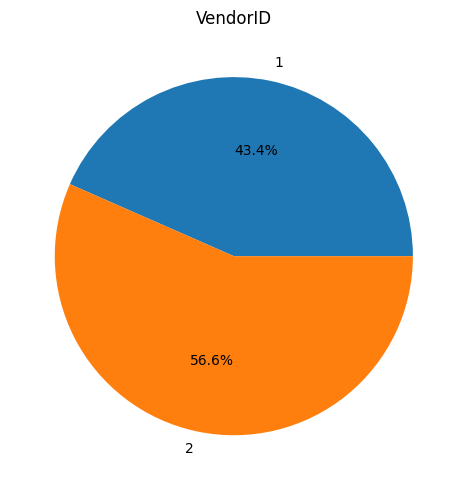

In [36]:
###############################################################
#pie plot of VendorID
###############################################################
plt.figure(figsize=(5,5))
target_data=df_trans
result=target_data.groupby(['VendorID'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
plt.pie(result["ID"],labels = result['VendorID'], autopct='%1.1f%%')
plt.title("VendorID")
plt.tight_layout()
plt.show()

#=>Vendor1 percent is 45.07% in Bigquery nyc tlc_yellow_trips_2017(pickup year=2017)
#=>Vendor2 percent is 54.93% in Bigquery nyc tlc_yellow_trips_2017(pickup year=2017)

#### tpep_pickup_datetime

* datetime of this dataset Floating Timestamp
* The Standard Lease Cap Rates vary in weekday, daytime/nighttime and power type(hybrid or not)[DAILY & WEEKLY TAXICAB
DRIVER BILL OF RIGHTS](https://www.nyc.gov/assets/tlc/downloads/pdf/fleet_drivers_rights_poster.pdf)
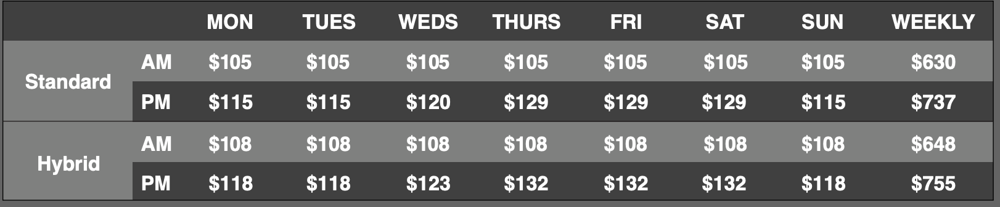

[New Lease Caps effective on 2012-09-30 12:01 am](https://www.nyc.gov/assets/tlc/downloads/pdf/archived_industry_notices/industry_notice_12_26_a.pdf)

|pickup_weekday|trip_count|Percentage|day shifts(Standard)|night shift(Standard)|day shifts(Hybrid)|night shift(Hybrid)|
|:--|:--|:--|:--|:--|:--|:--|
|Sunday|14996639|13.213%|105|115|108|118|
|Monday|14597298|12.861%|105|115|108|118|
|Tuesday|15824814|13.943%|105|115|108|118|
|Wednesday|16744017|14.752%|105|120|108|123|
|Thursday|17070365|15.040%|105|129|108|132|
|Friday|17388230|15.320%|105|129|108|132|
|Saturday|16878785|14.871%|105|129|108|132|
|one-week|-|-|630|737|648|755|

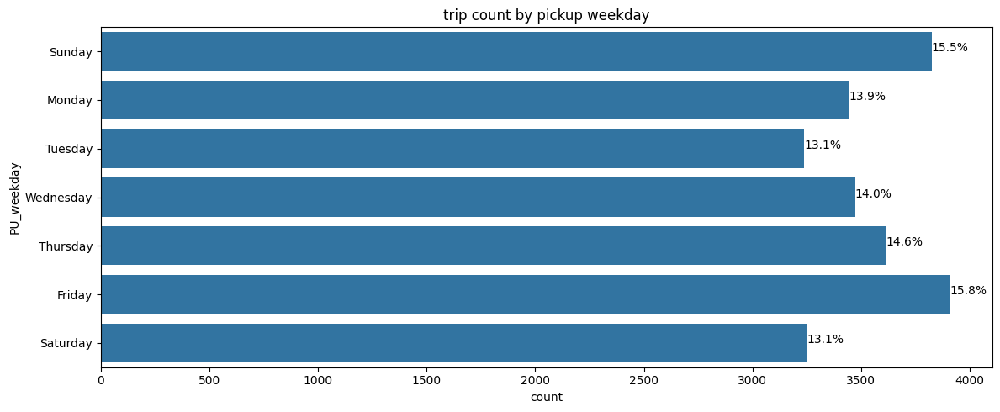

In [37]:
###############################################################
#count plot of pickup weekday
###############################################################
plt.figure(figsize=(12,5))


ax=sns.countplot(data=target_data,y='PU_weekday',color=BAR_COLOR_BLUE,order=Weekday_Order)
total=target_data.shape[0]
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width() / total)
    x = p.get_x() + p.get_width() + 0.02
    y = p.get_y() + p.get_height() / 2
    ax.annotate(percentage, (x, y))
plt.title("trip count by pickup weekday")
plt.tight_layout()
plt.show()

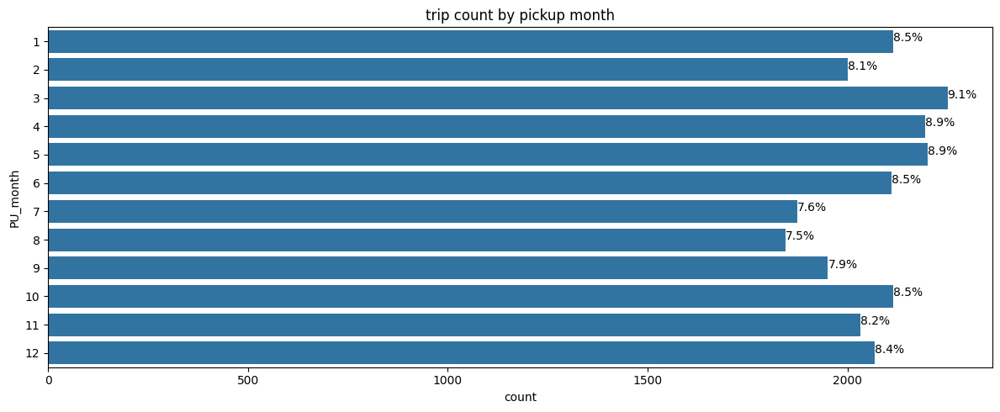

In [38]:
###############################################################
#count plot of pickup month
###############################################################
plt.figure(figsize=(12,5))
target_data=df_trans
ax=sns.countplot(data=target_data,y='PU_month',color=BAR_COLOR_BLUE)
total=target_data.shape[0]
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width() / total)
    x = p.get_x() + p.get_width() + 0.02
    y = p.get_y() + p.get_height() / 2
    ax.annotate(percentage, (x, y))
plt.title("trip count by pickup month")
plt.tight_layout()
plt.show()

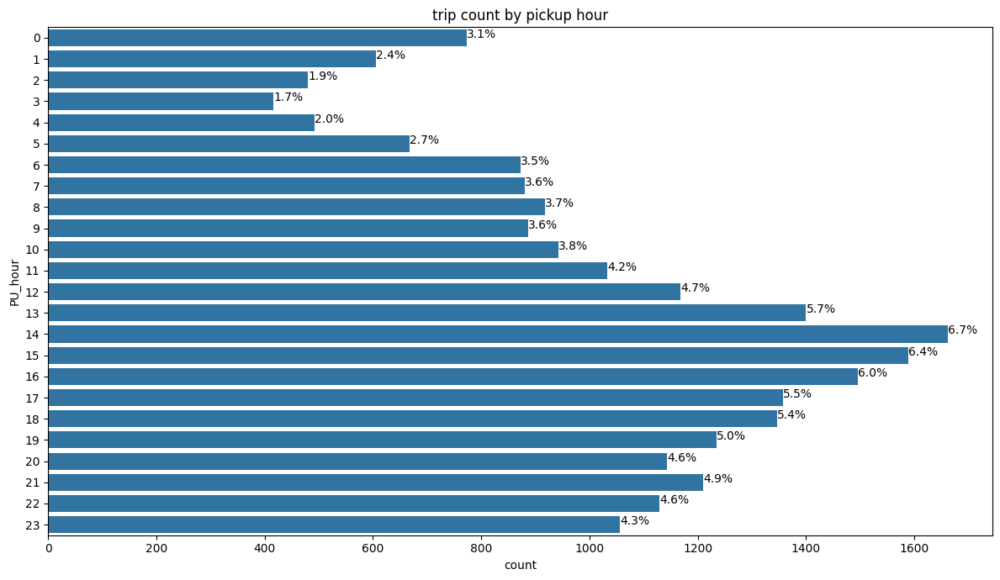

In [39]:
###############################################################
#count plot of pickup hour
###############################################################
plt.figure(figsize=(12,7))
target_data=df_trans
ax=sns.countplot(data=target_data,y='PU_hour',color=BAR_COLOR_BLUE)
total=target_data.shape[0]
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width() / total)
    x = p.get_x() + p.get_width() + 0.02
    y = p.get_y() + p.get_height() / 2
    ax.annotate(percentage, (x, y))
plt.title("trip count by pickup hour")
plt.tight_layout()
plt.show()

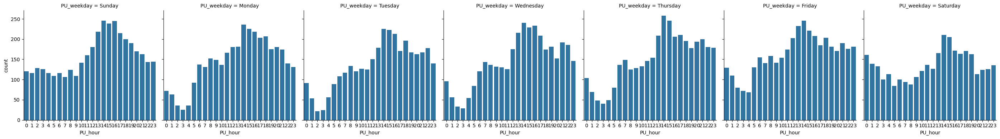

In [40]:
###############################################################
#count plot of pickup hour and weekday
###############################################################
target_data=df_trans
g = sns.FacetGrid(target_data, col="PU_weekday", height=4, aspect=1)
g.map(sns.countplot, "PU_hour")
plt.show()

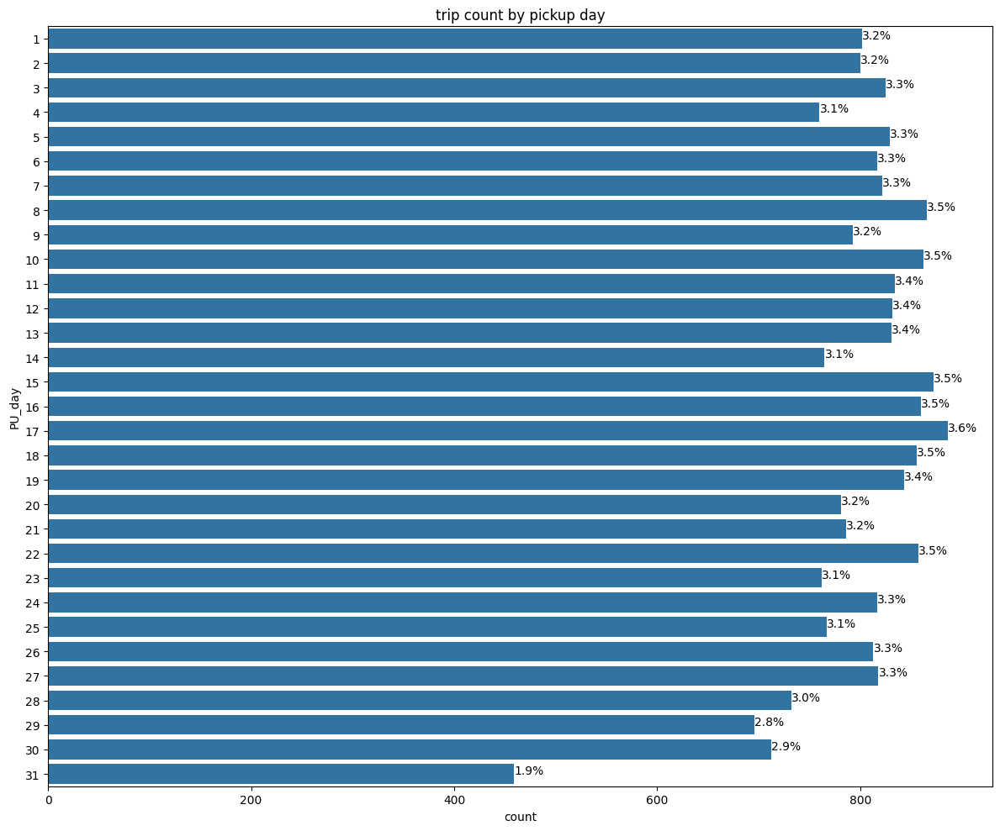

In [41]:
###############################################################
#count plot of pick day
###############################################################
plt.figure(figsize=(12,10))
target_data=df_trans
ax=sns.countplot(data=target_data,y='PU_day',color=BAR_COLOR_BLUE)
total=target_data.shape[0]
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width() / total)
    x = p.get_x() + p.get_width() + 0.02
    y = p.get_y() + p.get_height() / 2
    ax.annotate(percentage, (x, y))
plt.title("trip count by pickup day")
plt.tight_layout()
plt.show()

#### 4. passenger_count

* This is a driver-entered value
* Trip count by Passenger_count in 2017 yellow taxi dataset(bigquery-public-data.new_york_taxi_trips.tlc_yellow_trips_2017)

|No|year|passenger_count|trip_count|Percentage|
|:--|:--    |:--        |:--        |:--       |
|1|2017|0|166087|0.1463320%|
|2|2017|1|81034996|71.3963791%|
|3|2017|2|16545542|14.5775510%|
|4|2017|3|4748849|4.1840025%|
|5|2017|4|2257804|1.9892520%|
|6|2017|5|5409666|4.7662193%|
|7|2017|6|3336206|2.9393847%|
|8|2017|7|360|0.0003172%|
|9|2017|8|339|0.0002987%|
|10|2017|9|298|0.0002626%|
|11|2017|192|1|0.0000009%|



[FAQ](https://www.nyc.gov/site/tlc/passengers/passenger-frequently-asked-questions.page#)
* The maximum amount of passengers allowed in a yellow taxicab by law is four (4) in a four (4) passenger taxicab or five (5) passengers in a five (5) passenger taxicab. All passengers must wear seat belts and children under the age of 4 must ride in child safety seats. Children under the age of 8 must ride in a child restraint system, such as a federally approved harness, vest, or booster-seat.

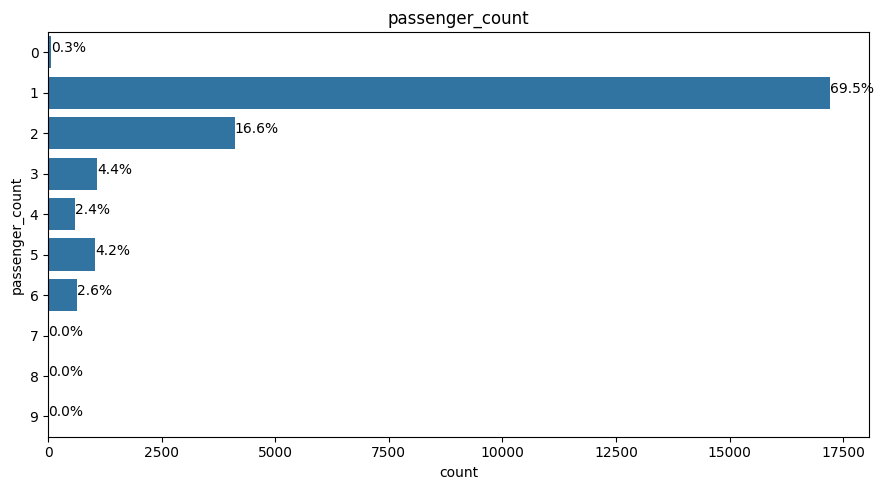

In [42]:
###############################################################
#count plot of passenger_count
###############################################################
plt.figure(figsize=(9,5))
target_data=df_trans
ax=sns.countplot(data=target_data,y='passenger_count',color=BAR_COLOR_BLUE)
total=target_data.shape[0]
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width() / total)
    x = p.get_x() + p.get_width() + 0.02
    y = p.get_y() + p.get_height() / 2
    ax.annotate(percentage, (x, y))
plt.title("passenger_count")
plt.tight_layout()
plt.show()
#=>0 passenger  and 6 passenger count exists

#### 5. trip_distance

* The unit charge of standard metered fare is 70 cents(50 cents in 2017) per 1/5 mile when traveling above 12mph or per 60 seconds in slow traffic or when the vehicle is stopped.[Taxi Fare](https://www.nyc.gov/site/tlc/passengers/taxi-fare.page)
* The maximum work time of a driver is 12 hours
* If the speed is less equal than 12mph, the maximum fare amount of a shift(Assume 12 hours) is \\$360
* If the speed is above 12mph, the longer distance(within 12 hours, higher spped longer distance) the higher fare amount.

[NEW YORK CITY TAXI AND LIMOUSINE COMMISSION
New Lease Caps effective on 2012-09-30 12:01am](https://www.nyc.gov/assets/tlc/downloads/pdf/archived_industry_notices/industry_notice_12_26_a.pdf)

|Speed(mph)|Maximum distance(mile)|Maximum fare amount($)|
|:--       |:--                   |:--                   |
|10|120|300|
|12|144|360|
|15|180|450|
|20|240|600|
|30|360|900|
|40|480|1200|
|50|600|1500|

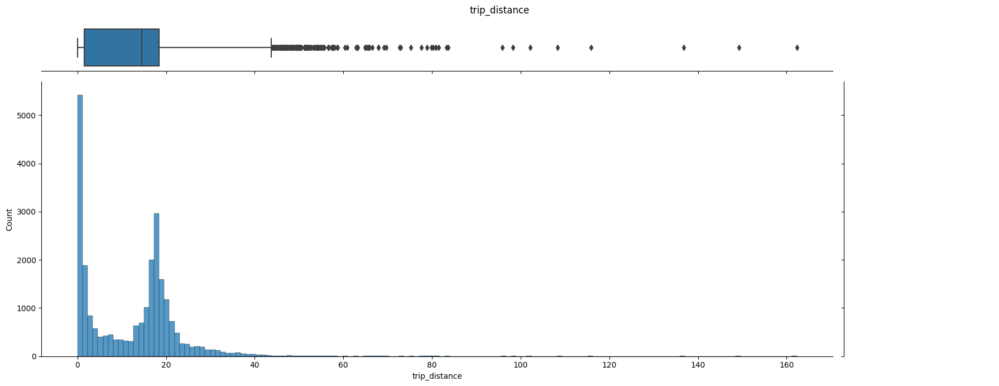

In [43]:
###############################################################
#hist plot of trip_distance
###############################################################
target_data=df_trans
g = sns.JointGrid(data=target_data, x="trip_distance")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("trip_distance")
plt.tight_layout()
plt.show()

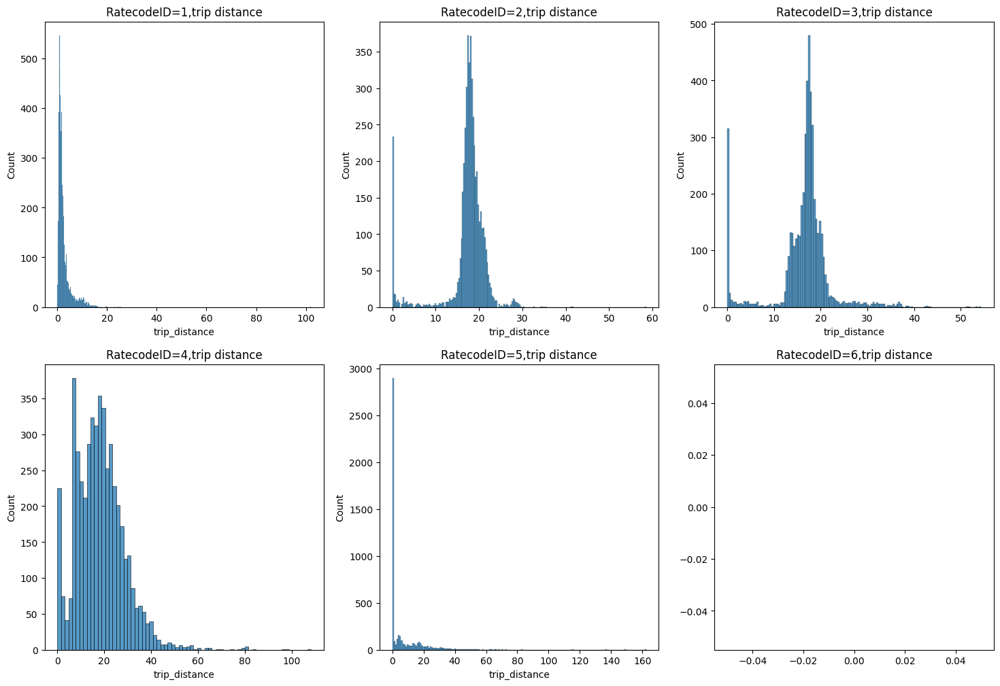

In [44]:
###############################################################
#Hist plot of trip_distance by RatecodeID
###############################################################
fig,axs=plt.subplots(2,3,figsize=(18,12))
target_data=df_trans
for ratecode,ax in zip(RateCodeIDList,axs.ravel()):
    mask=target_data['RatecodeID']==ratecode
    sns.histplot(data=target_data[mask], x="trip_distance",ax=ax)
    ax.set_title(f'RatecodeID={ratecode},trip distance')
plt.show()

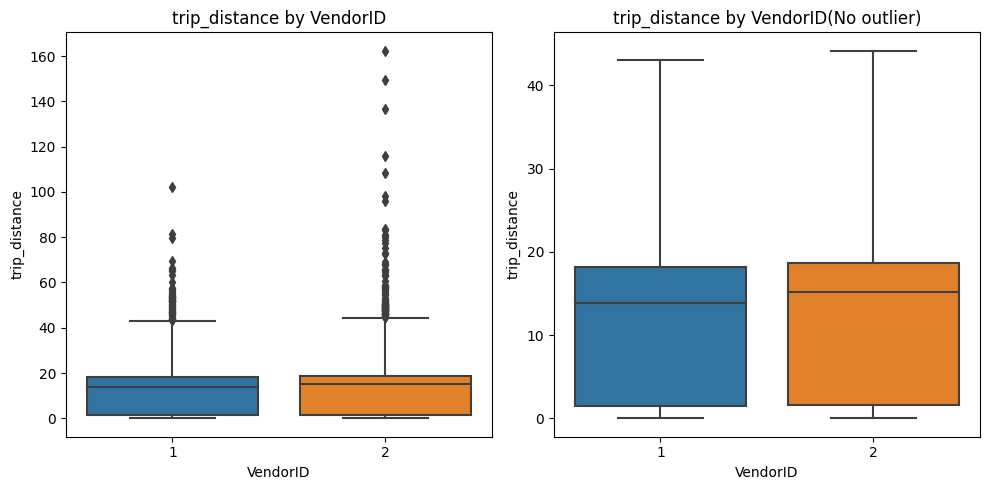

In [45]:
###############################################################
#box plot of trip_distance by VendorID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(10,5))
target_data=df_trans
sns.boxplot(data=target_data, y="trip_distance",x="VendorID",ax=axs[0])
axs[0].set_title("trip_distance by VendorID")

sns.boxplot(data=target_data, y="trip_distance",x="VendorID",ax=axs[1],showfliers=False)
axs[1].set_title("trip_distance by VendorID(No outlier)")

plt.tight_layout()
plt.show()

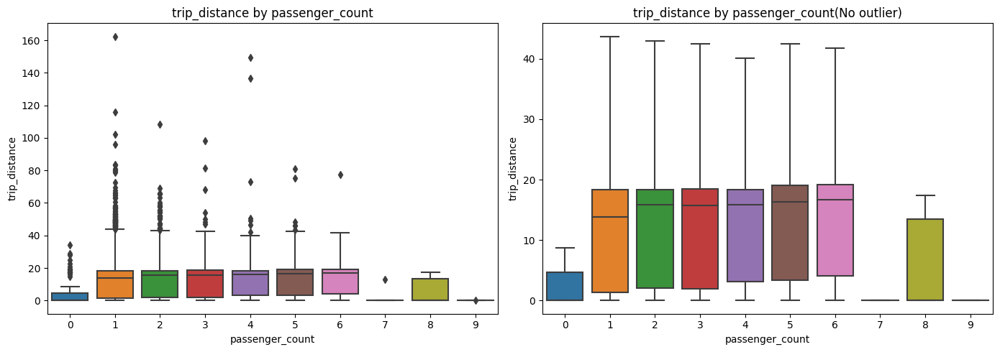

In [46]:
###############################################################
#box plot of trip_distance by passenger_count
###############################################################
fig,axs=plt.subplots(1,2,figsize=(14,5))
target_data=df_trans
sns.boxplot(data=target_data, y="trip_distance",x="passenger_count",ax=axs[0])
axs[0].set_title("trip_distance by passenger_count")

sns.boxplot(data=target_data, y="trip_distance",x="passenger_count",ax=axs[1],showfliers=False)
axs[1].set_title("trip_distance by passenger_count(No outlier)")

plt.tight_layout()
plt.show()

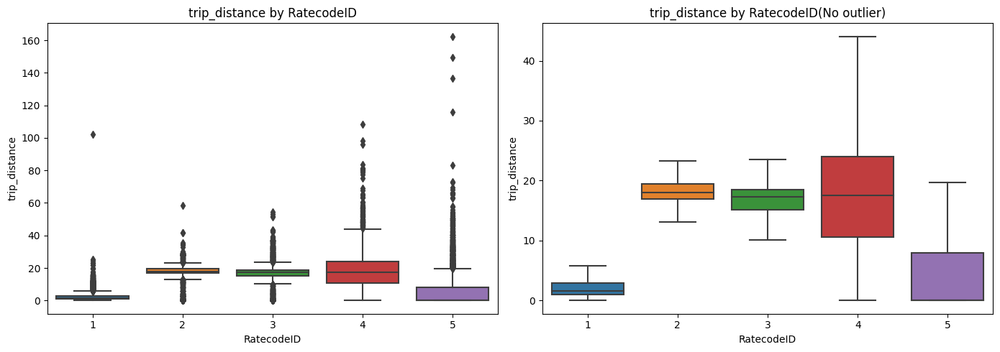

In [47]:
###############################################################
#box plot of trip_distance by RatecodeID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(14,5))
target_data=df_trans

sns.boxplot(data=target_data, y="trip_distance",x="RatecodeID",ax=axs[0])
axs[0].set_title("trip_distance by RatecodeID")

sns.boxplot(data=target_data, y="trip_distance",x="RatecodeID",ax=axs[1],showfliers=False)
axs[1].set_title("trip_distance by RatecodeID(No outlier)")

plt.tight_layout()
plt.show()
#=>vary a lot

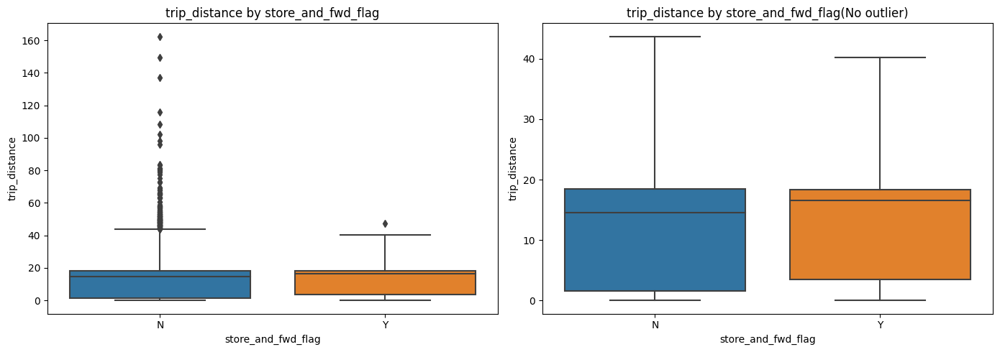

In [48]:
###############################################################
#box plot of trip_distance by store_and_fwd_flag
#Y= store and forward trip 
#N= not a store and forward trip
###############################################################
fig,axs=plt.subplots(1,2,figsize=(14,5))
target_data=df_trans

sns.boxplot(data=target_data, y="trip_distance",x="store_and_fwd_flag",ax=axs[0])
axs[0].set_title("trip_distance by store_and_fwd_flag")

sns.boxplot(data=target_data, y="trip_distance",x="store_and_fwd_flag",ax=axs[1],showfliers=False)
axs[1].set_title("trip_distance by store_and_fwd_flag(No outlier)")

plt.tight_layout()
plt.show()

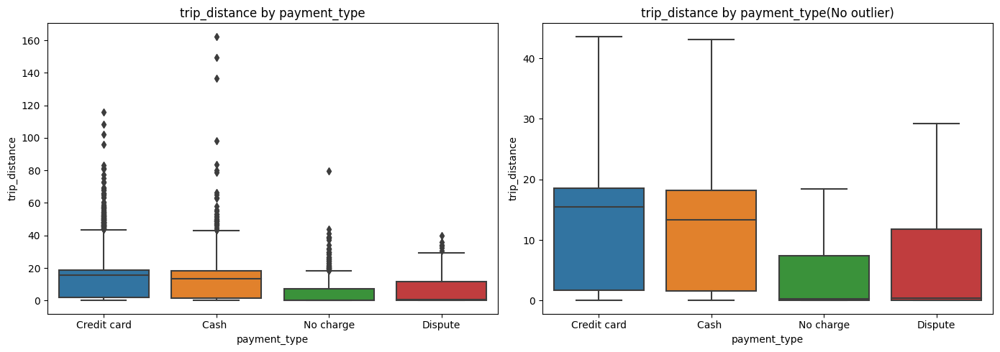

In [49]:
###############################################################
#box plot of trip_distance by payment_type
###############################################################
#1= Credit card 
#2= Cash 
#3= No charge 
#4= Dispute 
#5= Unknown 
#6= Voided trip
fig,axs=plt.subplots(1,2,figsize=(14,5))
target_data=df_trans

sns.boxplot(data=target_data, y="trip_distance",x="payment_type",ax=axs[0])
#axs[0].set_xticks(ticks=[0, 1 ,2,3], labels=['Credit card', 'Cash ', 'No charge','Dispute'])
axs[0].set_xticks(ticks=[0, 1 ,2,3])
axs[0].set_xticklabels(labels=['Credit card', 'Cash ', 'No charge','Dispute'])
axs[0].set_title("trip_distance by payment_type")

sns.boxplot(data=target_data, y="trip_distance",x="payment_type",ax=axs[1],showfliers=False)
#axs[1].set_xticks(ticks=[0, 1 ,2,3], labels=['Credit card', 'Cash ', 'No charge','Dispute'])
axs[1].set_xticks(ticks=[0, 1 ,2,3])
axs[1].set_xticklabels(labels=['Credit card', 'Cash ', 'No charge','Dispute'])
axs[1].set_title("trip_distance by payment_type(No outlier)")

plt.tight_layout()
plt.show()

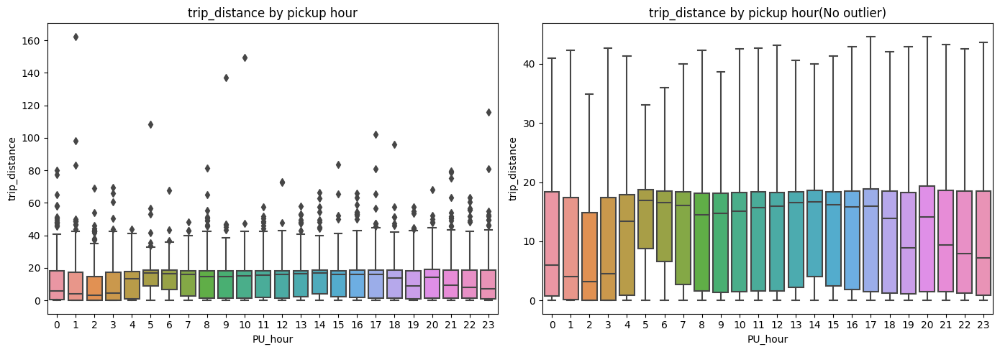

In [50]:
###############################################################
#box plot of trip_distance by pickup hour
###############################################################
fig,axs=plt.subplots(1,2,figsize=(14,5))
target_data=df_trans

sns.boxplot(data=target_data, y="trip_distance",x="PU_hour",ax=axs[0])
axs[0].set_title("trip_distance by pickup hour")

sns.boxplot(data=target_data, y="trip_distance",x="PU_hour",ax=axs[1],showfliers=False)
axs[1].set_title("trip_distance by pickup hour(No outlier)")

plt.tight_layout()
plt.show()

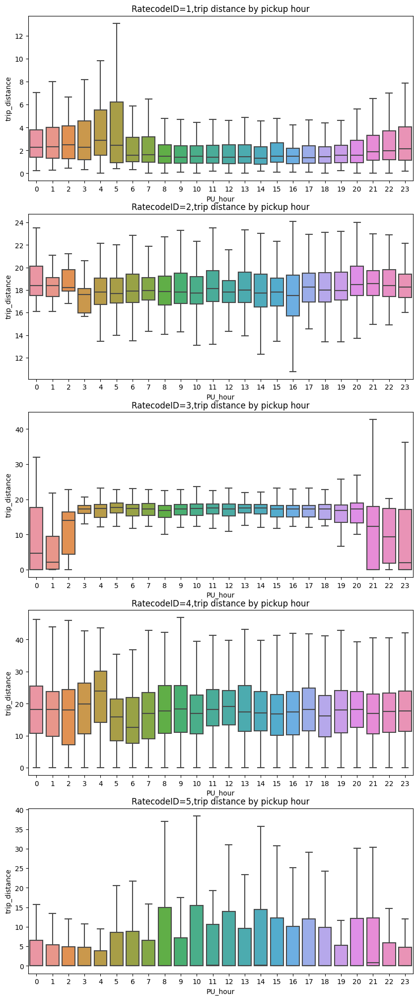

In [51]:
###################################################################################
#Box plot of trip_distance by pickup hour while keep RatecodeID constant
###################################################################################
fig,axs=plt.subplots(5,1,figsize=(10,25))
target_data=df_trans
for ratecode,ax in zip(RateCodeIDList,axs.ravel()):
    mask=target_data['RatecodeID']==ratecode
    sns.boxplot(data=target_data[mask], y="trip_distance",x="PU_hour",ax=ax,showfliers=False)
    ax.set_title(f'RatecodeID={ratecode},trip distance by pickup hour')
plt.show()

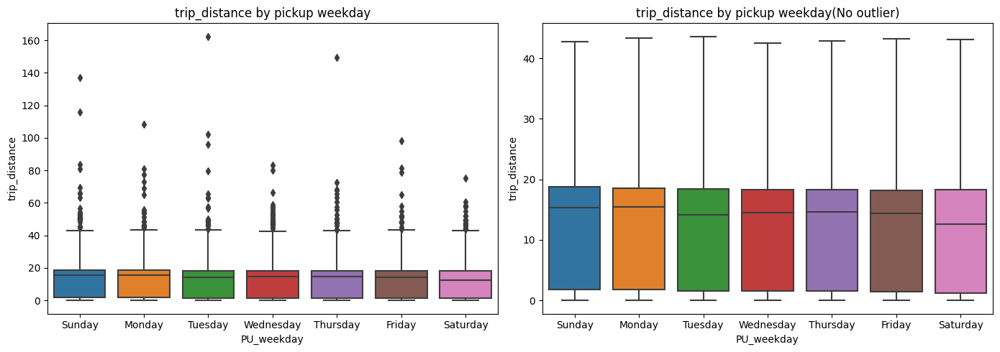

In [52]:
###############################################################
#box plot of trip_distance by pickup week
###############################################################
fig,axs=plt.subplots(1,2,figsize=(14,5))
target_data=df_trans

sns.boxplot(data=target_data, y="trip_distance",x="PU_weekday",ax=axs[0])
axs[0].set_title("trip_distance by pickup weekday")

sns.boxplot(data=target_data, y="trip_distance",x="PU_weekday",ax=axs[1],showfliers=False)
axs[1].set_title("trip_distance by pickup weekday(No outlier)")

plt.tight_layout()
plt.show()

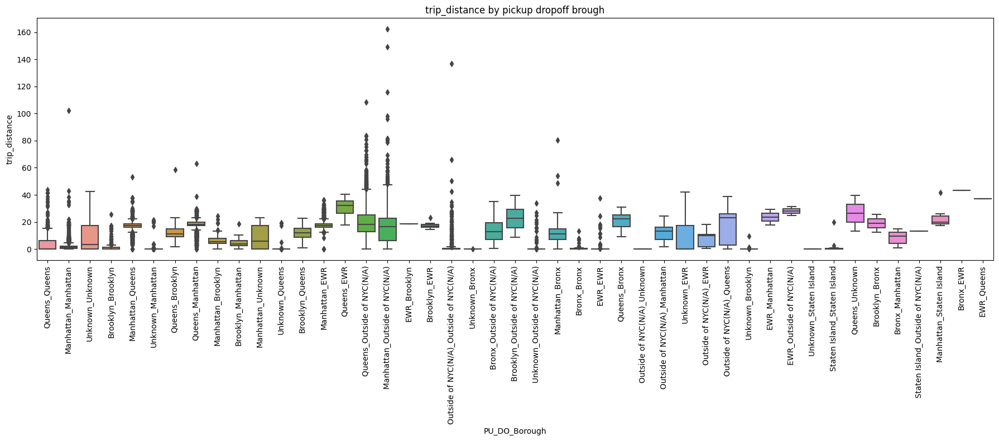

In [53]:
###############################################################
#box plot of trip_distance by pickup dropoff brough
###############################################################
plt.figure(figsize=(18,8))
target_data=df_trans

sns.boxplot(data=target_data, y="trip_distance",x="PU_DO_Borough")
plt.title("trip_distance by pickup dropoff brough")
plt.xticks(rotation=90)


plt.tight_layout()
plt.show()

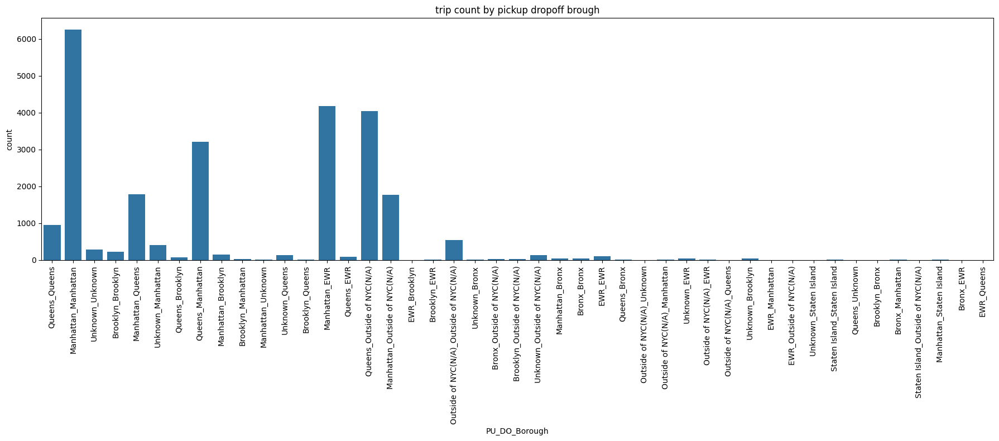

In [54]:
###############################################################
#count plot of trip_distance by pickup dropoff brough
###############################################################
plt.figure(figsize=(18,8))
target_data=df_trans

sns.countplot(data=target_data,x="PU_DO_Borough",color=BAR_COLOR_BLUE)
plt.title("trip count by pickup dropoff brough")
plt.xticks(rotation=90)


plt.tight_layout()
plt.show()

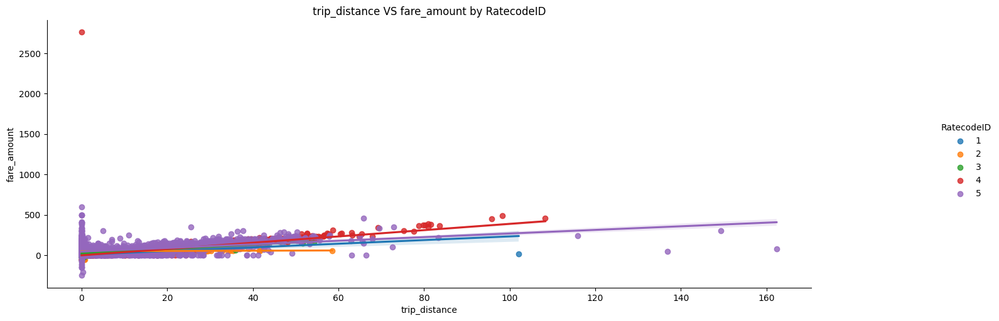

In [55]:
###############################################################
#plot of trip_distance and fare_amount
###############################################################
g=sns.lmplot(data=df_trans, x="trip_distance", y="fare_amount", hue="RatecodeID")
g.fig.set_size_inches((18, 5))
plt.title("trip_distance VS fare_amount by RatecodeID")
plt.show()

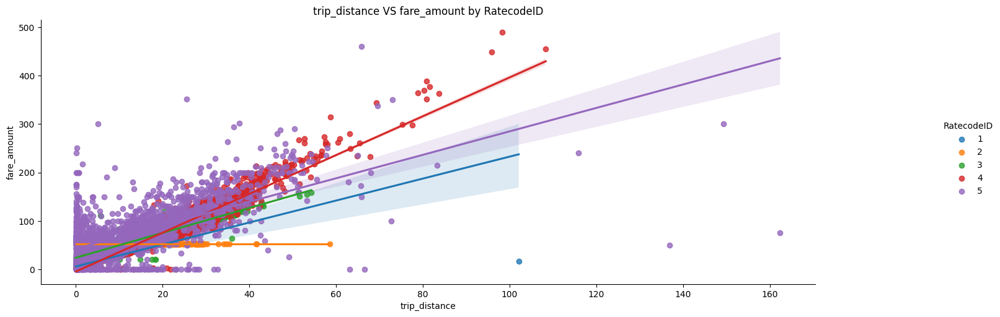

In [56]:
###############################################################
#plot of trip_distance and fare_amount
#exclude some data
###############################################################
target_data=df_trans
#exclude payment type NOT cash or credit
mask_payment=target_data['payment_type'].isin([1,2])
#exclude RatecodeID NOT 1-6
mask_ratecodeid=target_data['RatecodeID'].isin(RateCodeIDList)
#exclude trip distance is 0
mask_distance=target_data['trip_distance']>0

mask_total=mask_payment&mask_ratecodeid&mask_distance

target_data=target_data[mask_total]
g=sns.lmplot(data=target_data, x="trip_distance", y="fare_amount", hue="RatecodeID")
g.fig.set_size_inches((18, 5))
plt.title("trip_distance VS fare_amount by RatecodeID")
plt.show()

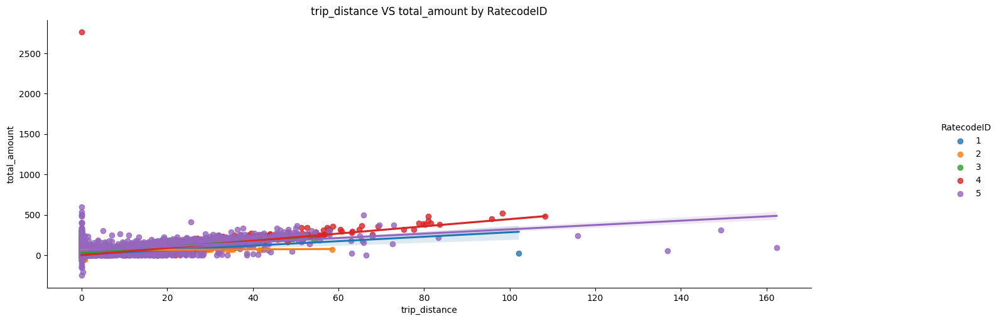

In [57]:
###############################################################
#plot of trip_distance and total_amount
###############################################################
g=sns.lmplot(data=df_trans, x="trip_distance", y="total_amount", hue="RatecodeID")
g.fig.set_size_inches((18, 5))
plt.title("trip_distance VS total_amount by RatecodeID")
plt.show()

#### 6. RatecodeID


* Trip count by RatecodeID in 2017 bigquery-public-data.new_york_taxi_trips.tlc_yellow_trips_2017

|No|year|rate_code|trip_count|Percentage|
|:--|:--    |:--        |:--        |:--       |
|1|2017|1|110272150|97.1559526%|
|2|2017|2|2541929|2.2395821%|
|3|2017|3|237609|0.2093469%|
|4|2017|4|61748|0.0544035%|
|5|2017|5|382685|0.3371670%|
|6|2017|6|1057|0.0009313%|
|7|2017|99|297|0.0002617%|
|8|2017|null|2673|0.0023551%|

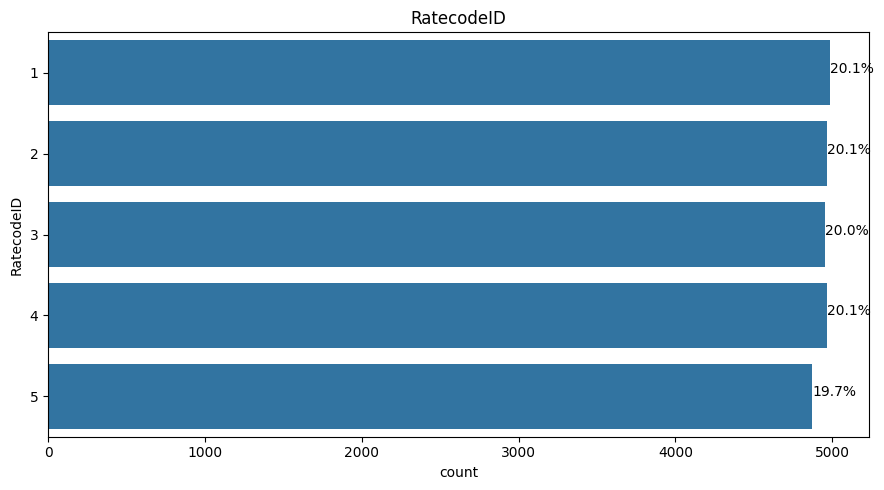

In [58]:
###############################################################
#count plot of RatecodeID
###############################################################
plt.figure(figsize=(9,5))
target_data=df_trans
ax=sns.countplot(data=target_data,y='RatecodeID',color=BAR_COLOR_BLUE)
total=target_data.shape[0]
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width() / total)
    x = p.get_x() + p.get_width() + 0.02
    y = p.get_y() + p.get_height() / 2
    ax.annotate(percentage, (x, y))
plt.title("RatecodeID")
plt.tight_layout()
plt.show()
#=>99 was not in the data dictionary



**[Airport Trips (LGA, JFK, EWR) from 2022](https://www.nyc.gov/site/tlc/passengers/taxi-fare.page)**

* Airport Access Fee<BR>
    * Taxi: $1.75 for pick up only at LaGuardia and John F. Kennedy Airports
    
    * FHV: $2.50 for both drop off and pick up at LaGuardia, Newark, and John F. Kennedy airports
    
* Trips to and from LaGuardia Airport (LGA) are charged the standard metered fare, plus a $5.00 surcharge and all other applicable surcharges.

  
* Trips between Manhattan and John F. Kennedy Airport (JFK) in either direction:
    * \\$70
      
    * Plus 50 cents MTA State Surcharge.
 
    * Plus \\$1.00 Improvement Surcharge.
 
    * $5.00 rush hour surcharge (4pm to 8pm weekdays, excluding legal holidays).
 
    * Plus New York State Congestion Surcharge of \\$2.50 (Yellow Taxi) or \\$2.75 (Green Taxi and FHV) or 75 cents (any shared ride) for all trips that begin, end or pass through Manhattan south of 96th Street.
 
    * Plus tips and any tolls.
   
    * The on-screen rate message should read "Rate #2- JFK Airport."
 
    
* Trips between John F. Kennedy Airport (JFK) and other New York City destinations are charged the standard metered fare.
* Trips to Newark Airport (EWR):
    * Standard metered fare.
    * Plus $20.00 Newark Surcharge.
    * Plus tip and tolls to and from EWR (passengers are charged for the drivers’ return tolls).
    * The on-screen rate message should read "Rate #3 - Newark Airport."


[2015](https://www.nyc.gov/assets/tlc/downloads/pdf/proposed_rule_fare_and_lease_cap_2015.pdf)

[Before 2022](https://rules.cityofnewyork.us/wp-content/uploads/2022/09/TLC-Notice-of-Promulgation-Adjustments-of-Rates-of-Fare-TIF-and-SHLIF-Final-certified-CIty-Record.pdf)

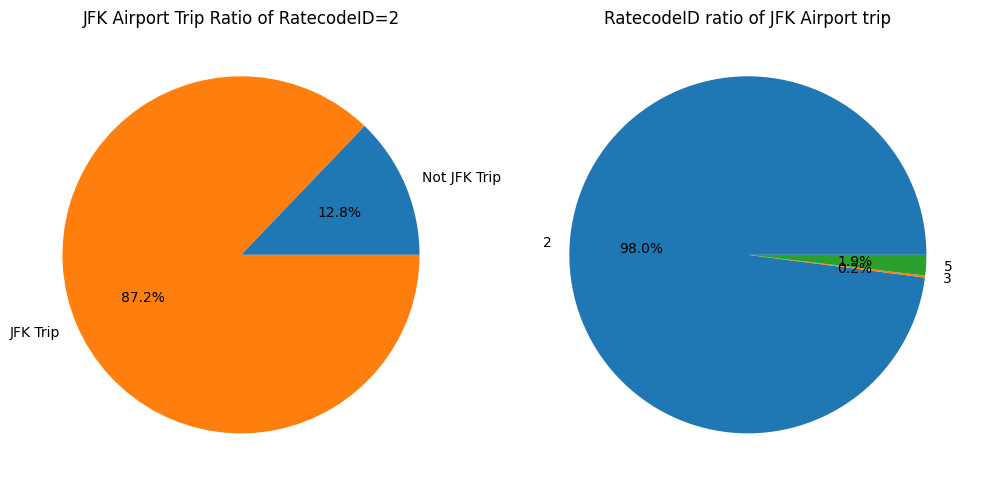

In [59]:
fig,axs=plt.subplots(1,2,figsize=(10,5))

###############################################################
#Pie plot of RatecodeID=2(JFK)
###############################################################
mask=df_trans['RatecodeID']==2
target_data=df_trans[mask]
#check if Trip is JFK Trip, LocationID is JFK, Manhattan<->JFK
target_data['JFK']=target_data.apply(lambda x: check_LocationID_JFK_Trip(x["PULocationID"],x["DOLocationID"],x["Borough_PU"],x["Borough_DO"]), axis=1)
label_dict={True:'JFK Trip',False:'Not JFK Trip'}

result=target_data.groupby(['JFK'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[0].pie(result["ID"],labels = result['JFK'].map(label_dict), autopct='%1.1f%%')
axs[0].set_title("JFK Airport Trip Ratio of RatecodeID=2")


###############################################################
#Pie plot of JFK Trip
###############################################################
target_data=df_trans
#check if Trip is JFK Trip, LocationID is JFK, Manhattan<->JFK
target_data['JFK']=target_data.apply(lambda x: check_LocationID_JFK_Trip(x["PULocationID"],x["DOLocationID"],x["Borough_PU"],x["Borough_DO"]), axis=1)
#mask=target_data['JFK']=='JFK Trip'
mask=target_data['JFK']==True
target_data=target_data[mask]

result=target_data.groupby(['RatecodeID'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[1].pie(result["ID"],labels = result['RatecodeID'], autopct='%1.1f%%')
axs[1].set_title("RatecodeID ratio of JFK Airport trip")


plt.tight_layout()
plt.show()

In [60]:
mask=df_trans['RatecodeID']==2
target_data=df_trans[mask]
#check if Trip is JFK Trip, LocationID is JFK, Manhattan<->JFK
target_data['JFK']=target_data.apply(lambda x: check_LocationID_JFK_Trip(x["PULocationID"],x["DOLocationID"],x["Borough_PU"],x["Borough_DO"]), axis=1)
target_data[target_data['JFK']==False][['tpep_pickup_datetime', 'tpep_dropoff_datetime',
       'passenger_count', 'trip_distance', 'RatecodeID', 
       'PULocationID', 'DOLocationID', 'payment_type', 'fare_amount', 'extra',
       'mta_tax', 'tip_amount', 'tolls_amount', 'improvement_surcharge',
       'total_amount',  'Borough_PU', 
       'service_zone_PU', 'Borough_DO', 
       'service_zone_DO', 'JFK']]
#=>Some trips were not Manhattan<->JFK(RatecodeID=2), but they used RatecodeID=2
#Possibles reasons:
#mistake / error (passenger didn't pay for it)
#mistake / error (passenger paid for it)
#passenger cancel trip
#operation miss (LocationID didn't record correctly but fare was right or change payment type)
#used as negotiated flat rate (passenger want to control the upper limit)

,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,Borough_PU,service_zone_PU,Borough_DO,service_zone_DO,JFK
433,2017-01-23 15:42:37,2017-01-23 16:17:20,1,14.02,2,215,48,2,52.0,0.0,0.5,0.00,5.54,0.3,58.34,Queens,Boro Zone,Manhattan,Yellow Zone,False
444,2017-01-17 12:47:14,2017-01-17 12:48:38,1,0.02,2,246,246,4,-52.0,0.0,-0.5,0.00,0.00,-0.3,-52.80,Manhattan,Yellow Zone,Manhattan,Yellow Zone,False
445,2017-01-14 03:38:12,2017-01-14 03:38:23,1,0.01,2,181,181,3,-52.0,0.0,-0.5,0.00,0.00,-0.3,-52.80,Brooklyn,Boro Zone,Brooklyn,Boro Zone,False
446,2017-01-21 22:57:53,2017-01-21 23:17:37,2,10.84,2,93,166,1,52.0,0.0,0.5,6.00,5.54,0.3,64.34,Queens,Boro Zone,Manhattan,Boro Zone,False
447,2017-01-03 22:01:54,2017-01-03 22:02:36,1,0.00,2,263,263,1,52.0,0.0,0.5,11.67,5.54,0.3,70.01,Manhattan,Yellow Zone,Manhattan,Yellow Zone,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23510,2017-12-27 22:24:27,2017-12-27 22:24:37,5,0.00,2,239,239,1,52.0,0.0,0.5,11.71,5.76,0.3,70.27,Manhattan,Yellow Zone,Manhattan,Yellow Zone,False
23511,2017-12-29 15:04:48,2017-12-29 15:06:55,1,0.38,2,170,137,2,52.0,0.0,0.5,0.00,5.76,0.3,58.56,Manhattan,Yellow Zone,Manhattan,Yellow Zone,False
23516,2017-12-15 16:22:15,2017-12-15 16:41:53,1,5.61,2,180,132,2,52.0,4.5,0.5,0.00,0.00,0.3,57.30,Queens,Boro Zone,Queens,Airports,False
23518,2017-12-26 15:18:04,2017-12-26 16:12:16,2,16.20,2,264,264,2,52.0,0.0,0.5,0.00,5.76,0.3,58.56,Unknown,Unknown(N/A),Unknown,Unknown(N/A),False


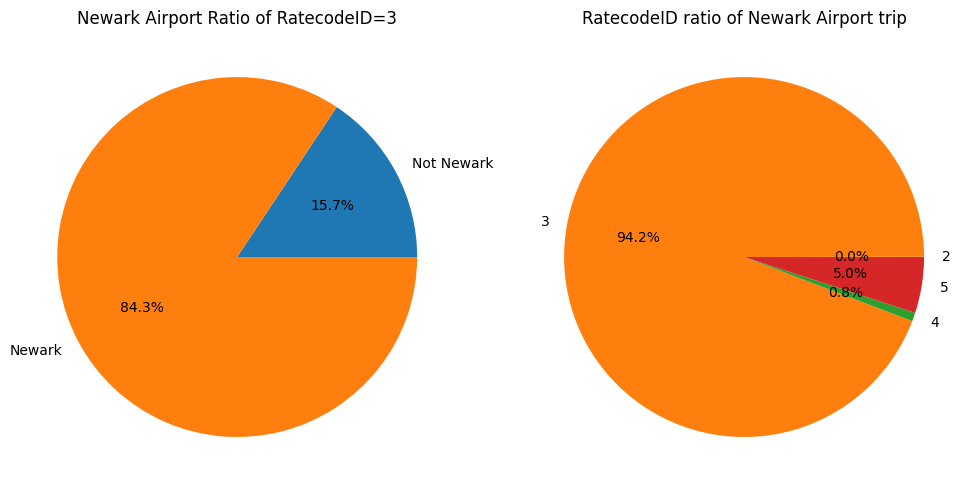

In [61]:
fig,axs=plt.subplots(1,2,figsize=(10,5))

###############################################################
#Pie plot of RatecodeID=3(Newark)
###############################################################
mask=df_trans['RatecodeID']==3
target_data=df_trans[mask]
#check if PULocationID or DOLocationID is Newark Airport(taxi zone:1)
target_data['Newark']=target_data[['PULocationID','DOLocationID']].apply(check_LocationID_Newark, axis=1)
label_dict={True:'Newark',False:'Not Newark'}

result=target_data.groupby(['Newark'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[0].pie(result["ID"],labels = result['Newark'].map(label_dict), autopct='%1.1f%%')
axs[0].set_title("Newark Airport Ratio of RatecodeID=3")

###############################################################
#Pie plot of EWR Trip
###############################################################
target_data=df_trans
#check if PULocationID or DOLocationID is Newark Airport(taxi zone:1)
target_data['Newark']=target_data[['PULocationID','DOLocationID']].apply(check_LocationID_Newark, axis=1)
#mask=target_data['Newark']=='Newark'
mask=target_data['Newark']==True
target_data=target_data[mask]

result=target_data.groupby(['RatecodeID'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[1].pie(result["ID"],labels = result['RatecodeID'], autopct='%1.1f%%')
axs[1].set_title("RatecodeID ratio of Newark Airport trip")


plt.tight_layout()
plt.show()

[Destinations Beyond NYC from 2022](https://www.nyc.gov/site/tlc/passengers/taxi-fare.page)

* Westchester & Nassau Counties:

    * The on-screen rate is "Rate #01 – Standard City Rate" within the City limit.
    * Once the taxi goes beyond the City limit to Nassau or Westchester, the on-screen rate message should read "Rate #04 – Out of City Rate to Nassau or Westchester." The metered fare is double the amount from the City limit to your destination.  Additionally, a message should appear on screen alerting the passenger of the rate change.
    * There is a 50 cents MTA State Surcharge and a \\$1.00 Improvement Surcharge.
    * Plus New York State Congestion Surcharge of \\$2.50 (Yellow Taxi) or \\$2.75 (Green Taxi and FHV) or 75 cents (any shared ride) for all trips that begin, end or pass through Manhattan south of 96th Street.
* Other Points Outside the City:
    * The Driver may choose whether to take such trips. The fare must be mutually agreed upon before the trip may begin.
    * Negotiated Flat Fare – The fare will be a Flat Rate negotiated between the Driver and Passenger.
    * The onscreen rate message should read "Rate #05 – Out of City Negotiated Flat Rate."
    * The 50 cents MTA State Surcharge must be added to the flat rate for any trip that ends in the following counties: Dutchess, Orange, Putnam, Rockland or Suffolk.
    * There is a \\$1.00 Improvement Surcharge.
    * Plus New York State Congestion Surcharge of \\$2.50 (Yellow Taxi) or \\$2.75 (Green Taxi and FHV) or 75 cents (any shared ride) for all trips that begin, end or pass through Manhattan south of 96th Street.
    
[FAQ](https://www.nyc.gov/site/tlc/passengers/passenger-frequently-asked-questions.page)
* What should I do if I want to pay by credit card, but the driver informs me he/she has already pressed the “Cash” button?
* Inform the driver that you wish to pay by credit card. He/she will be able to reset the PIM or enter the amount as a negotiated fare (**rate code 5**).

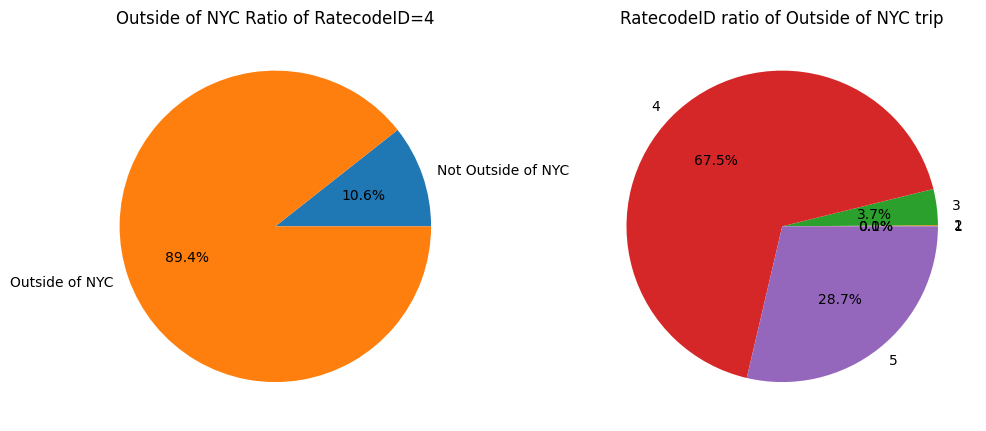

In [62]:
fig,axs=plt.subplots(1,2,figsize=(10,5))

###############################################################
#Pie plot of RatecodeID=4(Nassau or Westchester)
###############################################################
mask=df_trans['RatecodeID']==4
target_data=df_trans[mask]
#check if PULocationID or DOLocationID is Nassau or Westchester
#(taxi zone:265, also include other counties, could not distinguish from taxi zone LocationID)
target_data['OutsideNYC']=target_data[['PULocationID','DOLocationID']].apply(check_LocationID_OutsideNYC, axis=1)
label_dict={True:'Outside of NYC',False:'Not Outside of NYC'}

result=target_data.groupby(['OutsideNYC'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[0].pie(result["ID"],labels = result['OutsideNYC'].map(label_dict), autopct='%1.1f%%')
axs[0].set_title("Outside of NYC Ratio of RatecodeID=4")


###############################################################
#Pie plot of Outsideof NYC
###############################################################
target_data=df_trans
#check if PULocationID or DOLocationID is Outsideof NYC(265)
target_data['OutsideNYC']=target_data[['PULocationID','DOLocationID']].apply(check_LocationID_OutsideNYC, axis=1)
mask=(target_data['OutsideNYC']==True)
target_data=target_data[mask]

result=target_data.groupby(['RatecodeID'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[1].pie(result["ID"],labels = result['RatecodeID'], autopct='%1.1f%%')
axs[1].set_title("RatecodeID ratio of Outside of NYC trip")



plt.tight_layout()
plt.show()
#=>Taxi Zone 265 has multiple ratecodeid(difficult to check this pattern)

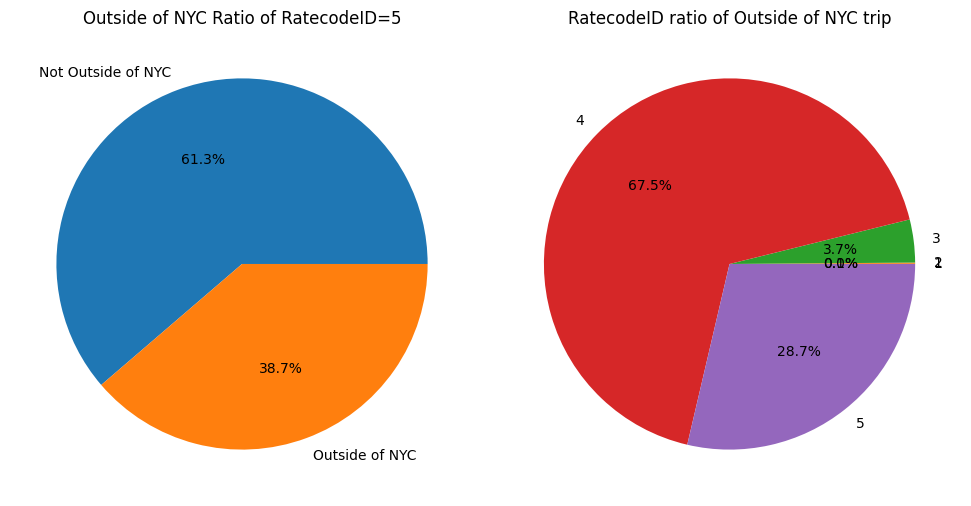

In [63]:
fig,axs=plt.subplots(1,2,figsize=(10,5))
###############################################################
#Pie plot of RatecodeID=5(Negotiated fare)
###############################################################
mask=df_trans['RatecodeID']==5
target_data=df_trans[mask]
#check if PULocationID or DOLocationID is Outsideof NYC(265)
target_data['OutsideNYC']=target_data[['PULocationID','DOLocationID']].apply(check_LocationID_OutsideNYC, axis=1)
label_dict={True:'Outside of NYC',False:'Not Outside of NYC'}

result=target_data.groupby(['OutsideNYC'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[0].pie(result["ID"],labels = result['OutsideNYC'].map(label_dict), autopct='%1.1f%%')
axs[0].set_title("Outside of NYC Ratio of RatecodeID=5")


###############################################################
#Pie plot of Outsideof NYC
###############################################################
target_data=df_trans
#check if PULocationID or DOLocationID is Outsideof NYC(265)
target_data['OutsideNYC']=target_data[['PULocationID','DOLocationID']].apply(check_LocationID_OutsideNYC, axis=1)
mask=target_data['OutsideNYC']==True
target_data=target_data[mask]

result=target_data.groupby(['RatecodeID'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[1].pie(result["ID"],labels = result['RatecodeID'], autopct='%1.1f%%')
axs[1].set_title("RatecodeID ratio of Outside of NYC trip")



plt.tight_layout()
plt.show()



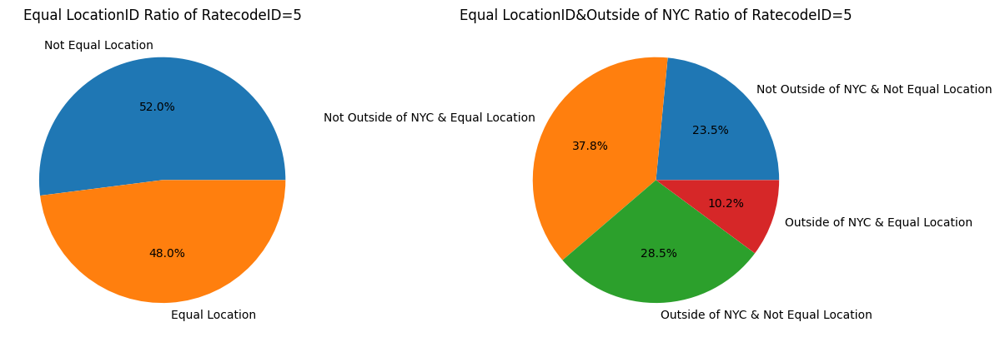

In [64]:
fig,axs=plt.subplots(1,2,figsize=(12,7))


###############################################################
#Pie plot of RatecodeID=5(Negotiated fare)
###############################################################
mask=df_trans['RatecodeID']==5
target_data=df_trans[mask]
#check if PULocationID or DOLocationID is Outsideof NYC(265)
target_data['Equal_LocationID']=target_data[['PULocationID','DOLocationID']].apply(lambda x: check_LocationID_Equal(x["PULocationID"],x["DOLocationID"]), axis=1)
label_dict={True:'Equal Location',False:'Not Equal Location'}

result=target_data.groupby(['Equal_LocationID'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[0].pie(result["ID"],labels = result['Equal_LocationID'].map(label_dict), autopct='%1.1f%%')
axs[0].set_title("Equal LocationID Ratio of RatecodeID=5")


###############################################################
#Pie plot of RatecodeID=5(Negotiated fare)
###############################################################
mask=df_trans['RatecodeID']==5
target_data=df_trans[mask]
#check if PULocationID or DOLocationID is Outsideof NYC(265)
target_data['OutsideNYC']=target_data[['PULocationID','DOLocationID']].apply(check_LocationID_OutsideNYC, axis=1)
#check if PULocationID equal to DOLocationID
target_data['Equal_LocationID']=target_data[['PULocationID','DOLocationID']].apply(lambda x: check_LocationID_Equal(x["PULocationID"],x["DOLocationID"]), axis=1)
result=target_data.groupby(['OutsideNYC','Equal_LocationID'])[["ID"]].count().reset_index()
result["label"]=result["OutsideNYC"].astype(str)+"_"+result["Equal_LocationID"].astype(str)

result["ID"]=result["ID"]/target_data.shape[0]

label_dict={'True_True':'Outside of NYC & Equal Location'
           ,'True_False':'Outside of NYC & Not Equal Location'
           ,'False_True':'Not Outside of NYC & Equal Location'
           ,'False_False':'Not Outside of NYC & Not Equal Location'}
axs[1].pie(result["ID"],labels = result['label'].map(label_dict), autopct='%1.1f%%')
axs[1].set_title("Equal LocationID&Outside of NYC Ratio of RatecodeID=5")

plt.tight_layout()
plt.show()

#=>RateCodeID 5 has multiple meaning
#=>Outside of NYC(Negotiated Flat Rate)
#=>Change payment type(Inside or outside of NYC)
#=>Negotiated Flat Rate(inside NYC)

**[Group Ride Information](https://www.nyc.gov/assets/tlc/downloads/pdf/taxi_information.pdf)**
* Two, three, or four people can take a group ride from a yellow taxi Group Ride Stand and pay a flat rate.

|Group Ride Pickup Location|Route End Point    |Fare/Person |50 cent MTA Tax|
|:--                       |:--                |:--         |:--            |
|Port Authority Bus        | 59th St./6th Ave  |\\$3.00     |One Passenger Pays|
|York Avenue               | Financial District|\\$6.00     |One Passenger Pays|

* Group Ride pickup times are 6am – 10am, Monday – Friday (excluding holidays).
* Drop-offs are restricted to the Group Rides route. The on-screen rate message should read ‘Rate # 06 – Group Rate.


**[Group Ride Fares around 2011](https://www.nyc.gov/assets/tlc/downloads/pdf/approved_group_ride_rule.pdf)**


**[TLC LAUNCHES NEW GROUP RIDE STAND AT LAGUARDIA AIRPORT TERMINALS  around 2010](https://www.nyc.gov/assets/tlc/downloads/pdf/press_release_8_04_10.pdf)

* between the hours of 7 and 10 a.m. and 4 and 8 p.m. Monday through Friday. 
* Passengers would pay a flat fare of \\$22 per person for rides with two passengers, or \\$18 per person for rides with three passengers for taxicab rides from the group ride stand location to drop-off points bounded by 59th Street to the north, 35th Street to the south, 8th Avenue to the west and 2nd Avenue to the east. Drivers will not be able to pick up additional passengers along the way. 


**[February TLC Announces February 26 Start Date for First 3 Taxi Group Ride Stands around 2010](https://www.nyc.gov/assets/tlc/downloads/pdf/press_release_02_22_10.pdf)**


|Pickup Location Corridor |End Point                   |Fare per person|
|:--                      |:--                         |:--            |
|W 57th St / 8th Avenue   |57th St to Park Ave/42nd St |\\$ 3.00       |
|E 72nd St / 3rd Avenue   |Park Ave / 42nd St          |\\$ 4.00       |
|W 72nd St/Columbus Ave.  |Park Ave / 42nd St          |\\$ 4.00       |


* The stands will be in operation on weekdays during morning rush hours between 6 a.m. and 10 a.m. <BR>
* Other stand locations planned for Manhattan include Grand Central Terminal to 59th Street/6th Avenue (\\$3.00 fare); Penn Station to 59th Street/6th Avenue (\\$4.00 fare); and the Port Authority Bus Terminal to 59th Street/6th Avenue (\\$3.00 fare). 

**[TLC LAUNCHES NEW GROUP RIDE STAND
AT PORT AUTHORITY BUS TERMINAL](https://www.nyc.gov/assets/tlc/downloads/pdf/press_release_7_27_10.pdf)**

* The new yellow taxi group ride stand at West 42nd Street and 8th Avenue will serve passengers between the hours of 6 and 10 a.m. on weekdays. 
* The new service would allow two or more passengers to pay a flat fare of \\$3.00 for taxicab rides from the group ride stand location to a drop-off point at 59th Street and Avenue of the Americas (6th Avenue). 


**[GROUP RIDE VEHICLE SERVICE TO BEGIN IN FOUR SERVICE AREAS IN BROOKLYN AND QUEENS](https://www.nyc.gov/assets/tlc/downloads/pdf/press_release_09_13_10.pdf)**

**[FOR-HIRE STREET HAILS AND TAXI GROUP RIDES TO BE DISCONTINUED AS OF 11:59 PM, NOVEMBER 5 DUE TO SUBSTANTIAL RESTORATION OF MTA SERVICE](https://www.nyc.gov/assets/tlc/downloads/pdf/archived_industry_notices/industry_notice_12_44.pdf)**

* The New York City Taxi and Limousine Commission (TLC) announces that, due to the substantial restoration of citywide MTA bus and subway service, the emergency measures implemented to assist people during the storm emergency, including the authorization of for-hire vehicles to accept street hails and taxicabs to accept multiple passengers, is to be **discontinued as of 11:59 PM on Monday, November 5, 2012**. This notice rescinds Industry Notice #12-37.
* All medallion taxicab service must be provided via the normal metered fare system, as provided for in the TLC‘s rules and regulations. All livery, black car, limousine and commuter van service must be provided via prearrangement as provided for in the TLC’s rules and regulations.


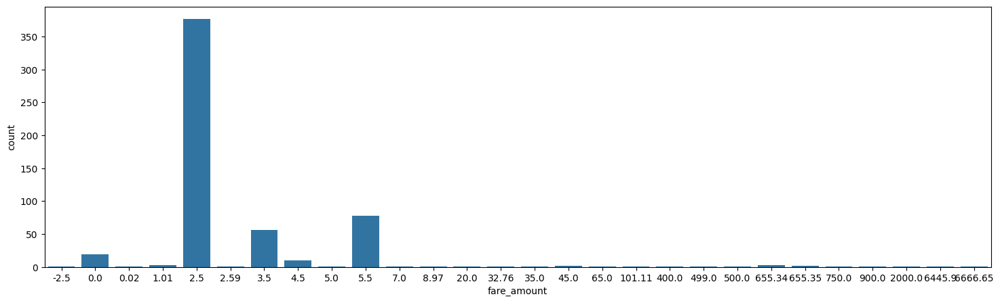

In [65]:
###############################################################
#plot of ratecodeid=6
###############################################################
plt.figure(figsize=(18,5))
sns.countplot(x ='fare_amount', data = df_ratecodeid_6,color=BAR_COLOR_BLUE)
plt.show()

#=>Since TAXI GROUP RIDES(ratecodeid=6) is discontinued and it's a flat fare, 
#our purpose of this project is to predict fare amount, could exclude.

#### 7. store_and_fwd_flag

* Trip count by Store_and_fwd_flag  in 2017 yellow taxi dataset

|No|year|store_and_fwd_flag|trip_count|Percentage|
|:--|:--    |:--        |:--        |:--       |
|1|2017|N|113016482|99.5738631%|
|2|2017|Y|483666|0.4261369%|

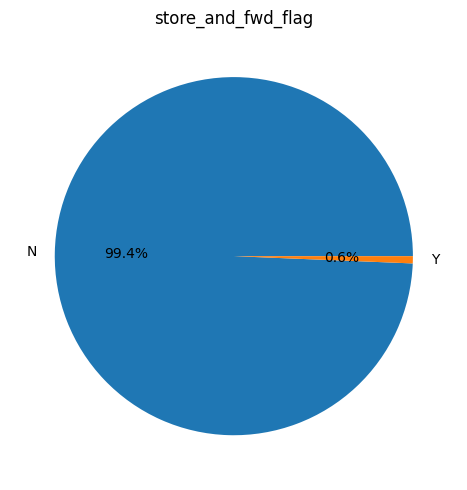

In [66]:
###############################################################
#pie plot of store_and_fwd_flag
###############################################################
plt.figure(figsize=(5,5))
target_data=df_trans
result=target_data.groupby(['store_and_fwd_flag'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
plt.pie(result["ID"],labels = result['store_and_fwd_flag'], autopct='%1.1f%%')
plt.title("store_and_fwd_flag")
plt.tight_layout()
plt.show()

#### 8. PULocationID

* Trip count by pickup borough in 2017 yellow taxi dataset

|No|year|borough|trip_count|Percentage|
|:--|:--|:-- |:--|:--|
|1|2017|Bronx|92530|0.0815241%|
|2|2017|Brooklyn|1563671|1.3776819%|
|3|2017|EWR|8353|0.0073595%|
|4|2017|Manhattan|103080488|90.8196948%|
|5|2017|Outside of NYC(N/A)|56616|0.0498819%|
|6|2017|Queens|6982017|6.1515488%|
|7|2017|Staten Island|2434|0.0021445%|
|8|2017|Unknown|1714039|1.5101646%|

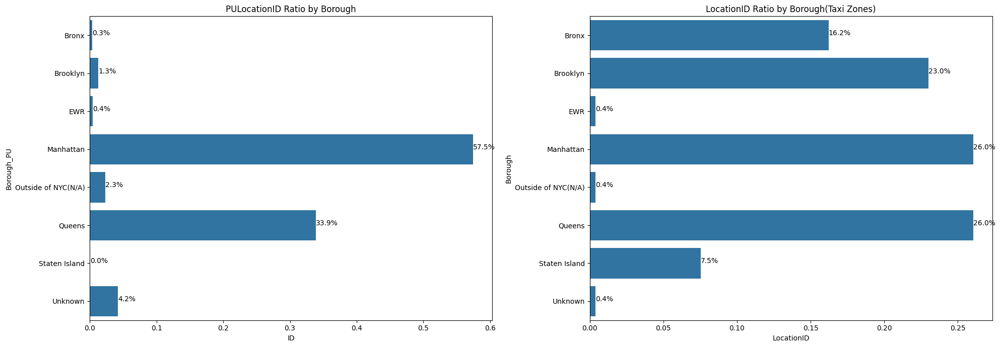

In [67]:
###############################################################
#plot of LocationID by Borough
###############################################################
fig,axs=plt.subplots(1,2,figsize=(20,7))

#taxi trip data
target_data=df_trans
result=target_data.groupby(['Borough_PU'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
ax1=sns.barplot(data=result,y='Borough_PU',x='ID',ax=axs[0],color=BAR_COLOR_BLUE)
for p in ax1.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width())
    x = p.get_x() + p.get_width() 
    y = p.get_y() + p.get_height() / 2
    ax1.annotate(percentage, (x, y))
ax1.set_title("PULocationID Ratio by Borough")

#taxi node zone data
target_data=df_taxizone
result=target_data.groupby(['Borough'])[["LocationID"]].count().reset_index()
result["LocationID"]=result["LocationID"]/target_data.shape[0]
ax2=sns.barplot(data=result,y='Borough',x='LocationID',ax=axs[1],color=BAR_COLOR_BLUE)
for p in ax2.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width())
    x = p.get_x() + p.get_width() 
    y = p.get_y() + p.get_height() / 2
    ax2.annotate(percentage, (x, y))
ax2.set_title("LocationID Ratio by Borough(Taxi Zones)")

plt.tight_layout()
plt.show()

#=>had similar proportion as the population

#### 9. DOLocationID

* Trip count by dropoff Borough in 2017 yellow taxi dataset

|No|year|borough|trip_count|Percentage|
|:--|:--    |:--        |:--        |:--       |
|1|2017|Bronx|685164|0.6036679%|
|2|2017|Brooklyn|5198844|4.5804733%|
|3|2017|EWR|220038|0.1938658%|
|4|2017|Manhattan|99855789|87.9785540%|
|5|2017|Outside of NYC(N/A)|276685|0.2437750%|
|6|2017|Queens|5693928|5.0166701%|
|7|2017|Staten Island|25745|0.0226828%|
|8|2017|Unknown|1543955|1.3603110%|


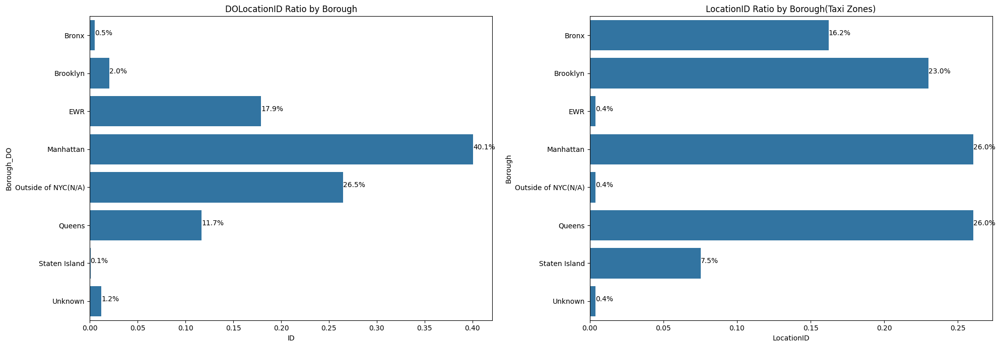

In [68]:
###############################################################
#plot of LocationID by Borough
###############################################################
fig,axs=plt.subplots(1,2,figsize=(20,7))

#taxi trip data
target_data=df_trans
result=target_data.groupby(['Borough_DO'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
ax1=sns.barplot(data=result,y='Borough_DO',x='ID',ax=axs[0],color=BAR_COLOR_BLUE)
for p in ax1.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width())
    x = p.get_x() + p.get_width() 
    y = p.get_y() + p.get_height() / 2
    ax1.annotate(percentage, (x, y))
ax1.set_title("DOLocationID Ratio by Borough")

#taxi node zone data
target_data=df_taxizone
result=target_data.groupby(['Borough'])[["LocationID"]].count().reset_index()
result["LocationID"]=result["LocationID"]/target_data.shape[0]
ax2=sns.barplot(data=result,y='Borough',x='LocationID',ax=axs[1],color=BAR_COLOR_BLUE)
for p in ax2.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width())
    x = p.get_x() + p.get_width() 
    y = p.get_y() + p.get_height() / 2
    ax2.annotate(percentage, (x, y))
ax2.set_title("LocationID Ratio by Borough(Taxi Zones)")

plt.tight_layout()
plt.show()


#### 10. payment_type

* Trip count by Payment_type  in 2017 yellow taxi dataset

|No|year|payment_type|trip_count|Percentage|
|:--|:--    |:--        |:--        |:--       |
|1|2017|1|76246546|67.1774860%|
|2|2017|2|36480516|32.1413819%|
|3|2017|3|599001|0.5277535%|
|4|2017|4|174082|0.1533760%|
|5|2017|5|3|0.0000026%|

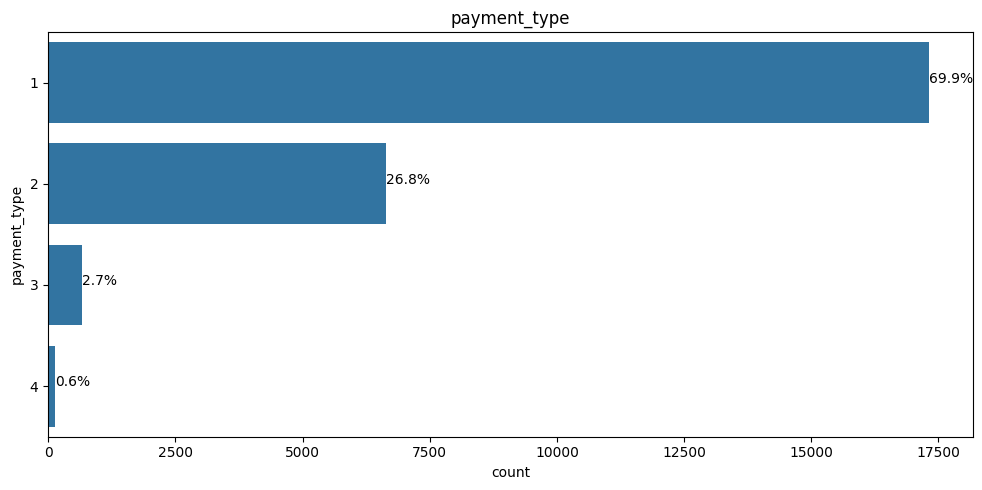

In [69]:
###############################################################
#pie plot of payment_type
###############################################################
plt.figure(figsize=(10,5))
target_data=df_trans
ax=sns.countplot(data=target_data,y='payment_type',color=BAR_COLOR_BLUE)
total=target_data.shape[0]
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width() / total)
    x = p.get_x() + p.get_width() 
    y = p.get_y() + p.get_height() / 2
    ax.annotate(percentage, (x, y))
plt.title("payment_type")
plt.tight_layout()
plt.show()

#### 11. fare_amount

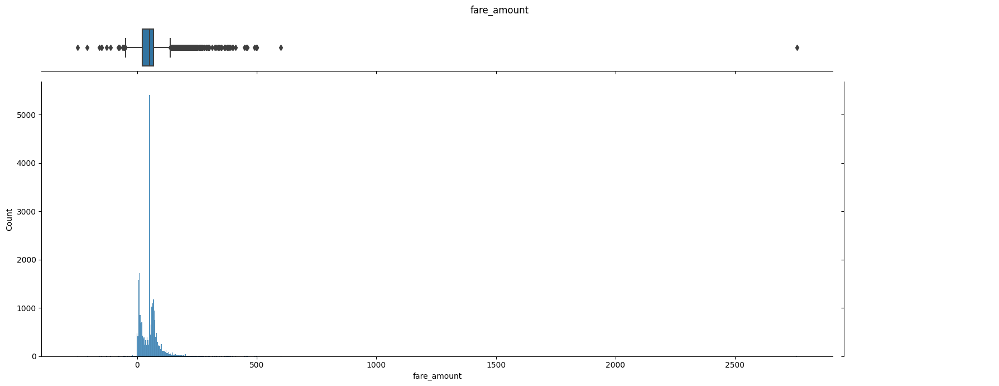

In [70]:
###############################################################
#hist plot of fare_amount
###############################################################
target_data=df_trans
g = sns.JointGrid(data=target_data, x="fare_amount")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("fare_amount")
plt.tight_layout()
plt.show()

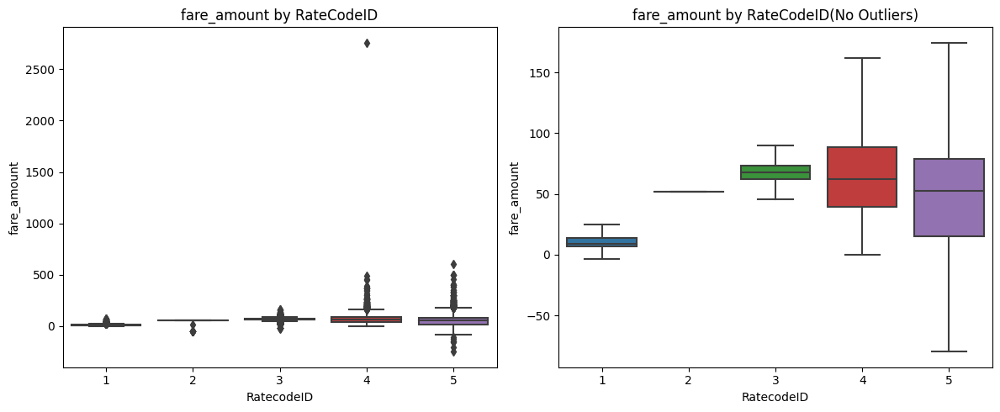

In [71]:
###############################################################
#box plot of fare_amount by RateCodeID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
sns.boxplot(data=target_data, y="fare_amount",x="RatecodeID",ax=axs[0])
axs[0].set_title("fare_amount by RateCodeID")

#no outliers
sns.boxplot(data=target_data, y="fare_amount",x="RatecodeID",ax=axs[1],showfliers=False)
axs[1].set_title("fare_amount by RateCodeID(No Outliers)")

plt.tight_layout()
plt.show()

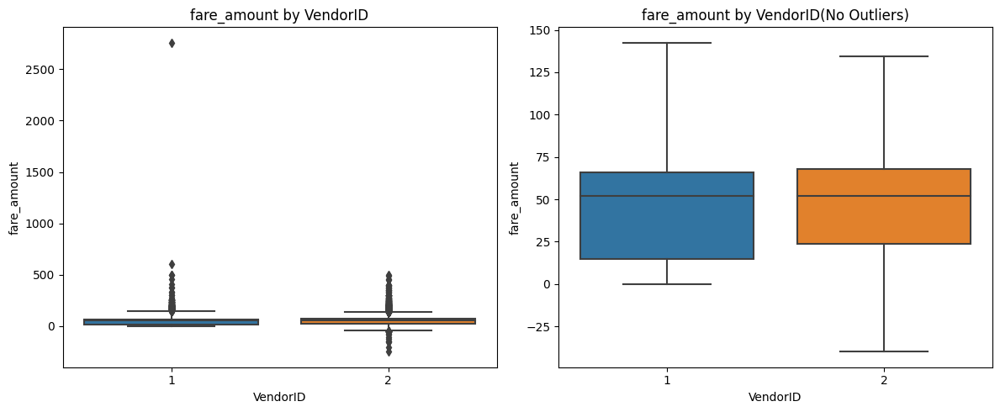

In [72]:
###############################################################
#box plot of fare_amount by VendorID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
sns.boxplot(data=target_data, y="fare_amount",x="VendorID",ax=axs[0])
axs[0].set_title("fare_amount by VendorID")

#no outliers
sns.boxplot(data=target_data, y="fare_amount",x="VendorID",ax=axs[1],showfliers=False)
axs[1].set_title("fare_amount by VendorID(No Outliers)")

plt.tight_layout()
plt.show()
#=>Negative records came from Vendor 2

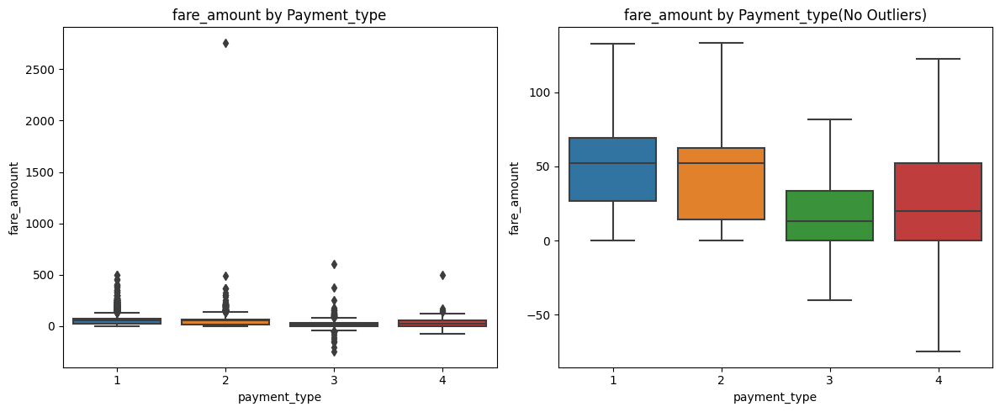

In [73]:
###############################################################
#box plot of fare_amount by Payment_type
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
sns.boxplot(data=target_data, y="fare_amount",x="payment_type",ax=axs[0])
axs[0].set_title("fare_amount by Payment_type")

#no outliers
sns.boxplot(data=target_data, y="fare_amount",x="payment_type",ax=axs[1],showfliers=False)
axs[1].set_title("fare_amount by Payment_type(No Outliers)")

plt.tight_layout()
plt.show()
#=>Negative records came from payment_type 3 and 4

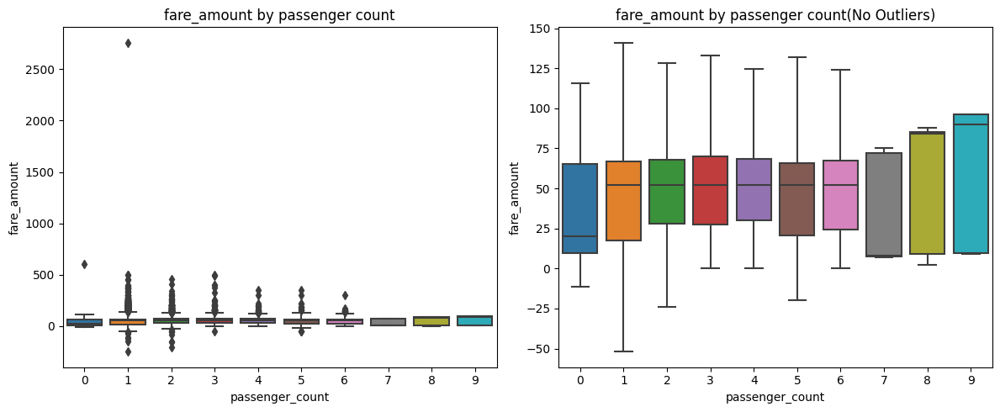

In [74]:
###############################################################
#box plot of fare_amount by passenger_count
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
sns.boxplot(data=target_data, y="fare_amount",x="passenger_count",ax=axs[0])
axs[0].set_title("fare_amount by passenger count")

#no outliers
sns.boxplot(data=target_data, y="fare_amount",x="passenger_count",ax=axs[1],showfliers=False)
axs[1].set_title("fare_amount by passenger count(No Outliers)")

plt.tight_layout()
plt.show()

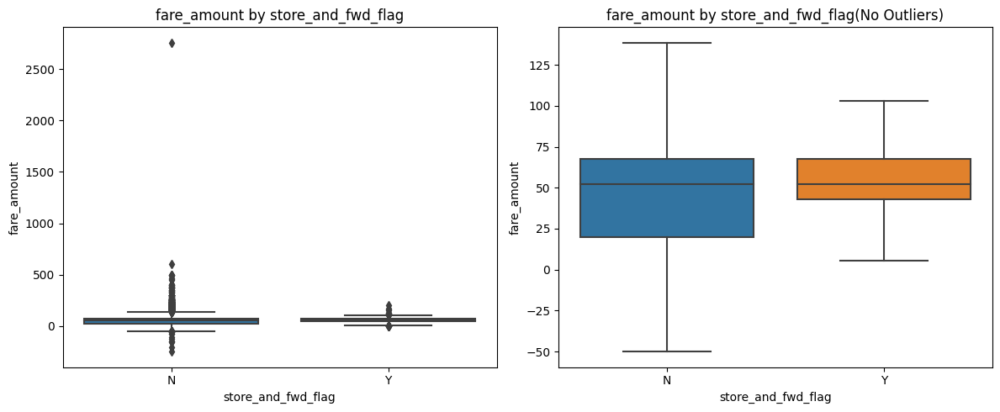

In [75]:
###############################################################
#box plot of fare_amount by store_and_fwd_flag
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
sns.boxplot(data=target_data, y="fare_amount",x="store_and_fwd_flag",ax=axs[0])
axs[0].set_title("fare_amount by store_and_fwd_flag")

#no outliers
sns.boxplot(data=target_data, y="fare_amount",x="store_and_fwd_flag",ax=axs[1],showfliers=False)
axs[1].set_title("fare_amount by store_and_fwd_flag(No Outliers)")

plt.tight_layout()
plt.show()

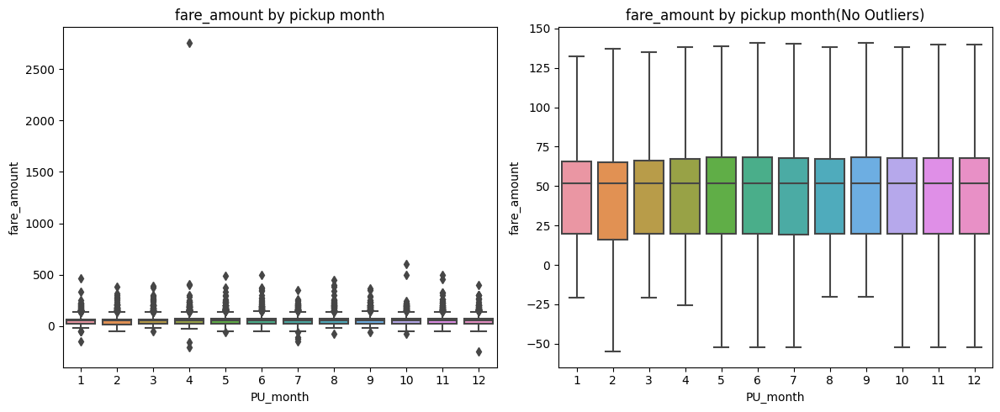

In [76]:
###############################################################
#box plot of fare_amount by pickup month
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
sns.boxplot(data=target_data, y="fare_amount",x="PU_month",ax=axs[0])
axs[0].set_title("fare_amount by pickup month")

#no outliers
sns.boxplot(data=target_data, y="fare_amount",x="PU_month",ax=axs[1],showfliers=False)
axs[1].set_title("fare_amount by pickup month(No Outliers)")

plt.tight_layout()
plt.show()

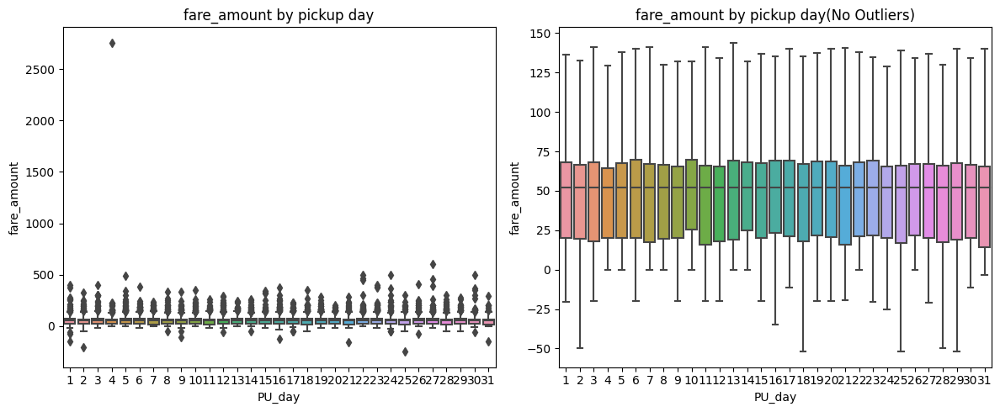

In [77]:
###############################################################
#box plot of fare_amount by pickup day
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
sns.boxplot(data=target_data, y="fare_amount",x="PU_day",ax=axs[0])
axs[0].set_title("fare_amount by pickup day")

#no outliers
sns.boxplot(data=target_data, y="fare_amount",x="PU_day",ax=axs[1],showfliers=False)
axs[1].set_title("fare_amount by pickup day(No Outliers)")

plt.tight_layout()
plt.show()

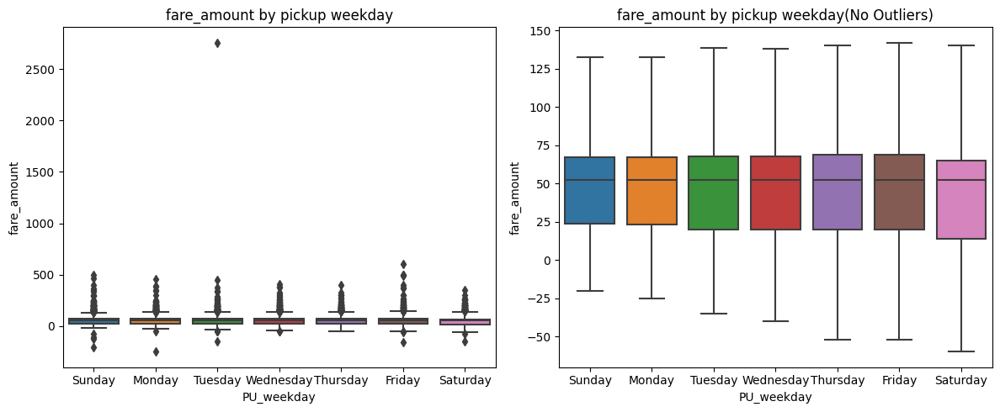

In [78]:
###############################################################
#box plot of fare_amount by pickup weekday
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
sns.boxplot(data=target_data, y="fare_amount",x="PU_weekday",ax=axs[0])
axs[0].set_title("fare_amount by pickup weekday")

#no outliers
sns.boxplot(data=target_data, y="fare_amount",x="PU_weekday",ax=axs[1],showfliers=False)
axs[1].set_title("fare_amount by pickup weekday(No Outliers)")

plt.tight_layout()
plt.show()

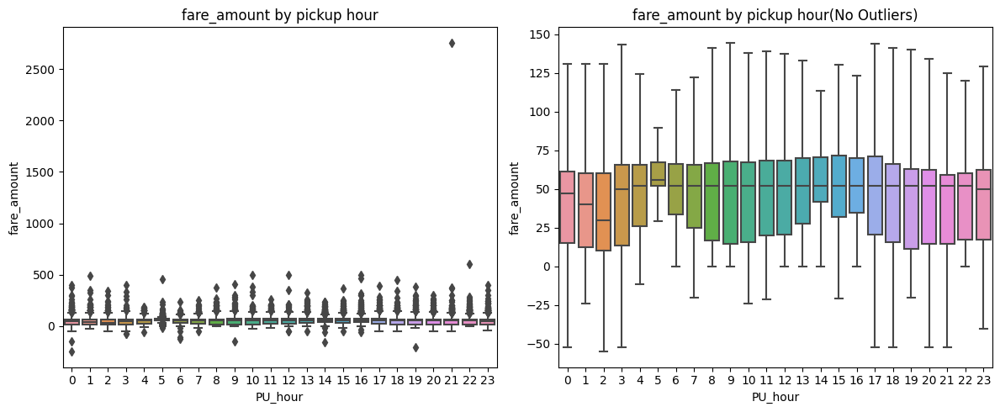

In [79]:
###############################################################
#box plot of fare_amount by pickup hour
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
sns.boxplot(data=target_data, y="fare_amount",x="PU_hour",ax=axs[0])
axs[0].set_title("fare_amount by pickup hour")

#no outliers
sns.boxplot(data=target_data, y="fare_amount",x="PU_hour",ax=axs[1],showfliers=False)
axs[1].set_title("fare_amount by pickup hour(No Outliers)")

plt.tight_layout()
plt.show()

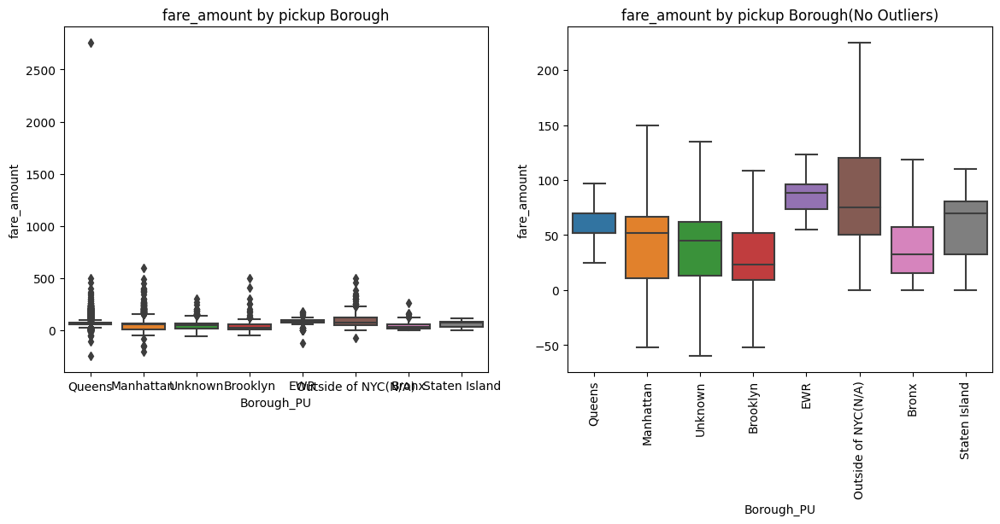

In [80]:
###############################################################
#box plot of fare_amount by pickup Borough
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
sns.boxplot(data=target_data, y="fare_amount",x="Borough_PU",ax=axs[0])
axs[0].set_title("fare_amount by pickup Borough")

#no outliers
sns.boxplot(data=target_data, y="fare_amount",x="Borough_PU",ax=axs[1],showfliers=False)
axs[1].set_title("fare_amount by pickup Borough(No Outliers)")

plt.tight_layout()
plt.xticks(rotation=90)
plt.show()

#### 12. extra

* Standard Metered Fare

    * Plus \\$1.00(2017 was \\$0.5) overnight surcharge 8pm to 6am.
    * Plus \\$2.50(2017 was \\$1.0) rush hour surcharge from 4pm to 8pm on weekdays, excluding holidays.

* Manhattan and John F. Kennedy Airport (JFK) 
    * \\$5.00(2017 was \\$4.5) rush hour surcharge (4pm to 8pm weekdays, excluding legal holidays).
    


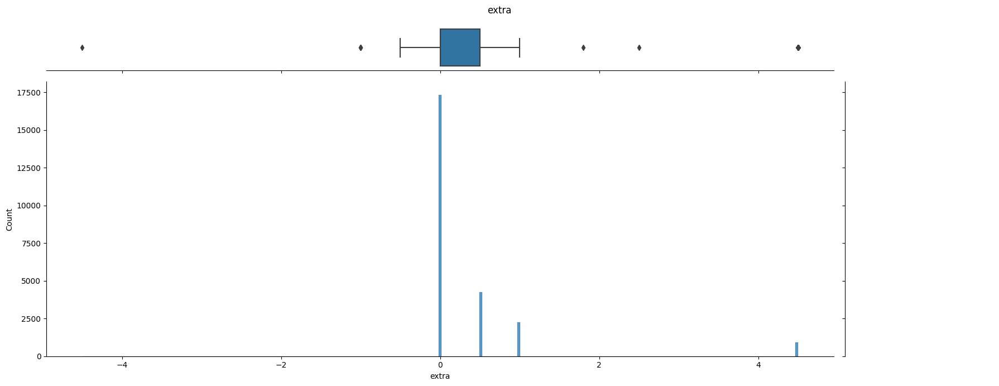

In [81]:
###############################################################
#hist plot of extra
###############################################################
target_data=df_trans
g = sns.JointGrid(data=target_data, x="extra")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("extra")
plt.tight_layout()
plt.show()

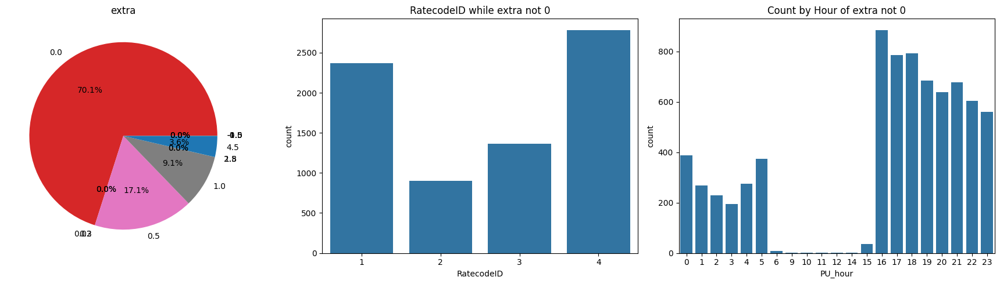

In [82]:
fig,axs=plt.subplots(1,3,figsize=(18,5))
###############################################################
#pie plot of extra
###############################################################
target_data=df_trans
result=target_data.groupby(['extra'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[0].pie(result["ID"],labels = result['extra'], autopct='%1.1f%%')
axs[0].set_title("extra")

###############################################################
#pie plot of RateCodeID while extra<>0
###############################################################
target_data=df_trans[df_trans['extra']!=0]
sns.countplot(data=target_data,x='RatecodeID',ax=axs[1],color=BAR_COLOR_BLUE)
axs[1].set_title("RatecodeID while extra not 0")


###############################################################
#count plot of extra
###############################################################
target_data=df_trans[df_trans['extra']!=0]
sns.countplot(data=target_data,x='PU_hour',ax=axs[2],color=BAR_COLOR_BLUE)
axs[2].set_title("Count by Hour of extra not 0")

plt.tight_layout()
plt.show()


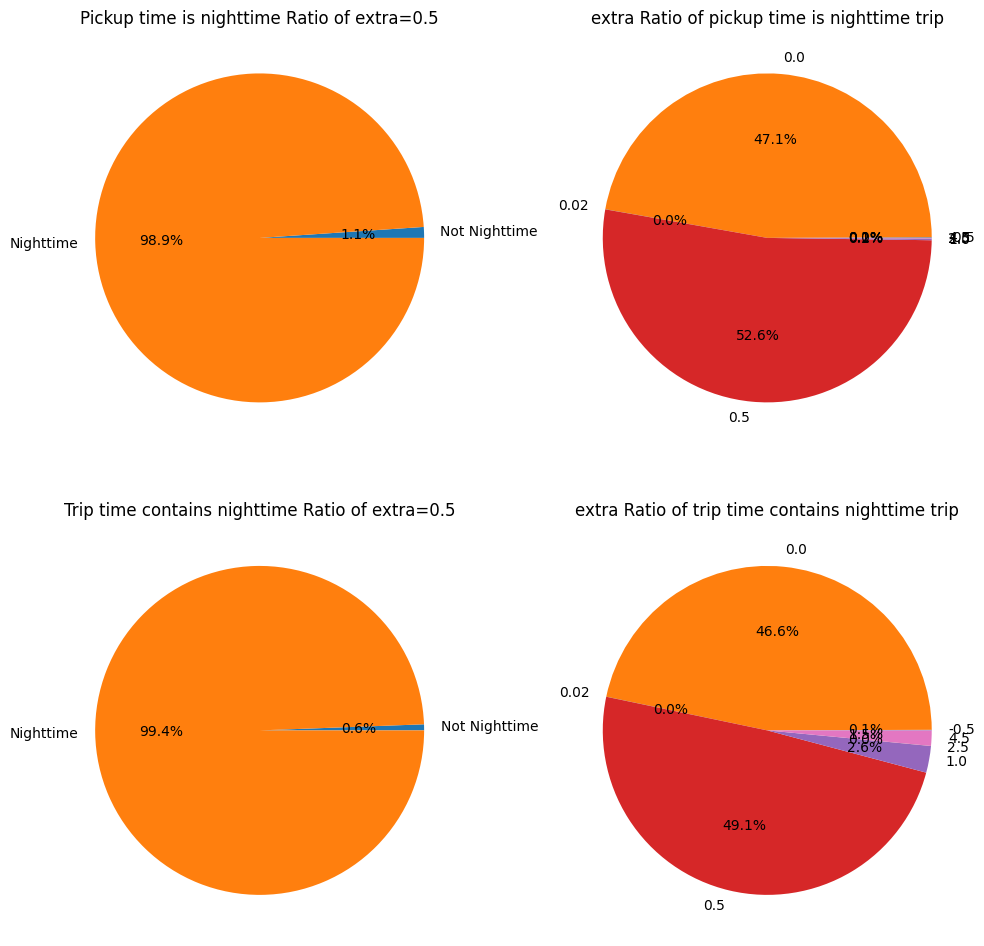

In [83]:
fig,axs=plt.subplots(2,2,figsize=(10,10))


###############################################################
#Pie plot of Extra=0.5
###############################################################
mask=df_trans['extra']==0.5
target_data=df_trans[mask]
#check if tpep_pickup_datetime is nighttime
target_data['nighttime']=target_data[['tpep_pickup_datetime']].apply(lambda x: check_nighttime(x["tpep_pickup_datetime"]), axis=1)

label_dict={True:'Nighttime',False:'Not Nighttime'}
result=target_data.groupby(['nighttime'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[0][0].pie(result["ID"],labels = result['nighttime'].map(label_dict), autopct='%1.1f%%')
axs[0][0].set_title("Pickup time is nighttime Ratio of extra=0.5")

###############################################################
#Pie plot of Nighttime
###############################################################
#sns.countplot(data=target_data,x='PU_hour',ax=axs[1])
#axs[1].set_title("Count by Hour of extra=0.5")
target_data=df_trans
target_data['nighttime']=target_data[['tpep_pickup_datetime']].apply(lambda x: check_nighttime(x["tpep_pickup_datetime"]), axis=1)
mask=target_data['nighttime']==True
target_data=target_data[mask]

result=target_data.groupby(['extra'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]

axs[0][1].pie(result["ID"],labels = result['extra'], autopct='%1.1f%%')
axs[0][1].set_title("extra Ratio of pickup time is nighttime trip")


###############################################################
#Pie plot of Extra=0.5
###############################################################
mask=df_trans['extra']==0.5
target_data=df_trans[mask]
#check if tpep_pickup_datetime and tpep_dropoff_datetime contains nighttime
target_data['nighttime']=target_data[['tpep_pickup_datetime','tpep_dropoff_datetime']].apply(lambda x: check_nighttime_both(x["tpep_pickup_datetime"],x["tpep_dropoff_datetime"]), axis=1)

label_dict={True:'Nighttime',False:'Not Nighttime'}
result=target_data.groupby(['nighttime'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[1][0].pie(result["ID"],labels = result['nighttime'].map(label_dict), autopct='%1.1f%%')
axs[1][0].set_title("Trip time contains nighttime Ratio of extra=0.5")

###############################################################
#Pie plot of Nighttime
###############################################################
target_data=df_trans
target_data['nighttime']=target_data[['tpep_pickup_datetime','tpep_dropoff_datetime']].apply(lambda x: check_nighttime_both(x["tpep_pickup_datetime"],x["tpep_dropoff_datetime"]), axis=1)
mask=target_data['nighttime']==True
target_data=target_data[mask]

result=target_data.groupby(['extra'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]

axs[1][1].pie(result["ID"],labels = result['extra'], autopct='%1.1f%%')
axs[1][1].set_title("extra Ratio of trip time contains nighttime trip")

plt.tight_layout()
plt.show()


#=>When use UTC, most extra(more than 95%) were correct, after convert timezone to New York
#most extra were not correct(The timezone setting of this dataset might be localtime)

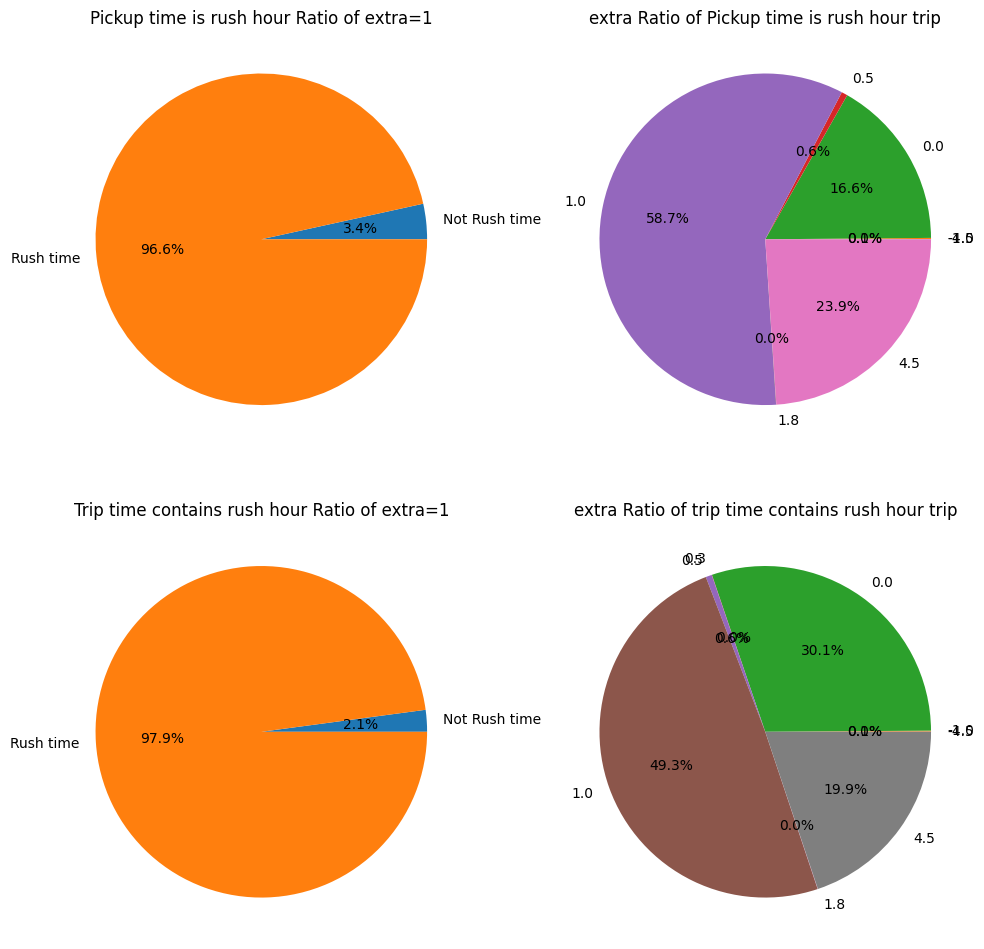

In [84]:
fig,axs=plt.subplots(2,2,figsize=(10,10))

#NYC Holidays (Federal and State holiday of New York in 2017,except weekend)
NYC_HOLIDAY_LIST=df_nyc_holiday['Date'].to_list()
###############################################################
#Pie plot of Extra=1
###############################################################
mask=df_trans['extra']==1
target_data=df_trans[mask]
#check if tpep_pickup_datetime is rushhour
target_data['rushhour']=target_data[['tpep_pickup_datetime']].apply(lambda x: check_rush_hour(x["tpep_pickup_datetime"],NYC_HOLIDAY_LIST), axis=1)

label_dict={True:'Rush time',False:'Not Rush time'}
result=target_data.groupby(['rushhour'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[0][0].pie(result["ID"],labels = result['rushhour'].map(label_dict), autopct='%1.1f%%')
axs[0][0].set_title("Pickup time is rush hour Ratio of extra=1")

###############################################################
#Pie plot of rush hour
###############################################################

target_data=df_trans
target_data['rushhour']=target_data[['tpep_pickup_datetime']].apply(lambda x: check_rush_hour(x["tpep_pickup_datetime"],NYC_HOLIDAY_LIST), axis=1)
mask=target_data['rushhour']==True
target_data=target_data[mask]

result=target_data.groupby(['extra'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]

axs[0][1].pie(result["ID"],labels = result['extra'], autopct='%1.1f%%')
axs[0][1].set_title("extra Ratio of Pickup time is rush hour trip")


###############################################################
#Pie plot of Extra=1
###############################################################
mask=df_trans['extra']==1
target_data=df_trans[mask]
#check if tpep_pickup_datetime and tpep_dropoff_datetime contains rushhour
target_data['rushhour']=target_data[['tpep_pickup_datetime','tpep_dropoff_datetime']].apply(lambda x: check_rush_hour_both(x["tpep_pickup_datetime"],x["tpep_dropoff_datetime"],NYC_HOLIDAY_LIST), axis=1)

label_dict={True:'Rush time',False:'Not Rush time'}
result=target_data.groupby(['rushhour'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
axs[1][0].pie(result["ID"],labels = result['rushhour'].map(label_dict), autopct='%1.1f%%')
axs[1][0].set_title("Trip time contains rush hour Ratio of extra=1")


###############################################################
#Pie plot of rush hour
###############################################################

target_data=df_trans
target_data['rushhour']=target_data[['tpep_pickup_datetime','tpep_dropoff_datetime']].apply(lambda x: check_rush_hour_both(x["tpep_pickup_datetime"],x["tpep_dropoff_datetime"],NYC_HOLIDAY_LIST), axis=1)
mask=target_data['rushhour']==True
target_data=target_data[mask]

result=target_data.groupby(['extra'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
extra_explode = (0, 0, 0,0,0)
axs[1][1].pie(result["ID"],labels = result['extra'], autopct='%1.1f%%')
axs[1][1].set_title("extra Ratio of trip time contains rush hour trip")


plt.tight_layout()
plt.show()

#### 13. mta_tax

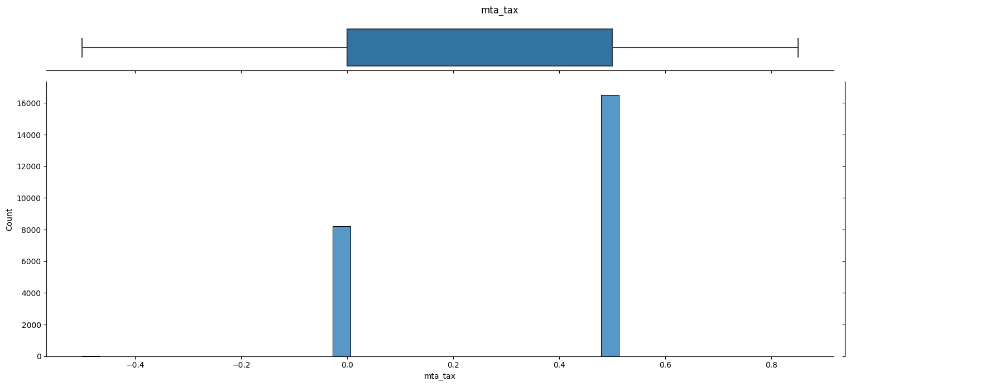

In [85]:
###############################################################
#hist plot of mta_tax
###############################################################
target_data=df_trans
g = sns.JointGrid(data=target_data, x="mta_tax")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("mta_tax")
plt.tight_layout()
plt.show()
#=>has negative values

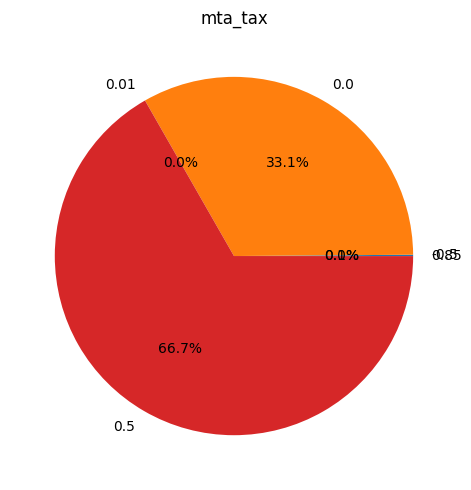

In [86]:
###############################################################
#pie plot of mta_tax
###############################################################
plt.figure(figsize=(5,5))
target_data=df_trans
result=target_data.groupby(['mta_tax'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
plt.pie(result["ID"],labels = result['mta_tax'], autopct='%1.1f%%')
plt.title("mta_tax")
plt.tight_layout()
plt.show()

#### 14. tip_amount

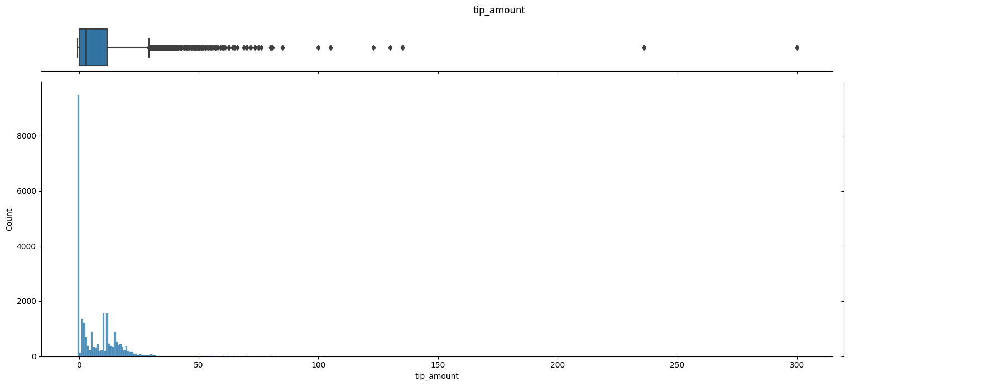

In [87]:
###############################################################
#hist plot of tip_amount
###############################################################
target_data=df_trans
g = sns.JointGrid(data=target_data, x="tip_amount")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("tip_amount")
plt.tight_layout()
plt.show()

#### 15. tolls_amount

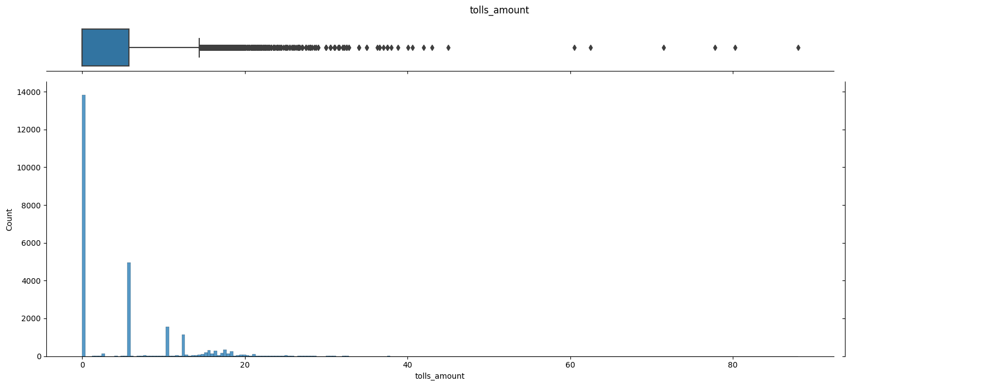

In [88]:
###############################################################
#hist plot of tolls_amount
###############################################################
target_data=df_trans
g = sns.JointGrid(data=target_data, x="tolls_amount")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("tolls_amount")
plt.tight_layout()
plt.show()

#### 16. improvement_surcharge

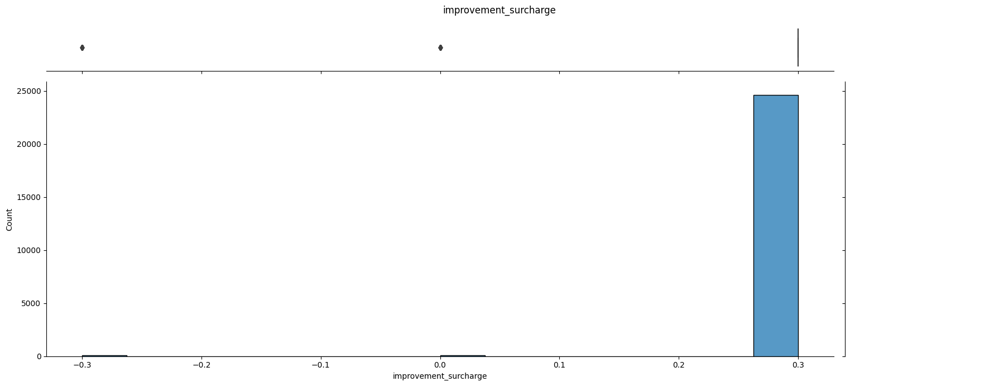

In [89]:
###############################################################
#hist plot of tolls_amount
###############################################################
target_data=df_trans
g = sns.JointGrid(data=target_data, x="improvement_surcharge")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("improvement_surcharge")
plt.tight_layout()
plt.show()
#=>has negative values

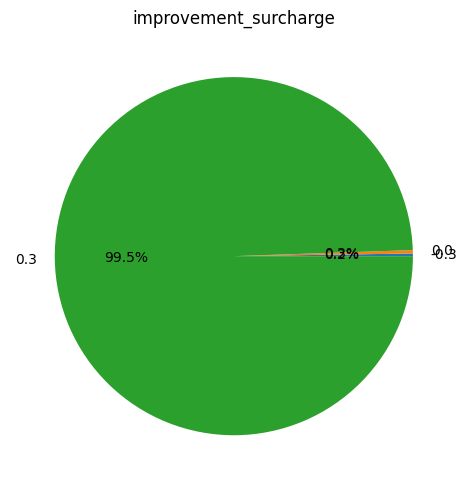

In [90]:
###############################################################
#pie plot of improvement_surcharge
###############################################################
plt.figure(figsize=(5,5))
target_data=df_trans
result=target_data.groupby(['improvement_surcharge'])[["ID"]].count().reset_index()
result["ID"]=result["ID"]/target_data.shape[0]
plt.pie(result["ID"],labels = result['improvement_surcharge'], autopct='%1.1f%%')
plt.title("improvement_surcharge")
plt.tight_layout()
plt.show()

#### 17. total_amount

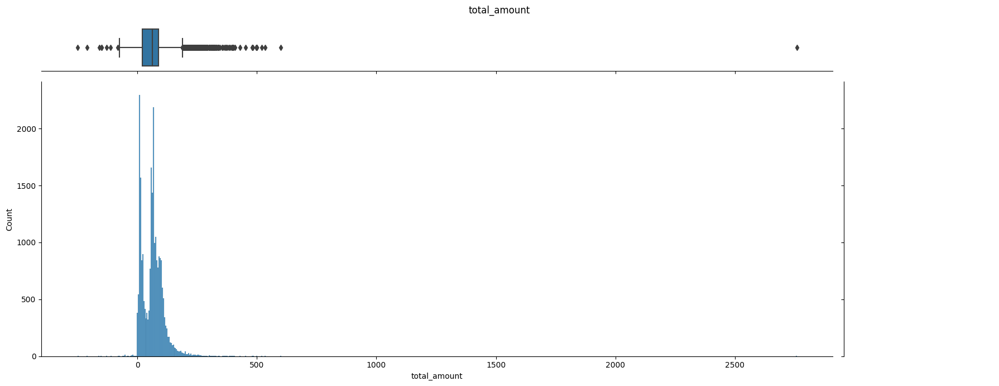

In [91]:
###############################################################
#hist plot of tolls_amount
###############################################################
target_data=df_trans
g = sns.JointGrid(data=target_data, x="total_amount")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("total_amount")
plt.tight_layout()
plt.show()

#### Check relation

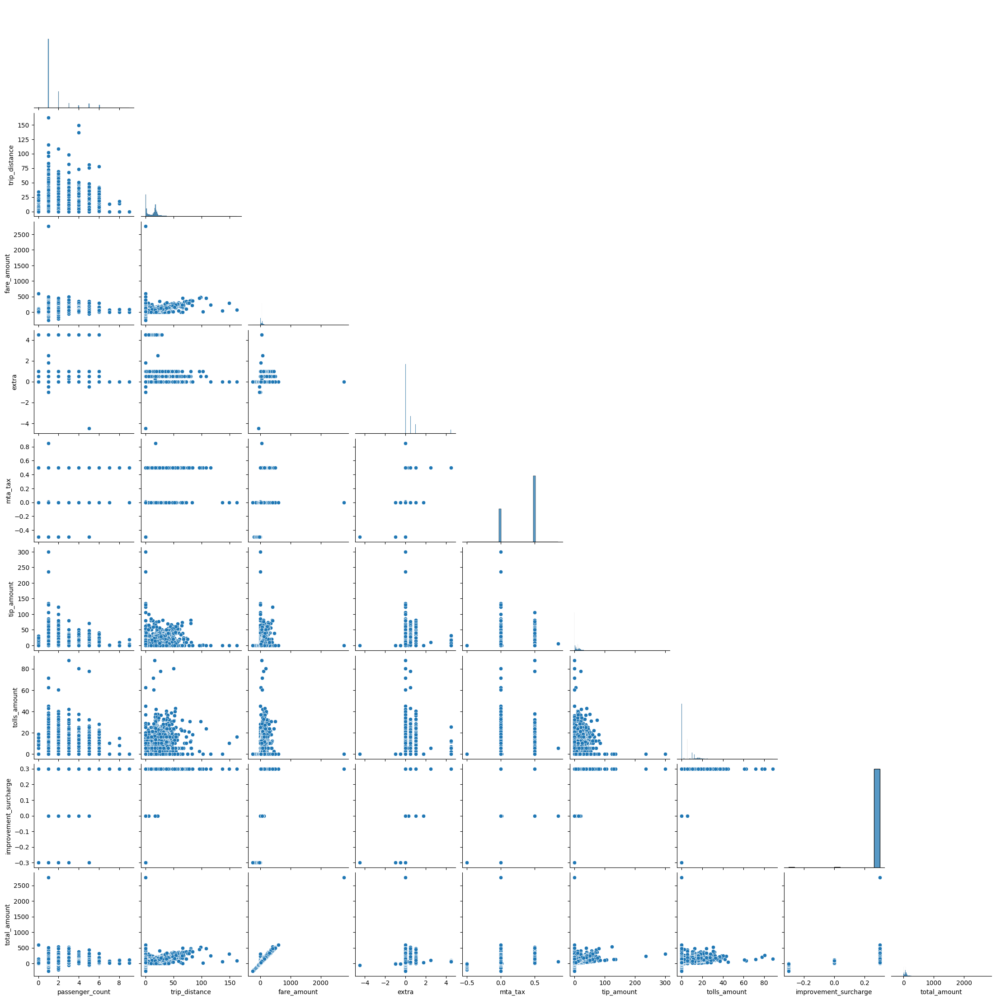

In [92]:
target_data=df_trans
target_col=['passenger_count','trip_distance','fare_amount', 'extra',
       'mta_tax', 'tip_amount', 'tolls_amount', 'improvement_surcharge',
       'total_amount']
sns.pairplot(target_data[target_col],corner=True)
plt.show()

In [93]:
target_data=df_trans
target_col=['passenger_count','trip_distance','fare_amount','temperature_2m (°C)','rain (mm)','snowfall (cm)','wind_speed_10m (km/h)']
target_data[target_col].corr(method='spearman')

,passenger_count,trip_distance,fare_amount,temperature_2m (°C),rain (mm),snowfall (cm),wind_speed_10m (km/h)
passenger_count,1.000000,0.067254,0.039926,0.009233,-0.010184,-0.006565,0.006915
trip_distance,0.067254,1.000000,0.654330,0.029772,-0.009242,-0.007649,0.022795
fare_amount,0.039926,0.654330,1.000000,0.038218,-0.011411,-0.007924,0.028329
temperature_2m (°C),0.009233,0.029772,0.038218,1.000000,0.067087,-0.164510,-0.079496
rain (mm),-0.010184,-0.009242,-0.011411,0.067087,1.000000,-0.014002,0.106599
snowfall (cm),-0.006565,-0.007649,-0.007924,-0.164510,-0.014002,1.000000,0.016209
wind_speed_10m (km/h),0.006915,0.022795,0.028329,-0.079496,0.106599,0.016209,1.000000


### Create duration column

Create a new column called `duration` that represents the total number of minutes that each taxi ride took.

In [94]:
#######################################
# Create `duration` column
#######################################
#total number of minutes that each taxi ride took

# in some version it works
#df_trans['duration']=(df_trans['tpep_dropoff_datetime']-df_trans['tpep_pickup_datetime']).astype('timedelta64[m]')
# in some version this works
df_trans['duration']=round((df_trans['tpep_dropoff_datetime']-df_trans['tpep_pickup_datetime']).dt.total_seconds()/60,3)

#######################################
# Create `duration_sec` column
#######################################
#total number of seconds that each taxi ride took
#df_trans['duration_sec']=(df_trans['tpep_dropoff_datetime']-df_trans['tpep_pickup_datetime']).astype('timedelta64[s]')
df_trans['duration_sec']=(df_trans['tpep_dropoff_datetime']-df_trans['tpep_pickup_datetime']).dt.total_seconds()

df_trans[['duration','duration_sec']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24755 entries, 0 to 24754
Data columns (total 2 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   duration      24755 non-null  float64
 1   duration_sec  24755 non-null  float64
dtypes: float64(2)
memory usage: 386.9 KB


In [95]:
# Create `avg_speed` column (Miles/Hour)
df_trans['avg_speed']=df_trans[['trip_distance','duration_sec']].apply(lambda x: compute_avg_speed(x["trip_distance"],x["duration_sec"]), axis=1)
print(df_trans[['avg_speed']].info())
df_trans['avg_speed'].describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24755 entries, 0 to 24754
Data columns (total 1 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   avg_speed  24755 non-null  float64
dtypes: float64(1)
memory usage: 193.5 KB
None


count    24755.000000
mean        51.462331
std        607.872170
min          0.000000
25%          9.915960
50%         20.715215
75%         31.087419
max      44910.000000
Name: avg_speed, dtype: float64

In [96]:
#df_trans.to_csv('taxi_trans_equal_ratecodeid.csv', index=False)

#### Duration

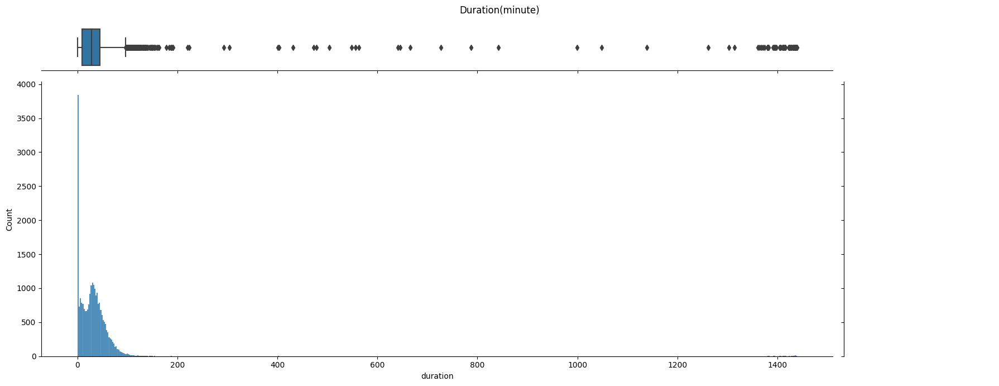

In [97]:
###############################################################
#hist plot of Duration
###############################################################
target_data=df_trans
g = sns.JointGrid(data=target_data, x="duration")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("Duration(minute)")
plt.tight_layout()
plt.show()

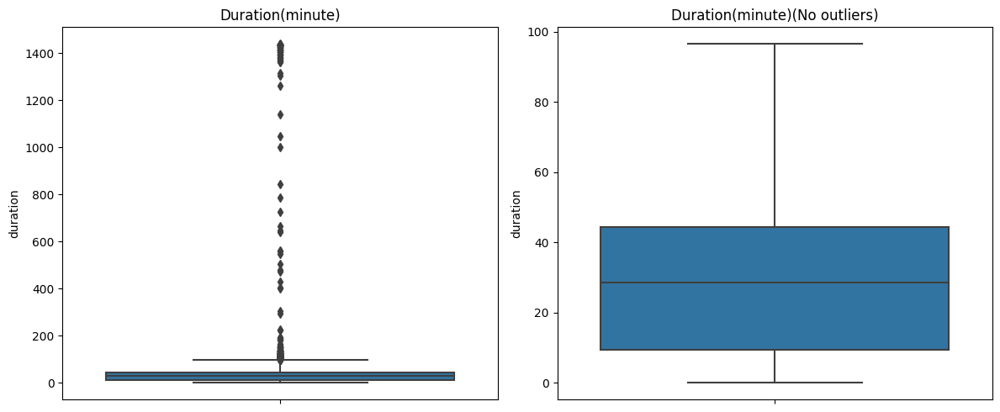

In [98]:
###############################################################
#Box plot of Duration
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="duration",ax=axs[0])
axs[0].set_title("Duration(minute)")

#no outliers
sns.boxplot(data=target_data, y="duration",ax=axs[1],showfliers=False)
axs[1].set_title("Duration(minute)(No outliers)")

plt.tight_layout()
plt.show()

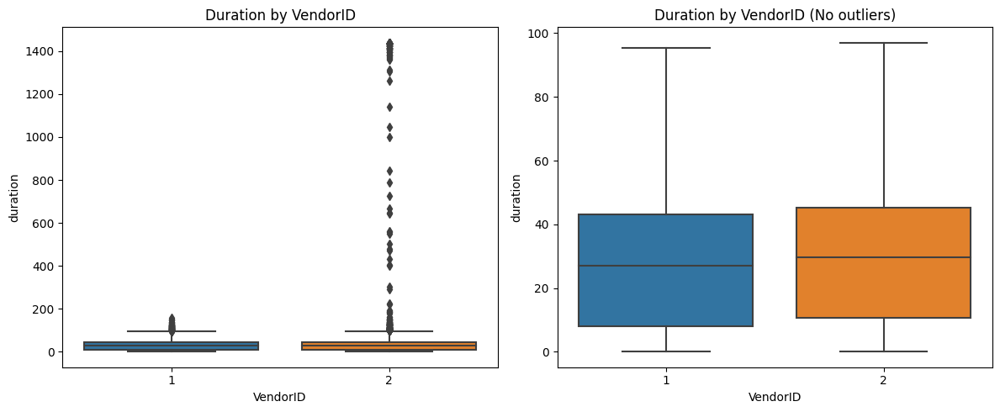

In [99]:
###############################################################
#Box plot of duration by VendorID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="duration",x="VendorID",ax=axs[0])
axs[0].set_title("Duration by VendorID")

#no outliers
sns.boxplot(data=target_data, y="duration",x="VendorID",ax=axs[1],showfliers=False)
axs[1].set_title("Duration by VendorID (No outliers)")

plt.tight_layout()
plt.show()

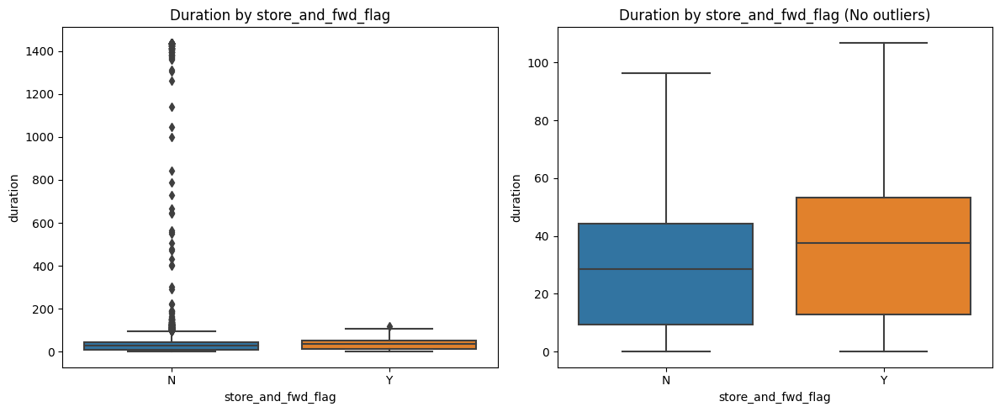

In [100]:
###############################################################
#Box plot of duration by store_and_fwd_flag
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="duration",x="store_and_fwd_flag",ax=axs[0])
axs[0].set_title("Duration by store_and_fwd_flag")

#no outliers
sns.boxplot(data=target_data, y="duration",x="store_and_fwd_flag",ax=axs[1],showfliers=False)
axs[1].set_title("Duration by store_and_fwd_flag (No outliers)")

plt.tight_layout()
plt.show()

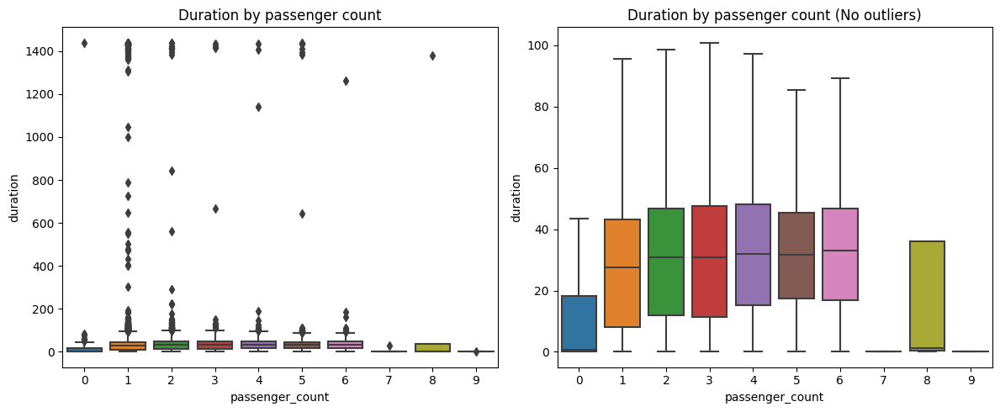

In [101]:
###############################################################
#Box plot of duration by passenger_count
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="duration",x="passenger_count",ax=axs[0])
axs[0].set_title("Duration by passenger count")

#no outliers
sns.boxplot(data=target_data, y="duration",x="passenger_count",ax=axs[1],showfliers=False)
axs[1].set_title("Duration by passenger count (No outliers)")

plt.tight_layout()
plt.show()

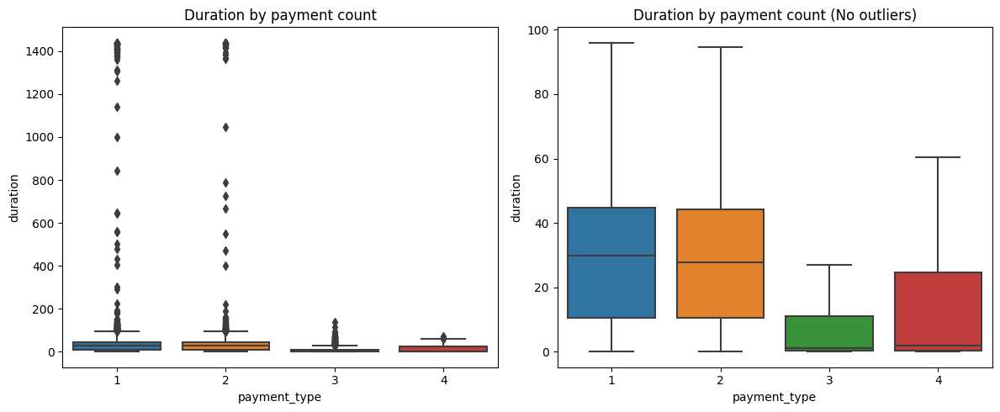

In [102]:
###############################################################
#Box plot of duration by Payment_type
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="duration",x="payment_type",ax=axs[0])
axs[0].set_title("Duration by payment count")

#no outliers
sns.boxplot(data=target_data, y="duration",x="payment_type",ax=axs[1],showfliers=False)
axs[1].set_title("Duration by payment count (No outliers)")

plt.tight_layout()
plt.show()

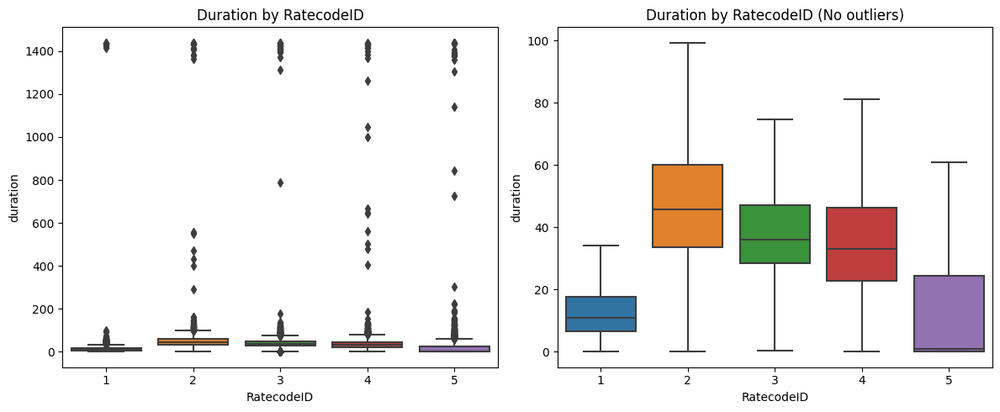

In [103]:
###############################################################
#Box plot of duration by RatecodeID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="duration",x="RatecodeID",ax=axs[0])
axs[0].set_title("Duration by RatecodeID")

#no outliers
sns.boxplot(data=target_data, y="duration",x="RatecodeID",ax=axs[1],showfliers=False)
axs[1].set_title("Duration by RatecodeID (No outliers)")

plt.tight_layout()
plt.show()

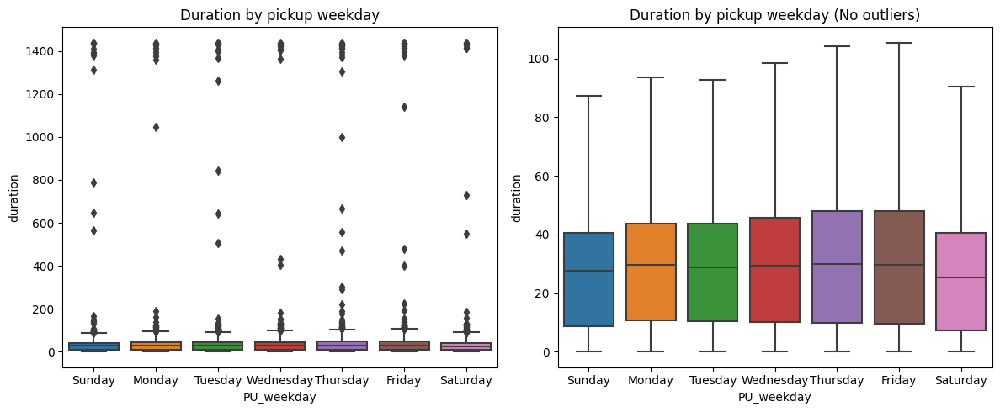

In [104]:
###############################################################
#Box plot of duration by pickup weekday
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="duration",x="PU_weekday",ax=axs[0])
axs[0].set_title("Duration by pickup weekday")

#no outliers
sns.boxplot(data=target_data, y="duration",x="PU_weekday",ax=axs[1],showfliers=False)
axs[1].set_title("Duration by pickup weekday (No outliers)")

plt.tight_layout()
plt.show()

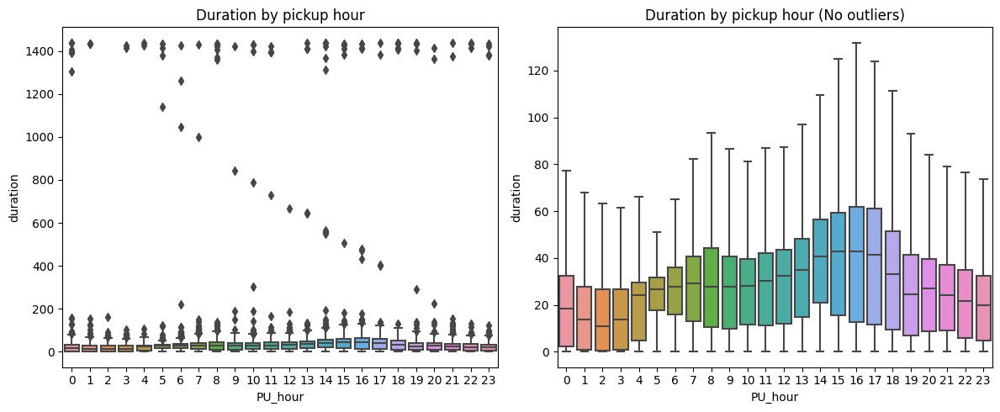

In [105]:
###############################################################
#Box plot of duration by pickup hour
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="duration",x="PU_hour",ax=axs[0])
axs[0].set_title("Duration by pickup hour")

#no outliers
sns.boxplot(data=target_data, y="duration",x="PU_hour",ax=axs[1],showfliers=False)
axs[1].set_title("Duration by pickup hour (No outliers)")

plt.tight_layout()
plt.show()

#### Average Speed(MPH)

* Yellow taxicabs are the iconic, yellow vehicles that have the right to pick up street-hailing passengers anywhere in New York City. Taxis can also be dispatched by TLC-licensed E-Hail companies. By law, there are 13,587 taxis in New York City and each taxi must have a medallion affixed to it. **Vehicles can be owned by drivers or leased to them by licensed garages**. Grant funding is available for wheelchair accessible taxis.  [Yellow Taxicabs](https://www.nyc.gov/site/tlc/vehicles/get-a-vehicle-license.page)

* Optional Gasoline Surcharge: An Owner/lessor, or his or her Agent leasing a Taxicab under 35 RCNY § 58-21(c)(1) or 58-21(c)(2), may chose to provide gasoline to a lessee and charge a gas surcharge in an amount as specified in this section in addition to the Lease Cap provided in 35 RCNY § 58-21(c)(1) or 58-21(c)(2), provided that [NEW YORK CITY TAXI AND LIMOUSINE COMMISSION](https://www.nyc.gov/assets/tlc/downloads/pdf/newly_passed_rules_leasecap_tot_comb.pdf)

    * (i)Gasoline is provided to the lessee for the **entire shift** at no additional cost to the lessee.
    * (ii)The surcharge will be \\$126 per week (or \\$21 per shift) until December 31, 2012
    * (iii)After that date the surcharge will be reset based on the trailing 6 month average as of the date the surcharge is calculated of the New York City Gasoline Price Index issued by U.S. Energy Information Agency and published at www.eia.gov.
    * (iv)The surcharge will be calculated as of June 30 and November 30 of each year beginning November 30, 2012. 
    * (v) The Commission will post the new surcharge on its Web site by July 15 and December 15 of each year
    * (vi)The new surcharge will take effect on July 31 and December 31 of each year beginning December 31, 2012. If the Commission has not posted a new surcharge, the prior surcharge will remain in effect. 
    * (vii)Based on the index, the surcharge will be as follows:
    
|When the Index is:|The surcharge for Hybrid Electric and Diesel-Fueled taxicabs will be:|The surcharge for all other taxicabs will be:|
|:--|:--|:--|
|\\$2.49 or less   |\\$13 per shift (or \\$78 per week) |\\$16 per shift (or \\$96 per week) |
|\\$2.50 to \\$2.99|\\$16 per shift (or \\$96 per week) |\\$19 per shift (or \\$114 per week)|
|\\$3.00 to \\$3.49|\\$18 per shift (or \\$108 per week)|\\$21 per shift (or \\$126 per week)|
|\\$3.50 to \\$3.99|\\$21 per shift (or \\$126 per week)|\\$24 per shift (or \\$144 per week)|
|\\$4.00 to \\$4.49|\\$23 per shift (or \\$138 per week)|\\$26 per shift (or \\$156 per week)|
|\\$4.50 to \\$4.99|\\$26 per shift (or \\$156 per week)|\\$29 per shift (or \\$174 per week)|
|\\$5.00 or more   |\\$28 per shift (or \\$168 per week)|\\$31 per shift (or \\$186 per week)|


* The lease of a medallion and vehicle under this paragraph 35 RCNY § 58-21(c)(2) includes service and maintenance. **Service and maintenance of the vehicle is the responsibility of the lessor and the lessor and his or her Agent must not charge the lessee for service and maintenance costs for the vehicle.**

* The lessee of a medallion and vehicle under this paragraph 35 RCNY § 58-21(c)(1) is not responsible for payment of any Commercial Motor Vehicle Tax.

* For a driver with a weekly lease under 35 RCNY § 58-21(c)(1)(i)(E), or 35 RCNY § 58-21(c)(1)(i)(F), if the vehicle is unavailable for use for any reason that is not the lessee's responsibility during any part of any week, the payment of the Lease Cap must be pro-rated.

* For a driver with a weekly lease under 35 RCNY § 58-21(c)(1)(i)(E) or 35 RCNY § 58-21(c)(1)(i)(F), the lease includes costs for collision and other damage coverage, including repairs of physical damage to the vehicle, except that it shall not be considered an overcharge prohibited under these Rules if the Owner of a Taxicab or his or her Agent and the driver agree in writing that the driver will make payments for damage to the vehicle caused by the driver's negligence and such agreement will remain in effect for only so long as the driver is leasing a medallion from the Owner or the Agent, provided that the lease contains language informing the driver that he or she will be responsible for physical damage to the vehicle caused by his or her negligence if such damage was in fact caused by the negligence of the driver. If the Owner receives compensation for damages to the vehicle incurred from an entity other than the driver, any amount previously paid by the driver as compensation for damages, must be refunded to the driver.

* For a Driver with a daily lease operating under 35 RCNY § 58-21(c)(1)(i)(A)-(D), the lessor may offer pro-rated leases for shifts of under 12 hours. The lessor must pro-rate the lease if the vehicle is unavailable for use for any reason that is not the lessee's responsibility during any part of the 12 hour shift, including the return of the vehicle from the previous shift.


If a driver choose to pay the gasoline surcharge, the driver could drive as long as he/she can during his/her shift without concerning too much about gasoline fee(it will not change no matter how long he/she drive). (Choose fastest route and drive as many times as he/she can might have higher income)<BR>

If a driver needs to pay the gasoline based on how much he/she used during his/her shift, and when the gasoline price is very high, he/she might choose the shortest path(use less gasoline) or fastest path(drive more earn more to cover the gasoline increase)<BR>
    

If a driver lessee a vehicle, the main cost would be lease fee and gasoline fee(electricity fee for hybrid).

Let's exclude tips, tolls, tax and rushhour/nighttime fare and focus on fare_amount.<BR>
There're 5 Ratecodes, Ratecode 2(Manhattan<->JFK) and  Ratecode 5(Outside of NYC NOT Westchester and Nassau Counties) are flat fare. Ratecode 1,Ratecode 3 and Ratecode 4 are charged by a metered fare.<BR>

A metered fare includes initial charge and unit charge. Unit charge is calculated by mile when traveling above 12mph or per 60 seconds in slow traffic or when the vehicle is stopped.<BR>

A driver's income of a shift would be:(Note:Ignore taxi wating time)<BR>

Total fare of a shift - (gasoline/electricity + lease fee)<BR>
=fare_per_minute*ShiftDuration-(gasoline/electricity fee per mile)*total miles - lease fee<BR>
=fare_per_minute*ShiftDuration-(gasoline/electricity fee per mile)*(average speed * ShiftDuration) - lease fee<BR>
=(fare_per_minute-'gasoline/electricity fee per mile'*'average speed')*ShiftDuration - lease fee<BR>

If the speed of all trips are less equal than 12mph, fare_per_minute will be:<BR> 
    ('initial charge'*'total trip counts of a shift')/ShiftDuration + UNIT_TIME_CHARGE<BR> 
    
If the speed of all trips are above 12mph, fare_per_minute will be:<BR> 
    ('initial charge'*'total trip counts of a shift')/ShiftDuration + (UNIT_MILE_CHARGE * 'total miles')/(('total miles'/'average speed')*60)<BR> 
    =('initial charge'*'total trip counts of a shift')/ShiftDuration + (UNIT_MILE_CHARGE/60)*'average speed'<BR>

When speed of all trips are less equal than 12mph, the income will be:<BR>
(('initial charge'*'total trip counts of a shift')/ShiftDuration + UNIT_TIME_CHARGE-'gasoline/electricity fee per mile'*'average speed')*ShiftDuration - lease fee<BR>
=('initial charge'*'total trip counts of a shift') + (UNIT_TIME_CHARGE-'gasoline/electricity fee per mile'*'average speed')*ShiftDuration - lease fee<BR>
    
When speed of all trips are above 12mph, the income will be:<BR>
(('initial charge'*'total trip counts of a shift')/ShiftDuration + (UNIT_MILE_CHARGE/60)*'average speed'-'gasoline/electricity fee per mile'*'average speed')*ShiftDuration - lease fee<BR>
=(('initial charge'*'total trip counts of a shift')/ShiftDuration + ((UNIT_MILE_CHARGE/60)-'gasoline/electricity fee per mile')*'average speed')*ShiftDuration - lease fee<BR>
=('initial charge'*'total trip counts of a shift') + ((UNIT_MILE_CHARGE/60)-'gasoline/electricity fee per mile')*'average speed'* ShiftDuration - lease fee<BR>
    


* In 2017, there were 13,587 LICENSED Yellow taxi and amoung them there were 8,060 Hybrid Yellow taxi.[2018_tlc_factbook](https://www.nyc.gov/assets/tlc/downloads/pdf/2018_tlc_factbook.pdf)

* [The fee to charge of DC Fast Charging Station is \\$0.39 per kWh consumed.](https://www.nyc.gov/html/dot/html/motorist/electric-vehicles.shtml#/find/nearest)

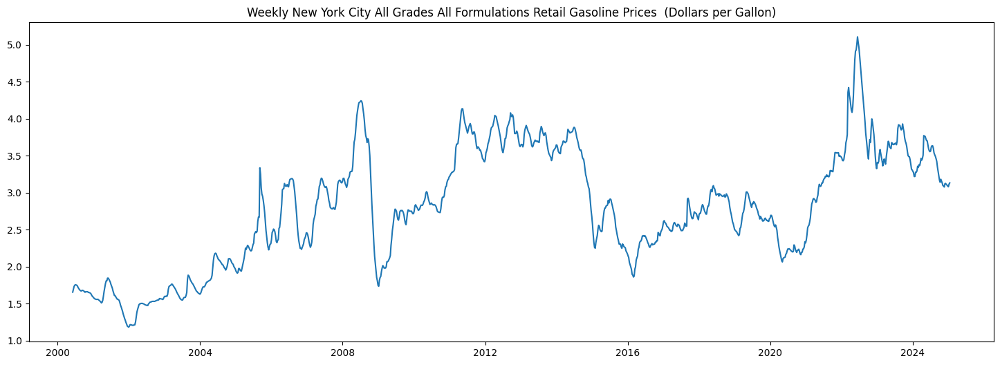

In [106]:
plt.figure(figsize=(18, 6))

plt.plot(df_gasoline['Date'],df_gasoline["NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices"])
plt.title("Weekly New York City All Grades All Formulations Retail Gasoline Prices  (Dollars per Gallon)")
plt.show()

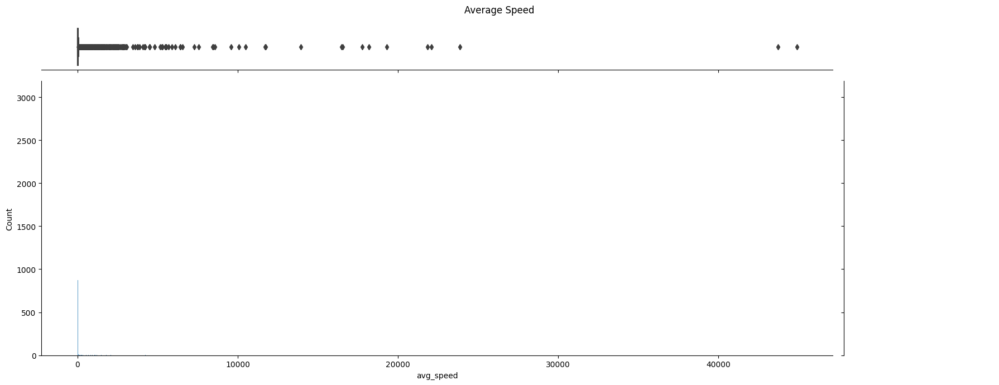

In [107]:
###############################################################
#hist plot of Average Speed
###############################################################
target_data=df_trans
g = sns.JointGrid(data=target_data, x="avg_speed")
g.plot(sns.histplot, sns.boxplot)
g.fig.set_size_inches((18, 7))
plt.suptitle("Average Speed")
plt.tight_layout()
plt.show()

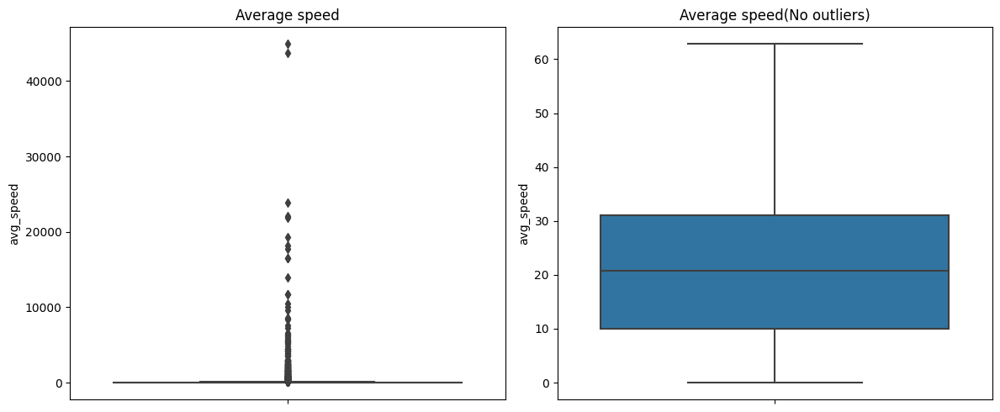

In [108]:
###############################################################
#Box plot of Average Speed
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="avg_speed",ax=axs[0])
axs[0].set_title("Average speed")

#no outliers
sns.boxplot(data=target_data, y="avg_speed",ax=axs[1],showfliers=False)
axs[1].set_title("Average speed(No outliers)")

plt.tight_layout()
plt.show()

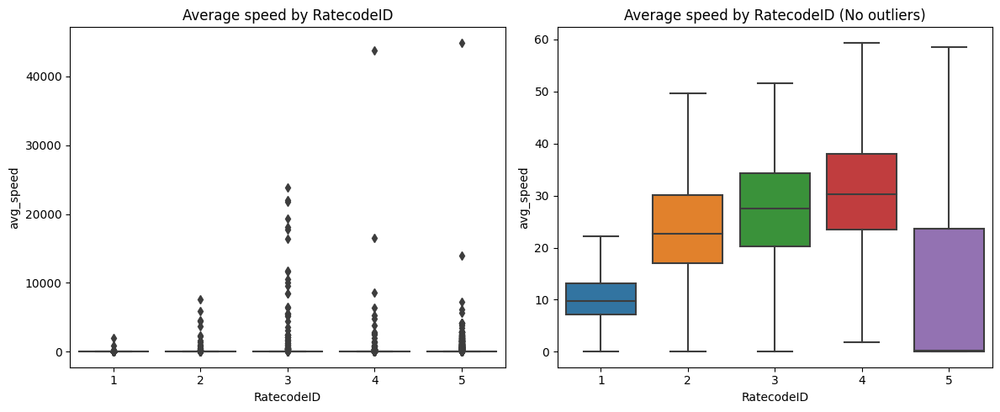

In [109]:
###############################################################
#Box plot of Average Speed by RatecodeID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="RatecodeID",ax=axs[0])
axs[0].set_title("Average speed by RatecodeID")

#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="RatecodeID",ax=axs[1],showfliers=False)
axs[1].set_title("Average speed by RatecodeID (No outliers)")

plt.tight_layout()
plt.show()

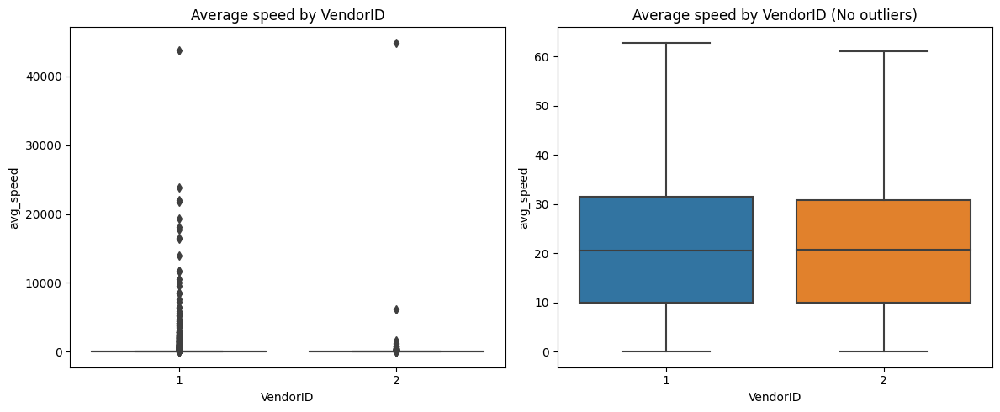

In [110]:
###############################################################
#Box plot of Average Speed by VendorID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="VendorID",ax=axs[0])
axs[0].set_title("Average speed by VendorID")

#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="VendorID",ax=axs[1],showfliers=False)
axs[1].set_title("Average speed by VendorID (No outliers)")

plt.tight_layout()
plt.show()

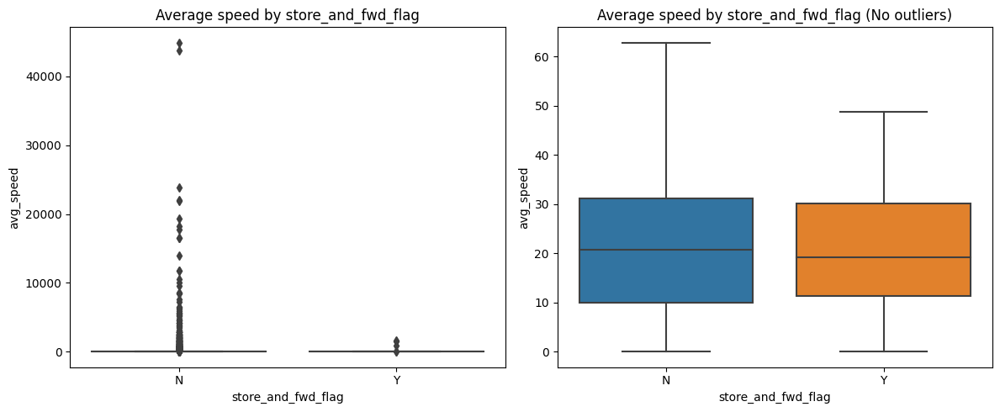

In [111]:
###############################################################
#Box plot of Average Speed by store_and_fwd_flag
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="store_and_fwd_flag",ax=axs[0])
axs[0].set_title("Average speed by store_and_fwd_flag")

#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="store_and_fwd_flag",ax=axs[1],showfliers=False)
axs[1].set_title("Average speed by store_and_fwd_flag (No outliers)")

plt.tight_layout()
plt.show()

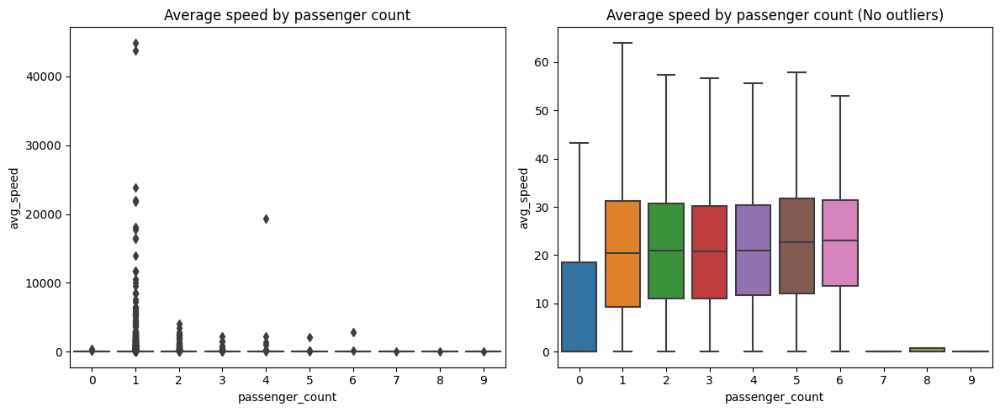

In [112]:
###############################################################
#Box plot of Average Speed by passenger count
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="passenger_count",ax=axs[0])
axs[0].set_title("Average speed by passenger count")

#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="passenger_count",ax=axs[1],showfliers=False)
axs[1].set_title("Average speed by passenger count (No outliers)")

plt.tight_layout()
plt.show()

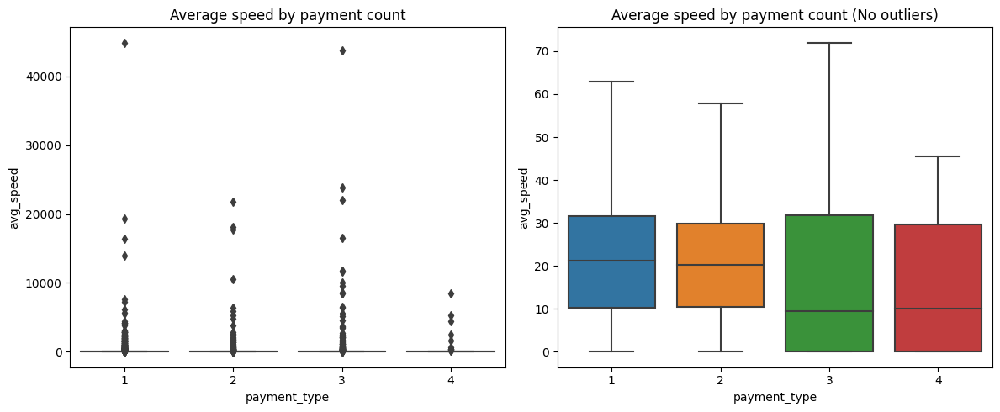

In [113]:
###############################################################
#Box plot of Average Speed by Payment_type
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="payment_type",ax=axs[0])
axs[0].set_title("Average speed by payment count")

#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="payment_type",ax=axs[1],showfliers=False)
axs[1].set_title("Average speed by payment count (No outliers)")

plt.tight_layout()
plt.show()

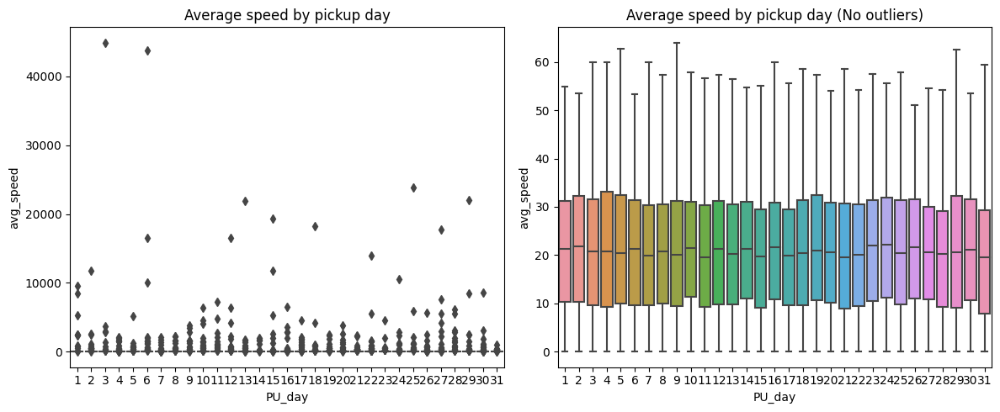

In [114]:
###############################################################
#Box plot of Average Speed by pickup day
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="PU_day",ax=axs[0])
axs[0].set_title("Average speed by pickup day")

#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="PU_day",ax=axs[1],showfliers=False)
axs[1].set_title("Average speed by pickup day (No outliers)")

plt.tight_layout()
plt.show()

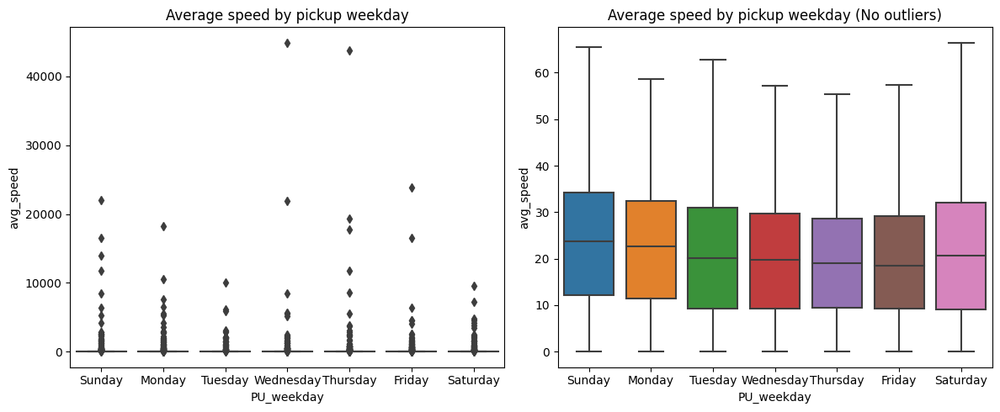

In [115]:
###############################################################
#Box plot of Average Speed by pickup hour
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="PU_weekday",ax=axs[0])
axs[0].set_title("Average speed by pickup weekday")

#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="PU_weekday",ax=axs[1],showfliers=False)
axs[1].set_title("Average speed by pickup weekday (No outliers)")

plt.tight_layout()
plt.show()

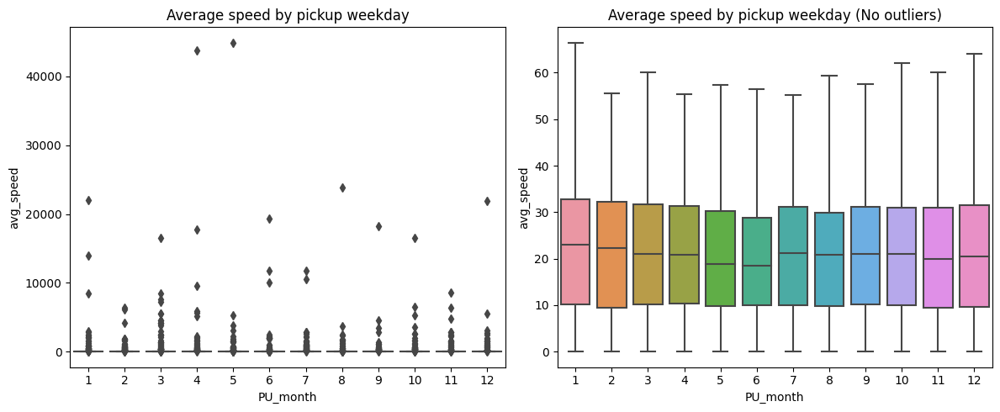

In [116]:
###############################################################
#Box plot of Average Speed by pickup month
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="PU_month",ax=axs[0])
axs[0].set_title("Average speed by pickup weekday")

#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="PU_month",ax=axs[1],showfliers=False)
axs[1].set_title("Average speed by pickup weekday (No outliers)")

plt.tight_layout()
plt.show()

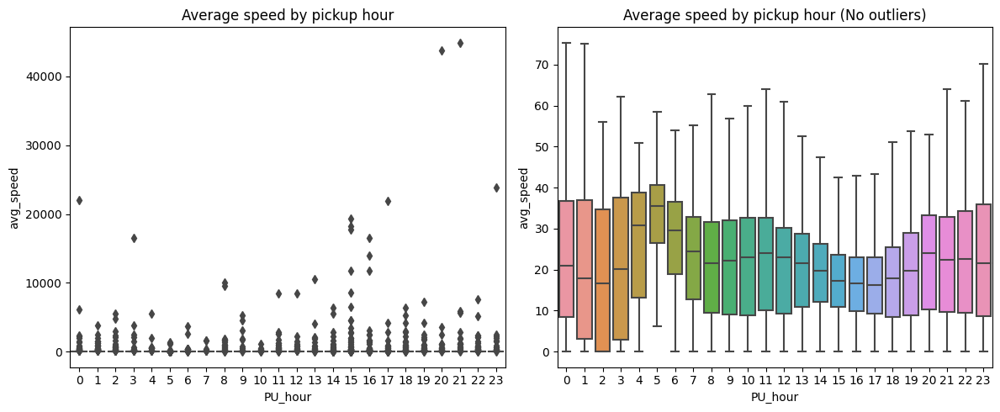

In [117]:
###############################################################
#Box plot of Average Speed by pickup hour
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_trans
#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="PU_hour",ax=axs[0])
axs[0].set_title("Average speed by pickup hour")

#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="PU_hour",ax=axs[1],showfliers=False)
axs[1].set_title("Average speed by pickup hour (No outliers)")

plt.tight_layout()
plt.show()

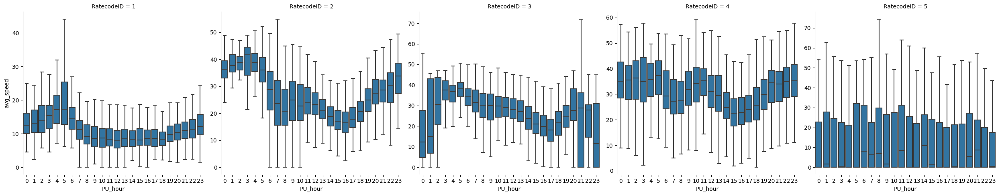

In [118]:
###################################################################################
#Box plot of  Average Speed by pickup hour while keep RatecodeID constant
###################################################################################
target_data=df_trans[df_trans['RatecodeID'].isin(RateCodeIDList)]
# Create the FacetGrid
g = sns.FacetGrid(target_data, col="RatecodeID",height=5,aspect=1,sharey=False,sharex=False)

# Map the boxplot to the grid
g.map(sns.boxplot, "PU_hour", "avg_speed",showfliers=False)

# Show the plot
plt.show()

### Outliers


In [119]:
df_trans.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24755 entries, 0 to 24754
Data columns (total 69 columns):
 #   Column                                                  Non-Null Count  Dtype         
---  ------                                                  --------------  -----         
 0   ID                                                      24755 non-null  int64         
 1   VendorID                                                24755 non-null  int64         
 2   tpep_pickup_datetime                                    24755 non-null  datetime64[ns]
 3   tpep_dropoff_datetime                                   24755 non-null  datetime64[ns]
 4   passenger_count                                         24755 non-null  int64         
 5   trip_distance                                           24755 non-null  float64       
 6   RatecodeID                                              24755 non-null  int64         
 7   store_and_fwd_flag                                      24

### Box plots

Plot a box plot for each feature: `trip_distance`, `fare_amount`, `duration`.

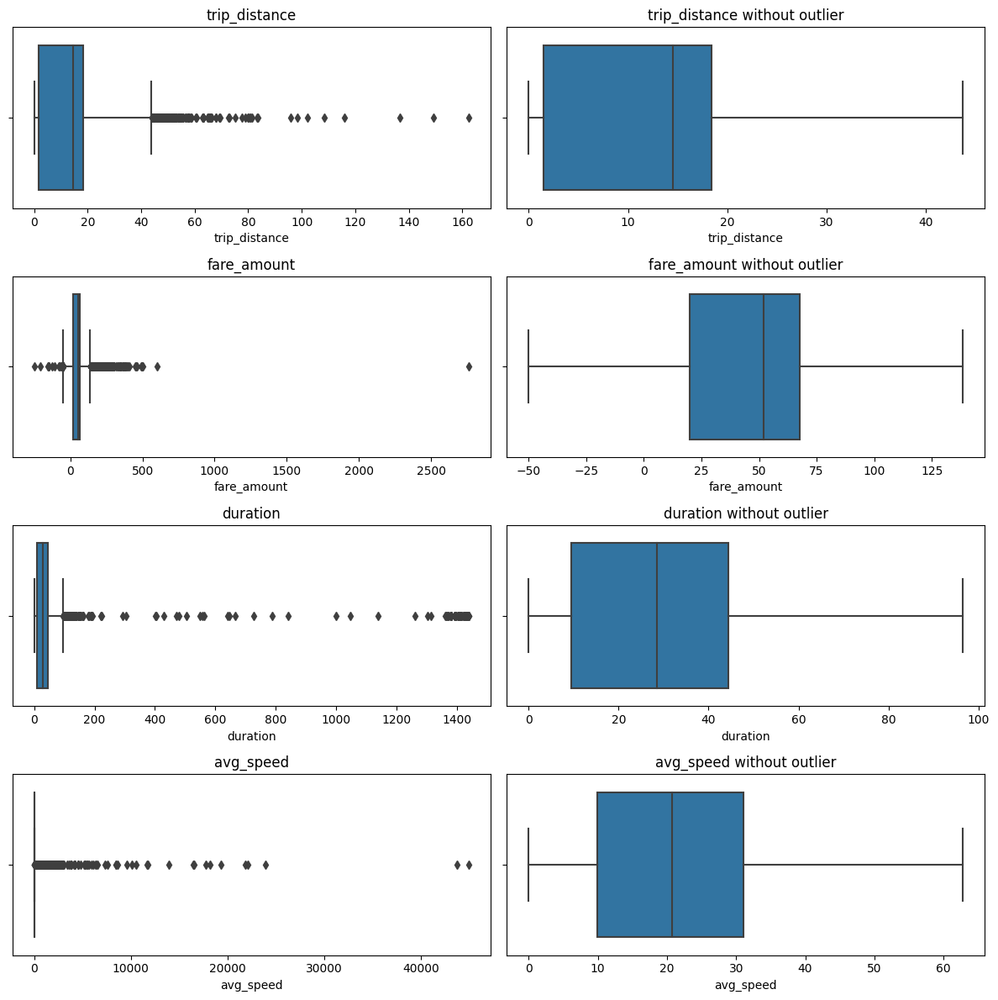

In [120]:
#trip_distance and fare_amount already confirmed
fig,axs=plt.subplots(4,2,figsize=(12,12))

col_list=['trip_distance', 'fare_amount', 'duration','avg_speed']

###############################################################
#box plot of duration
###############################################################
for col,row in zip(col_list,range(len(col_list))):
    sns.boxplot(data=df_trans, x=col,ax=axs[row][0])
    axs[row][0].set_title(f'{col}')
    sns.boxplot(data=df_trans, x=col,ax=axs[row][1],showfliers=False)
    axs[row][1].set_title(f'{col} without outlier')
plt.tight_layout()
plt.show()

#### `trip_distance` outliers

In [121]:
####################################################
#Create a new dataframe to store data after cleaning
####################################################
#clean with other approach
df_clean=df_trans.copy()


In [122]:

df_trans.sort_values(by=['trip_distance'])[['trip_distance']].drop_duplicates().head(20)
#=>There are 0.01, 0.02, 0 looks like smaller than 0.01 miles
#0.01 mile is around 16 meters, 0 indicate trips with very short distance(less than 16 meters)

,trip_distance
12377,0.00
8438,0.01
24648,0.02
12743,0.03
10341,0.04
8420,0.05
24550,0.06
3161,0.07
17597,0.08
18531,0.09


In [123]:
mask=df_trans['trip_distance']==0
target_data=df_trans[mask]
target_data[['VendorID','tpep_pickup_datetime', 'tpep_dropoff_datetime','duration','RatecodeID','PULocationID', 'DOLocationID','payment_type','fare_amount','extra',
       'mta_tax', 'tip_amount', 'tolls_amount', 'improvement_surcharge','total_amount','service_zone_PU','service_zone_DO']].head(30)
#=>data was very random(many of them PULocationID=DOLocationID,trip duration was very short, fare_amount not zero)
#Possible reasons:
#=>passengers cancled the trip (some still paid, some No charge )
#=>traffic jam (taxi didn't move but still charge,  refer:60 seconds [(at a rate of $.50 per minute)], when the Taxicab is traveling at less than 12 miles an hour.)
#=>change payment type(What should I do if I want to pay by credit card, but the driver informs me he/she has already pressed the “Cash” button? Inform the driver that you wish to pay by credit card. He/she will be able to reset the PIM or enter the amount as a negotiated fare (rate code 5).)

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,duration,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,service_zone_PU,service_zone_DO
169,1,2017-01-11 12:24:47,2017-01-11 12:24:59,0.200,1,145,145,3,2.5,0.0,0.5,0.00,0.00,0.3,3.30,Boro Zone,Boro Zone
447,2,2017-01-03 22:01:54,2017-01-03 22:02:36,0.700,2,263,263,1,52.0,0.0,0.5,11.67,5.54,0.3,70.01,Yellow Zone,Yellow Zone
463,2,2017-01-02 20:49:29,2017-01-02 20:49:32,0.050,2,127,127,1,52.0,0.0,0.5,10.56,0.00,0.3,63.36,Boro Zone,Boro Zone
471,2,2017-01-13 15:29:05,2017-01-13 15:29:19,0.233,2,230,230,1,52.0,0.0,0.5,11.67,5.54,0.3,70.01,Yellow Zone,Yellow Zone
524,2,2017-01-08 14:42:39,2017-01-08 14:42:47,0.133,2,264,243,2,52.0,0.0,0.5,0.00,0.00,0.3,52.80,Unknown(N/A),Boro Zone
543,1,2017-01-24 18:33:44,2017-01-24 18:34:04,0.333,2,132,132,1,52.0,4.5,0.5,12.55,5.54,0.3,75.39,Airports,Airports
553,2,2017-01-26 04:40:23,2017-01-26 04:40:31,0.133,2,231,231,2,52.0,0.0,0.5,0.00,0.00,0.3,52.80,Yellow Zone,Yellow Zone
558,2,2017-01-02 14:01:06,2017-01-02 14:01:20,0.233,2,132,132,1,52.0,0.0,0.5,10.00,5.54,0.3,68.34,Airports,Airports
560,2,2017-01-12 13:03:02,2017-01-12 13:03:05,0.050,2,264,264,1,52.0,0.0,0.5,0.00,0.00,0.3,52.80,Unknown(N/A),Unknown(N/A)
590,1,2017-01-16 14:10:20,2017-01-16 14:10:32,0.200,2,65,65,4,52.0,0.0,0.5,0.00,0.00,0.3,52.80,Boro Zone,Boro Zone


In [124]:

df_trans[df_trans['trip_distance']==0]['ID'].count()

2913

#### `fare_amount` outliers

In [125]:
df_trans.sort_values(by=['fare_amount'])[['VendorID','passenger_count', 'trip_distance', 'RatecodeID','payment_type','fare_amount','duration']].drop_duplicates().head(20)

,VendorID,passenger_count,trip_distance,RatecodeID,payment_type,fare_amount,duration
24479,2,1,0.00,5,3,-250.00,2.083
8213,2,2,0.32,5,3,-209.00,2.250
8345,2,2,0.00,5,3,-158.00,2.650
1815,2,2,0.00,5,3,-150.00,1.367
14554,2,1,0.00,5,3,-150.00,2.550
14431,2,1,0.00,5,3,-128.00,0.367
14704,2,1,0.00,5,3,-111.48,0.383
16261,2,2,0.00,5,3,-80.00,1.767
20563,2,1,0.00,5,4,-75.00,0.067
18463,2,1,0.00,5,4,-60.00,0.133


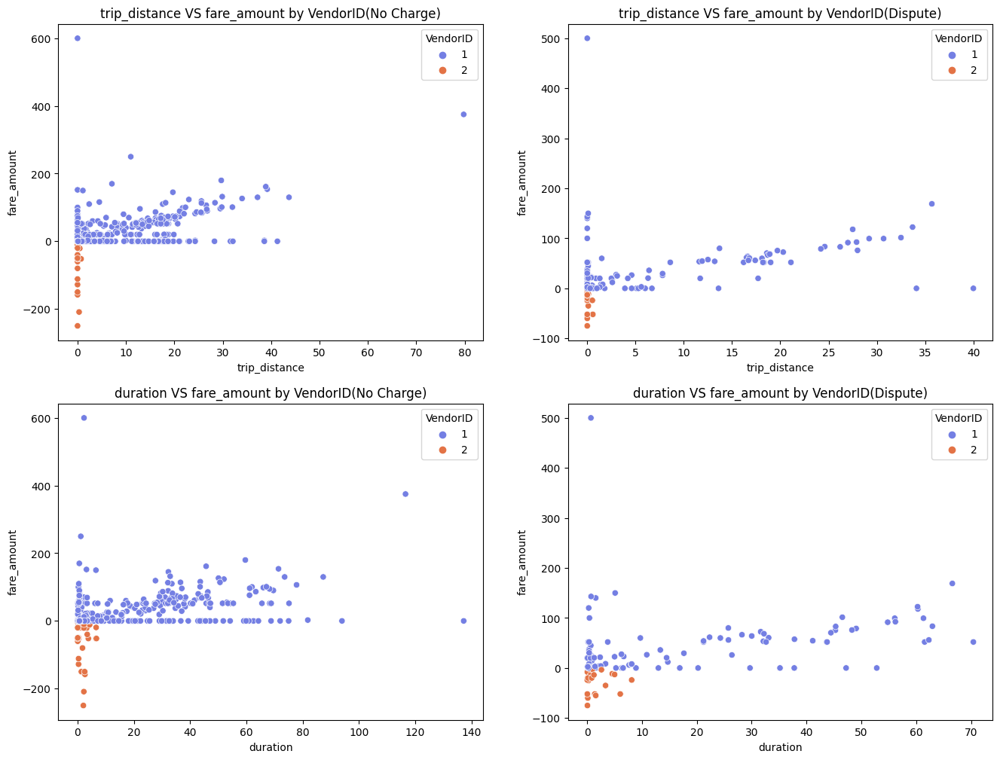

In [126]:
data=df_trans

#set mask(filter No Charge record)
mask_paymenttype_NoCharge=df_trans['payment_type']==3
#set mask(filter Dispute record)
mask_paymenttype_Dispute=df_trans['payment_type']==4

var_list=['trip_distance','duration']
fig,axs=plt.subplots(2,2,figsize=(16,12))
#set hue color
colors = ['#747FE3', '#E37346']
###############################################################
#plot of trip_distance and duration VS fare_amount
###############################################################
for var,row in zip(var_list,range(len(var_list))):
    #show payment_type==3 No Charge
    sns.scatterplot(data=data[mask_paymenttype_NoCharge], x=var, y="fare_amount"
                    , hue="VendorID",ax=axs[row][0]
                    , palette=colors)
    axs[row][0].set_title(f"{var} VS fare_amount by VendorID(No Charge)")
    #show payment_type==4 Dispute
    sns.scatterplot(data=data[mask_paymenttype_Dispute], x=var, y="fare_amount"
                    , hue="VendorID",ax=axs[row][1]
                    , palette=colors)
    axs[row][1].set_title(f"{var} VS fare_amount by VendorID(Dispute)")

plt.show()

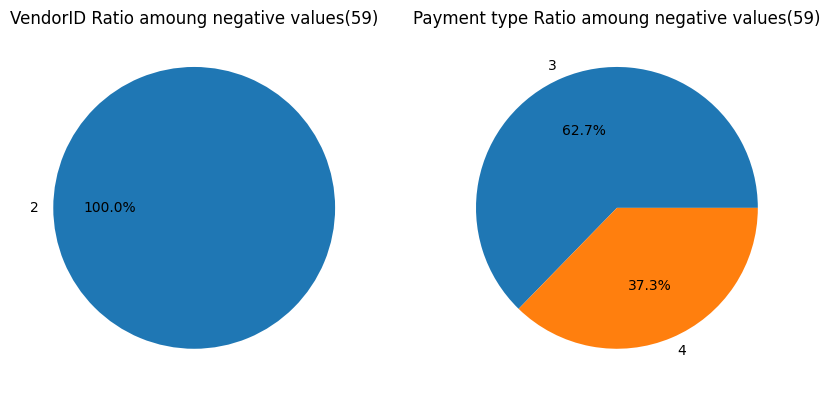

In [127]:
data=df_trans
mask_negative=df_trans['fare_amount']<0

fig,axs=plt.subplots(1,2,figsize=(10,5))
###############################################################
#plot of negative fare_amount
###############################################################
total_count=data[mask_negative]['ID'].count()

#VendorID Ratio amoung negative values
result=data[mask_negative].groupby(['VendorID'])[['ID']].count().reset_index()
result['Ratio']=(result['ID']/total_count)
axs[0].pie(result["Ratio"],labels = result['VendorID'], autopct='%1.1f%%')
axs[0].set_title(f"VendorID Ratio amoung negative values({total_count})")

#payment_type Ratio amoung negative values
result=data[mask_negative].groupby(['payment_type'])[['ID']].count().reset_index()
result['Ratio']=(result['ID']/total_count)
axs[1].pie(result["Ratio"],labels = result['payment_type'], autopct='%1.1f%%')
axs[1].set_title(f"Payment type Ratio amoung negative values({total_count})")

plt.show()

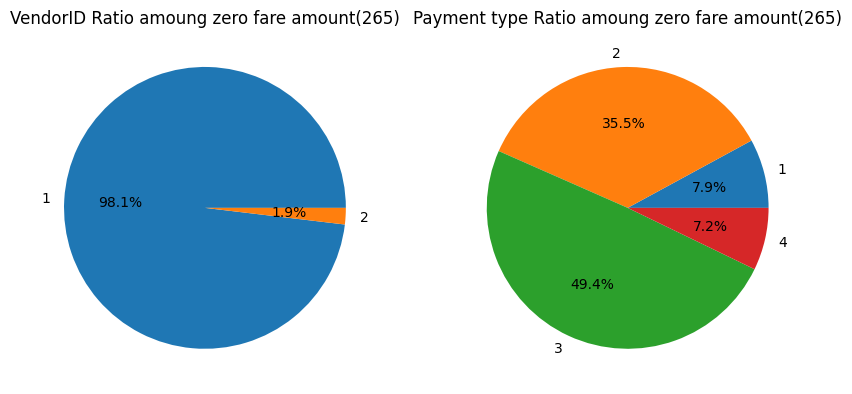

In [128]:
data=df_trans
mask_zero=df_trans['fare_amount']==0

fig,axs=plt.subplots(1,2,figsize=(10,5))
###############################################################
#plot of 0 fare_amount
###############################################################
total_count=data[mask_zero]['ID'].count()

#VendorID Ratio amoung negative values
result=data[mask_zero].groupby(['VendorID'])[['ID']].count().reset_index()
result['Ratio']=(result['ID']/total_count)
axs[0].pie(result["Ratio"],labels = result['VendorID'], autopct='%1.1f%%')
axs[0].set_title(f"VendorID Ratio amoung zero fare amount({total_count})")

#payment_type Ratio amoung negative values
result=data[mask_zero].groupby(['payment_type'])[['ID']].count().reset_index()
result['Ratio']=(result['ID']/total_count)
axs[1].pie(result["Ratio"],labels = result['payment_type'], autopct='%1.1f%%')
axs[1].set_title(f"Payment type Ratio amoung zero fare amount({total_count})")

plt.show()

**Data Clean Check List**

|Check Item|Description|How to Handle|
|:-        |:-   |:-                 |
|check RatecodeID|Check if RatecodeID is [0-265]|Delete|
|check LocationID|Check if LocationID is 264|Delete|
|check Payment Type|Check if payment type is Credit card or Cash|Delete|
|Check duration|Check limits on Consecutive Hours of Driving.<BR/> A Driver must not operate a Vehicle for more than 12 consecutive hours.|Delete|
|Check Speed|Check if average [speed](https://www.nyc.gov/html/dot/html/motorist/vision-zero-safe-driving.shtml#speed-limit) is within the speed limit|Delete|
|Check Distance(Range)|0<distance <=Max speed limit * min(duration, max work time)|Delete|
|Check Distance(Relation)|Check if the relation betweeen trip distance and LocationID are valid<BR/>PULocationID = DOLocationID, trip_distance >= 0 (valid)<BR/>PULocationID and DOLocationID are neighbour, trip_distance >= 0 (valid)<BR/>PULocationID and DOLocationID are NOT neighbour, trip_distance < geo shortest distance (invalid)<BR/>PULocationID and DOLocationID neighbour unknown, trip_distance = 0 (valid)|Delete|
|Check Fare amount|Check if fare_amount follow [TLC Taxi Fare](https://www.nyc.gov/site/tlc/passengers/taxi-fare.page)|Delete|
|Check RatecodeID setting|Check if RatecodeID setting follow TLC Rule|Delete|
|Check Trip with change|Check if a trip is a trip with something(payment) change |Delete|
|Check Pickup location|Check if Pickup Locaion is outside of NYC|Delete|
|Check check_tax_surcharge|Check if extra,mta_tax and Improvement surcharge is correct|Delete|
|Check rushhour surcharge|Check if the rush hour surcharge is correct(Consider pickup time)|Keep|
|Check night time surcharge|Check if the night time surcharge is correct(Consider pickup time)|Keep|

Refer:
* [Limits on Consecutive Hours of Driving. A Driver must not operate a Vehicle for more than 12 consecutive hours.](https://www.nyc.gov/assets/tlc/downloads/pdf/rule_book_current_chapter_54.pdf)
* [Justifications for Refusing Passenger. The following are permitted reasons for refusing to transport: The Passenger’s destination is Newark Airport or someplace in Nassau or Westchester County, and the Driver has been operating the Vehicle for more than eight hours of any continuous 24-hour period.](https://www.nyc.gov/assets/tlc/downloads/pdf/rule_book_current_chapter_54.pdf)      
* [NYC Speed limit 10MPH~50MPH, default 25MPH](https://www.nyc.gov/html/dot/html/motorist/vision-zero-safe-driving.shtml#:~:text=New%20York%20City%20Speed%20Limit,input%20on%20posted%20speed%20limits.) 
* [Traveling to Newark Airport](https://parkos.com/newark-airport-parking/travel-directions/)
    * Highway: 70 mph
    * City Limits: 15 to 45 mph
    * Country Roads: 55 mph

In [129]:
#############################################################
#check data
#############################################################

#dataframe for checking result
df_confirm=df_trans.copy()


#**************************************************#
#check RatecodeID
#**************************************************#
df_confirm['check_RatecodeID']=df_confirm['RatecodeID'].apply(check_RatecodeID)

#**************************************************#
#check LocationID
#**************************************************#
df_confirm['check_LocationID']=df_confirm[['PULocationID','DOLocationID']].apply(lambda x: check_LocationID_range(x["PULocationID"],x["DOLocationID"]), axis=1)

#**************************************************#
#check Payment Type
#**************************************************#
df_confirm['check_payment']=df_confirm['payment_type'].apply(check_payment)

#**************************************************#
#Check duration
#**************************************************#
df_confirm['check_duration']=df_confirm['duration'].apply(check_duration)

#**************************************************#
#Check Speed
#**************************************************#
df_confirm['check_speed']=df_confirm[['RatecodeID','avg_speed']].apply(lambda x: check_speed_limit(x["RatecodeID"],x["avg_speed"]), axis=1)

#**************************************************#
#Check Distance(Range)
#**************************************************#
df_confirm['check_distance']=df_confirm[['trip_distance','duration_sec']].apply(lambda x: check_distance(x["trip_distance"],x["duration_sec"]), axis=1)

#**************************************************#
#Check Distance(Relation)
#**************************************************#
df_confirm['check_distance_relation']=df_confirm[['PULocationID','DOLocationID','trip_distance']].apply(lambda x: check_distance_LocationID(x["PULocationID"],x["DOLocationID"],x["trip_distance"]), axis=1)

#**************************************************#
#Check Fare amount
#**************************************************#
df_confirm['check_fare_amount']=df_confirm[['RatecodeID','trip_distance','duration_sec','fare_amount']].apply(lambda x: check_fare_amount_within_range(x["RatecodeID"],x["trip_distance"],x["duration_sec"],x["fare_amount"]), axis=1)
df_confirm['limit']=df_confirm[['RatecodeID','trip_distance','duration_sec','fare_amount']].apply(lambda x: impute_fare_amount_range(x["RatecodeID"],x["trip_distance"],x["duration_sec"]), axis=1)

#**************************************************#
#Check RatecodeID setting
#**************************************************#
df_confirm['check_RatecodeID_setting']=df_confirm[['RatecodeID','PULocationID','DOLocationID','Borough_PU','Borough_DO']].apply(lambda x: check_RatecodeID_setting(x["RatecodeID"],x["PULocationID"],x["DOLocationID"],x["Borough_PU"], x["Borough_DO"]), axis=1)

#**************************************************#
#Check Trip with change
#**************************************************#
df_confirm['check_nochange_trip']=df_confirm[['RatecodeID','trip_distance','duration','fare_amount']].apply(lambda x: check_NoChange_Trip(x["RatecodeID"],x["trip_distance"],x["duration"],x["fare_amount"]), axis=1)


#**************************************************#
#Check Pickup location
#**************************************************#
df_confirm['check_pu_location']=df_confirm[['RatecodeID','PULocationID']].apply(lambda x: check_pickup_loation(x["RatecodeID"],x["PULocationID"]), axis=1)

#**************************************************#
#Check extra,mta_tax and Improvement surcharge
#**************************************************#
df_confirm['check_tax_surcharge']=df_confirm[['RatecodeID','extra','mta_tax','improvement_surcharge']].apply(lambda x: check_tax_surcharge(x["RatecodeID"],x["extra"],x["mta_tax"],x["improvement_surcharge"]), axis=1)

#**************************************************#
#Check rushhour surcharge
#**************************************************#
NYC_HOLIDAY_LIST=df_nyc_holiday['Date'].to_list()
df_confirm['check_rushhour_surcharge']=df_confirm[['RatecodeID','tpep_pickup_datetime','extra']].apply(lambda x: check_rushhour_surcharge(x["RatecodeID"],x["tpep_pickup_datetime"],x["extra"],NYC_HOLIDAY_LIST), axis=1)


#**************************************************#
#Check night time surcharge
#**************************************************#
df_confirm['check_nighttime_surcharge']=df_confirm[['RatecodeID','tpep_pickup_datetime','extra']].apply(lambda x: check_nighttime_surcharge(x["RatecodeID"],x["tpep_pickup_datetime"],x["extra"],NYC_HOLIDAY_LIST), axis=1)


In [130]:
#**************************************************#
#Show check RatecodeID results
#**************************************************#
df_confirm[df_confirm['check_RatecodeID']==False]
#=>trip_distance is 0, duration is 0, doesn't look like a valid trip, drop it


,ID,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,PU_hour,DO_hour,PU_day,DO_day,PU_month,DO_month,PU_weekday,DO_weekday,PU_year,PU_weeknum,PU_year_weeknum,PU_nextMonday,PU_date_hour,Borough_PU,Zone_PU,service_zone_PU,Borough_DO,Zone_DO,service_zone_DO,Date,NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices,Year,time,temperature_2m (°C),relative_humidity_2m (%),dew_point_2m (°C),apparent_temperature (°C),precipitation (mm),rain (mm),snowfall (cm),snow_depth (m),pressure_msl (hPa),surface_pressure (hPa),cloud_cover (%),cloud_cover_low (%),cloud_cover_mid (%),cloud_cover_high (%),wind_speed_10m (km/h),wind_speed_100m (km/h),wind_direction_10m (°),wind_direction_100m (°),wind_gusts_10m (km/h),PU_DO_Borough,JFK,Newark,OutsideNYC,nighttime,rushhour,duration,duration_sec,avg_speed,check_RatecodeID,check_LocationID,check_payment,check_duration,check_speed,check_distance,check_distance_relation,check_fare_amount,limit,check_RatecodeID_setting,check_nochange_trip,check_pu_location,check_tax_surcharge,check_rushhour_surcharge,check_nighttime_surcharge


In [131]:
#**************************************************#
#Show check LocationID results
#**************************************************#
mask=df_confirm['check_LocationID']==False
print(df_confirm[mask]['RatecodeID'].unique())
df_confirm[mask][['PULocationID','DOLocationID','RatecodeID','fare_amount','trip_distance','duration']]

#=>264 seems represents many areas which in different taxi zone

[1 2 3 4 5]


,PULocationID,DOLocationID,RatecodeID,fare_amount,trip_distance,duration
6,264,264,1,7.50,1.40,7.550
32,264,264,1,4.00,0.46,2.983
48,264,231,1,15.50,3.90,17.917
64,264,264,1,16.00,2.90,24.400
228,264,264,1,9.00,1.70,11.550
...,...,...,...,...,...,...
24736,264,264,5,12.80,0.00,0.650
24739,264,140,5,67.84,0.00,79.467
24742,264,162,5,7.80,0.00,0.050
24748,264,265,5,0.00,18.70,0.683


In [132]:
#**************************************************#
#Show check payment type results
#**************************************************#
df_confirm[df_confirm['check_payment']==False][['VendorID','tpep_pickup_datetime', 'tpep_dropoff_datetime','store_and_fwd_flag','payment_type','trip_distance','duration','duration_sec','RatecodeID','PULocationID', 'DOLocationID','payment_type','fare_amount','extra']]
#=>Passenger could only pay with cash or credit, could not choose 'No Charge' or 'Dispute'
#=>We can exclude all 'No Charge' and 'Dispute' records


,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,store_and_fwd_flag,payment_type,trip_distance,duration,duration_sec,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,extra
169,1,2017-01-11 12:24:47,2017-01-11 12:24:59,N,3,0.00,0.200,12.0,1,145,145,3,2.50,0.0
370,1,2017-01-07 21:53:22,2017-01-07 22:04:41,N,3,1.80,11.317,679.0,1,230,239,3,9.50,0.5
444,2,2017-01-17 12:47:14,2017-01-17 12:48:38,N,4,0.02,1.400,84.0,2,246,246,4,-52.00,0.0
445,2,2017-01-14 03:38:12,2017-01-14 03:38:23,N,3,0.01,0.183,11.0,2,181,181,3,-52.00,0.0
590,1,2017-01-16 14:10:20,2017-01-16 14:10:32,N,4,0.00,0.200,12.0,2,65,65,4,52.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24726,1,2017-12-04 08:00:46,2017-12-04 08:03:15,N,3,0.00,2.483,149.0,5,132,132,3,0.01,0.0
24730,1,2017-12-21 22:02:32,2017-12-21 22:03:02,N,3,0.00,0.500,30.0,5,265,265,3,55.00,0.0
24732,1,2017-12-31 03:24:19,2017-12-31 03:25:10,N,3,0.10,0.850,51.0,5,186,186,3,0.00,0.0
24740,1,2017-12-07 13:27:54,2017-12-07 14:27:47,N,3,9.60,59.883,3593.0,5,260,265,3,0.01,0.0


In [133]:
#**************************************************#
#Show check duration results
#**************************************************#
print(f"duration min: {df_confirm[df_confirm['check_duration']==False]['duration'].min()}")
print(f"duration max: {df_confirm[df_confirm['check_duration']==False]['duration'].max()}")
df_confirm[df_confirm['check_duration']==False][['VendorID','tpep_pickup_datetime', 'tpep_dropoff_datetime','store_and_fwd_flag','payment_type','PULocationID', 'DOLocationID','RatecodeID','duration','fare_amount','trip_distance','avg_speed']]
#=>duration of these trips were over 12 hours(A Driver must not operate a Vehicle for more than 12 consecutive hours.)
#=>Our purpose is to predict trip fare(in the pre-condition that passenger and driver follow the law and rule ), 
#=>thus this kind of data are not good(might be some special cases but not useful for fare prediction)

#Possible reasons: accident, machine/system issue, operation mistake(e.g. forgot turn off taximeter),test data,special business service(e.g. service time is 12 hours or 24 hours)
#however VendorID of all trips were VendorID=2
#=>may not be accident, operation mistake, may be machine/system issue, test data,special business service

duration min: 727.383
duration max: 1439.267


,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,store_and_fwd_flag,payment_type,PULocationID,DOLocationID,RatecodeID,duration,fare_amount,trip_distance,avg_speed
1145,2,2017-01-18 19:57:38,2017-01-19 19:22:26,N,1,162,1,3,1404.800,68.0,17.74,0.757688
1146,2,2017-01-19 15:05:37,2017-01-20 14:53:07,N,1,230,1,3,1427.500,66.5,17.12,0.719580
1364,2,2017-01-19 07:20:32,2017-01-20 00:00:00,N,1,132,265,4,999.467,72.5,16.24,0.974920
1371,2,2017-01-17 14:02:51,2017-01-18 12:51:03,N,2,132,265,4,1368.200,24.0,6.58,0.288554
1392,2,2017-01-13 23:24:37,2017-01-14 23:09:01,N,2,229,265,4,1424.400,69.5,21.06,0.887110
...,...,...,...,...,...,...,...,...,...,...,...,...
22556,2,2017-11-27 21:22:06,2017-11-28 20:16:20,N,1,265,265,5,1374.233,110.0,0.00,0.000000
23172,2,2017-12-13 21:05:51,2017-12-14 21:05:07,N,2,132,142,2,1439.267,52.0,19.83,0.826671
23541,2,2017-12-01 14:28:56,2017-12-02 14:25:44,N,1,166,1,3,1436.800,89.5,26.55,1.108714
24403,2,2017-12-26 09:57:41,2017-12-27 00:00:00,N,1,138,265,5,842.317,120.0,23.57,1.678941


In [134]:
#**************************************************#
#Show Check Speed results
#**************************************************#
mask=df_confirm['check_speed']==False
df_confirm[mask][['VendorID','tpep_pickup_datetime', 'tpep_dropoff_datetime','trip_distance','duration',
                  'duration_sec','RatecodeID','PULocationID', 'DOLocationID','store_and_fwd_flag',
                  'payment_type','fare_amount','extra',
       'mta_tax', 'tip_amount', 'tolls_amount', 'improvement_surcharge','total_amount','limit']]
#=>average speed excluded the speed limit

#possinle reasons: operation mistake(e.g. forgot turn on the taxi meter at the begining of their trips), noise, test data, 

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,trip_distance,duration,duration_sec,RatecodeID,PULocationID,DOLocationID,store_and_fwd_flag,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,limit
31,1,2017-01-05 13:36:29,2017-01-05 13:36:31,0.50,0.033,2.0,1,148,148,N,1,2.5,0.0,0.5,0.95,0.0,0.3,4.25,"(2.5, 4.5)"
851,1,2017-01-30 14:51:28,2017-01-30 14:51:34,0.30,0.100,6.0,3,263,263,N,3,20.0,0.0,0.0,0.00,0.0,0.3,20.30,"(20.0, 21.5)"
876,1,2017-01-01 11:53:59,2017-01-01 11:54:07,18.80,0.133,8.0,3,230,230,N,3,20.0,0.0,0.0,0.00,0.0,0.3,20.30,"(20.0, 67.5)"
949,1,2017-01-29 00:44:17,2017-01-29 00:44:20,18.40,0.050,3.0,3,132,132,N,3,20.0,0.5,0.0,0.00,0.0,0.3,20.80,"(20.0, 66.5)"
1035,1,2017-01-06 21:13:30,2017-01-06 21:13:32,0.70,0.033,2.0,3,186,186,N,3,20.0,0.5,0.0,0.00,0.0,0.3,20.80,"(20.0, 22.5)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24695,2,2017-12-24 10:39:24,2017-12-24 10:39:27,0.09,0.050,3.0,5,264,230,N,1,70.0,0.0,0.5,14.16,0.0,0.3,84.96,"(2.5, inf)"
24715,1,2017-12-02 21:22:14,2017-12-02 21:23:06,15.80,0.867,52.0,5,265,265,N,3,0.0,0.0,0.0,0.00,0.0,0.3,0.30,"(2.5, inf)"
24721,1,2017-12-31 02:56:24,2017-12-31 02:57:15,3.00,0.850,51.0,5,37,37,N,1,20.0,0.0,0.0,6.05,0.0,0.3,26.35,"(2.5, inf)"
24738,1,2017-12-22 03:42:28,2017-12-22 03:42:38,0.80,0.167,10.0,5,265,265,N,1,50.0,0.0,0.0,0.00,0.0,0.3,50.30,"(2.5, inf)"


In [135]:
#**************************************************#
#Show Check Distance(Range) results
#**************************************************#
print(f"distance min: {df_confirm[df_confirm['check_distance']==False]['trip_distance'].min()}")
print(f"distance max: {df_confirm[df_confirm['check_distance']==False]['trip_distance'].max()}")
df_confirm[df_confirm['check_distance']==False][['VendorID','tpep_pickup_datetime', 'tpep_dropoff_datetime','trip_distance','duration','duration_sec','RatecodeID','PULocationID', 'DOLocationID','payment_type','fare_amount','extra',
       'mta_tax', 'tip_amount', 'tolls_amount', 'improvement_surcharge','total_amount','limit']]
#=>trip_distance is greater than the duration(or max work time)*max speed
#=>if we only check trip_distance value, trip_distance might be valid,
#=>but when we consider duration and speed limit, trip_distance seems to be not valid

distance min: 0.0
distance max: 115.84


,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,trip_distance,duration,duration_sec,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,limit
31,1,2017-01-05 13:36:29,2017-01-05 13:36:31,0.5,0.033,2.0,1,148,148,1,2.5,0.0,0.5,0.95,0.00,0.3,4.25,"(2.5, 4.5)"
169,1,2017-01-11 12:24:47,2017-01-11 12:24:59,0.0,0.200,12.0,1,145,145,3,2.5,0.0,0.5,0.00,0.00,0.3,3.30,"(2.5, 3.0)"
447,2,2017-01-03 22:01:54,2017-01-03 22:02:36,0.0,0.700,42.0,2,263,263,1,52.0,0.0,0.5,11.67,5.54,0.3,70.01,"(52, 52)"
463,2,2017-01-02 20:49:29,2017-01-02 20:49:32,0.0,0.050,3.0,2,127,127,1,52.0,0.0,0.5,10.56,0.00,0.3,63.36,"(52, 52)"
471,2,2017-01-13 15:29:05,2017-01-13 15:29:19,0.0,0.233,14.0,2,230,230,1,52.0,0.0,0.5,11.67,5.54,0.3,70.01,"(52, 52)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24748,1,2017-12-09 16:27:23,2017-12-09 16:28:04,18.7,0.683,41.0,5,264,265,3,0.0,0.0,0.0,0.00,0.00,0.3,0.30,"(2.5, inf)"
24750,2,2017-12-07 18:01:37,2017-12-07 18:01:59,0.0,0.367,22.0,5,229,229,1,16.0,0.0,0.0,0.00,0.00,0.3,16.30,"(2.5, inf)"
24751,1,2017-12-06 11:12:44,2017-12-06 11:13:08,0.0,0.400,24.0,5,186,186,1,16.0,0.0,0.0,4.05,0.00,0.3,20.35,"(2.5, inf)"
24752,2,2017-12-27 20:47:10,2017-12-27 20:47:13,0.0,0.050,3.0,5,264,17,1,40.0,0.0,0.0,0.00,0.00,0.3,40.30,"(2.5, inf)"


In [136]:
#**************************************************#
#Show Check Distance(Relation) Results
#**************************************************#

df_confirm[df_confirm['check_distance_relation']==False][['VendorID','tpep_pickup_datetime', 'tpep_dropoff_datetime','trip_distance','duration','duration_sec','RatecodeID','PULocationID', 'DOLocationID','store_and_fwd_flag','payment_type','fare_amount','extra',
       'mta_tax', 'tip_amount', 'tolls_amount', 'improvement_surcharge','total_amount','limit']]
#=>PULocationID and DOLocationID are different taxi zone and they are not neighbours
#=>but distance is 0(might be special cases, e.g. put the taxi on a truck)
#=>some distance is smaller than the shortest distance between PULocationID and DOLocationID
#=>shortest distance is calculated by geo information of PULocationID and DOLocationID(use Haversine Formula)
#=>our purpose is to predict fare, which needs to calculate the distance
#=>this kind of distance is not the real distance between two points
#=>thus not good for our project

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,trip_distance,duration,duration_sec,RatecodeID,PULocationID,DOLocationID,store_and_fwd_flag,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,limit
632,1,2017-01-27 12:35:06,2017-01-27 12:46:25,1.00,11.317,679.0,2,145,164,N,2,52.00,0.0,0.5,0.00,5.54,0.3,58.34,"(52, 52)"
1788,2,2017-01-21 02:29:08,2017-01-21 03:12:41,0.06,43.550,2613.0,5,162,42,N,1,12.00,0.0,0.5,0.00,0.00,0.0,12.50,"(2.5, inf)"
1816,2,2017-01-21 08:29:57,2017-01-21 10:40:26,0.00,130.483,7829.0,5,132,164,N,1,72.00,0.0,0.5,7.50,0.00,0.0,80.00,"(2.5, inf)"
1834,2,2017-01-06 19:54:27,2017-01-06 20:02:17,0.00,7.833,470.0,5,186,162,N,1,8.50,0.0,0.0,2.12,0.00,0.0,10.62,"(2.5, inf)"
1854,2,2017-01-19 14:37:59,2017-01-19 15:01:33,8.44,23.567,1414.0,5,230,1,N,1,74.20,0.0,0.5,15.00,0.00,0.3,90.00,"(14.0, inf)"
1855,2,2017-01-29 17:47:59,2017-01-29 18:53:49,0.00,65.833,3950.0,5,164,1,N,1,95.00,0.0,0.5,0.00,0.00,0.0,95.50,"(2.5, inf)"
1866,2,2017-01-11 23:05:04,2017-01-11 23:34:42,0.25,29.633,1778.0,5,68,25,N,1,23.00,0.0,0.5,7.14,0.00,0.3,30.94,"(3.0, inf)"
1966,1,2017-01-20 03:47:12,2017-01-20 03:47:36,0.00,0.400,24.0,5,139,132,N,2,60.00,0.0,0.0,0.00,0.00,0.3,60.30,"(2.5, inf)"
3733,2,2017-02-06 12:10:14,2017-02-06 12:27:41,0.00,17.450,1047.0,5,246,113,N,1,13.80,0.0,0.5,2.86,0.00,0.0,17.16,"(2.5, inf)"
3894,2,2017-02-08 23:33:55,2017-02-08 23:55:32,0.00,21.617,1297.0,5,138,163,N,1,49.00,0.0,0.5,0.00,0.00,0.0,49.50,"(2.5, inf)"


In [137]:
#check record which was not within the fare_amount range
#this kind of record might due to error/change payment type

#**************************************************#
#Show Check Fare amount results
#**************************************************#

mask=df_confirm['check_fare_amount']==False
df_confirm[mask][['VendorID','tpep_pickup_datetime', 'tpep_dropoff_datetime','trip_distance','duration','duration_sec','RatecodeID','PULocationID', 'DOLocationID','store_and_fwd_flag','payment_type','fare_amount','extra',
       'mta_tax', 'tip_amount', 'tolls_amount', 'improvement_surcharge','total_amount','limit']]

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,trip_distance,duration,duration_sec,RatecodeID,PULocationID,DOLocationID,store_and_fwd_flag,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,limit
444,2,2017-01-17 12:47:14,2017-01-17 12:48:38,0.02,1.400,84.0,2,246,246,N,4,-52.00,0.0,-0.5,0.0,0.0,-0.3,-52.80,"(52, 52)"
445,2,2017-01-14 03:38:12,2017-01-14 03:38:23,0.01,0.183,11.0,2,181,181,N,3,-52.00,0.0,-0.5,0.0,0.0,-0.3,-52.80,"(52, 52)"
879,2,2017-01-01 02:58:07,2017-01-01 02:58:56,0.19,0.817,49.0,3,90,90,N,3,-20.50,-0.5,0.0,0.0,0.0,-0.3,-21.30,"(20.0, 21.0)"
1022,2,2017-01-23 15:22:28,2017-01-23 15:23:49,0.14,1.350,81.0,3,234,90,N,3,-20.50,0.0,0.0,0.0,0.0,-0.3,-20.80,"(20.0, 21.5)"
1044,2,2017-01-11 03:17:31,2017-01-11 03:17:36,0.06,0.083,5.0,3,198,198,N,4,-20.00,-0.5,0.0,0.0,0.0,-0.3,-20.80,"(20.0, 21.0)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24732,1,2017-12-31 03:24:19,2017-12-31 03:25:10,0.10,0.850,51.0,5,186,186,N,3,0.00,0.0,0.0,0.0,0.0,0.3,0.30,"(2.5, inf)"
24740,1,2017-12-07 13:27:54,2017-12-07 14:27:47,9.60,59.883,3593.0,5,260,265,N,3,0.01,0.0,0.0,0.0,0.0,0.3,0.31,"(26.5, inf)"
24745,2,2017-12-05 21:24:22,2017-12-05 21:45:41,3.69,21.317,1279.0,5,125,265,N,2,2.00,0.0,0.5,0.0,10.5,0.3,13.30,"(11.5, inf)"
24747,1,2017-12-20 22:28:24,2017-12-20 22:31:14,0.60,2.833,170.0,5,218,218,N,2,0.01,0.0,0.0,0.0,0.0,0.3,0.31,"(3.5, inf)"


In [138]:
#**************************************************#
#Show Check RatecodeID setting results
#**************************************************#
mask=df_confirm['check_RatecodeID_setting']==False
df_confirm[mask][['VendorID','tpep_pickup_datetime', 'tpep_dropoff_datetime','trip_distance','duration','duration_sec','RatecodeID','PULocationID', 'DOLocationID','store_and_fwd_flag','payment_type','fare_amount','extra',
       'mta_tax', 'tip_amount', 'tolls_amount', 'improvement_surcharge','total_amount','limit']]

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,trip_distance,duration,duration_sec,RatecodeID,PULocationID,DOLocationID,store_and_fwd_flag,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,limit
433,2,2017-01-23 15:42:37,2017-01-23 16:17:20,14.02,34.717,2083.0,2,215,48,N,2,52.0,0.0,0.5,0.00,5.54,0.3,58.34,"(52, 52)"
444,2,2017-01-17 12:47:14,2017-01-17 12:48:38,0.02,1.400,84.0,2,246,246,N,4,-52.0,0.0,-0.5,0.00,0.00,-0.3,-52.80,"(52, 52)"
445,2,2017-01-14 03:38:12,2017-01-14 03:38:23,0.01,0.183,11.0,2,181,181,N,3,-52.0,0.0,-0.5,0.00,0.00,-0.3,-52.80,"(52, 52)"
446,2,2017-01-21 22:57:53,2017-01-21 23:17:37,10.84,19.733,1184.0,2,93,166,N,1,52.0,0.0,0.5,6.00,5.54,0.3,64.34,"(52, 52)"
447,2,2017-01-03 22:01:54,2017-01-03 22:02:36,0.00,0.700,42.0,2,263,263,N,1,52.0,0.0,0.5,11.67,5.54,0.3,70.01,"(52, 52)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24749,2,2017-12-07 12:50:29,2017-12-07 13:38:46,37.29,48.283,2897.0,5,132,1,N,2,130.0,0.0,0.5,0.00,11.52,0.3,142.32,"(26.5, inf)"
24750,2,2017-12-07 18:01:37,2017-12-07 18:01:59,0.00,0.367,22.0,5,229,229,N,1,16.0,0.0,0.0,0.00,0.00,0.3,16.30,"(2.5, inf)"
24751,1,2017-12-06 11:12:44,2017-12-06 11:13:08,0.00,0.400,24.0,5,186,186,N,1,16.0,0.0,0.0,4.05,0.00,0.3,20.35,"(2.5, inf)"
24752,2,2017-12-27 20:47:10,2017-12-27 20:47:13,0.00,0.050,3.0,5,264,17,N,1,40.0,0.0,0.0,0.00,0.00,0.3,40.30,"(2.5, inf)"


In [139]:
#**************************************************#
#Show Check Trip with change results
#**************************************************#
mask=df_confirm['check_nochange_trip']==False
df_confirm[mask][['VendorID','tpep_pickup_datetime', 'tpep_dropoff_datetime','trip_distance','duration',
                  'duration_sec','RatecodeID','PULocationID', 'DOLocationID','store_and_fwd_flag',
                  'payment_type','fare_amount','extra',
       'mta_tax', 'tip_amount', 'tolls_amount', 'improvement_surcharge','total_amount','limit']]

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,trip_distance,duration,duration_sec,RatecodeID,PULocationID,DOLocationID,store_and_fwd_flag,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,limit
1696,1,2017-01-15 14:56:22,2017-01-15 14:57:10,0.0,0.800,48.0,5,230,230,N,1,75.0,0.0,0.0,15.05,0.0,0.3,90.35,"(2.5, inf)"
1697,2,2017-01-26 07:24:22,2017-01-26 07:24:26,0.0,0.067,4.0,5,264,138,N,1,10.0,0.0,0.0,0.00,0.0,0.3,10.30,"(2.5, inf)"
1699,2,2017-01-02 04:24:38,2017-01-02 04:24:41,0.0,0.050,3.0,5,264,68,N,1,5.0,0.0,0.0,0.00,0.0,0.3,5.30,"(2.5, inf)"
1700,1,2017-01-14 06:49:34,2017-01-14 06:50:03,0.0,0.483,29.0,5,265,265,N,1,60.0,0.0,0.0,9.00,0.0,0.3,69.30,"(2.5, inf)"
1701,2,2017-01-29 02:53:41,2017-01-29 02:53:45,0.0,0.067,4.0,5,265,265,N,1,40.0,0.0,0.5,0.00,0.0,0.3,40.80,"(2.5, inf)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24748,1,2017-12-09 16:27:23,2017-12-09 16:28:04,18.7,0.683,41.0,5,264,265,N,3,0.0,0.0,0.0,0.00,0.0,0.3,0.30,"(2.5, inf)"
24750,2,2017-12-07 18:01:37,2017-12-07 18:01:59,0.0,0.367,22.0,5,229,229,N,1,16.0,0.0,0.0,0.00,0.0,0.3,16.30,"(2.5, inf)"
24751,1,2017-12-06 11:12:44,2017-12-06 11:13:08,0.0,0.400,24.0,5,186,186,N,1,16.0,0.0,0.0,4.05,0.0,0.3,20.35,"(2.5, inf)"
24752,2,2017-12-27 20:47:10,2017-12-27 20:47:13,0.0,0.050,3.0,5,264,17,N,1,40.0,0.0,0.0,0.00,0.0,0.3,40.30,"(2.5, inf)"


In [140]:
#**************************************************#
#Show Check pickup location results
#**************************************************#
mask=df_confirm['check_pu_location']==False
df_confirm[mask][['VendorID','tpep_pickup_datetime', 'tpep_dropoff_datetime','trip_distance','duration',
                  'duration_sec','RatecodeID','PULocationID', 'DOLocationID','store_and_fwd_flag',
                  'payment_type','fare_amount','extra','mta_tax', 'tip_amount', 'tolls_amount', 'improvement_surcharge','total_amount','limit']]

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,trip_distance,duration,duration_sec,RatecodeID,PULocationID,DOLocationID,store_and_fwd_flag,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,limit
1700,1,2017-01-14 06:49:34,2017-01-14 06:50:03,0.0,0.483,29.0,5,265,265,N,1,60.00,0.0,0.0,9.00,0.0,0.3,69.30,"(2.5, inf)"
1701,2,2017-01-29 02:53:41,2017-01-29 02:53:45,0.0,0.067,4.0,5,265,265,N,1,40.00,0.0,0.5,0.00,0.0,0.3,40.80,"(2.5, inf)"
1709,1,2017-01-21 02:18:02,2017-01-21 02:18:43,26.4,0.683,41.0,5,265,265,N,1,175.00,0.0,0.0,30.00,0.0,0.3,205.30,"(2.5, inf)"
1712,2,2017-01-29 19:34:36,2017-01-29 19:34:43,0.0,0.117,7.0,5,265,265,N,1,70.00,0.0,0.5,14.16,0.0,0.3,84.96,"(2.5, inf)"
1716,1,2017-01-08 03:58:52,2017-01-08 03:59:11,0.0,0.317,19.0,5,265,265,N,3,0.01,0.0,0.0,0.00,0.0,0.3,0.31,"(2.5, inf)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24717,2,2017-12-29 22:59:36,2017-12-29 22:59:52,0.0,0.267,16.0,5,265,265,N,1,140.00,0.0,0.0,0.00,0.0,0.3,140.30,"(2.5, inf)"
24730,1,2017-12-21 22:02:32,2017-12-21 22:03:02,0.0,0.500,30.0,5,265,265,N,3,55.00,0.0,0.0,0.00,0.0,0.3,55.30,"(2.5, inf)"
24738,1,2017-12-22 03:42:28,2017-12-22 03:42:38,0.8,0.167,10.0,5,265,265,N,1,50.00,0.0,0.0,0.00,0.0,0.3,50.30,"(2.5, inf)"
24741,2,2017-12-18 21:37:29,2017-12-18 21:37:36,0.0,0.117,7.0,5,265,265,N,1,88.88,0.0,0.0,17.84,0.0,0.3,107.02,"(2.5, inf)"


In [141]:
#**************************************************#
#Show Check extra,mta_tax and Improvement surcharge
#**************************************************#
mask=df_confirm['check_tax_surcharge']==False
df_confirm[mask][['VendorID','tpep_pickup_datetime', 'tpep_dropoff_datetime','trip_distance','duration',
                  'duration_sec','RatecodeID','PULocationID', 'DOLocationID','store_and_fwd_flag',
                  'payment_type','fare_amount','improvement_surcharge','extra','mta_tax']]

#=>They might be invalid trip(cancelled trips, noise ,etc)

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,trip_distance,duration,duration_sec,RatecodeID,PULocationID,DOLocationID,store_and_fwd_flag,payment_type,fare_amount,improvement_surcharge,extra,mta_tax
444,2,2017-01-17 12:47:14,2017-01-17 12:48:38,0.02,1.400,84.0,2,246,246,N,4,-52.00,-0.3,0.0,-0.5
445,2,2017-01-14 03:38:12,2017-01-14 03:38:23,0.01,0.183,11.0,2,181,181,N,3,-52.00,-0.3,0.0,-0.5
879,2,2017-01-01 02:58:07,2017-01-01 02:58:56,0.19,0.817,49.0,3,90,90,N,3,-20.50,-0.3,-0.5,0.0
1022,2,2017-01-23 15:22:28,2017-01-23 15:23:49,0.14,1.350,81.0,3,234,90,N,3,-20.50,-0.3,0.0,0.0
1044,2,2017-01-11 03:17:31,2017-01-11 03:17:36,0.06,0.083,5.0,3,198,198,N,4,-20.00,-0.3,-0.5,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24608,2,2017-12-22 11:37:55,2017-12-22 12:41:43,0.00,63.800,3828.0,5,162,265,N,1,120.00,0.0,0.0,0.0
24619,2,2017-12-27 12:04:31,2017-12-27 14:13:45,0.00,129.233,7754.0,5,138,132,N,1,70.00,0.0,0.0,0.5
24622,2,2017-12-18 00:04:39,2017-12-18 00:04:43,0.00,0.067,4.0,5,10,10,N,3,-20.00,-0.3,0.0,-0.5
24649,2,2017-12-15 05:36:39,2017-12-15 07:33:22,0.00,116.717,7003.0,5,132,132,N,1,68.76,0.0,0.0,0.5


In [142]:
#**************************************************#
#Show Check rushhour surcharge results
#**************************************************#
mask=df_confirm['check_rushhour_surcharge']==False
df_confirm[mask][['VendorID','tpep_pickup_datetime', 'tpep_dropoff_datetime','trip_distance','duration',
                  'duration_sec','RatecodeID','PULocationID', 'DOLocationID','store_and_fwd_flag',
                  'payment_type','fare_amount','PU_weekday','extra']]

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,trip_distance,duration,duration_sec,RatecodeID,PULocationID,DOLocationID,store_and_fwd_flag,payment_type,fare_amount,PU_weekday,extra
148,2,2017-01-19 19:59:47,2017-01-19 20:17:03,4.18,17.267,1036.0,1,163,42,N,1,15.0,Thursday,0.5
149,1,2017-01-02 17:51:03,2017-01-02 17:53:51,0.70,2.800,168.0,1,236,237,N,2,4.5,Monday,1.0
170,1,2017-01-08 19:54:45,2017-01-08 19:55:59,0.30,1.233,74.0,1,236,236,N,2,3.0,Sunday,0.5
172,1,2017-01-16 19:59:58,2017-01-16 20:13:16,2.80,13.300,798.0,1,261,68,N,2,12.0,Monday,0.5
196,2,2017-01-09 20:00:09,2017-01-09 20:04:23,0.72,4.233,254.0,1,164,170,N,1,5.0,Monday,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23851,1,2017-12-08 12:14:19,2017-12-08 12:52:25,18.10,38.100,2286.0,3,100,1,N,1,70.0,Friday,0.5
23967,1,2017-12-26 16:35:14,2017-12-26 17:52:25,30.70,77.183,4631.0,4,132,265,Y,2,107.5,Tuesday,0.0
24082,1,2017-12-15 16:19:14,2017-12-15 16:34:05,1.90,14.850,891.0,4,162,262,N,2,10.5,Friday,0.0
24154,1,2017-12-17 19:58:16,2017-12-17 20:18:47,7.00,20.517,1231.0,4,132,265,N,1,27.0,Sunday,0.5


In [143]:
#**************************************************#
#Show Check nighttime surcharge results
#**************************************************#
mask=df_confirm['check_nighttime_surcharge']==False
df_confirm[mask][['VendorID','tpep_pickup_datetime', 'tpep_dropoff_datetime','trip_distance','duration',
                  'duration_sec','RatecodeID','PULocationID', 'DOLocationID','store_and_fwd_flag',
                  'payment_type','fare_amount','PU_weekday','extra']]

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,trip_distance,duration,duration_sec,RatecodeID,PULocationID,DOLocationID,store_and_fwd_flag,payment_type,fare_amount,PU_weekday,extra
148,2,2017-01-19 19:59:47,2017-01-19 20:17:03,4.18,17.267,1036.0,1,163,42,N,1,15.0,Thursday,0.5
149,1,2017-01-02 17:51:03,2017-01-02 17:53:51,0.70,2.800,168.0,1,236,237,N,2,4.5,Monday,1.0
170,1,2017-01-08 19:54:45,2017-01-08 19:55:59,0.30,1.233,74.0,1,236,236,N,2,3.0,Sunday,0.5
172,1,2017-01-16 19:59:58,2017-01-16 20:13:16,2.80,13.300,798.0,1,261,68,N,2,12.0,Monday,0.5
196,2,2017-01-09 20:00:09,2017-01-09 20:04:23,0.72,4.233,254.0,1,164,170,N,1,5.0,Monday,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23710,1,2017-12-20 05:46:43,2017-12-20 06:19:51,18.20,33.133,1988.0,3,170,1,N,1,68.0,Wednesday,0.0
23814,2,2017-12-03 05:59:04,2017-12-03 06:21:35,16.13,22.517,1351.0,3,164,1,N,2,61.0,Sunday,0.0
23851,1,2017-12-08 12:14:19,2017-12-08 12:52:25,18.10,38.100,2286.0,3,100,1,N,1,70.0,Friday,0.5
24154,1,2017-12-17 19:58:16,2017-12-17 20:18:47,7.00,20.517,1231.0,4,132,265,N,1,27.0,Sunday,0.5


In [144]:
#**************************************************#
#Show check results
#**************************************************#
check_item_list=["check_RatecodeID", "check_LocationID","check_duration", "check_speed", "check_distance",
                 "check_fare_amount", "check_distance_relation","check_RatecodeID_setting",
                 "check_nochange_trip","check_pu_location","check_tax_surcharge",
                 "check_rushhour_surcharge","check_nighttime_surcharge",'check_payment']

total_count=df_confirm.shape[0]
invalid_count_list=[]
invalid_percentage_list=[]
mask_list=[]
for check_item in check_item_list:
    mask=df_confirm[check_item]==False
    invalid_count=np.sum(mask)
    invalid_percentage=round((invalid_count/total_count)*100,3)
    mask_list.append(mask)
    invalid_count_list.append(invalid_count)
    invalid_percentage_list.append(invalid_percentage)

#calculate item count that do not meet all check conditions
mask_all=True
#calculate item count that do not meet at least one check condition
mask_one=False

for mask in mask_list:
    mask_all=mask_all&mask
    mask_one=mask_one|mask


#add result that do not meet all check conditions
check_item_list.append("Not meet all check conditions")
count_invalid_all=np.sum(mask_all)
invalid_percentage_all=round((count_invalid_all/total_count)*100,3)
invalid_count_list.append(count_invalid_all)
invalid_percentage_list.append(invalid_percentage_all)

#add result that do not meet at least one check conditions
check_item_list.append("Not meet at least one condition")
count_invalid_one=np.sum(mask_one)
invalid_percentage_one=round((count_invalid_one/total_count)*100,3)
invalid_count_list.append(count_invalid_one)
invalid_percentage_list.append(invalid_percentage_one)

#create a dataframe to show all check results
df_check_result=pd.DataFrame({
    "Check Item":check_item_list,
    "invalid count":invalid_count_list,
    "invalid percentage(%)":invalid_percentage_list,
})


df_check_result

,Check Item,invalid count,invalid percentage(%)
0,check_RatecodeID,0,0.000
1,check_LocationID,1065,4.302
2,check_duration,77,0.311
3,check_speed,477,1.927
4,check_distance,3390,13.694
5,check_fare_amount,584,2.359
6,check_distance_relation,43,0.174
7,check_RatecodeID_setting,4930,19.915
8,check_nochange_trip,2628,10.616
9,check_pu_location,514,2.076


In [145]:
#df_confirm.to_csv('taxi_confirm_equal_ratecodeid.csv', index=False)

In [146]:
#############################################################
#Clean data
#############################################################
#define check items that will be cleaned
#Since predict fare_amount, so will not clean 'check_rushhour_surcharge' and 'check_nighttime_surcharge'
clean_item_list=["check_RatecodeID", "check_LocationID","check_duration", "check_speed", "check_distance",
                 "check_fare_amount", "check_distance_relation","check_RatecodeID_setting","check_nochange_trip",
                 'check_pu_location','check_payment',"check_tax_surcharge"]

clean_mask_list=[]
for clean_item in clean_item_list:
    mask=df_confirm[clean_item]==False
    clean_mask_list.append(mask)

#filter that do not meet all check conditions
cleam_mask_all=True
#filter that do not meet at least one check condition
cleam_mask_one=False

for mask in clean_mask_list:
    cleam_mask_all=cleam_mask_all&mask
    cleam_mask_one=cleam_mask_one|mask


print(f'Row count before update: {df_clean.shape[0]}')
print(f'invalid row count: {df_confirm[cleam_mask_one].shape[0]}')
df_clean=df_confirm[~cleam_mask_one]
print(f'Row count after update: {df_clean.shape[0]}')

#define a columns list that will be dropped
drop_item_list=["check_RatecodeID", "check_LocationID","check_duration", "check_speed", "check_distance", 
                "check_fare_amount", "check_distance_relation","check_RatecodeID_setting","check_nochange_trip"
               ,"check_rushhour_surcharge","check_nighttime_surcharge",'check_payment',"check_pu_location",'limit',"check_tax_surcharge"]

#delete check results columns
df_clean=df_clean.drop(columns=drop_item_list)
df_clean.info()



Row count before update: 24755
invalid row count: 6007
Row count after update: 18748
<class 'pandas.core.frame.DataFrame'>
Index: 18748 entries, 0 to 24746
Data columns (total 69 columns):
 #   Column                                                  Non-Null Count  Dtype         
---  ------                                                  --------------  -----         
 0   ID                                                      18748 non-null  int64         
 1   VendorID                                                18748 non-null  int64         
 2   tpep_pickup_datetime                                    18748 non-null  datetime64[ns]
 3   tpep_dropoff_datetime                                   18748 non-null  datetime64[ns]
 4   passenger_count                                         18748 non-null  int64         
 5   trip_distance                                           18748 non-null  float64       
 6   RatecodeID                                              18748 non-null

In [147]:
# Create `fare_per_minute` column (fare_amount*60/duration_sec)
df_clean['fare_per_minute']=(df_clean['fare_amount']*60)/df_clean['duration_sec']

# Create `fare_per_mile` column (fare_amount/trip_distance)
df_clean['fare_per_mile']=df_clean['fare_amount']/df_clean['trip_distance']


#Create `Holiday` column(Holiday and weekends)
NYC_HOLIDAY_LIST=df_nyc_holiday['Date'].to_list()
df_clean['holiday']=df_clean[['tpep_pickup_datetime']].apply(lambda x: check_holidays(x["tpep_pickup_datetime"],NYC_HOLIDAY_LIST), axis=1)


#Create `nighttime` column
df_clean['nighttime']=df_clean[['tpep_pickup_datetime']].apply(lambda x: check_nighttime(x["tpep_pickup_datetime"]), axis=1)


In [148]:
df_clean[['fare_amount','duration','trip_distance','avg_speed','fare_per_minute','fare_per_mile']].describe()

,fare_amount,duration,trip_distance,avg_speed,fare_per_minute,fare_per_mile
count,18748.000000,18748.000000,18748.000000,18748.000000,18748.000000,18748.000000
mean,52.669067,35.574119,14.389670,23.629584,1.530566,4.412077
std,35.544529,24.567590,9.394994,11.437226,0.732032,2.308706
min,3.000000,0.583000,0.050000,0.884521,0.072918,1.376652
25%,25.000000,19.750000,5.600000,14.123690,0.955297,3.132905
50%,52.000000,33.000000,16.800000,23.259179,1.400296,3.820898
75%,68.000000,47.400000,19.120000,32.319564,1.928123,4.615385
max,489.500000,665.133000,149.290000,62.798834,9.295775,70.000000


In [149]:
#df_clean.to_csv('taxi_sample_clean_equal_ratecodeid.csv', index=True)

#### `duration` outliers


In [150]:
# Call .describe() for duration outliers
print(f"original dataset: \n{df_trans['duration'].describe()}")
print(f"cleaned dataset(other approach): \n{df_clean['duration'].describe()}")

original dataset: 
count    24755.000000
mean        34.224977
std         79.605133
min          0.017000
25%          9.483000
50%         28.600000
75%         44.300000
max       1439.267000
Name: duration, dtype: float64
cleaned dataset(other approach): 
count    18748.000000
mean        35.574119
std         24.567590
min          0.583000
25%         19.750000
50%         33.000000
75%         47.400000
max        665.133000
Name: duration, dtype: float64


#### Confirm after data cleaning

##### Weather
* [How Do Weather Events Impact Roads](https://ops.fhwa.dot.gov/weather/q1_roadimpact.htm)
* [Traffic Congestion and Reliability:
Trends and Advanced Strategies for Congestion Mitigation](https://ops.fhwa.dot.gov/congestion_report/chapter2.htm)



**Rain**

[Rates of rainfall:](https://water.usgs.gov/edu/activity-howmuchrain-metric.html#:~:text=Slight%20shower%3A%20Less%20than%202,than%2050%20mm%20per%20hour.)
* Slight shower: Less than 2 mm per hour.
* Moderate shower: Greater than 2 mm, but less than 10 mm per hour.
* Heavy shower: Greater than 10 mm per hour, but less than 50 mm per hour.
* Violent shower: Greater than 50 mm per hour.

**[NYC Flood classcification](https://climate.cityofnewyork.us/challenges/extreme-rainfall/)**
* Limited Flood (1.77 in/hr) with Current Sea Levels 
* Moderate Flood (2.13 in/hr)  with Current Sea Levels
* Extreme Flood (3.66 in/hr) with  2080 Sea Level Rise 

* [NYC’s drainage capacity of 1.75”/hr](https://new.mta.info/document/124996)
* [THE NEW NORMAL:COMBATINGSTORM-RELATEDEXTREME WEATHER IN NEW YORK CITY](https://www.nyc.gov/assets/orr/pdf/publications/WeatherReport.pdf)

* [NYC Heavy Snow](https://www.nyc.gov/site/em/ready/winter-weather-prep.page#:~:text=Heavy%20Snow:%20snowfall%20accumulating%20to,Winter%20Storm%20or%20Extreme%20Cold): snowfall accumulating to 4 inches or more in depth in 12 hours or less; or snowfall accumulating to 6 inches or more in depth in 24 hours or less.

**[High Wind](https://www.nyc.gov/site/em/ready/high-winds.page)**

* Wind Watch: issued by the National Weather Service when sustained winds are 25 to 39 mph and/or gusts to 57 mph.
* High Wind Warning: issued by the National Weather Service when high wind speeds may pose a hazard or are life threatening. The criteria for this warning vary from state to state.

**[New York Significant Weather Events](https://www.weather.gov/okx/stormevents)**

* ▪ Jan 6th Light Snow Event
* ▪ Jan 7th Snow Event
* ▪ Jan 23-24th Nor'Easter
* ▪ Feb 9th Blizzard
* ▪ Feb 12th Snow and Ice Event
* ▪ Feb 13th Wind Event
* ▪ Feb 25th Squall Line
* ▪ Mar 2nd Wind Event
* ▪ Mar 3rd Wind Event
* ▪ Mar 14th Nor'Easter
* ▪ May 2nd Wind Event
* ▪ May 5th Flash Flood Event
* ▪ May 13-14th Rain Event
* ▪ May 14th Northeastern New Jersey Severe Event
* ▪ May 25th Rain Event
* ▪ June 13th Lower Hudson Valley Severe and Flash Flood Event
* ▪ June 19th Severe and Flash Flood Event
* ▪ June 24th Rain Event
* ▪ June 30th Microburst/Straight Line Wind Damage Near Cornwall in Orange County New York
* ▪ July 1st Flash Flood Event
* ▪ July 7th Heavy Rain and Flash Flood Event
* ▪ July 13th Severe Event
* ▪ July 17th Flash Flood Event
* ▪ Aug 2nd Severe and Flash Flood Event
* ▪ Aug 5th Flash Flood Event
* ▪ Aug 18th Flash Flood Event
* ▪ Aug 30th Eastern Long Island Rain Event
* ▪ Sep 2-3rd Rain Event (Remnants of Harvey
* ▪ Sep 5th Severe Event
* ▪ Sep 6-7rd Rain and Severe Event
* ▪ Hurricane Jose
* ▪ Sep 30th Rain Event
* ▪ Oct 24-25th Flash Flood and Wind Event
* ▪ Oct 29-30th Damaging Wind and Heavy Rain Event
* ▪ Nov 19th Wind Event
* ▪ Dec 9th Snow Event
* ▪ Dec 14th Light Snow Event
* ▪ Dec 15th Light Snow Event
* ▪ Dec 23rd Light Freezing Rain Event
* ▪ Dec 25th Light Snow/Freezing Rain and Strong Wind Event
* ▪ Dec 30th Light Snow Event


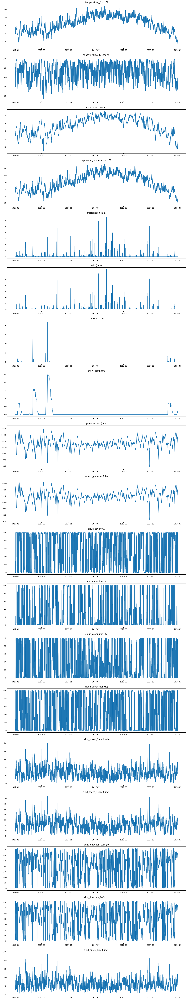

In [151]:
#plt.figure(figsize=(9, 6))
fig,axs=plt.subplots(19,1,figsize=(18,100))

column_list=['temperature_2m (°C)', 'relative_humidity_2m (%)',
       'dew_point_2m (°C)', 'apparent_temperature (°C)', 'precipitation (mm)',
       'rain (mm)', 'snowfall (cm)', 'snow_depth (m)', 'pressure_msl (hPa)',
       'surface_pressure (hPa)', 'cloud_cover (%)', 'cloud_cover_low (%)',
       'cloud_cover_mid (%)', 'cloud_cover_high (%)', 'wind_speed_10m (km/h)',
       'wind_speed_100m (km/h)', 'wind_direction_10m (°)',
       'wind_direction_100m (°)', 'wind_gusts_10m (km/h)']

for col ,ax in zip(column_list,axs.ravel()):
    ax.plot(df_weather['time'],df_weather[col])
    ax.set_title(col)
plt.show()

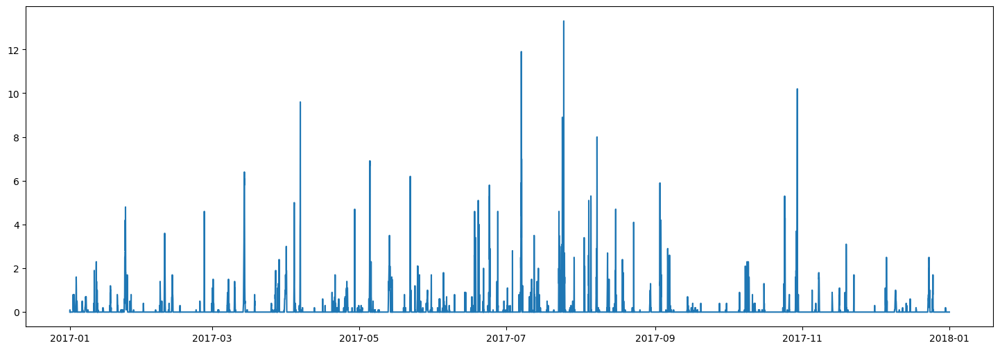

In [152]:
df_weather['date']=df_weather['time'].dt.date
plt.figure(figsize=(18, 6))
plt.plot(df_weather['time'],df_weather['precipitation (mm)'])
plt.show()

In [153]:
column_list=['fare_amount','temperature_2m (°C)', 'relative_humidity_2m (%)',
       'dew_point_2m (°C)', 'apparent_temperature (°C)', 'precipitation (mm)',
       'rain (mm)', 'snowfall (cm)', 'snow_depth (m)', 'pressure_msl (hPa)',
       'surface_pressure (hPa)', 'cloud_cover (%)', 'cloud_cover_low (%)',
       'cloud_cover_mid (%)', 'cloud_cover_high (%)', 'wind_speed_10m (km/h)',
       'wind_speed_100m (km/h)', 'wind_direction_10m (°)',
       'wind_direction_100m (°)', 'wind_gusts_10m (km/h)']
df_corr_all=df_clean[column_list].corr(method='spearman')
df_corr_all

,fare_amount,temperature_2m (°C),relative_humidity_2m (%),dew_point_2m (°C),apparent_temperature (°C),precipitation (mm),rain (mm),snowfall (cm),snow_depth (m),pressure_msl (hPa),surface_pressure (hPa),cloud_cover (%),cloud_cover_low (%),cloud_cover_mid (%),cloud_cover_high (%),wind_speed_10m (km/h),wind_speed_100m (km/h),wind_direction_10m (°),wind_direction_100m (°),wind_gusts_10m (km/h)
fare_amount,1.000000,0.030601,-0.033348,0.010789,0.025318,-0.017841,-0.017232,-0.004999,-0.008603,0.002988,0.003678,-0.007179,-0.005505,-0.021630,-0.002823,0.026605,-0.000291,0.000715,-0.005258,0.033299
temperature_2m (°C),0.030601,1.000000,0.071508,0.912998,0.991083,0.018228,0.064195,-0.161462,-0.533644,-0.225755,-0.201740,0.035649,0.076915,0.028994,0.076466,-0.079951,-0.189394,-0.155106,-0.144689,-0.004835
relative_humidity_2m (%),-0.033348,0.071508,1.000000,0.450727,0.162042,0.395266,0.406391,0.008293,-0.096369,-0.172078,-0.171967,0.375456,0.475128,0.279050,0.273981,-0.272460,-0.142322,-0.389243,-0.400937,-0.337728
dew_point_2m (°C),0.010789,0.912998,0.450727,1.000000,0.945580,0.163725,0.207980,-0.138733,-0.504838,-0.262239,-0.240712,0.171203,0.250488,0.129614,0.175075,-0.183380,-0.228799,-0.281545,-0.276401,-0.139946
apparent_temperature (°C),0.025318,0.991083,0.162042,0.945580,1.000000,0.035947,0.081991,-0.160036,-0.531511,-0.208256,-0.184506,0.057462,0.100165,0.039811,0.097816,-0.177565,-0.270173,-0.190454,-0.180206,-0.102303
precipitation (mm),-0.017841,0.018228,0.395266,0.163725,0.035947,1.000000,0.959187,0.256604,-0.049256,-0.229924,-0.230283,0.401287,0.391274,0.476056,0.284519,0.110955,0.106408,-0.217538,-0.212457,0.139674
rain (mm),-0.017232,0.064195,0.406391,0.207980,0.081991,0.959187,1.000000,-0.013886,-0.105957,-0.225426,-0.224546,0.381670,0.386684,0.445255,0.281517,0.109555,0.109995,-0.226366,-0.220188,0.140461
snowfall (cm),-0.004999,-0.161462,0.008293,-0.138733,-0.160036,0.256604,-0.013886,1.000000,0.200033,-0.040037,-0.044453,0.115131,0.065945,0.162853,0.038653,0.019283,0.002106,0.004832,0.002541,0.012349
snow_depth (m),-0.008603,-0.533644,-0.096369,-0.504838,-0.531511,-0.049256,-0.105957,0.200033,1.000000,0.084179,0.070642,-0.061329,-0.077128,-0.010032,-0.074653,0.051965,0.110825,0.155295,0.161472,0.015860
pressure_msl (hPa),0.002988,-0.225755,-0.172078,-0.262239,-0.208256,-0.229924,-0.225426,-0.040037,0.084179,1.000000,0.999562,-0.155297,-0.253178,-0.225013,-0.043406,-0.273795,-0.272436,-0.085687,-0.104306,-0.291023


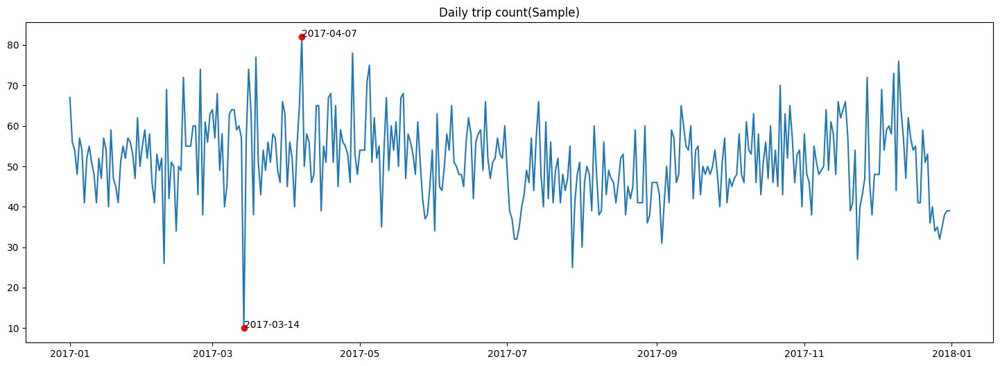

In [154]:
###############################################################
#count plot of pickup date
###############################################################
target_data=df_clean
target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
tmp_data=target_data.groupby(['PU_date'])['tpep_pickup_datetime'].agg(['count']).reset_index()
tmp_data['count_zscore']=tmp_data[['count']].apply(stats.zscore)
mask=(tmp_data['count_zscore']<-3)|(tmp_data['count_zscore']>3)
special_date_list=tmp_data[mask]['PU_date'].to_list()

plt.figure(figsize=(18, 6))
plt.plot(tmp_data['PU_date'],tmp_data['count'])

#add red marker to the dates which had more or less trip counts
plt.plot(tmp_data[tmp_data['PU_date'].isin(special_date_list)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(special_date_list)]['count'], 'ro')

#add text
for pu_date in special_date_list:
    x_value=tmp_data[tmp_data['PU_date']==pu_date]['PU_date']
    y_value=tmp_data[tmp_data['PU_date']==pu_date]['count']
    text=tmp_data.loc[tmp_data['PU_date'] == pu_date, 'PU_date'].values[0]
    #print(text)
    plt.text(x_value, y_value, text)

plt.title("Daily trip count(Sample)")
plt.show()
#=>Holidays(e.g. Christmas Day) and (heavy)snow day had less trips
#=>The lease fee limit are associated with weekday(weekday might associated with trip counts)
#If lease fee upper limit is associated with trip counts of that day and the descrease of trip counts were due to less taxi needs(NOT less drivers)
#Lower lease fee upper limit of these days(Federal holidays or bad weather) might be better
#Some bad weather might be difficult to predict for drivers, it might be good to add some cancel fee limitations of bad weather
#such as less cancel charge for short period lease if the cancelation is due to bad weather

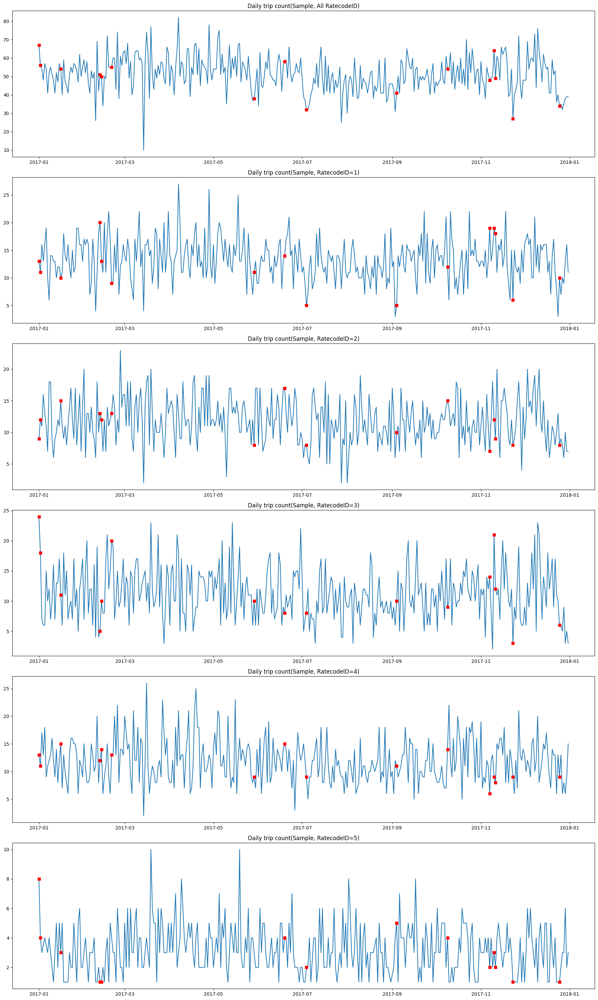

In [155]:
###############################################################
#count plot of pickup date
#with holiday
###############################################################
target_data=df_clean

fig, axs=plt.subplots(6,1,figsize=(18,30))

target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
tmp_data=target_data.groupby(['PU_date'])['tpep_pickup_datetime'].agg(['count']).reset_index()
tmp_data['PU_date']=pd.to_datetime(tmp_data['PU_date'])


axs[0].plot(tmp_data['PU_date'],tmp_data['count'])

NYC_HOLIDAY_LIST=df_nyc_holiday['Date'].to_list()

#add red marker to tholidays
axs[0].plot(tmp_data[tmp_data['PU_date'].isin(NYC_HOLIDAY_LIST)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(NYC_HOLIDAY_LIST)]['count'], 'rs')

axs[0].set_title("Daily trip count(Sample, All RatecodeID)")



ratecodeid_list=target_data['RatecodeID'].unique().tolist()
ratecodeid_list.sort()

for rate,row in zip(ratecodeid_list,range(1,len(ratecodeid_list)+1)):
    target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
    mask_rate=target_data['RatecodeID']==rate
    tmp_data=target_data[mask_rate].groupby(['PU_date'])['tpep_pickup_datetime'].agg(['count']).reset_index()
    tmp_data['PU_date']=pd.to_datetime(tmp_data['PU_date'])
    axs[row].plot(tmp_data['PU_date'],tmp_data['count'])

    #add red marker to tholidays
    axs[row].plot(tmp_data[tmp_data['PU_date'].isin(NYC_HOLIDAY_LIST)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(NYC_HOLIDAY_LIST)]['count'], 'rs')


    axs[row].set_title(f"Daily trip count(Sample, RatecodeID={rate})") 

plt.tight_layout()
plt.show()

#=>With equal ratecodeid ratio, not all holidays have very low trip counts
#=>With original dataset, not  all holidays have very low trip counts, Independence Day
#Labor Day, Thanksgiving Day, Christmas Day dropped

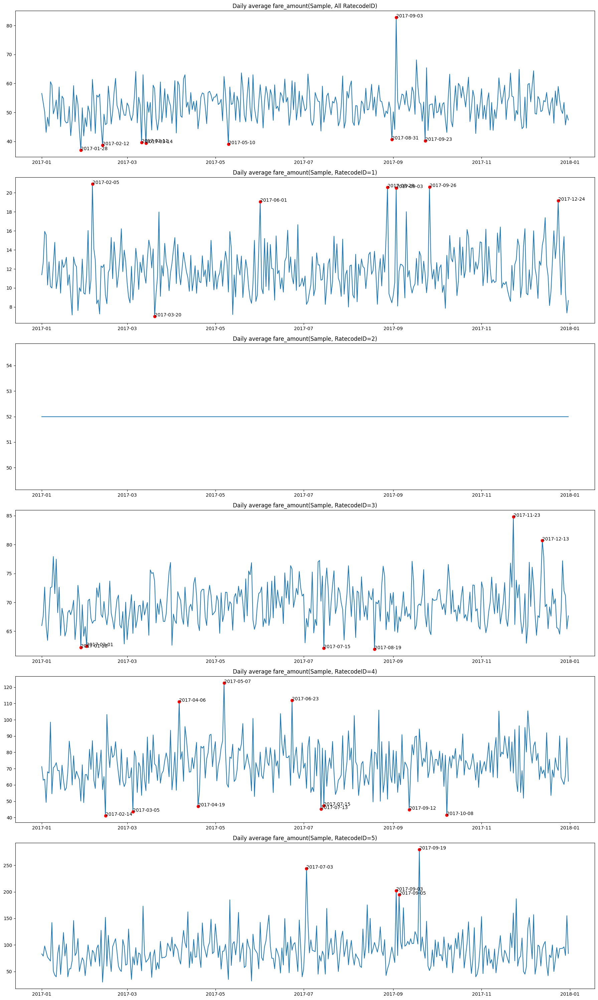

In [156]:
###############################################################
#plot of daily average fare_amount 
###############################################################
target_data=df_clean

fig, axs=plt.subplots(6,1,figsize=(18,30))

target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
tmp_data=target_data.groupby(['PU_date'])['fare_amount'].agg(['mean']).reset_index()
tmp_data['mean_zscore']=tmp_data[['mean']].apply(stats.zscore)
mask=(tmp_data['mean_zscore']<-2)|(tmp_data['mean_zscore']>3)
special_date_list=tmp_data[mask]['PU_date'].to_list()
#print(special_date_list)
axs[0].plot(tmp_data['PU_date'],tmp_data['mean'])

#add red marker to the dates which had more or less values
axs[0].plot(tmp_data[tmp_data['PU_date'].isin(special_date_list)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(special_date_list)]['mean'], 'ro')

#add text
for pu_date in special_date_list:
    x_value=tmp_data[tmp_data['PU_date']==pu_date]['PU_date']
    y_value=tmp_data[tmp_data['PU_date']==pu_date]['mean']
    text=tmp_data.loc[tmp_data['PU_date'] == pu_date, 'PU_date'].values[0]
    #print(text)
    axs[0].text(x_value, y_value, text)
axs[0].set_title("Daily average fare_amount(Sample, All RatecodeID)")



ratecodeid_list=target_data['RatecodeID'].unique().tolist()
ratecodeid_list.sort()

for rate,row in zip(ratecodeid_list,range(1,len(ratecodeid_list)+1)):
    target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
    mask_rate=target_data['RatecodeID']==rate
    tmp_data=target_data[mask_rate].groupby(['PU_date'])['fare_amount'].agg(['mean']).reset_index()
    tmp_data['mean_zscore']=tmp_data[['mean']].apply(stats.zscore)
    mask=(tmp_data['mean_zscore']<-2)|(tmp_data['mean_zscore']>3)
    special_date_list=tmp_data[mask]['PU_date'].to_list()
    axs[row].plot(tmp_data['PU_date'],tmp_data['mean'])

    #add red marker to the dates which had more or less values
    axs[row].plot(tmp_data[tmp_data['PU_date'].isin(special_date_list)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(special_date_list)]['mean'], 'ro')

    #add text
    for pu_date in special_date_list:
        x_value=tmp_data[tmp_data['PU_date']==pu_date]['PU_date']
        y_value=tmp_data[tmp_data['PU_date']==pu_date]['mean']
        text=tmp_data.loc[tmp_data['PU_date'] == pu_date, 'PU_date'].values[0]
        #print(text)
        axs[row].text(x_value, y_value, text)
    axs[row].set_title(f"Daily average fare_amount(Sample, RatecodeID={rate})") 

plt.tight_layout()
plt.show()

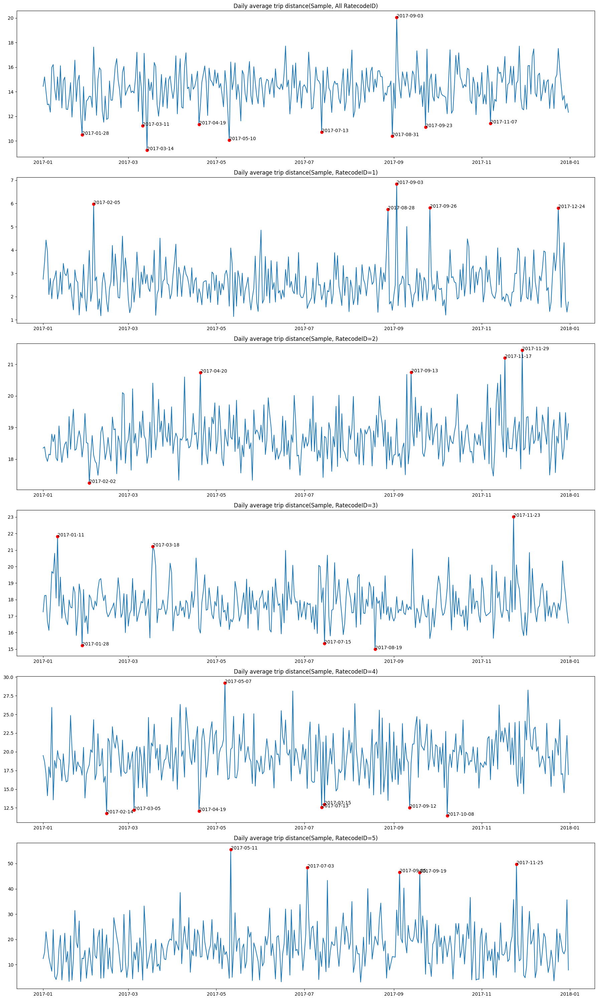

In [157]:
###############################################################
#plot of daily average trip_distance 
###############################################################
target_data=df_clean

fig, axs=plt.subplots(6,1,figsize=(18,30))

target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
tmp_data=target_data.groupby(['PU_date'])['trip_distance'].agg(['mean']).reset_index()
tmp_data['mean_zscore']=tmp_data[['mean']].apply(stats.zscore)
mask=(tmp_data['mean_zscore']<-2)|(tmp_data['mean_zscore']>3)
special_date_list=tmp_data[mask]['PU_date'].to_list()
#print(special_date_list)
axs[0].plot(tmp_data['PU_date'],tmp_data['mean'])

#add red marker to the dates which had more or less values
axs[0].plot(tmp_data[tmp_data['PU_date'].isin(special_date_list)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(special_date_list)]['mean'], 'ro')

#add text
for pu_date in special_date_list:
    x_value=tmp_data[tmp_data['PU_date']==pu_date]['PU_date']
    y_value=tmp_data[tmp_data['PU_date']==pu_date]['mean']
    text=tmp_data.loc[tmp_data['PU_date'] == pu_date, 'PU_date'].values[0]
    #print(text)
    axs[0].text(x_value, y_value, text)
axs[0].set_title("Daily average trip distance(Sample, All RatecodeID)")



ratecodeid_list=target_data['RatecodeID'].unique().tolist()
ratecodeid_list.sort()

for rate,row in zip(ratecodeid_list,range(1,len(ratecodeid_list)+1)):
    target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
    mask_rate=target_data['RatecodeID']==rate
    tmp_data=target_data[mask_rate].groupby(['PU_date'])['trip_distance'].agg(['mean']).reset_index()
    tmp_data['mean_zscore']=tmp_data[['mean']].apply(stats.zscore)
    mask=(tmp_data['mean_zscore']<-2)|(tmp_data['mean_zscore']>3)
    special_date_list=tmp_data[mask]['PU_date'].to_list()
    axs[row].plot(tmp_data['PU_date'],tmp_data['mean'])

    #add red marker to the dates which had more or less values
    axs[row].plot(tmp_data[tmp_data['PU_date'].isin(special_date_list)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(special_date_list)]['mean'], 'ro')

    #add text
    for pu_date in special_date_list:
        x_value=tmp_data[tmp_data['PU_date']==pu_date]['PU_date']
        y_value=tmp_data[tmp_data['PU_date']==pu_date]['mean']
        text=tmp_data.loc[tmp_data['PU_date'] == pu_date, 'PU_date'].values[0]
        #print(text)
        axs[row].text(x_value, y_value, text)
    axs[row].set_title(f"Daily average trip distance(Sample, RatecodeID={rate})") 

plt.tight_layout()
plt.show()

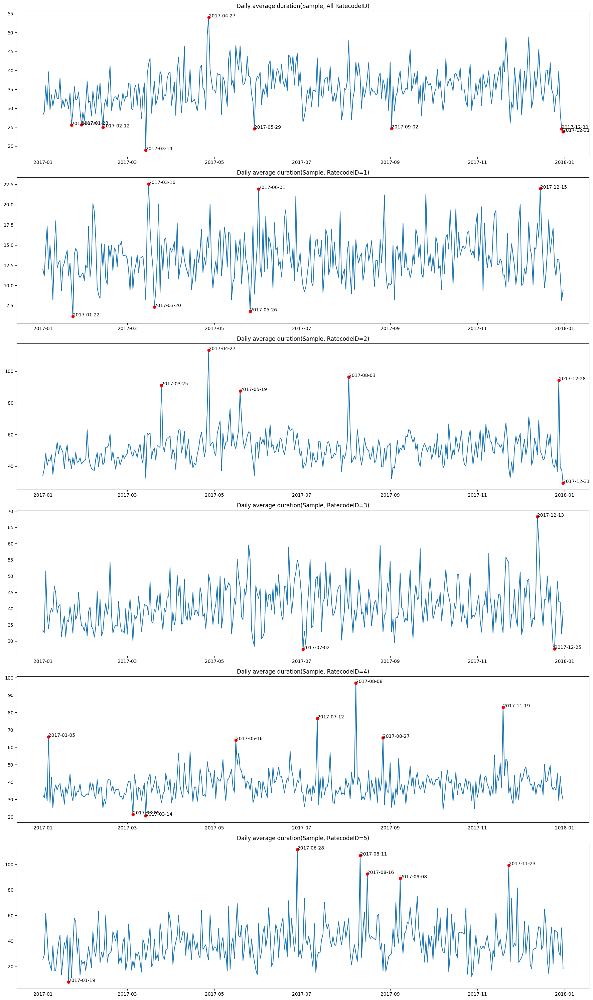

In [158]:
###############################################################
#plot of daily average duration 
###############################################################
target_data=df_clean

fig, axs=plt.subplots(6,1,figsize=(18,30))

target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
tmp_data=target_data.groupby(['PU_date'])['duration'].agg(['mean']).reset_index()
tmp_data['mean_zscore']=tmp_data[['mean']].apply(stats.zscore)
mask=(tmp_data['mean_zscore']<-2)|(tmp_data['mean_zscore']>3)
special_date_list=tmp_data[mask]['PU_date'].to_list()
#print(special_date_list)
axs[0].plot(tmp_data['PU_date'],tmp_data['mean'])

#add red marker to the dates which had more or less values
axs[0].plot(tmp_data[tmp_data['PU_date'].isin(special_date_list)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(special_date_list)]['mean'], 'ro')

#add text
for pu_date in special_date_list:
    x_value=tmp_data[tmp_data['PU_date']==pu_date]['PU_date']
    y_value=tmp_data[tmp_data['PU_date']==pu_date]['mean']
    text=tmp_data.loc[tmp_data['PU_date'] == pu_date, 'PU_date'].values[0]
    #print(text)
    axs[0].text(x_value, y_value, text)
axs[0].set_title("Daily average duration(Sample, All RatecodeID)")



ratecodeid_list=target_data['RatecodeID'].unique().tolist()
ratecodeid_list.sort()

for rate,row in zip(ratecodeid_list,range(1,len(ratecodeid_list)+1)):
    target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
    mask_rate=target_data['RatecodeID']==rate
    tmp_data=target_data[mask_rate].groupby(['PU_date'])['duration'].agg(['mean']).reset_index()
    tmp_data['mean_zscore']=tmp_data[['mean']].apply(stats.zscore)
    mask=(tmp_data['mean_zscore']<-2)|(tmp_data['mean_zscore']>3)
    special_date_list=tmp_data[mask]['PU_date'].to_list()
    axs[row].plot(tmp_data['PU_date'],tmp_data['mean'])

    #add red marker to the dates which had more or less values
    axs[row].plot(tmp_data[tmp_data['PU_date'].isin(special_date_list)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(special_date_list)]['mean'], 'ro')

    #add text
    for pu_date in special_date_list:
        x_value=tmp_data[tmp_data['PU_date']==pu_date]['PU_date']
        y_value=tmp_data[tmp_data['PU_date']==pu_date]['mean']
        text=tmp_data.loc[tmp_data['PU_date'] == pu_date, 'PU_date'].values[0]
        #print(text)
        axs[row].text(x_value, y_value, text)
    axs[row].set_title(f"Daily average duration(Sample, RatecodeID={rate})") 

plt.tight_layout()
plt.show()

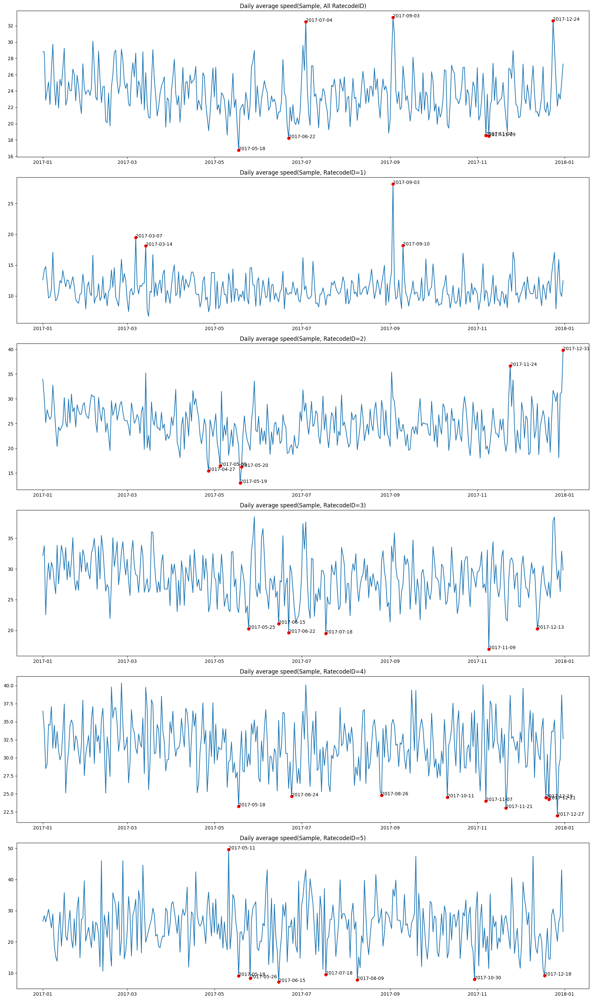

In [159]:
###############################################################
#plot of daily average avg_speed 
###############################################################
target_data=df_clean

fig, axs=plt.subplots(6,1,figsize=(18,30))

target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
tmp_data=target_data.groupby(['PU_date'])['avg_speed'].agg(['mean']).reset_index()
tmp_data['mean_zscore']=tmp_data[['mean']].apply(stats.zscore)
mask=(tmp_data['mean_zscore']<-2)|(tmp_data['mean_zscore']>3)
special_date_list=tmp_data[mask]['PU_date'].to_list()
#print(special_date_list)
axs[0].plot(tmp_data['PU_date'],tmp_data['mean'])

#add red marker to the dates which had more or less values
axs[0].plot(tmp_data[tmp_data['PU_date'].isin(special_date_list)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(special_date_list)]['mean'], 'ro')

#add text
for pu_date in special_date_list:
    x_value=tmp_data[tmp_data['PU_date']==pu_date]['PU_date']
    y_value=tmp_data[tmp_data['PU_date']==pu_date]['mean']
    text=tmp_data.loc[tmp_data['PU_date'] == pu_date, 'PU_date'].values[0]
    #print(text)
    axs[0].text(x_value, y_value, text)
axs[0].set_title("Daily average speed(Sample, All RatecodeID)")



ratecodeid_list=target_data['RatecodeID'].unique().tolist()
ratecodeid_list.sort()

for rate,row in zip(ratecodeid_list,range(1,len(ratecodeid_list)+1)):
    target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
    mask_rate=target_data['RatecodeID']==rate
    tmp_data=target_data[mask_rate].groupby(['PU_date'])['avg_speed'].agg(['mean']).reset_index()
    tmp_data['mean_zscore']=tmp_data[['mean']].apply(stats.zscore)
    mask=(tmp_data['mean_zscore']<-2)|(tmp_data['mean_zscore']>3)
    special_date_list=tmp_data[mask]['PU_date'].to_list()
    axs[row].plot(tmp_data['PU_date'],tmp_data['mean'])

    #add red marker to the dates which had more or less values
    axs[row].plot(tmp_data[tmp_data['PU_date'].isin(special_date_list)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(special_date_list)]['mean'], 'ro')

    #add text
    for pu_date in special_date_list:
        x_value=tmp_data[tmp_data['PU_date']==pu_date]['PU_date']
        y_value=tmp_data[tmp_data['PU_date']==pu_date]['mean']
        text=tmp_data.loc[tmp_data['PU_date'] == pu_date, 'PU_date'].values[0]
        #print(text)
        axs[row].text(x_value, y_value, text)
    axs[row].set_title(f"Daily average speed(Sample, RatecodeID={rate})") 

plt.tight_layout()
plt.show()

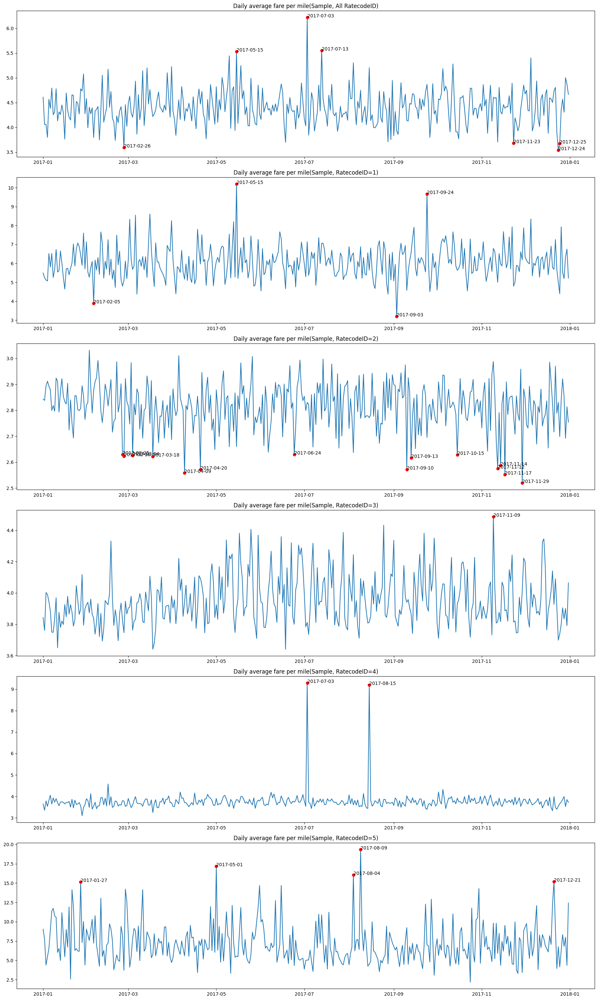

In [160]:
###############################################################
#plot of daily average fare_per_mile 
###############################################################
target_data=df_clean

fig, axs=plt.subplots(6,1,figsize=(18,30))

target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
tmp_data=target_data.groupby(['PU_date'])['fare_per_mile'].agg(['mean']).reset_index()
tmp_data['mean_zscore']=tmp_data[['mean']].apply(stats.zscore)
mask=(tmp_data['mean_zscore']<-2)|(tmp_data['mean_zscore']>3)
special_date_list=tmp_data[mask]['PU_date'].to_list()
#print(special_date_list)
axs[0].plot(tmp_data['PU_date'],tmp_data['mean'])

#add red marker to the dates which had more or less values
axs[0].plot(tmp_data[tmp_data['PU_date'].isin(special_date_list)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(special_date_list)]['mean'], 'ro')

#add text
for pu_date in special_date_list:
    x_value=tmp_data[tmp_data['PU_date']==pu_date]['PU_date']
    y_value=tmp_data[tmp_data['PU_date']==pu_date]['mean']
    text=tmp_data.loc[tmp_data['PU_date'] == pu_date, 'PU_date'].values[0]
    #print(text)
    axs[0].text(x_value, y_value, text)
axs[0].set_title("Daily average fare per mile(Sample, All RatecodeID)")



ratecodeid_list=target_data['RatecodeID'].unique().tolist()
ratecodeid_list.sort()


for rate,row in zip(ratecodeid_list,range(1,len(ratecodeid_list)+1)):
    target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
    mask_rate=target_data['RatecodeID']==rate
    tmp_data=target_data[mask_rate].groupby(['PU_date'])['fare_per_mile'].agg(['mean']).reset_index()
    tmp_data['mean_zscore']=tmp_data[['mean']].apply(stats.zscore)
    mask=(tmp_data['mean_zscore']<-2)|(tmp_data['mean_zscore']>3)
    special_date_list=tmp_data[mask]['PU_date'].to_list()
    axs[row].plot(tmp_data['PU_date'],tmp_data['mean'])

    #add red marker to the dates which had more or less values
    axs[row].plot(tmp_data[tmp_data['PU_date'].isin(special_date_list)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(special_date_list)]['mean'], 'ro')

    #add text
    for pu_date in special_date_list:
        x_value=tmp_data[tmp_data['PU_date']==pu_date]['PU_date']
        y_value=tmp_data[tmp_data['PU_date']==pu_date]['mean']
        text=tmp_data.loc[tmp_data['PU_date'] == pu_date, 'PU_date'].values[0]
        #print(text)
        axs[row].text(x_value, y_value, text)
    axs[row].set_title(f"Daily average fare per mile(Sample, RatecodeID={rate})") 

plt.tight_layout()
plt.show()

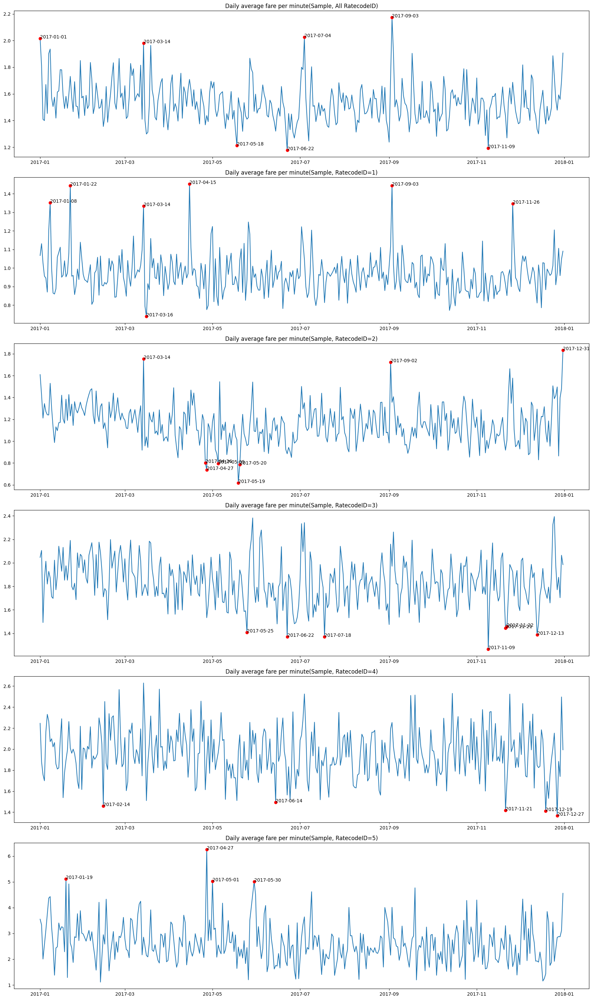

In [161]:
###############################################################
#plot of daily average fare_per_minute 
###############################################################
target_data=df_clean

fig, axs=plt.subplots(6,1,figsize=(18,30))

target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
tmp_data=target_data.groupby(['PU_date'])['fare_per_minute'].agg(['mean']).reset_index()
tmp_data['mean_zscore']=tmp_data[['mean']].apply(stats.zscore)
mask=(tmp_data['mean_zscore']<-2)|(tmp_data['mean_zscore']>3)
special_date_list=tmp_data[mask]['PU_date'].to_list()
#print(special_date_list)
axs[0].plot(tmp_data['PU_date'],tmp_data['mean'])

#add red marker to the dates which had more or less values
axs[0].plot(tmp_data[tmp_data['PU_date'].isin(special_date_list)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(special_date_list)]['mean'], 'ro')

#add text
for pu_date in special_date_list:
    x_value=tmp_data[tmp_data['PU_date']==pu_date]['PU_date']
    y_value=tmp_data[tmp_data['PU_date']==pu_date]['mean']
    text=tmp_data.loc[tmp_data['PU_date'] == pu_date, 'PU_date'].values[0]
    #print(text)
    axs[0].text(x_value, y_value, text)
axs[0].set_title("Daily average fare per minute(Sample, All RatecodeID)")



ratecodeid_list=target_data['RatecodeID'].unique().tolist()
ratecodeid_list.sort()

for rate,row in zip(ratecodeid_list,range(1,len(ratecodeid_list)+1)):
    target_data['PU_date']=target_data['tpep_pickup_datetime'].dt.date
    mask_rate=target_data['RatecodeID']==rate
    tmp_data=target_data[mask_rate].groupby(['PU_date'])['fare_per_minute'].agg(['mean']).reset_index()
    tmp_data['mean_zscore']=tmp_data[['mean']].apply(stats.zscore)
    mask=(tmp_data['mean_zscore']<-2)|(tmp_data['mean_zscore']>3)
    special_date_list=tmp_data[mask]['PU_date'].to_list()
    axs[row].plot(tmp_data['PU_date'],tmp_data['mean'])

    #add red marker to the dates which had more or less values
    axs[row].plot(tmp_data[tmp_data['PU_date'].isin(special_date_list)]['PU_date'], tmp_data[tmp_data['PU_date'].isin(special_date_list)]['mean'], 'ro')

    #add text
    for pu_date in special_date_list:
        x_value=tmp_data[tmp_data['PU_date']==pu_date]['PU_date']
        y_value=tmp_data[tmp_data['PU_date']==pu_date]['mean']
        text=tmp_data.loc[tmp_data['PU_date'] == pu_date, 'PU_date'].values[0]
        #print(text)
        axs[row].text(x_value, y_value, text)
    axs[row].set_title(f"Daily average fare per minute(Sample, RatecodeID={rate})") 

plt.tight_layout()
plt.show()

In [162]:
column_list=['fare_amount','trip_distance', 'duration',
       'avg_speed', 'fare_per_minute', 'fare_per_mile',
       'NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices']
df_corr_all=df_clean[column_list].corr(method='spearman')
display(df_corr_all)

res = stats.spearmanr(df_clean['NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices'],df_clean['fare_per_mile'])
print(res)

,fare_amount,trip_distance,duration,avg_speed,fare_per_minute,fare_per_mile,NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices
fare_amount,1.000000,0.823513,0.697042,0.636446,0.608985,-0.233130,0.006019
trip_distance,0.823513,1.000000,0.772404,0.664287,0.405871,-0.618357,0.008750
duration,0.697042,0.772404,1.000000,0.211829,-0.011393,-0.509246,0.003119
avg_speed,0.636446,0.664287,0.211829,1.000000,0.841301,-0.503012,0.003745
fare_per_minute,0.608985,0.405871,-0.011393,0.841301,1.000000,-0.036702,0.002537
fare_per_mile,-0.233130,-0.618357,-0.509246,-0.503012,-0.036702,1.000000,-0.000048
NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices,0.006019,0.008750,0.003119,0.003745,0.002537,-0.000048,1.000000


SignificanceResult(statistic=-4.788194706374415e-05, pvalue=0.9947693306489075)


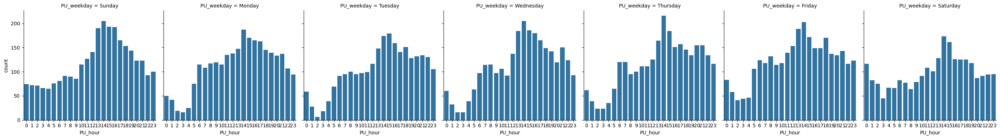

In [163]:
###############################################################
#count plot of pickup hour and weekday
###############################################################
target_data=df_clean
g = sns.FacetGrid(target_data, col="PU_weekday", height=4, aspect=1)
g.map(sns.countplot, "PU_hour")
plt.show()

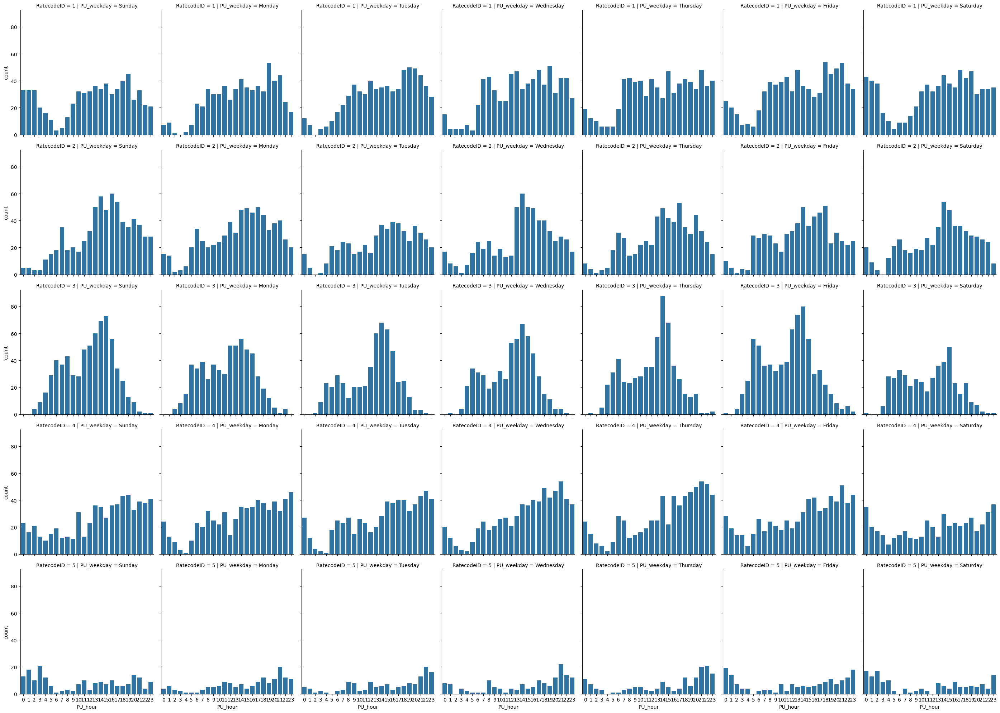

In [164]:
###############################################################
#count plot of pickup hour, weekday  and RatecodeID
###############################################################
target_data=df_clean.groupby(['PU_weekday','PU_hour','RatecodeID'])['fare_amount'].agg(['count']).reset_index()
sns.catplot(
    data=target_data, x="PU_hour", y="count", col="PU_weekday",
    row='RatecodeID',kind="bar", height=4, aspect=1,
    color=BAR_COLOR_BLUE,sharey=True
)
plt.show()

##### fare_amount

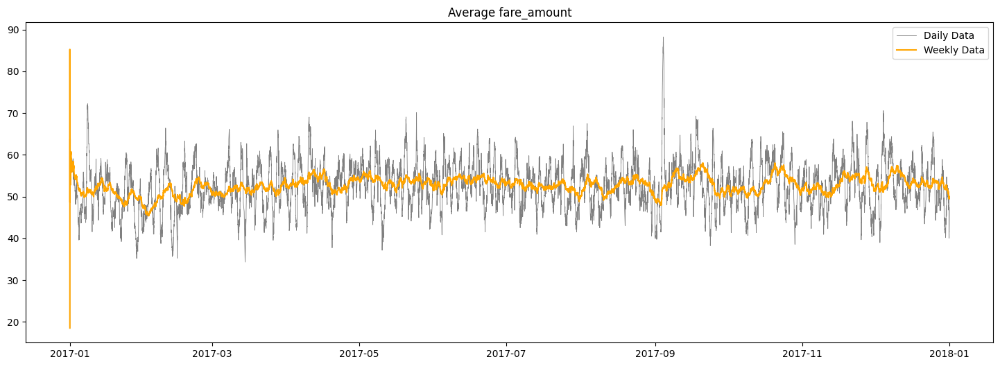

In [165]:
# Compute the centered 1 day rolling mean
plt.figure(figsize=(18, 6))
tmp_data=df_clean.sort_values(['tpep_pickup_datetime'])
daily_data = tmp_data[['tpep_pickup_datetime','fare_amount']].rolling('1d', on='tpep_pickup_datetime').mean()
plt.plot(daily_data['tpep_pickup_datetime']
         ,daily_data["fare_amount"]
         ,linewidth=0.6
         ,label="Daily Data"
         ,color="grey",
        )

# Compute the centered 1 week rolling mean
weekly_data = tmp_data[['tpep_pickup_datetime','fare_amount']].rolling('7d', on='tpep_pickup_datetime').mean()
plt.plot(weekly_data['tpep_pickup_datetime']
         ,weekly_data["fare_amount"]
         ,label="Weekly Data"
         ,color="orange",
        )

plt.title("Average fare_amount")
plt.legend()
plt.show()

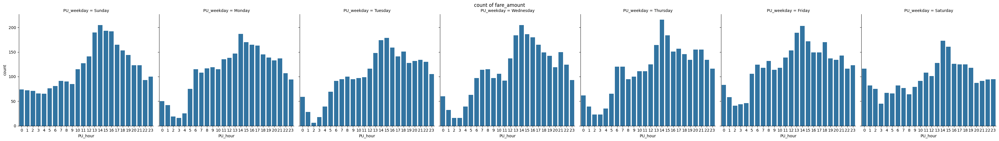

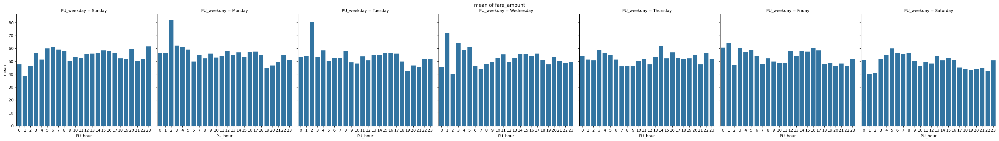

In [166]:
###############################################################
#plot by pickup hour and weekday
###############################################################
target_data=df_clean.groupby(['PU_weekday','PU_hour'])['fare_amount'].agg(['count','sum','mean']).reset_index()

#plot of count of fare_amount
g0 = sns.FacetGrid(target_data, col="PU_weekday", height=5, aspect=1)
g0.map_dataframe(sns.barplot, x="PU_hour", y="count")
g0.fig.subplots_adjust(top=0.9)
g0.fig.suptitle("count of fare_amount")

#plot of mean of fare_amount
g1 = sns.FacetGrid(target_data, col="PU_weekday", height=5, aspect=1)
g1.map_dataframe(sns.barplot, x="PU_hour", y="mean")
g1.fig.subplots_adjust(top=0.9)
g1.fig.suptitle("mean of fare_amount")



plt.show(g0)
plt.show(g1)



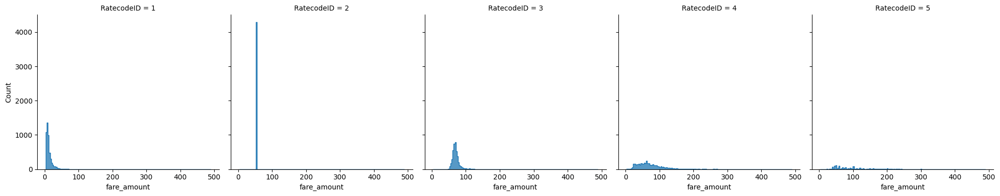

In [167]:
###############################################################
#Hist plot of fare_amount by RatecodeID
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="fare_amount", col="RatecodeID"
            ,height=4, aspect=1
            ,palette="deep", element="step")
plt.show()

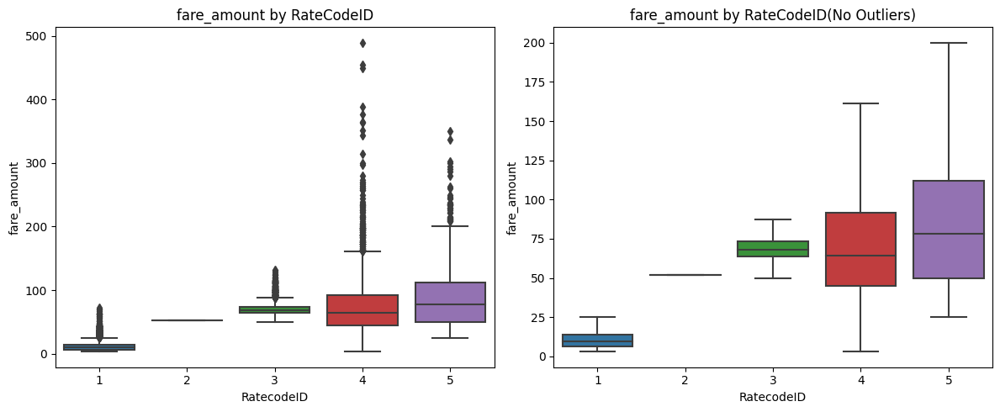

In [168]:
###############################################################
#box plot of fare_amount by RateCodeID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_clean
sns.boxplot(data=target_data, y="fare_amount",x="RatecodeID",ax=axs[0])
axs[0].set_title("fare_amount by RateCodeID")

#no outliers
sns.boxplot(data=target_data, y="fare_amount",x="RatecodeID",ax=axs[1],showfliers=False)
axs[1].set_title("fare_amount by RateCodeID(No Outliers)")

plt.tight_layout()
plt.show()

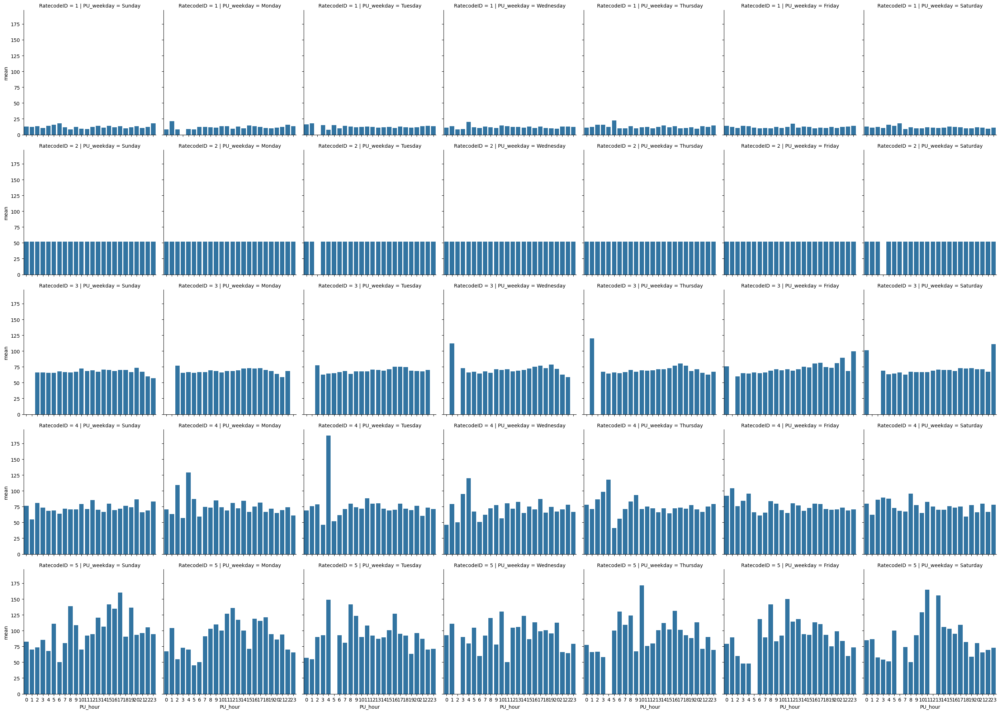

In [169]:
###############################################################
#plot by pickup hour,weekday and RatecodeID
###############################################################
target_data=df_clean.groupby(['PU_weekday','PU_hour','RatecodeID'])['fare_amount'].agg(['sum','mean']).reset_index()
sns.catplot(
    data=target_data, x="PU_hour", y="mean", col="PU_weekday",
    row='RatecodeID',kind="bar", height=4, aspect=1,
    color=BAR_COLOR_BLUE
)
plt.show()

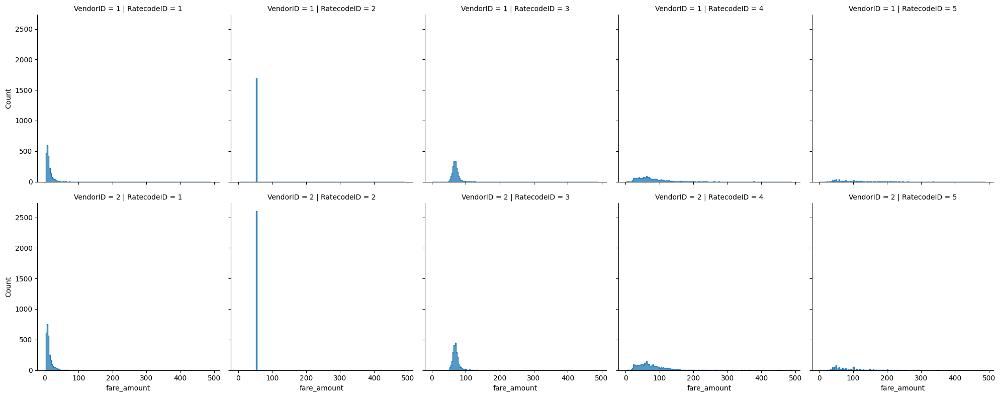

In [170]:
###############################################################
#Hist plot of fare_amount by VendorID
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="fare_amount", col="RatecodeID",row='VendorID'
            ,height=4, aspect=1
            ,palette="deep", element="step")
plt.show()

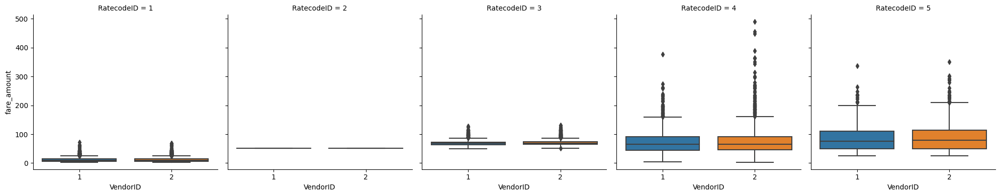

In [171]:
###############################################################
#box plot of fare_amount by VendorID
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="VendorID", y="fare_amount", col="RatecodeID",
    kind="box", height=4, aspect=1,
)
plt.show()

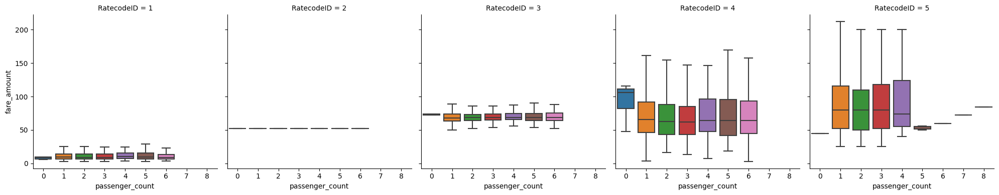

In [172]:
###############################################################
#box plot of fare_amount by Passenger_count
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="passenger_count", y="fare_amount", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

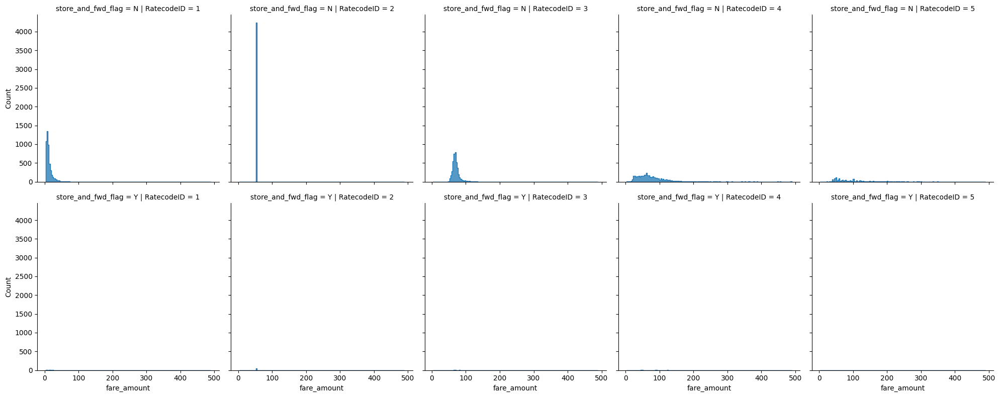

In [173]:
###############################################################
#Hist plot of fare_amount by Store_and_fwd_flag
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="fare_amount", col="RatecodeID",row='store_and_fwd_flag'
            ,height=4, aspect=1
            ,palette="deep", element="step")
plt.show()

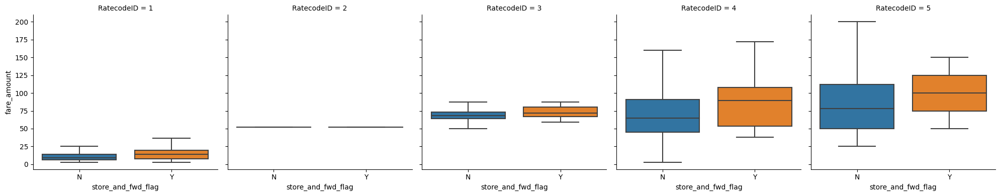

In [174]:
###############################################################
#box plot of fare_amount by Store_and_fwd_flag
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="store_and_fwd_flag", y="fare_amount", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

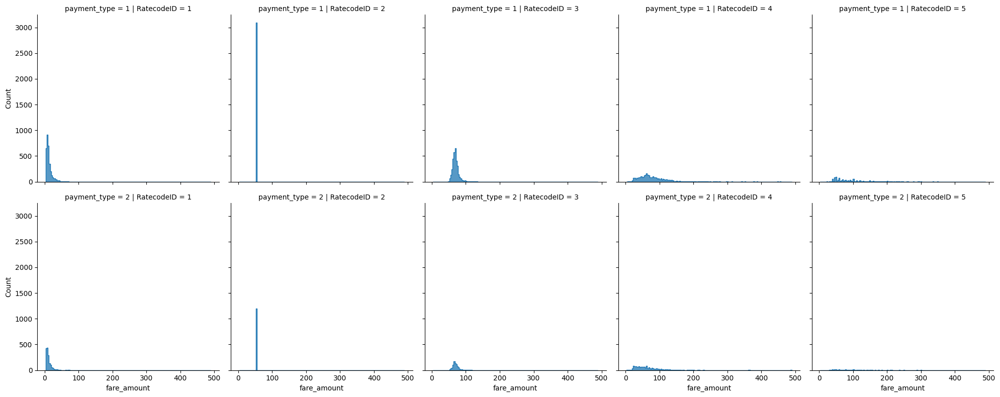

In [175]:
###############################################################
#Hist plot of fare_amount by Payment_type
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="fare_amount", col="RatecodeID",row='payment_type'
            ,height=4, aspect=1
            ,palette="deep", element="step")
plt.show()

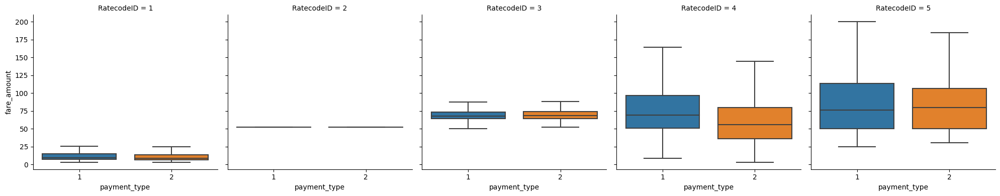

In [176]:
###############################################################
#box plot of fare_amount by Payment_type
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="payment_type", y="fare_amount", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

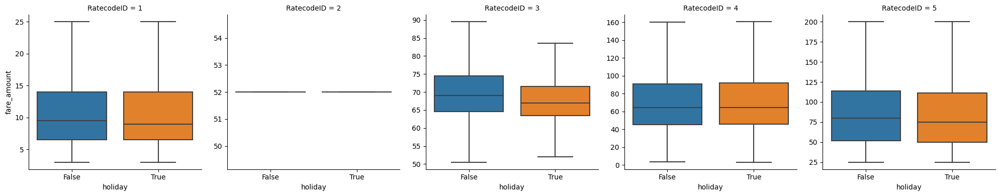

In [177]:
###############################################################
#box plot of fare_amount by holiday
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="holiday", y="fare_amount", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False,sharey=False
)
plt.show()

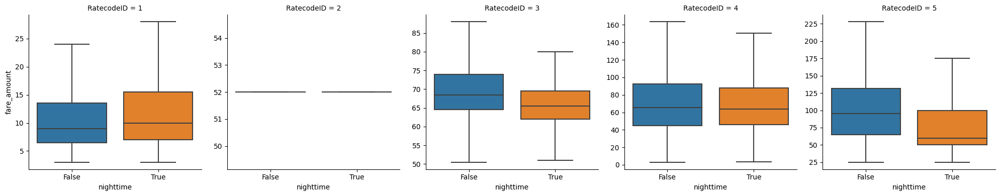

In [178]:
###############################################################
#box plot of fare_amount by nighttime
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="nighttime", y="fare_amount", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False,sharey=False
)
plt.show()

##### trip_distance 

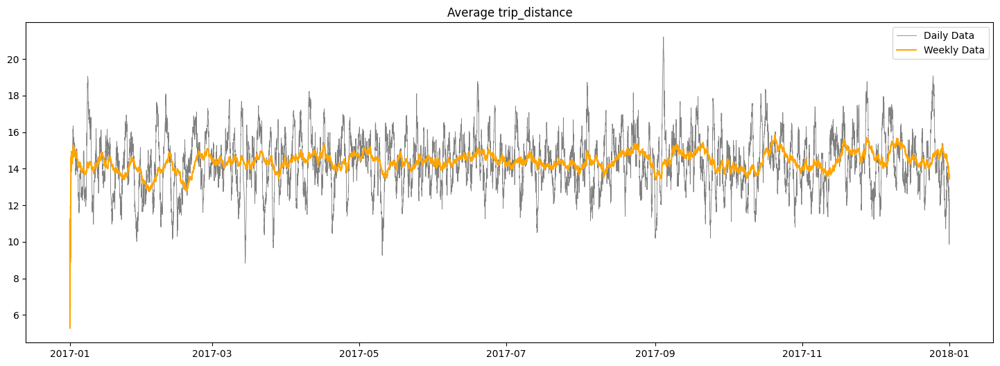

In [179]:
# Compute the centered 1 day rolling mean
plt.figure(figsize=(18, 6))
tmp_data=df_clean.sort_values(['tpep_pickup_datetime'])
daily_data = tmp_data[['tpep_pickup_datetime','trip_distance']].rolling('1d', on='tpep_pickup_datetime').mean()
plt.plot(daily_data['tpep_pickup_datetime']
         ,daily_data["trip_distance"]
         ,linewidth=0.6
         ,label="Daily Data"
         ,color="grey",
        )

# Compute the centered 1 week rolling mean
weekly_data = tmp_data[['tpep_pickup_datetime','trip_distance']].rolling('7d', on='tpep_pickup_datetime').mean()
plt.plot(weekly_data['tpep_pickup_datetime']
         ,weekly_data["trip_distance"]
         ,label="Weekly Data"
         ,color="orange",
        )

plt.title("Average trip_distance")
plt.legend()
plt.show()

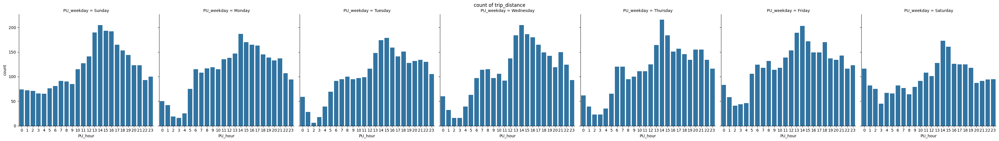

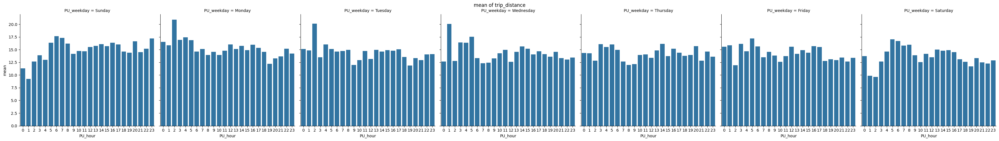

In [180]:
###############################################################
#plot by pickup hour and weekday
###############################################################
target_data=df_clean.groupby(['PU_weekday','PU_hour'])['trip_distance'].agg(['count','sum','mean']).reset_index()

#plot of count of trip_distance
g0 = sns.FacetGrid(target_data, col="PU_weekday", height=5, aspect=1)
g0.map_dataframe(sns.barplot, x="PU_hour", y="count")
g0.fig.subplots_adjust(top=0.9)
g0.fig.suptitle("count of trip_distance")

#plot of mean of trip_distance
g1 = sns.FacetGrid(target_data, col="PU_weekday", height=5, aspect=1)
g1.map_dataframe(sns.barplot, x="PU_hour", y="mean")
g1.fig.subplots_adjust(top=0.9)
g1.fig.suptitle("mean of trip_distance")


plt.show(g0)
plt.show(g1)



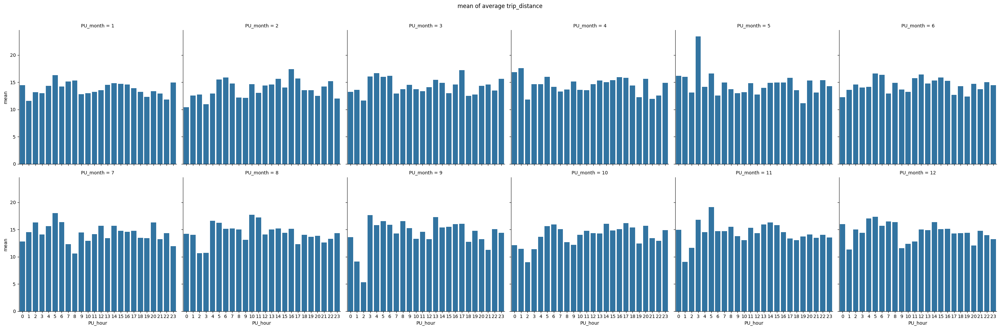

In [181]:
###############################################################
#plot by pickup hour and pickup month
###############################################################
target_data=df_clean.groupby(['PU_month','PU_hour'])['trip_distance'].agg(['sum','mean','count']).reset_index()


#plot of mean of avg_speed
g1 = sns.FacetGrid(target_data, col="PU_month", height=5, aspect=1,col_wrap=6)
g1.map_dataframe(sns.barplot, x="PU_hour", y="mean")
g1.fig.subplots_adjust(top=0.9)
g1.fig.suptitle("mean of average trip_distance")


plt.show(g1)

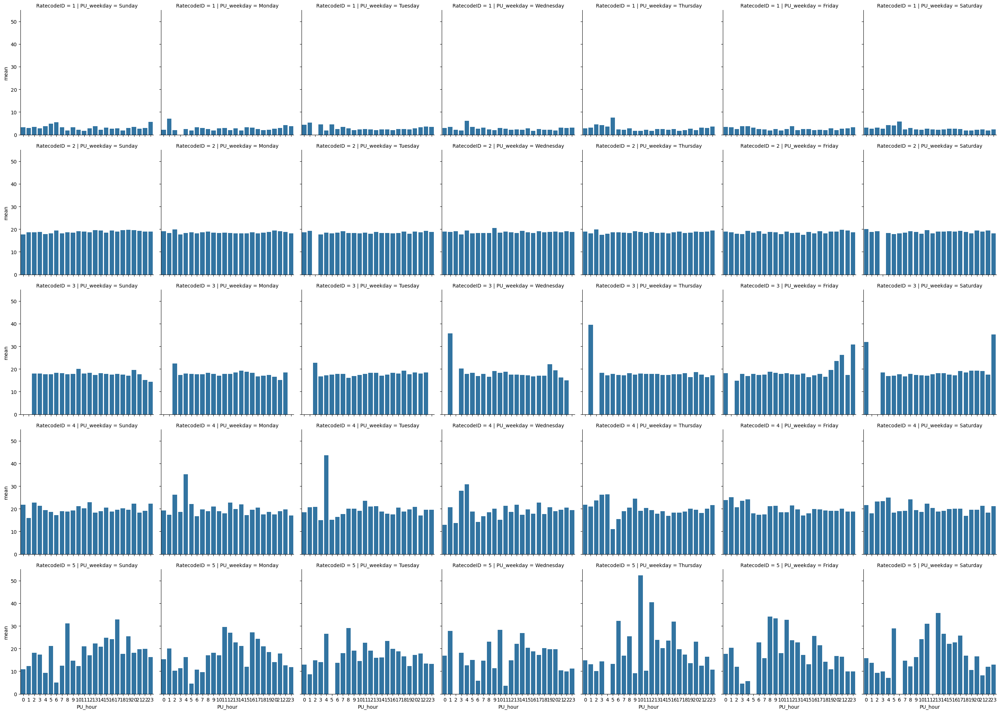

In [182]:
###############################################################
#plot by pickup hour,weekday and RatecodeID
###############################################################
target_data=df_clean.groupby(['PU_weekday','PU_hour','RatecodeID'])['trip_distance'].agg(['sum','mean']).reset_index()
sns.catplot(
    data=target_data, x="PU_hour", y="mean", col="PU_weekday",
    row='RatecodeID',kind="bar", height=4, aspect=1,
    color=BAR_COLOR_BLUE
)
plt.show()

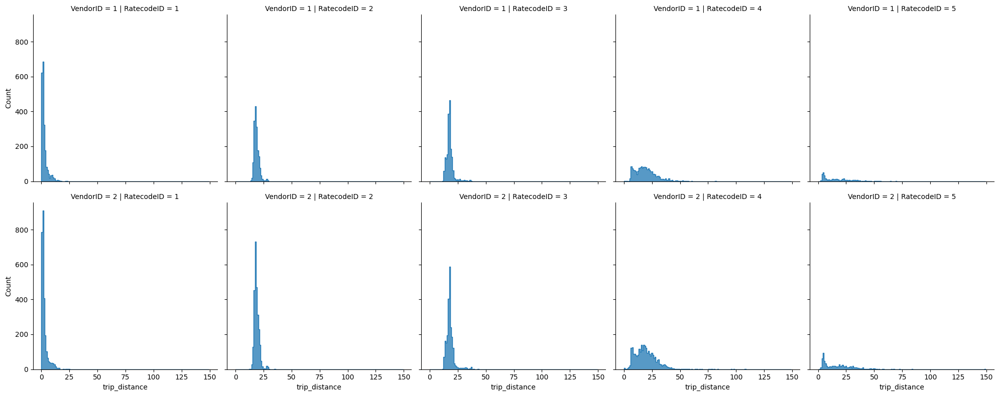

In [183]:
###############################################################
#Hist plot of trip_distance by VendorID
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="trip_distance", col="RatecodeID",row='VendorID'
            ,height=4, aspect=1
            ,palette="deep", element="step")
plt.show()

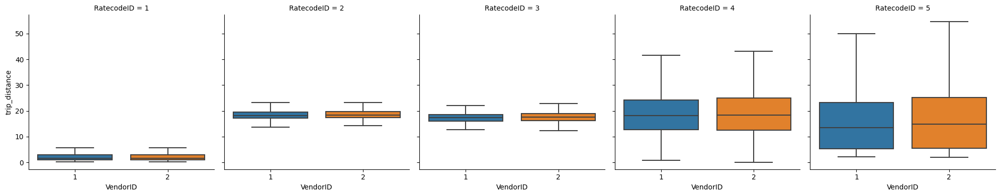

In [184]:
###############################################################
#box plot of trip_distance by VendorID
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="VendorID", y="trip_distance", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

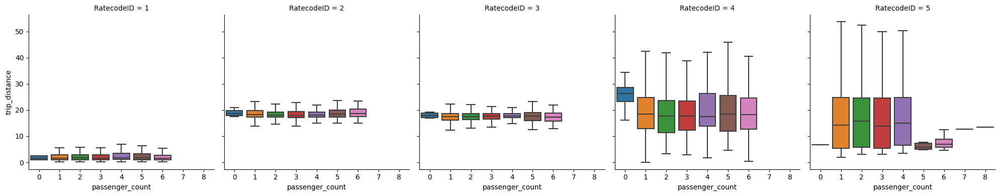

In [185]:
###############################################################
#box plot of trip_distance by Passenger_count
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="passenger_count", y="trip_distance", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

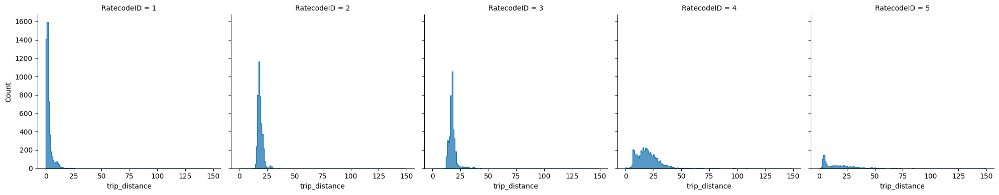

In [186]:
###############################################################
#Hist plot of trip_distance by RatecodeID
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="trip_distance", col="RatecodeID"
            ,height=4, aspect=1
            ,palette="deep", element="step")
plt.show()

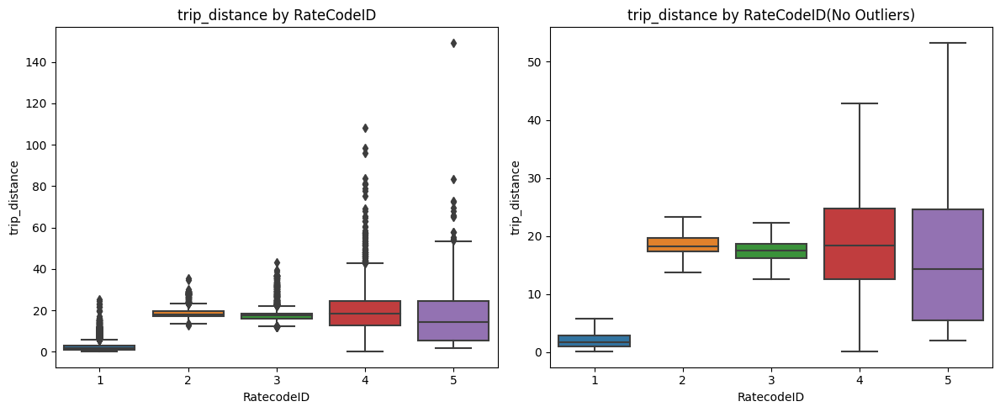

In [187]:
###############################################################
#box plot of trip_distance by RateCodeID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_clean
sns.boxplot(data=target_data, y="trip_distance",x="RatecodeID",ax=axs[0])
axs[0].set_title("trip_distance by RateCodeID")

#no outliers
sns.boxplot(data=target_data, y="trip_distance",x="RatecodeID",ax=axs[1],showfliers=False)
axs[1].set_title("trip_distance by RateCodeID(No Outliers)")

plt.tight_layout()
plt.show()

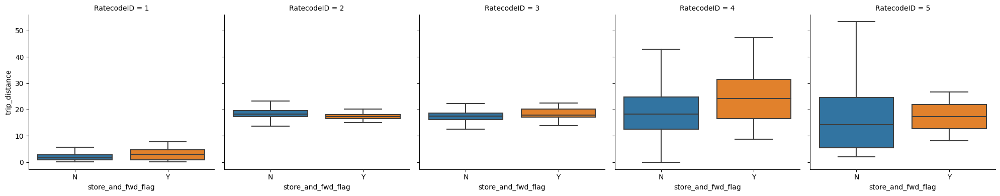

In [188]:
###############################################################
#box plot of trip_distance by Store_and_fwd_flag
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="store_and_fwd_flag", y="trip_distance", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

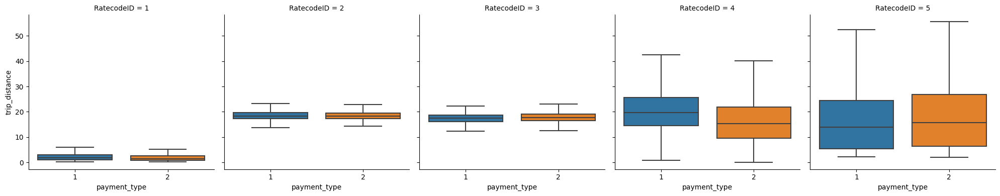

In [189]:
###############################################################
#box plot of trip_distance by Payment_type
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="payment_type", y="trip_distance", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

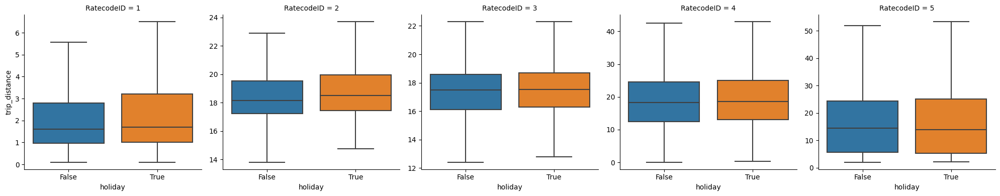

In [190]:
###############################################################
#box plot of trip_distance by holiday
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="holiday", y="trip_distance", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False,sharey=False
)
plt.show()

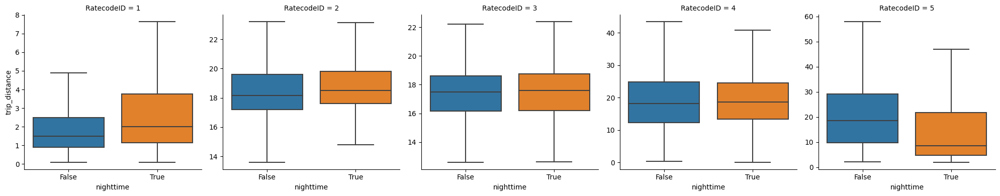

In [191]:
###############################################################
#box plot of trip_distance by nighttime
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="nighttime", y="trip_distance", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False,sharey=False
)
plt.show()

##### duration 

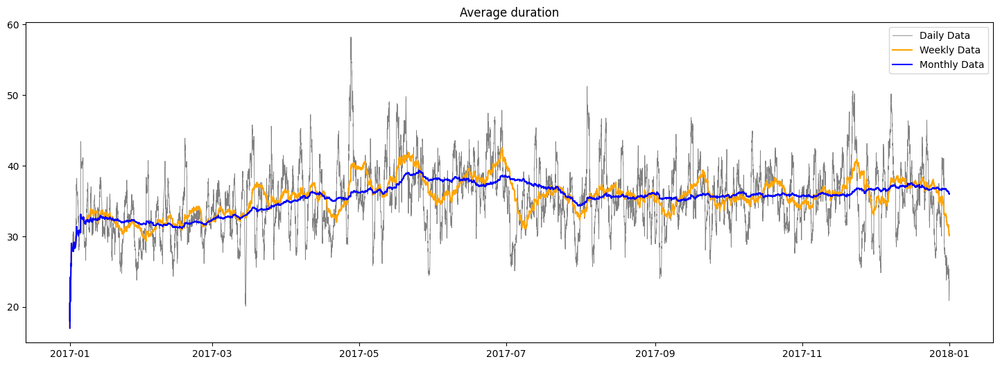

In [192]:
# Compute the centered 1 day rolling mean
plt.figure(figsize=(18, 6))
tmp_data=df_clean.sort_values(['tpep_pickup_datetime'])
daily_data = tmp_data[['tpep_pickup_datetime','duration']].rolling('1d', on='tpep_pickup_datetime').mean()
plt.plot(daily_data['tpep_pickup_datetime']
         ,daily_data["duration"]
         ,linewidth=0.6
         ,label="Daily Data"
         ,color="grey",
        )

# Compute the centered 1 week rolling mean
weekly_data = tmp_data[['tpep_pickup_datetime','duration']].rolling('7d', on='tpep_pickup_datetime').mean()
plt.plot(weekly_data['tpep_pickup_datetime']
         ,weekly_data["duration"]
         ,label="Weekly Data"
         ,color="orange",
        )

# Compute the centered 1 month rolling mean
monthly_data = tmp_data[['tpep_pickup_datetime','duration']].rolling('30d', on='tpep_pickup_datetime').mean()
plt.plot(monthly_data['tpep_pickup_datetime']
         ,monthly_data["duration"]
         ,label="Monthly Data"
         ,color="blue",
        )

plt.title("Average duration")
plt.legend()
plt.show()

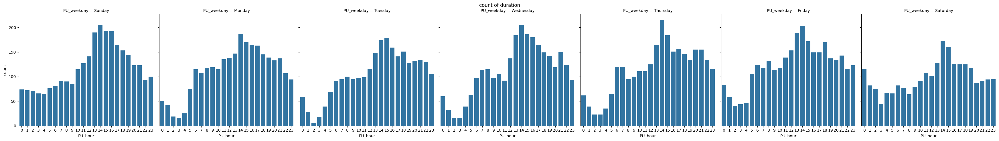

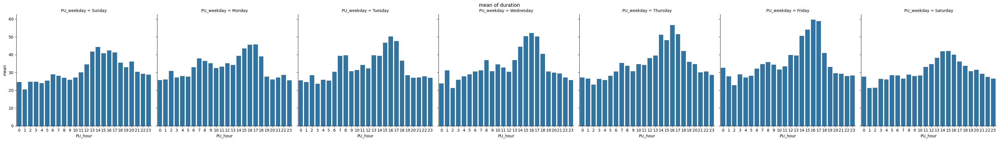

In [193]:
###############################################################
#plot by pickup hour and weekday
###############################################################
target_data=df_clean.groupby(['PU_weekday','PU_hour'])['duration'].agg(['count','sum','mean']).reset_index()

#plot of count of duration
g0 = sns.FacetGrid(target_data, col="PU_weekday", height=5, aspect=1)
g0.map_dataframe(sns.barplot, x="PU_hour", y="count")
g0.fig.subplots_adjust(top=0.9)
g0.fig.suptitle("count of duration")

#plot of mean of duration
g1 = sns.FacetGrid(target_data, col="PU_weekday", height=5, aspect=1)
g1.map_dataframe(sns.barplot, x="PU_hour", y="mean")
g1.fig.subplots_adjust(top=0.9)
g1.fig.suptitle("mean of duration")



plt.show(g0)
plt.show(g1)


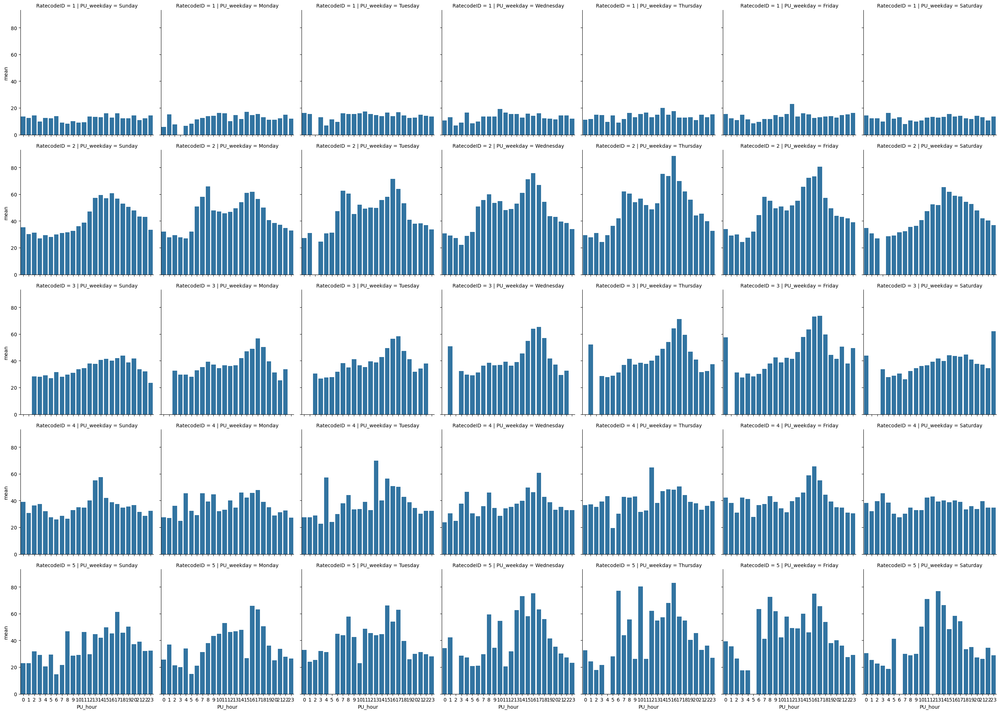

In [194]:
###############################################################
#plot by pickup hour,weekday and RatecodeID
###############################################################
target_data=df_clean.groupby(['PU_weekday','PU_hour','RatecodeID'])['duration'].agg(['sum','mean']).reset_index()
sns.catplot(
    data=target_data, x="PU_hour", y="mean", col="PU_weekday",
    row='RatecodeID',kind="bar", height=4, aspect=1,facet_kws=dict(sharex=True)
    ,color=BAR_COLOR_BLUE
)
plt.show()

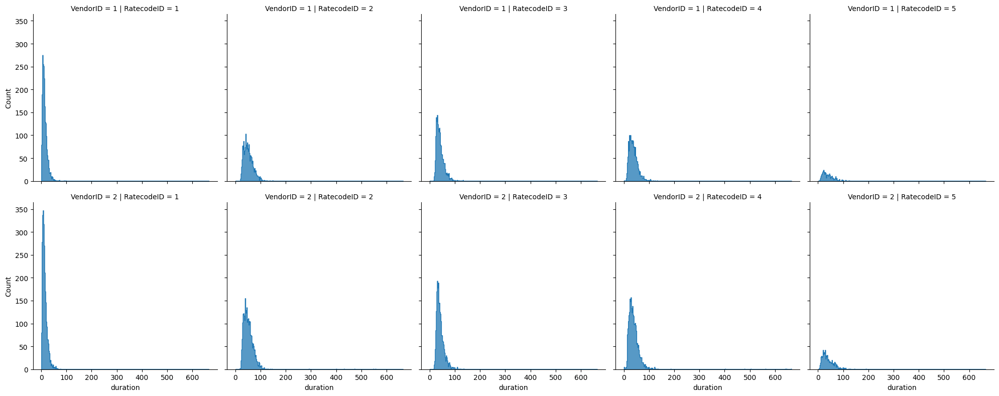

In [195]:
###############################################################
#Hist plot of duration by VendorID
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="duration", col="RatecodeID",row='VendorID'
            ,height=4, aspect=1
            ,palette="deep", element="step")
plt.show()

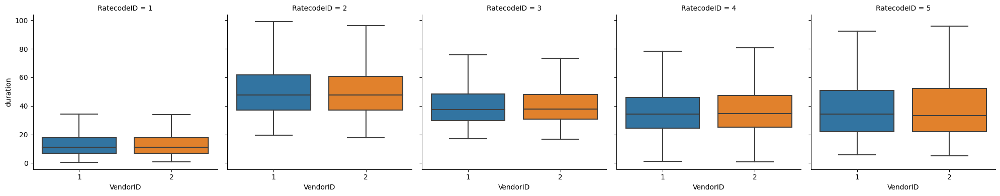

In [196]:
###############################################################
#box plot of duration by VendorID
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="VendorID", y="duration", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

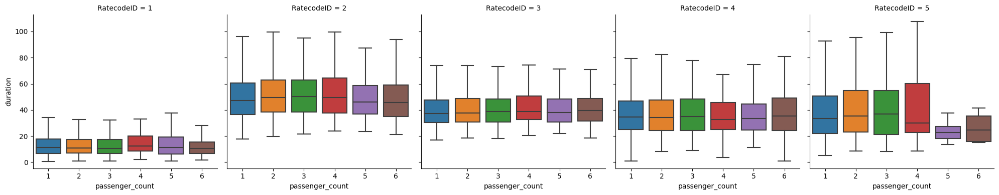

In [197]:
###############################################################
#box plot of duration by Passenger_count
###############################################################
target_data=df_clean[(df_clean['passenger_count']<=6)&(df_clean['passenger_count']>0)]
sns.catplot(
    data=target_data, x="passenger_count", y="duration", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

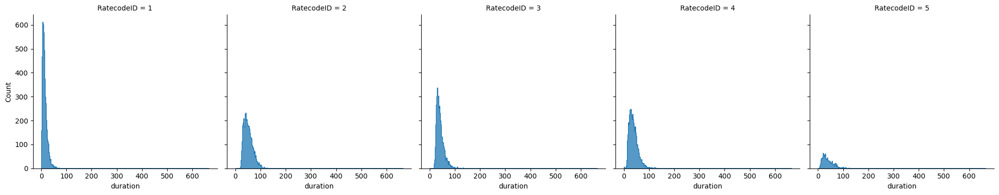

In [198]:
###############################################################
#Hist plot of duration by RatecodeID
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="duration", col="RatecodeID"
            ,height=4, aspect=1
            ,palette="deep", element="step")
plt.show()

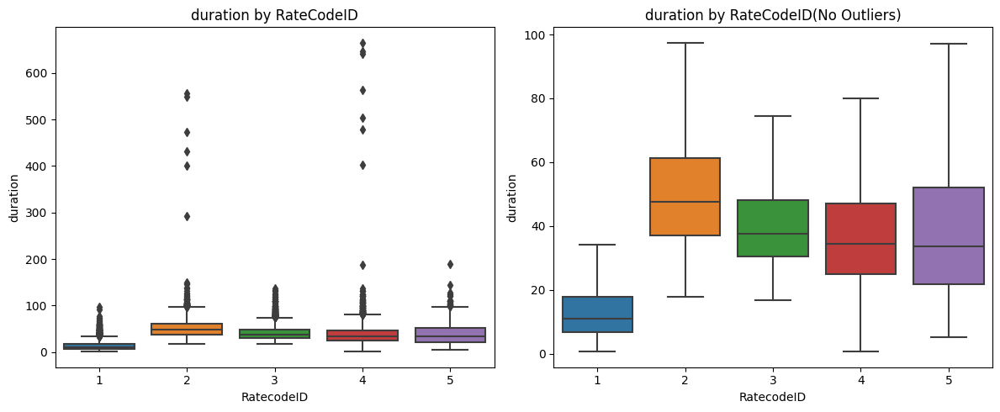

In [199]:
###############################################################
#box plot of duration by RateCodeID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_clean
sns.boxplot(data=target_data, y="duration",x="RatecodeID",ax=axs[0])
axs[0].set_title("duration by RateCodeID")

#no outliers
sns.boxplot(data=target_data, y="duration",x="RatecodeID",ax=axs[1],showfliers=False)
axs[1].set_title("duration by RateCodeID(No Outliers)")

plt.tight_layout()
plt.show()

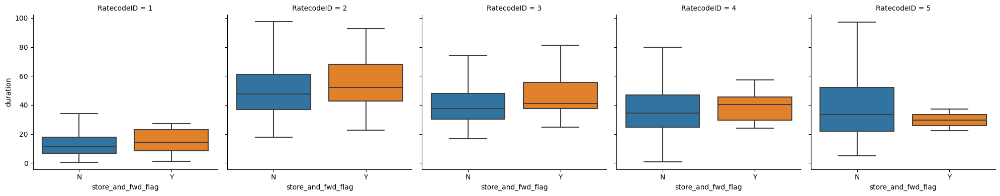

In [200]:
###############################################################
#box plot of duration by Store_and_fwd_flag
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="store_and_fwd_flag", y="duration", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

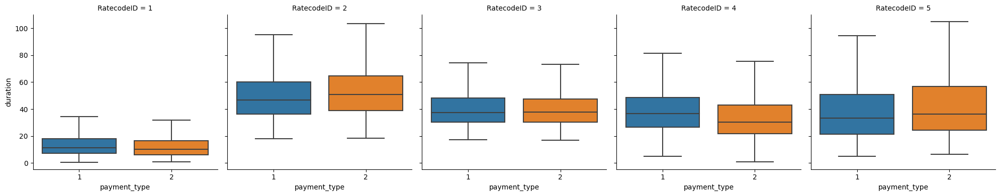

In [201]:
###############################################################
#box plot of duration by Payment_type
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="payment_type", y="duration", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

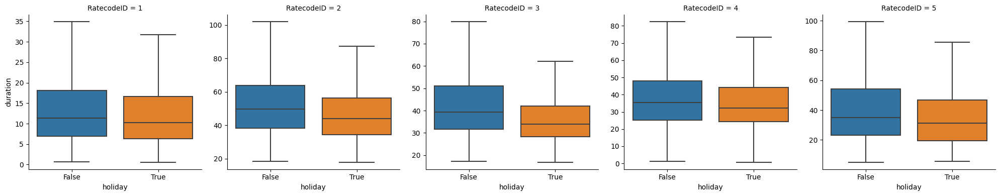

In [202]:
###############################################################
#box plot of duration by holiday
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="holiday", y="duration", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False,sharey=False
)
plt.show()

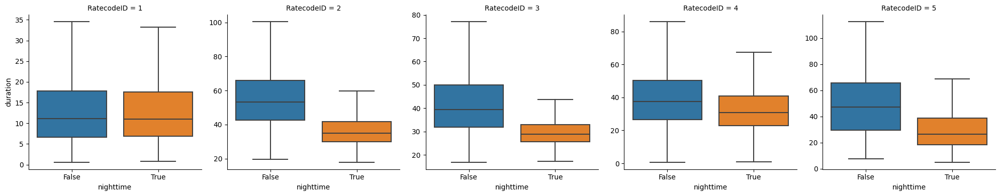

In [203]:
###############################################################
#box plot of duration by nighttime
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="nighttime", y="duration", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False,sharey=False
)
plt.show()

##### avg_speed

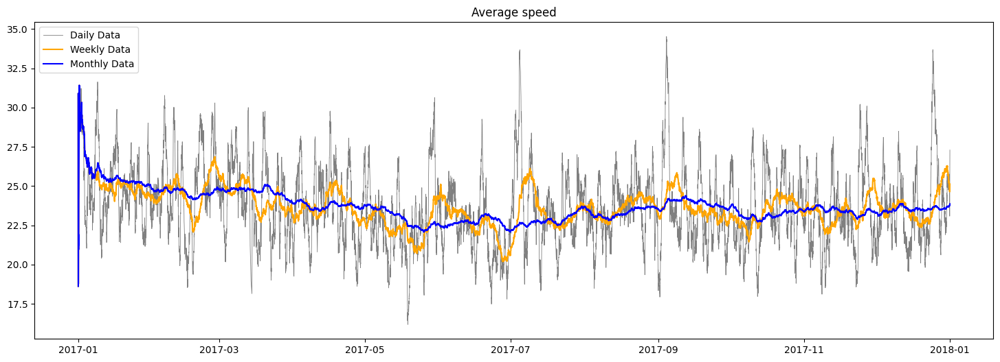

In [204]:
# Compute the centered 1 day rolling mean
plt.figure(figsize=(18, 6))
tmp_data=df_clean.sort_values(['tpep_pickup_datetime'])
daily_data = tmp_data[['tpep_pickup_datetime','avg_speed']].rolling('1d', on='tpep_pickup_datetime').mean()
plt.plot(daily_data['tpep_pickup_datetime']
         ,daily_data["avg_speed"]
         ,linewidth=0.6
         ,label="Daily Data"
         ,color="grey",
        )

# Compute the centered 1 week rolling mean
weekly_data = tmp_data[['tpep_pickup_datetime','avg_speed']].rolling('7d', on='tpep_pickup_datetime').mean()
plt.plot(weekly_data['tpep_pickup_datetime']
         ,weekly_data["avg_speed"]
         ,label="Weekly Data"
         ,color="orange"
        )

# Compute the centered 1 month rolling mean
monthly_data = tmp_data[['tpep_pickup_datetime','avg_speed']].rolling('30d', on='tpep_pickup_datetime').mean()
plt.plot(monthly_data['tpep_pickup_datetime']
         ,monthly_data["avg_speed"]
         ,label="Monthly Data"
         ,color="blue",
        )

plt.title("Average speed")
plt.legend()
plt.show()

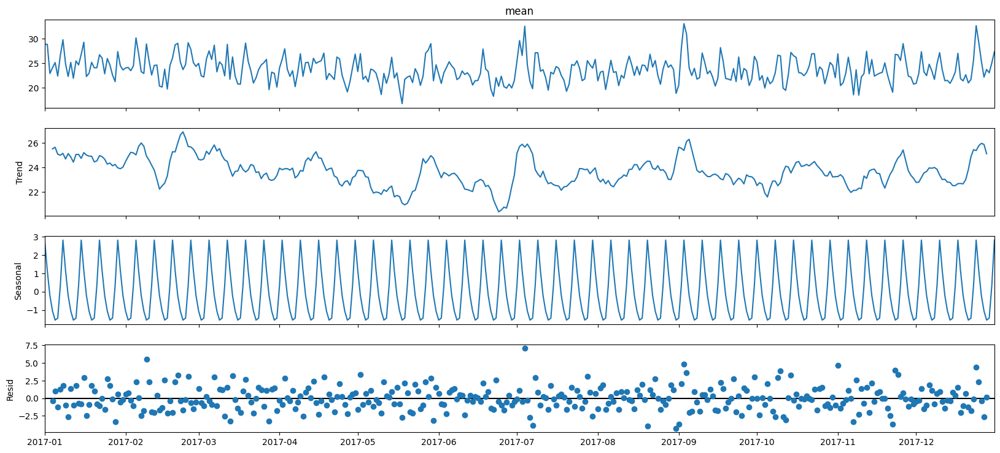

In [205]:
from statsmodels.tsa.seasonal import seasonal_decompose
df_clean['PU_date']=df_clean['tpep_pickup_datetime'].dt.date

tmp_data=df_clean.groupby(['PU_date'])['avg_speed'].agg(['mean']).reset_index()
tmp_data=tmp_data.sort_values(['PU_date'])
tmp_data['PU_date']=pd.to_datetime(tmp_data['PU_date'])

tmp_data['dateindex']=tmp_data['PU_date']
tmp_data = tmp_data.set_index("dateindex") # set datetimeindex
result = seasonal_decompose(tmp_data['mean'], model='additive')
fig=result.plot()
fig.set_size_inches((18, 8))
plt.show()

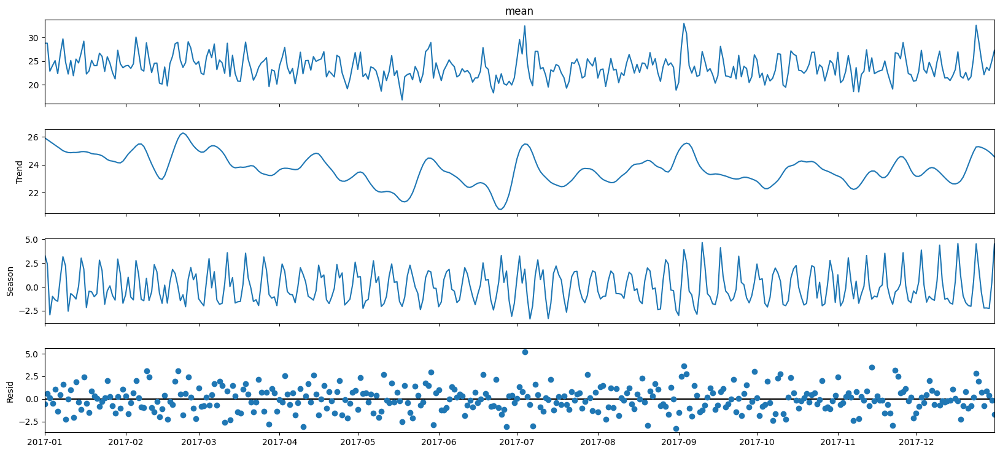

In [206]:
#from statsmodels.tsa.seasonal import seasonal_decompose, STL , MSTL
from statsmodels.tsa.seasonal import seasonal_decompose, STL 

#df_clean['PU_date']=df_clean['tpep_pickup_datetime'].dt.date

#tmp_data=df_clean.groupby(['PU_date'])['avg_speed'].agg(['mean']).reset_index()
#tmp_data=tmp_data.sort_values(['PU_date'])
#tmp_data['PU_date']=pd.to_datetime(tmp_data['PU_date'])

#tmp_data['dateindex']=tmp_data['PU_date']
#tmp_data = tmp_data.set_index("dateindex") # set datetimeindex
#result = seasonal_decompose(tmp_data['mean'], model='additive')
stl = STL(tmp_data['mean'])
result_stl = stl.fit()
fig=result_stl.plot()
fig.set_size_inches((18, 8))
plt.show()

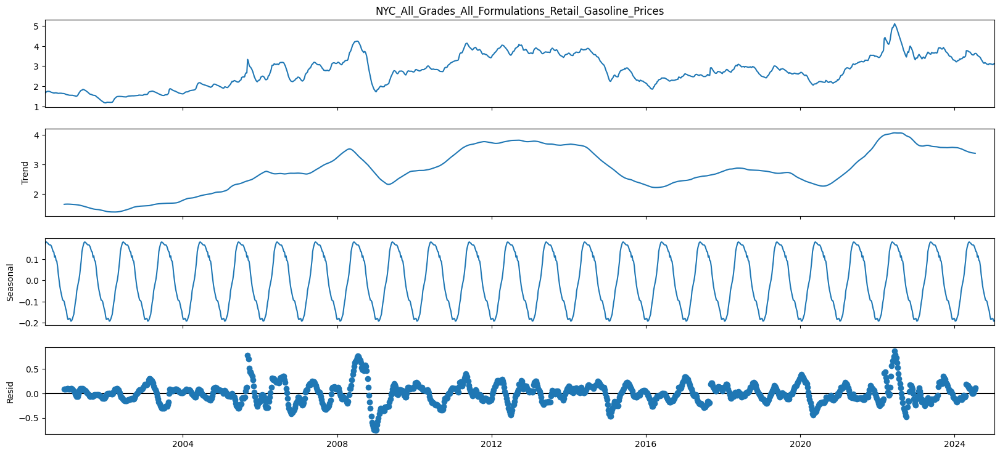

In [207]:
from statsmodels.tsa.seasonal import seasonal_decompose

df_gasoline['dateindex']=df_gasoline['Date']
df_gasoline = df_gasoline.set_index("dateindex")  # set datetimeindex
result = seasonal_decompose(df_gasoline['NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices'], model='additive')
fig=result.plot()
fig.set_size_inches((18, 8))
plt.show()

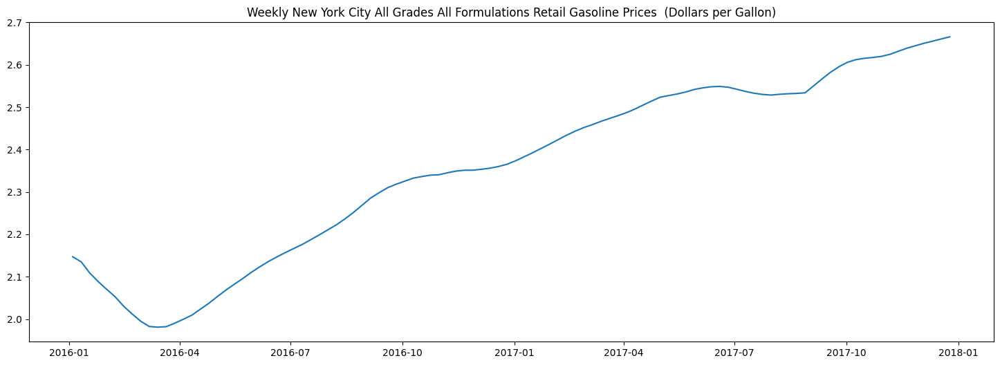

In [208]:
plt.figure(figsize=(18, 6))
mask=df_gasoline['Year'].isin([2016,2017])
tmp_data=df_gasoline[mask]

monthly_data = tmp_data[['Date','NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices']].rolling('180d', on='Date').mean()

plt.plot(monthly_data["NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices"])
plt.title("Weekly New York City All Grades All Formulations Retail Gasoline Prices  (Dollars per Gallon)")
plt.show()

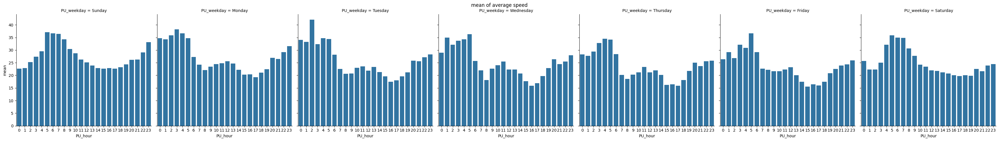

In [209]:
###############################################################
#plot by pickup hour and weekday
###############################################################
target_data=df_clean.groupby(['PU_weekday','PU_hour'])['avg_speed'].agg(['sum','mean','count']).reset_index()


#plot of mean of avg_speed
g1 = sns.FacetGrid(target_data, col="PU_weekday", height=5, aspect=1)
g1.map_dataframe(sns.barplot, x="PU_hour", y="mean")
g1.fig.subplots_adjust(top=0.9)
g1.fig.suptitle("mean of average speed")


plt.show(g1)


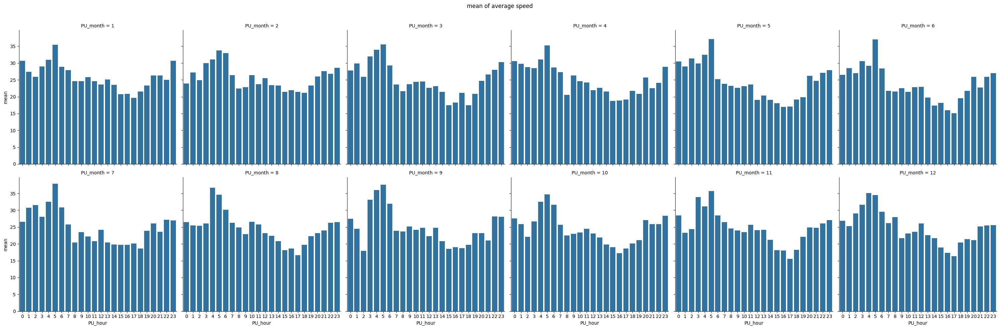

In [210]:
###############################################################
#plot by pickup hour and pickup month
###############################################################
target_data=df_clean.groupby(['PU_month','PU_hour'])['avg_speed'].agg(['sum','mean','count']).reset_index()


#plot of mean of avg_speed
g1 = sns.FacetGrid(target_data, col="PU_month", height=5, aspect=1,col_wrap=6)
g1.map_dataframe(sns.barplot, x="PU_hour", y="mean")
g1.fig.subplots_adjust(top=0.9)
g1.fig.suptitle("mean of average speed")


plt.show(g1)

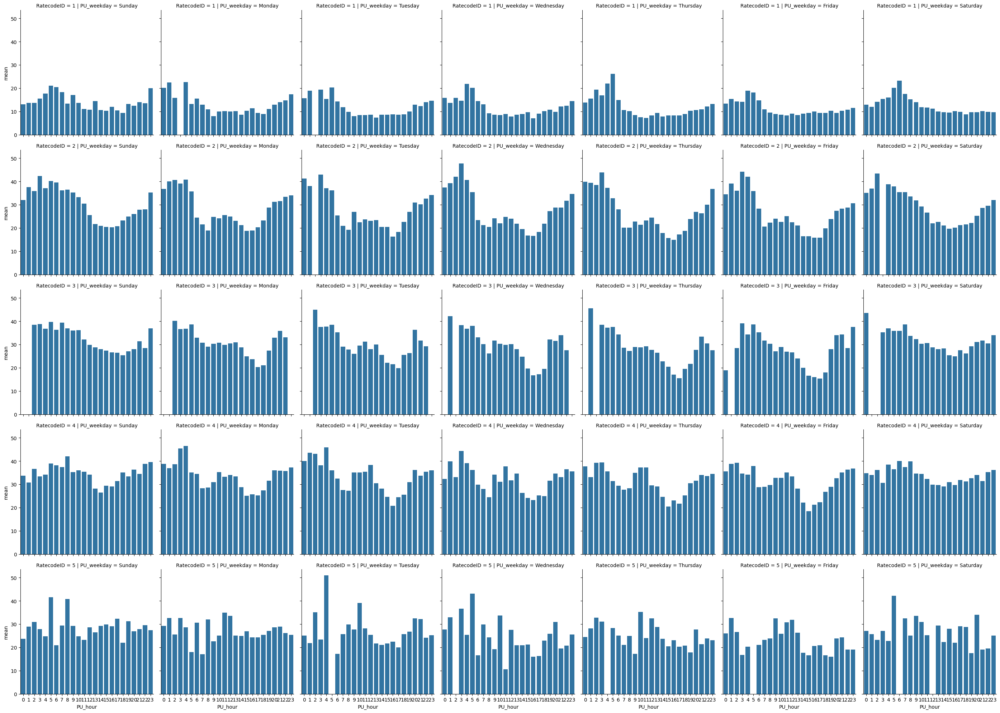

In [211]:
###############################################################
#plot by pickup hour,weekday and RatecodeID
###############################################################
target_data=df_clean.groupby(['PU_weekday','PU_hour','RatecodeID'])['avg_speed'].agg(['sum','mean']).reset_index()
sns.catplot(
    data=target_data, x="PU_hour", y="mean", col="PU_weekday",
    row='RatecodeID',kind="bar", height=4, aspect=1,facet_kws=dict(sharex=True)
    ,color=BAR_COLOR_BLUE
)
plt.show()

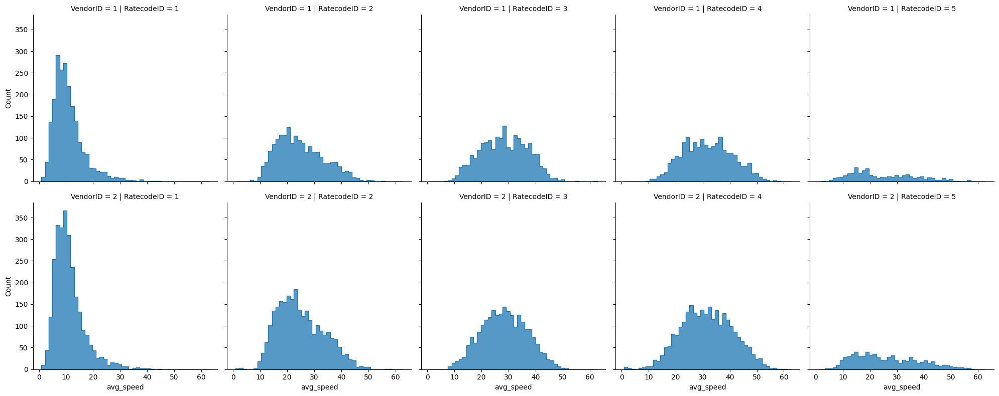

In [212]:
###############################################################
#Hist plot of average speed by VendorID
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="avg_speed", col="RatecodeID",row='VendorID'
            ,height=4, aspect=1
            ,palette="deep", element="step")
plt.show()

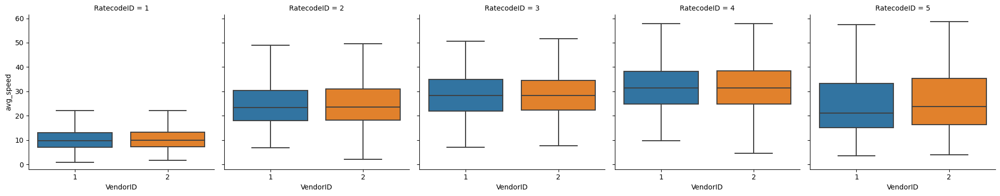

In [213]:
###############################################################
#box plot of average speed by VendorID
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="VendorID", y="avg_speed", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

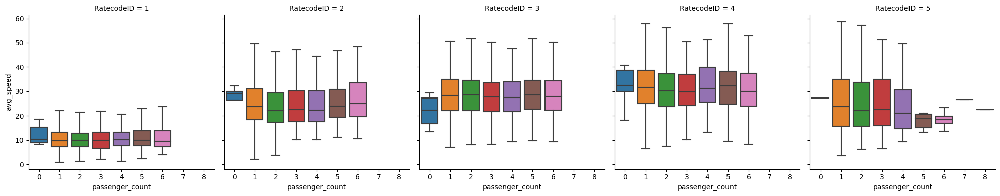

In [214]:
###############################################################
#box plot of average speed by Passenger_count
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="passenger_count", y="avg_speed", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

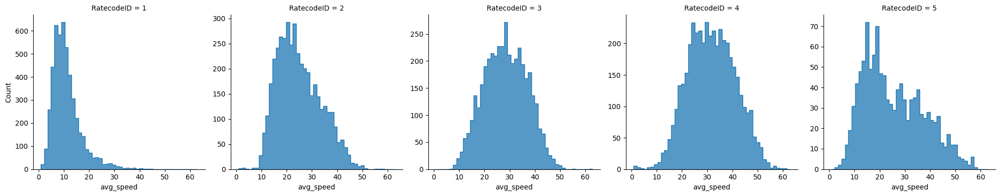

In [215]:
###############################################################
#Hist plot of average speed by RatecodeID
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="avg_speed", col="RatecodeID"
            ,height=4, aspect=1,kind='hist'
            ,palette="deep", element="step",facet_kws=dict(sharey=False))
plt.show()

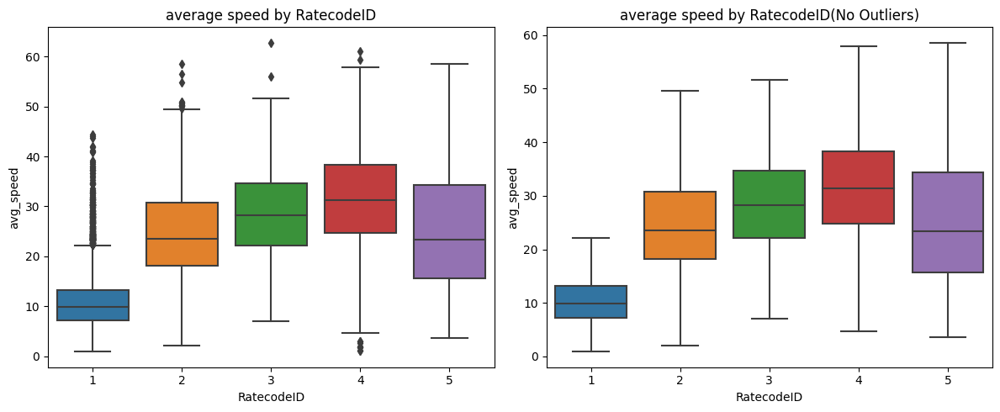

In [216]:
###############################################################
#box plot of average speed by RatecodeID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_clean
sns.boxplot(data=target_data, y="avg_speed",x="RatecodeID",ax=axs[0])
axs[0].set_title("average speed by RatecodeID")

#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="RatecodeID",ax=axs[1],showfliers=False)
axs[1].set_title("average speed by RatecodeID(No Outliers)")

plt.tight_layout()
plt.show()

In [217]:
mask=df_clean['RatecodeID']==1
sample=df_clean[mask]
sample['avg_speed_zscore']=sample[['avg_speed']].apply(stats.zscore)

mask_zscore=(sample['avg_speed_zscore']>3)|(sample['avg_speed_zscore']<-3)
display(sample[mask_zscore].sort_values(['avg_speed'])[['VendorID', 'tpep_pickup_datetime', 'tpep_dropoff_datetime','holiday','trip_distance','PU_weekday', 'duration','avg_speed']])
#sample[['avg_speed']].apply(stats.zscore)
#sample[mask_zscore][['rush_hour']].value_counts()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,holiday,trip_distance,PU_weekday,duration,avg_speed
20832,2,2017-11-26 09:54:06,2017-11-26 10:16:34,True,10.45,Sunday,22.467,27.908012
4177,2,2017-03-08 23:39:13,2017-03-08 23:58:25,False,8.95,Wednesday,19.200,27.968750
401,2,2017-01-29 06:12:46,2017-01-29 06:38:10,True,11.85,Sunday,25.400,27.992126
381,2,2017-01-07 06:50:47,2017-01-07 06:51:28,True,0.32,Saturday,0.683,28.097561
10840,1,2017-06-05 08:41:40,2017-06-05 08:54:03,False,5.80,Monday,12.383,28.102288
...,...,...,...,...,...,...,...,...
317,1,2017-01-29 23:06:20,2017-01-29 23:37:24,True,21.70,Sunday,31.067,41.909871
13243,2,2017-07-02 19:47:33,2017-07-02 20:03:06,True,10.91,Sunday,15.550,42.096463
21034,1,2017-11-27 01:56:47,2017-11-27 02:28:37,False,23.20,Monday,31.833,43.727749
16675,2,2017-09-03 05:55:15,2017-09-03 06:10:55,True,11.51,Sunday,15.667,44.080851


In [218]:
###############################################################
#Calculate 95% CI of average speed
###############################################################
ci_list=[]
mean_list=[]
count_list=[]
stderr_list=[]
ratecodeid_list=df_clean['RatecodeID'].unique().tolist()
ratecodeid_list.sort()
for ratecode in ratecodeid_list:
    mask=df_clean['RatecodeID']==ratecode
    sample=df_clean[mask]
    sample_mean=np.mean(sample['avg_speed'])
    sample_stderr=stats.sem(sample['avg_speed'])

    #in some version this works
    #sample_ci=stats.norm.interval(alpha=0.95, 
    #             loc=sample_mean, 
    #             scale=sample_stderr) 
    #in some version this works
    sample_ci=stats.norm.interval(confidence=0.95, 
                 loc=sample_mean, 
                 scale=sample_stderr)
    ci_list.append(sample_ci)
    stderr_list.append(sample_stderr)
    mean_list.append(sample_mean)
    count=sample.shape[0]
    count_list.append(count)

    
#all ratecodeid
all_mean=np.mean(df_clean['avg_speed'])
all_stderr=stats.sem(df_clean['avg_speed'])

#in some version this works
#ci_all=stats.norm.interval(alpha=0.95, 
#                 loc=all_mean, 
#                 scale=all_stderr) 

#in some version this works
ci_all=stats.norm.interval(confidence=0.95, 
                 loc=all_mean, 
                 scale=all_stderr) 

ci_list.append(ci_all)
ratecodeid_list.append('All')
count_list.append(df_clean.shape[0])
mean_list.append(all_mean)
stderr_list.append(all_stderr)

df_avg_speed_ci=pd.DataFrame({
    "RatecodeID": ratecodeid_list,
    "Mean": mean_list,
    "standard error": stderr_list,
    "95% CI": ci_list,
    "Count": count_list
})
df_avg_speed_ci.head(7)

,RatecodeID,Mean,standard error,95% CI,Count
0,1,10.981246,0.080778,"(10.822923578482037, 11.139569389209829)",4865
1,2,24.799607,0.130158,"(24.544502417944525, 25.05471120879837)",4293
2,3,28.383898,0.131309,"(28.126537063059807, 28.64125797322866)",4108
3,4,31.650162,0.140948,"(31.373909214249704, 31.926415068778642)",4345
4,5,25.503929,0.351219,"(24.815552938170825, 26.19230519464177)",1137
5,All,23.629584,0.083530,"(23.46586836953831, 23.793300507316136)",18748


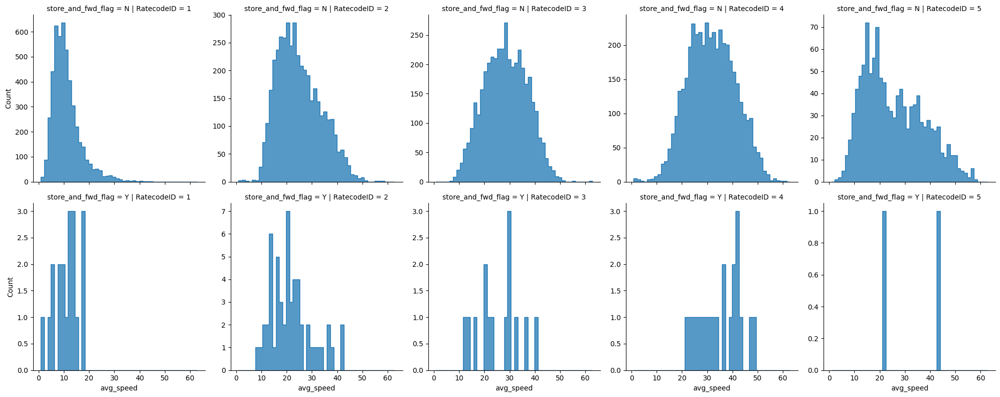

In [219]:
###############################################################
#Hist plot of average speed by store_and_fwd_flag
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="avg_speed", col="RatecodeID",row="store_and_fwd_flag"
            ,height=4, aspect=1,kind='hist'
            ,palette="deep", element="step",facet_kws=dict(sharey=False))
plt.show()

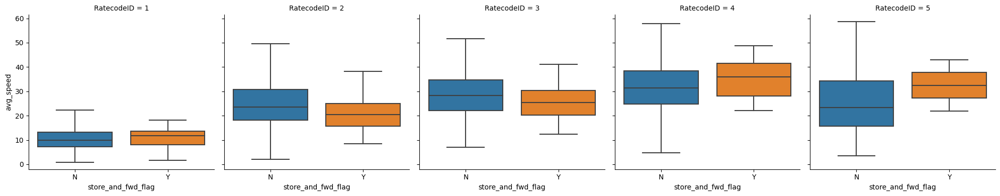

In [220]:
###############################################################
#box plot of average speed by Store_and_fwd_flag
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="store_and_fwd_flag", y="avg_speed", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

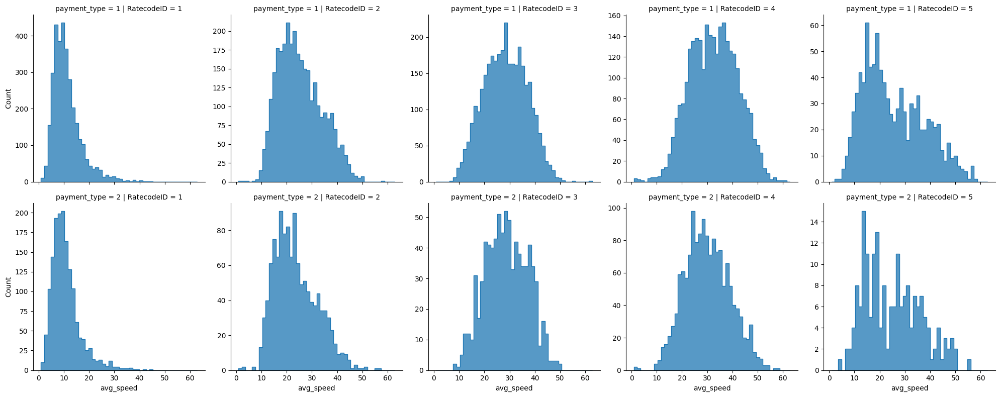

In [221]:
###############################################################
#Hist plot of average speed by payment_type
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="avg_speed", col="RatecodeID",row="payment_type"
            ,height=4, aspect=1,kind='hist'
            ,palette="deep", element="step",facet_kws=dict(sharey=False))
plt.show()

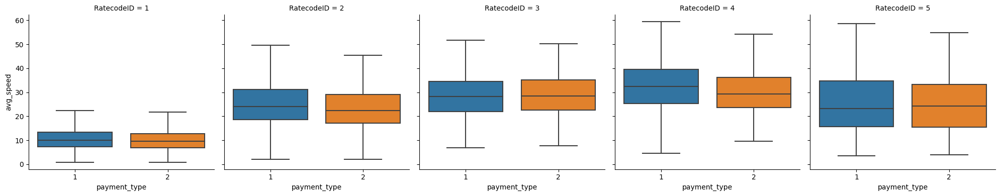

In [222]:
###############################################################
#box plot of average speed by Payment_type
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="payment_type", y="avg_speed", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

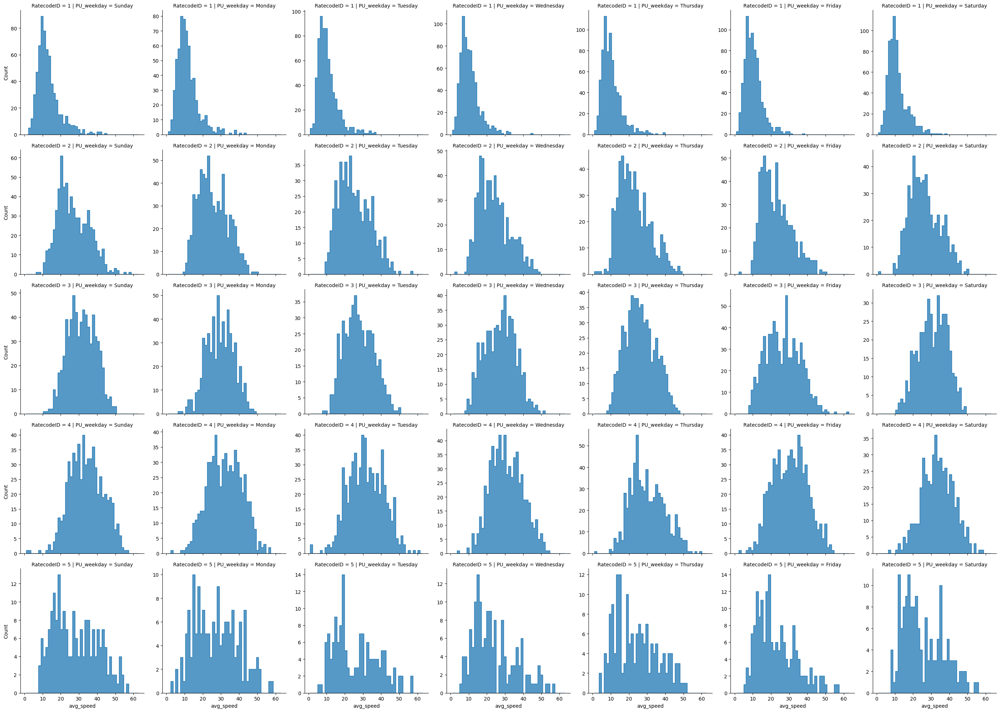

In [223]:
###############################################################
#Hist plot of average speed by pickup weekday
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="avg_speed", col="PU_weekday",row="RatecodeID"
            ,height=4, aspect=1,kind='hist'
            ,palette="deep", element="step",facet_kws=dict(sharey=False))
plt.show()

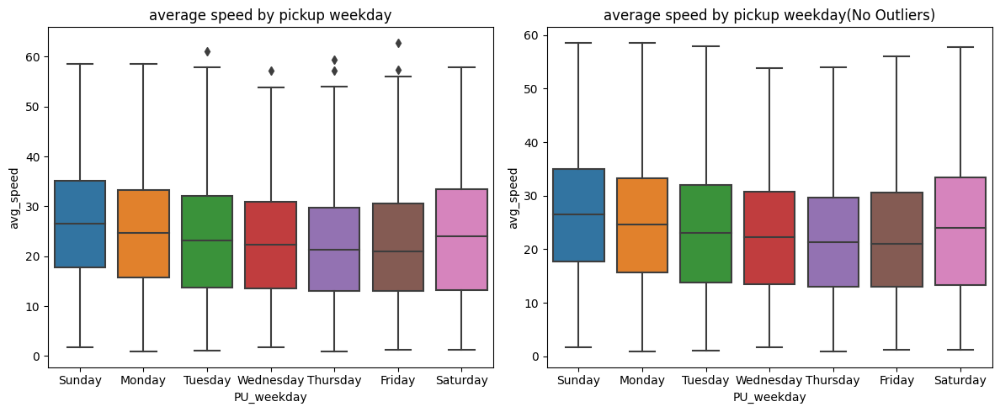

In [224]:
###############################################################
#box plot of average speed by pickup weekday
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_clean
sns.boxplot(data=target_data, y="avg_speed",x="PU_weekday",ax=axs[0])
axs[0].set_title("average speed by pickup weekday")

#no outliers
sns.boxplot(data=target_data, y="avg_speed",x="PU_weekday",ax=axs[1],showfliers=False)
axs[1].set_title("average speed by pickup weekday(No Outliers)")

plt.tight_layout()
plt.show()

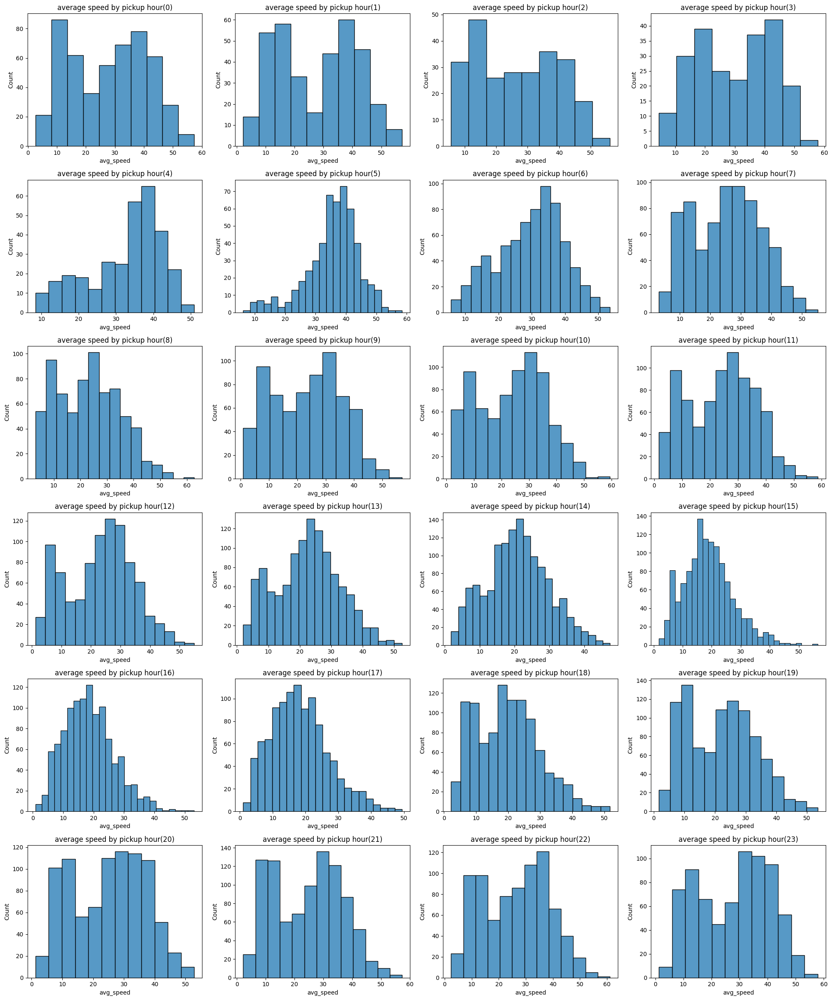

In [225]:
###############################################################
#Hist plot of average speed by pickup hour
###############################################################
fig,axs=plt.subplots(6,4,figsize=(20,24))
target_data=df_clean
item_list=list(target_data['PU_hour'].unique())
item_list.sort(reverse=False)
for ax,item in zip(axs.ravel(),item_list):
    mask=target_data['PU_hour']==item
    sns.histplot(data=target_data[mask], x="avg_speed",ax=ax)
    ax.set_title(f'average speed by pickup hour({item})')
plt.tight_layout()
plt.show()

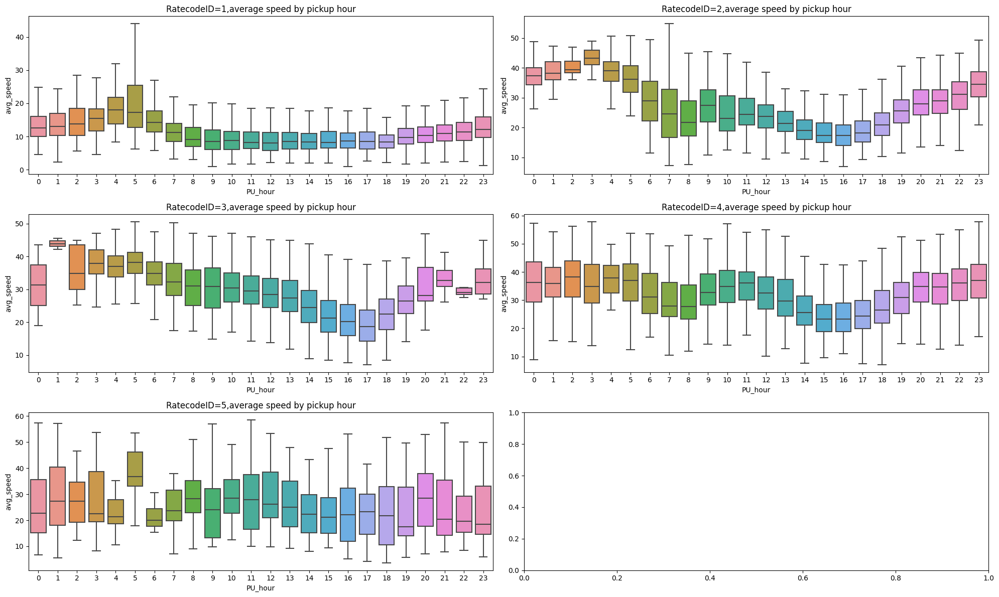

In [226]:
###################################################################################
#Box plot of Average Speed by pickup hour while keep RatecodeID constant
###################################################################################
fig,axs=plt.subplots(3,2,figsize=(20,12))
target_data=df_clean
item_list=list(target_data['RatecodeID'].unique())
for ratecode,ax in zip(item_list,axs.ravel()):
    mask=target_data['RatecodeID']==ratecode
    sns.boxplot(data=target_data[mask], y="avg_speed",x="PU_hour",ax=ax,showfliers=False)
    ax.set_title(f'RatecodeID={ratecode},average speed by pickup hour')
plt.tight_layout()
plt.show()

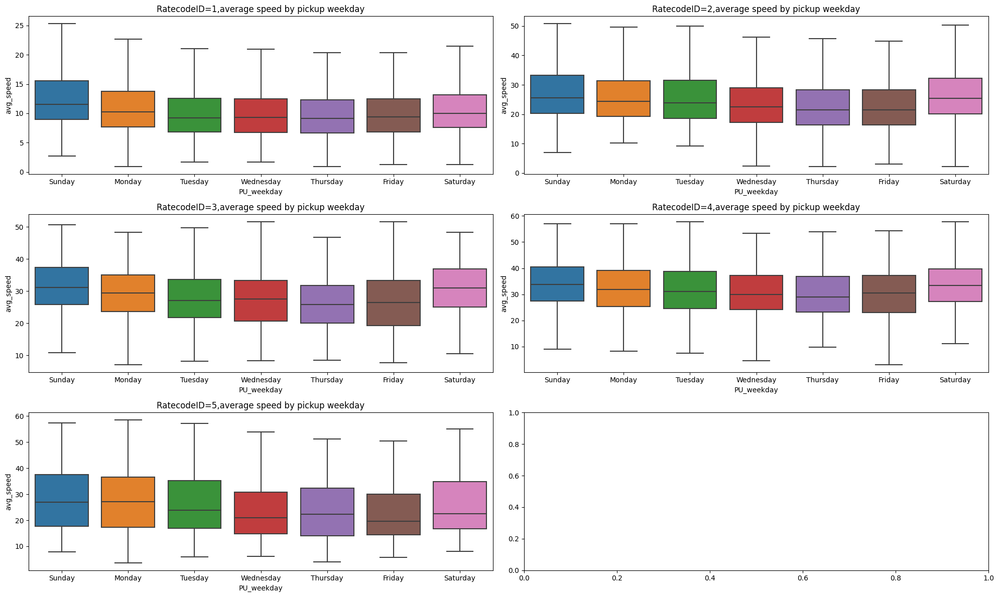

In [227]:
###################################################################################
#Box plot of Average Speed by pickup weekday while keep RatecodeID constant
###################################################################################
fig,axs=plt.subplots(3,2,figsize=(20,12))
target_data=df_clean
item_list=list(target_data['RatecodeID'].unique())
for ratecode,ax in zip(item_list,axs.ravel()):
    mask=target_data['RatecodeID']==ratecode
    sns.boxplot(data=target_data[mask], y="avg_speed",x="PU_weekday",ax=ax,showfliers=False)
    ax.set_title(f'RatecodeID={ratecode},average speed by pickup weekday')
plt.tight_layout()
plt.show()

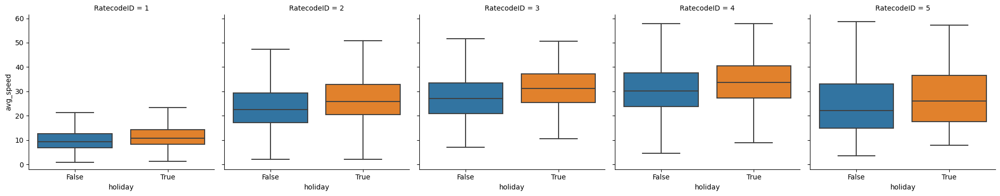

In [228]:
###############################################################
#box plot of average speed by holiday
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="holiday", y="avg_speed", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

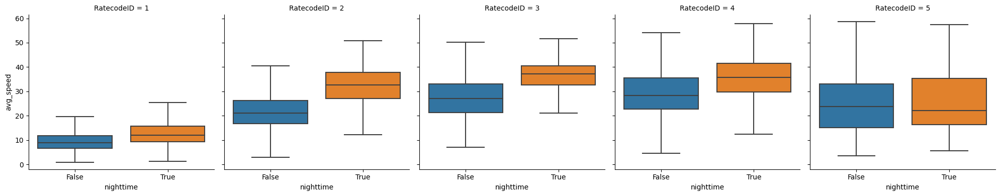

In [229]:
###############################################################
#box plot of average speed by nighttime
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="nighttime", y="avg_speed", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

#### fare_per_minute

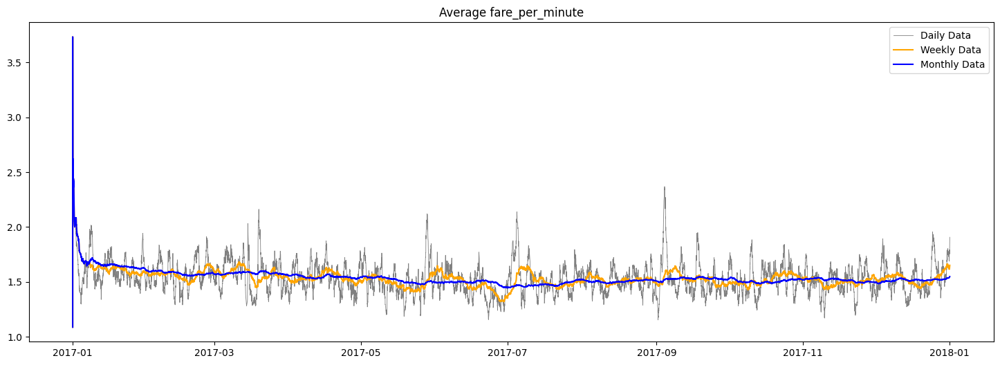

In [230]:
# Compute the centered 1 day rolling mean
plt.figure(figsize=(18, 6))
tmp_data=df_clean.sort_values(['tpep_pickup_datetime'])
daily_data = tmp_data[['tpep_pickup_datetime','fare_per_minute']].rolling('1d', on='tpep_pickup_datetime').mean()
plt.plot(daily_data['tpep_pickup_datetime']
         ,daily_data["fare_per_minute"]
         ,linewidth=0.6
         ,label="Daily Data"
         ,color="grey",
        )

# Compute the centered 1 week rolling mean
weekly_data = tmp_data[['tpep_pickup_datetime','fare_per_minute']].rolling('7d', on='tpep_pickup_datetime').mean()
plt.plot(weekly_data['tpep_pickup_datetime']
         ,weekly_data["fare_per_minute"]
         ,label="Weekly Data"
         ,color="orange",
        )

# Compute the centered 1 month rolling mean
monthly_data = tmp_data[['tpep_pickup_datetime','fare_per_minute']].rolling('30d', on='tpep_pickup_datetime').mean()
plt.plot(monthly_data['tpep_pickup_datetime']
         ,monthly_data["fare_per_minute"]
         ,label="Monthly Data"
         ,color="blue",
        )

plt.title("Average fare_per_minute")
plt.legend()
plt.show()

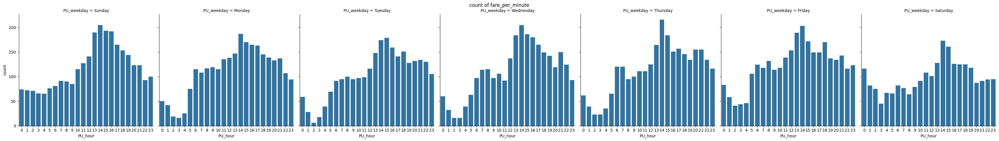

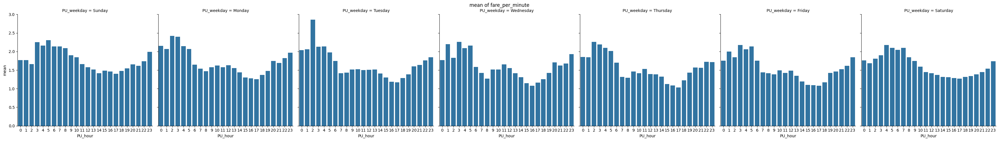

In [231]:
###############################################################
#plot by pickup hour and weekday
###############################################################
target_data=df_clean.groupby(['PU_weekday','PU_hour'])['fare_per_minute'].agg(['mean','count']).reset_index()

#plot of count of avg_speed
g0 = sns.FacetGrid(target_data, col="PU_weekday", height=5, aspect=1)
g0.map_dataframe(sns.barplot, x="PU_hour", y="count")
g0.fig.subplots_adjust(top=0.9)
g0.fig.suptitle("count of fare_per_minute")

#plot of mean of avg_speed
g1 = sns.FacetGrid(target_data, col="PU_weekday", height=5, aspect=1)
g1.map_dataframe(sns.barplot, x="PU_hour", y="mean")
g1.fig.subplots_adjust(top=0.9)
g1.fig.suptitle("mean of fare_per_minute")



plt.show(g0)
plt.show(g1)


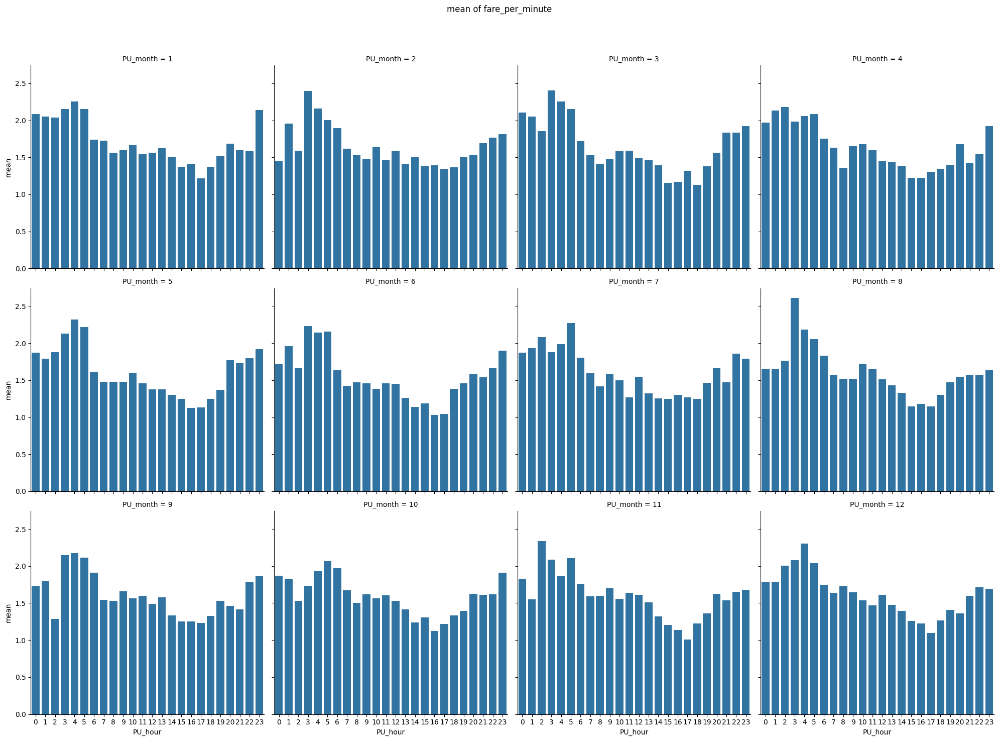

In [232]:
###############################################################
#plot by pickup hour and weekday
###############################################################
target_data=df_clean.groupby(['PU_month','PU_hour'])['fare_per_minute'].agg(['mean','count']).reset_index()



#plot of mean of avg_speed
g1 = sns.FacetGrid(target_data, col="PU_month", height=5, aspect=1,col_wrap=4)
g1.map_dataframe(sns.barplot, x="PU_hour", y="mean")
g1.fig.subplots_adjust(top=0.9)
g1.fig.suptitle("mean of fare_per_minute")


plt.show(g1)

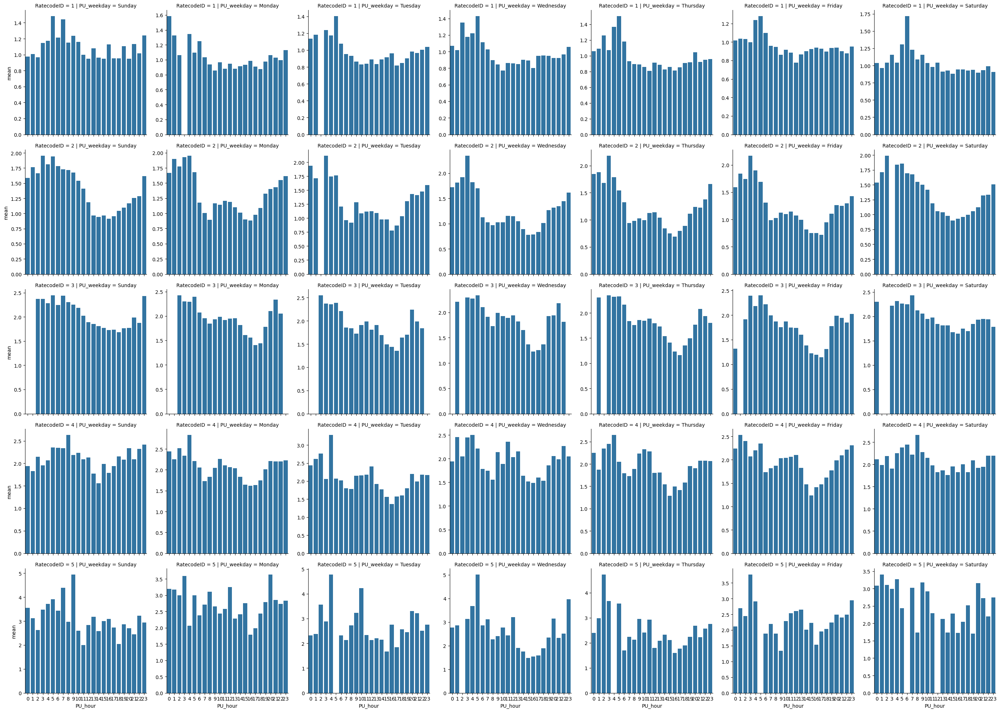

In [233]:
###############################################################
#plot by pickup hour,weekday and RatecodeID
###############################################################
target_data=df_clean.groupby(['PU_weekday','PU_hour','RatecodeID'])['fare_per_minute'].agg(['sum','mean']).reset_index()
sns.catplot(
    data=target_data, x="PU_hour", y="mean", col="PU_weekday",
    row='RatecodeID',kind="bar", height=4, aspect=1,sharey=False
    #,facet_kws=dict(sharex=True,sharey=False)
    ,color=BAR_COLOR_BLUE
)
plt.show()

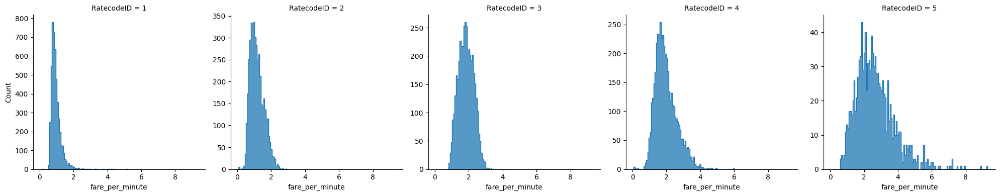

In [234]:
###############################################################
#Hist plot of fare_per_minute by RatecodeID
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="fare_per_minute", col="RatecodeID"
            ,height=4, aspect=1,kind='hist'
            ,palette="deep", element="step"
            ,facet_kws=dict(sharey=False,sharex=False)
           )
plt.show()

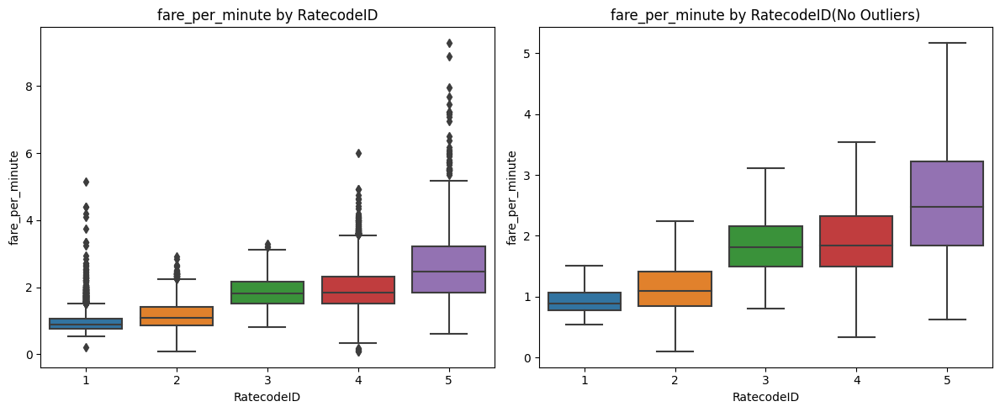

In [235]:
###############################################################
#box plot of fare_per_minute by RatecodeID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_clean
sns.boxplot(data=target_data, y="fare_per_minute",x="RatecodeID",ax=axs[0])
axs[0].set_title("fare_per_minute by RatecodeID")

#no outliers
sns.boxplot(data=target_data, y="fare_per_minute",x="RatecodeID",ax=axs[1],showfliers=False)
axs[1].set_title("fare_per_minute by RatecodeID(No Outliers)")

plt.tight_layout()
plt.show()

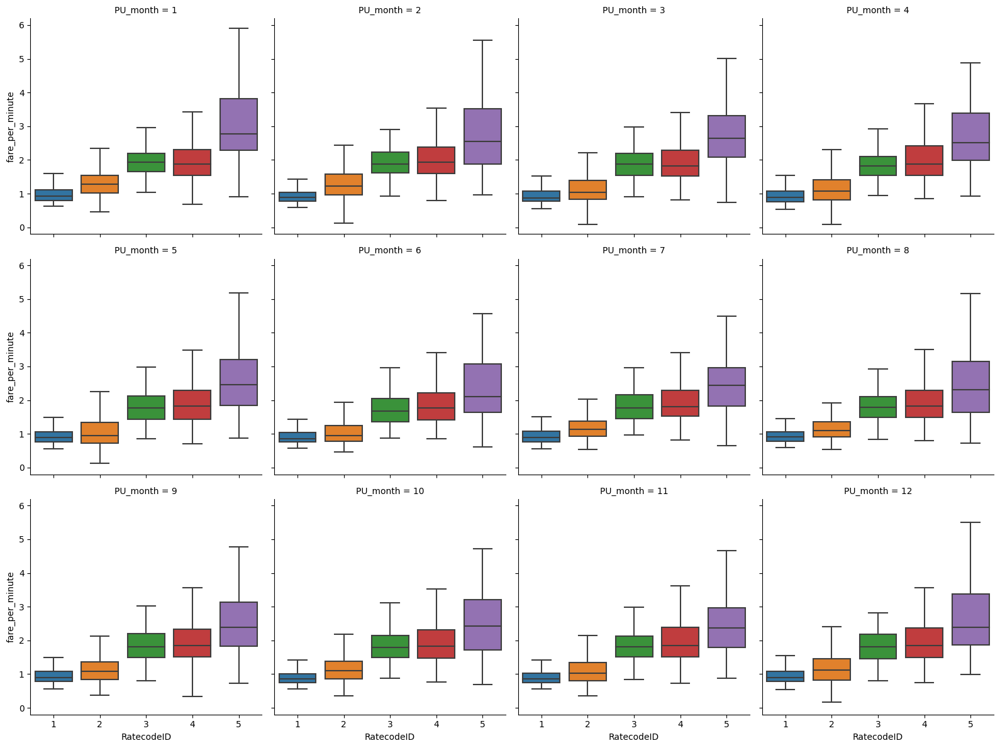

In [236]:
###############################################################
#box plot of fare_per_minute by month
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="RatecodeID", y="fare_per_minute", col="PU_month",
    kind="box", height=4, aspect=1,showfliers=False,col_wrap=4
)
plt.show()

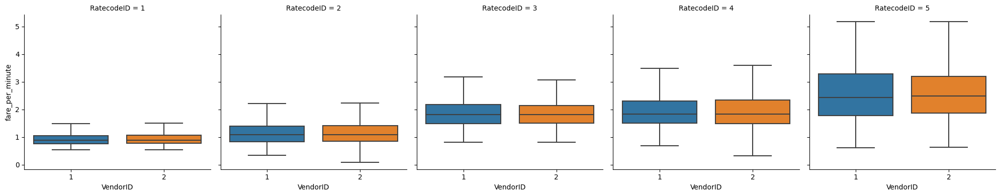

In [237]:
###############################################################
#box plot of average fare_per_minute by VendorID
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="VendorID", y="fare_per_minute", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

#### fare_per_mile

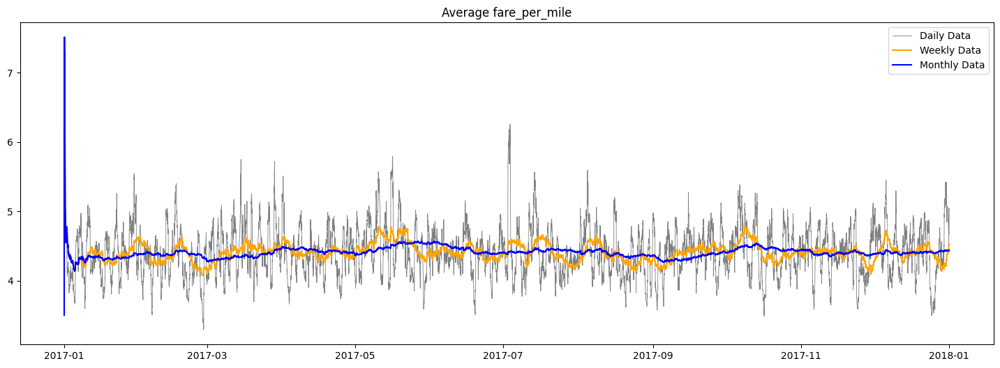

In [238]:
# Compute the centered 1 day rolling mean
plt.figure(figsize=(18, 6))
tmp_data=df_clean.sort_values(['tpep_pickup_datetime'])
daily_data = tmp_data[['tpep_pickup_datetime','fare_per_mile']].rolling('1d', on='tpep_pickup_datetime').mean()
plt.plot(daily_data['tpep_pickup_datetime']
         ,daily_data["fare_per_mile"]
         ,linewidth=0.6
         ,label="Daily Data"
         ,color="grey",
        )

# Compute the centered 1 week rolling mean
weekly_data = tmp_data[['tpep_pickup_datetime','fare_per_mile']].rolling('7d', on='tpep_pickup_datetime').mean()
plt.plot(weekly_data['tpep_pickup_datetime']
         ,weekly_data["fare_per_mile"]
         ,label="Weekly Data"
         ,color="orange",
        )

# Compute the centered 1 month rolling mean
monthly_data = tmp_data[['tpep_pickup_datetime','fare_per_mile']].rolling('30d', on='tpep_pickup_datetime').mean()
plt.plot(monthly_data['tpep_pickup_datetime']
         ,monthly_data["fare_per_mile"]
         ,label="Monthly Data"
         ,color="blue",
        )

plt.title("Average fare_per_mile")
plt.legend()
plt.show()

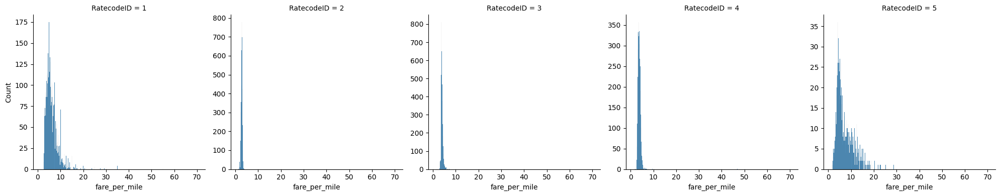

In [239]:
###############################################################
#Hist plot of average speed by RatecodeID
###############################################################
target_data=df_clean
sns.displot(data=target_data, x="fare_per_mile", col="RatecodeID"
            ,height=4, aspect=1,kind='hist'
            ,palette="tab10"
            ,facet_kws=dict(sharex=False,sharey=False)
           )
plt.show()

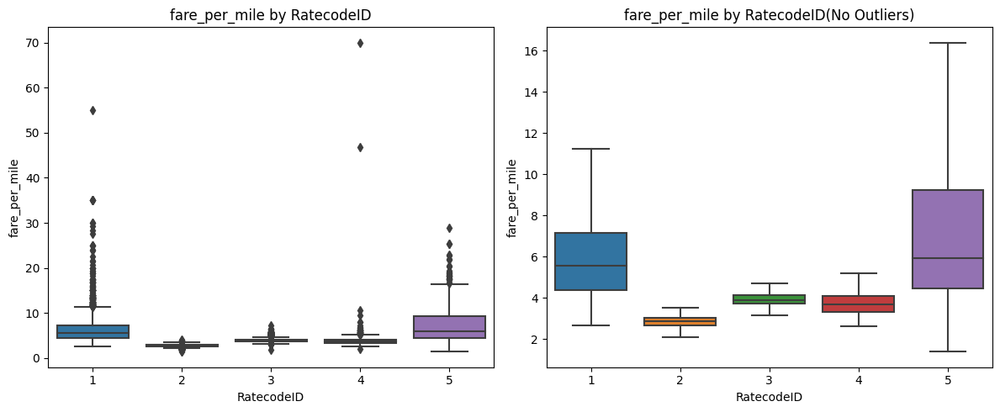

In [240]:
###############################################################
#box plot of fare_per_mile by RatecodeID
###############################################################
fig,axs=plt.subplots(1,2,figsize=(12,5))
target_data=df_clean
sns.boxplot(data=target_data, y="fare_per_mile",x="RatecodeID",ax=axs[0])
axs[0].set_title("fare_per_mile by RatecodeID")

#no outliers
sns.boxplot(data=target_data, y="fare_per_mile",x="RatecodeID",ax=axs[1],showfliers=False)
axs[1].set_title("fare_per_mile by RatecodeID(No Outliers)")

plt.tight_layout()
plt.show()

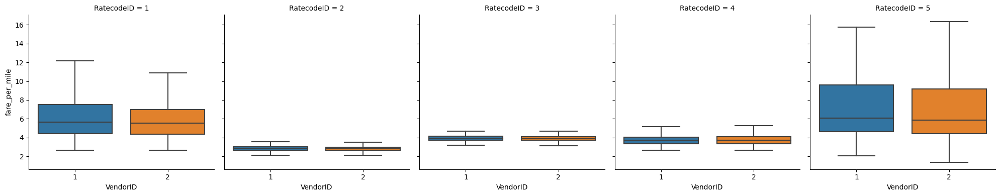

In [241]:
###############################################################
#box plot of average fare_per_mile by VendorID
###############################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="VendorID", y="fare_per_mile", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=False
)
plt.show()

### Hypothesis Test

In [242]:
df_clean['fare_amount_log']=np.log(df_clean['fare_amount'])

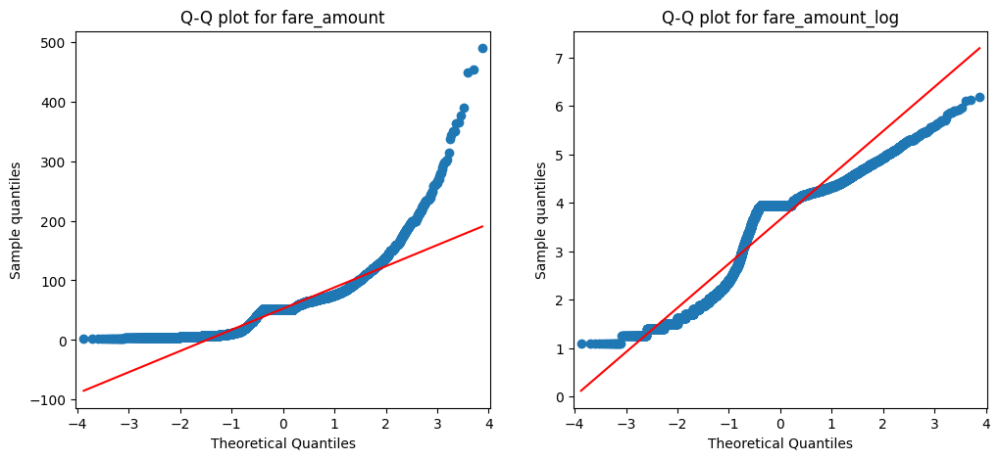

In [243]:
fig, axs = plt.subplots(1,2,figsize=(12,5))
sm.qqplot(df_clean['fare_amount'],line="s",ax=axs[0])
axs[0].set_title(f"Q-Q plot for fare_amount")
axs[0].set_ylabel("Sample quantiles")

sm.qqplot(df_clean['fare_amount_log'],line="s",ax=axs[1])
axs[1].set_title(f"Q-Q plot for fare_amount_log")
axs[1].set_ylabel("Sample quantiles")

plt.show()

In [244]:
from scipy.stats import shapiro

#𝐻_0:Sample was drawn from a normal distribution
#𝐻_A:Sample was not drawn from a normal distribution.

print('normal distribution test result of fare_amount')
statistic,pvalue = shapiro(df_clean['fare_amount'])
show_test_result(statistic, pvalue,0.01)

print('normal distribution test result of fare_amount_log')
statistic,pvalue = shapiro(df_clean['fare_amount_log'])
show_test_result(statistic, pvalue,0.01)

normal distribution test result of fare_amount
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=0.87)
normal distribution test result of fare_amount_log
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=0.86)


In [245]:
#######################################################
#Confirm VendorID
#######################################################
df_clean.groupby(['VendorID'])[['fare_amount','fare_amount_log']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'fare_amount_log':['count','min','max','std','mean','median']
})

fare_amount                                          fare_amount_log  \
               count  min    max        std       mean median           count   
VendorID                                                                        
1               7749  3.0  377.0  33.934293  51.153566   52.0            7749   
2              10999  3.0  489.5  36.600366  53.736765   52.0           10999   

                                                            
               min       max       std      mean    median  
VendorID                                                    
1         1.098612  5.932245  0.921557  3.621030  3.951244  
2         1.098612  6.193384  0.905969  3.679557  3.951244

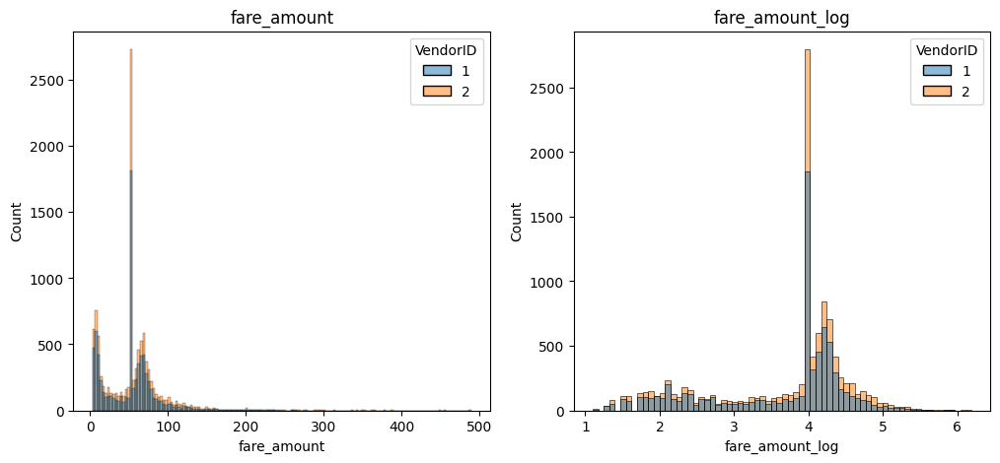

In [246]:
fig, axs = plt.subplots(1,2,figsize=(12,5))

sns.histplot(data=df_clean,x='fare_amount',hue='VendorID',palette="tab10",ax=axs[0])
axs[0].set_title(f"fare_amount")

sns.histplot(data=df_clean,x='fare_amount_log',hue='VendorID',palette="tab10",ax=axs[1])
axs[1].set_title(f"fare_amount_log")
plt.show()

U Test:
* $H_0$: mean fare_amount of Vendor 1 = mean fare_amount of Vendor 2
* $H_A$: mean fare_amount of Vendor 1 $\neq$ mean fare_amount of Vendor 2

T Test:
* $H_0$: mean log fare_amount of Vendor 1 = mean log fare_amount of Vendor 2
* $H_A$: mean log fare_amount of Vendor 1 $\neq$ mean log fare_amount of Vendor 2

significance level=0.01

In [247]:
significance_level=0.01


from scipy.stats import mannwhitneyu

# Sample data
mask1 = df_clean['VendorID']==1
mask2 = df_clean['VendorID']==2
group1=df_clean[mask1]['fare_amount']
group2=df_clean[mask2]['fare_amount']

u_statistic, p_value = mannwhitneyu(group1, group2)
show_test_result(u_statistic, p_value,significance_level)



from scipy.stats import ttest_ind
group1=df_clean[mask1]['fare_amount_log']
group2=df_clean[mask2]['fare_amount_log']
t_statistic, p_value = ttest_ind(group1, group2,equal_var=False)
show_test_result(t_statistic, p_value,significance_level)

#When use original dataset df0(NO statistical difference)
#When use dataset with equal ratecodeid count, there's a statistical difference
#=>If different Vendor has different fare_amount, using this factor will be unfair to some passengers
#The TLC rule doesn't write anything about fare rate difference amoung different vendor groups,
#will not use this feature

Reject H0 at significance level 0.01 (Pvalue=0.001, Statistic=41440151.0)
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=-4.31)


In [248]:
#######################################################
#Confirm passenger_count
#######################################################
mask=df_clean['passenger_count'].isin([1,2,3,4,5])
df_clean[mask].groupby(['passenger_count'])[['fare_amount','fare_amount_log']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'fare_amount_log':['count','min','max','std','mean','median']
})

fare_amount                                           \
                      count  min    max        std       mean median   
passenger_count                                                        
1                     12771  3.0  449.0  35.625092  52.432952   52.0   
2                      3159  3.0  454.5  35.159883  53.780047   52.0   
3                       837  3.0  489.5  38.268302  53.697312   52.0   
4                       453  3.5  350.0  37.520721  56.284768   52.0   
5                       928  3.0  351.0  33.812574  50.528610   52.0   

                fare_amount_log                                          \
                          count       min       max       std      mean   
passenger_count                                                           
1                         12771  1.098612  6.107023  0.924764  3.642000   
2                          3159  1.098612  6.119198  0.871561  3.704974   
3                           837  1.098612  6.193384  0.903036  3.681682   
4                           453  1.252763  5.857933  0.840164  3.763855   
5                           928  1.098612  5.860786  0.912399  3.614834   

                           
                   median  
passenger_count            
1                3.951244  
2                3.951244  
3                3.951244  
4                3.951244  
5                3.951244

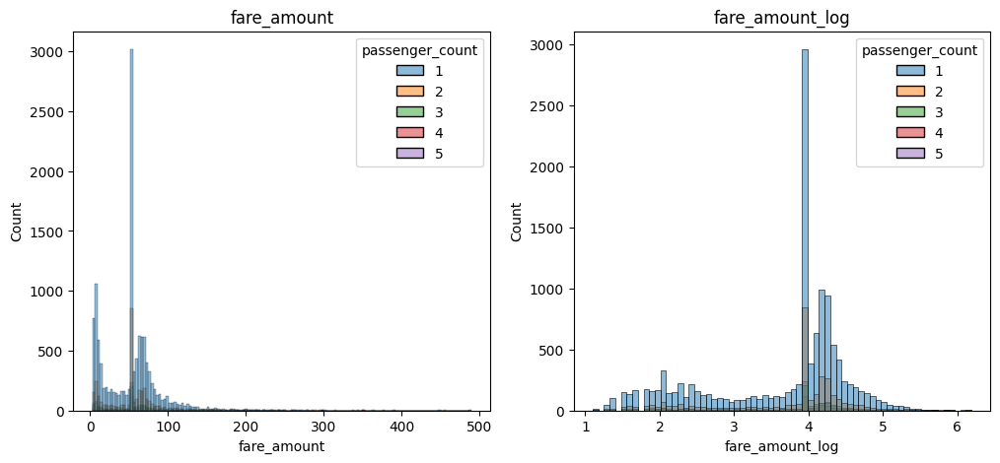

In [249]:
fig, axs = plt.subplots(1,2,figsize=(12,5))
mask=df_clean['passenger_count'].isin([1,2,3,4,5])
sns.histplot(data=df_clean[mask],x='fare_amount',hue='passenger_count',palette="tab10",ax=axs[0])
axs[0].set_title(f"fare_amount")

sns.histplot(data=df_clean[mask],x='fare_amount_log',hue='passenger_count',palette="tab10",ax=axs[1])
axs[1].set_title(f"fare_amount_log")
plt.show()

$$
H_0: fare\_amount_{passenger\_count=1}=fare\_amount_{passenger\_count=2}=fare\_amount_{passenger\_count=3}=fare\_amount_{passenger\_count=4}=fare\_amount_{passenger\_count=5}
$$
$$H_A: \text{Not } fare\_amount_{passenger\_count=1}=fare\_amount_{passenger\_count=2}=fare\_amount_{passenger\_count=3}=fare\_amount_{passenger\_count=4}=fare\_amount_{passenger\_count=5}
$$

In [250]:
#########################################################
#check normal distribution by passenger_count
#########################################################
#𝐻_0:Sample was drawn from a normal distribution
#𝐻_A:Sample was not drawn from a normal distribution.
significance_level=0.01
check_denpedent_list=[]
check_indenpedent_list=[]
statistic_list=[]
pvalue_list=[]
check_result_list=[]

mask=df_clean['passenger_count'].isin([1,2,3,4,5])
#check fare_amount by passenger_count
for item in df_clean[mask]['passenger_count'].unique():
    statistic,pvalue = shapiro(df_clean[df_clean['passenger_count'] == item]['fare_amount'])
    check_denpedent_list.append('fare_amount')
    check_indenpedent_list.append(item)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)
    
#check fare_amount_log by passenger_count
for item in df_clean[mask]['passenger_count'].unique():
    statistic,pvalue = shapiro(df_clean[df_clean['passenger_count'] == item]['fare_amount_log'])
    check_denpedent_list.append('fare_amount_log')
    check_indenpedent_list.append(item)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)

normal_check_result=pd.DataFrame({
    "denpedent": check_denpedent_list,
    "indenpedent": check_indenpedent_list,
    "statistic": statistic_list,
    "pvalue":pvalue_list,
    "check_result":check_result_list
})
normal_check_result[normal_check_result['check_result']=='Fail to reject H0']

,denpedent,indenpedent,statistic,pvalue,check_result


In [251]:
#########################################################
#check equal variance by passenger_count
#########################################################
from scipy.stats import levene
#𝐻_0:Samples came from populations with equal variances
#𝐻_A:Samples didn't come from populations with equal variances
significance_level=0.01
check_denpedent_list=[]
check_indenpedent_list=[]
statistic_list=[]
pvalue_list=[]
check_result_list=[]

mask=df_clean['passenger_count'].isin([1,2,3,4,5])
#check fare_amount by passenger_count
for item in df_clean[mask]['passenger_count'].unique():
    statistic,pvalue = levene(*[df_clean['fare_amount'][df_clean['passenger_count'] == item]
                                    for item in df_clean['passenger_count'].unique()])
    check_denpedent_list.append('fare_amount')
    check_indenpedent_list.append(item)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)
    
#check fare_amount_log by passenger_count
for item in df_clean[mask]['passenger_count'].unique():
    statistic,pvalue = levene(*[df_clean['fare_amount_log'][df_clean['passenger_count'] == item]
                                    for item in df_clean['passenger_count'].unique()])
    check_denpedent_list.append('fare_amount_log')
    check_indenpedent_list.append(item)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)

equal_variance_check_result=pd.DataFrame({
    "denpedent": check_denpedent_list,
    "indenpedent": check_indenpedent_list,
    "statistic": statistic_list,
    "pvalue":pvalue_list,
    "check_result":check_result_list
})
#equal_variance_check_result[equal_variance_check_result['check_result']=='Fail to reject H0']
equal_variance_check_result

,denpedent,indenpedent,statistic,pvalue,check_result
0,fare_amount,2,2.05,0.037,Fail to reject H0
1,fare_amount,1,2.05,0.037,Fail to reject H0
2,fare_amount,5,2.05,0.037,Fail to reject H0
3,fare_amount,3,2.05,0.037,Fail to reject H0
4,fare_amount,4,2.05,0.037,Fail to reject H0
5,fare_amount_log,2,3.85,0.000,Reject H0
6,fare_amount_log,1,3.85,0.000,Reject H0
7,fare_amount_log,5,3.85,0.000,Reject H0
8,fare_amount_log,3,3.85,0.000,Reject H0
9,fare_amount_log,4,3.85,0.000,Reject H0


In [252]:
from scipy.stats import kruskal, friedmanchisquare


mask=df_clean['passenger_count'].isin([1,2,3,4,5])

# Kruskal-Wallis test
#H0:The distributions of the fare_amount for all RatecodeIDs are identical.
#HA:At least one RatecodeID has a different distribution of fare_amount.
statistic, p_value = kruskal(*[df_clean[mask]['fare_amount'][df_clean[mask]['passenger_count'] == item]
                                               for item in df_clean[mask]['passenger_count'].unique()])
show_test_result(statistic, p_value,significance_level)


from scipy.stats import f_oneway

# not meet normal distribution assumption
# Conduct the one-way ANOVA
statistic, p_value=f_oneway(*[df_clean[mask]['fare_amount_log'][df_clean[mask]['passenger_count'] == item]
                                               for item in df_clean[mask]['passenger_count'].unique()])
show_test_result(statistic, p_value,significance_level)

#When use original dataset there's a statistical difference amoung passenger count
#When use dataset with equal ratecodeid count, there is not a statistical difference
#according to TLC fare amount rule, we already know there is no extra fee for more passengers
#passenger may know how many passengers, this item is a driver-entered value and might be incorrect
#If different passenger count has different fare_amount, using this factor will be unfair to some groups
#The rule says no extra fee for more passengers(will not use it)

Fail to reject H0 at significance level 0.01 (Pvalue=0.02, Statistic=11.72)
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=5.25)


**Test 1: 1 vs. 2**<BR>
$H_0: fare\_amount_{passenger\_count=1}=fare\_amount_{passenger\_count=2}$

The fare_amount of passenger_count=1 and passenger_count=2 are the same.

$H_A: fare\_amount_{passenger\_count=1} \neq fare\_amount_{passenger\_count=2}$

The fare_amount of passenger_count=1 and passenger_count=2 are not the same.

**Test 2: 1 vs. 3**<BR>
$H_0: fare\_amount_{passenger\_count=1}=fare\_amount_{passenger\_count=3}$

$H_A: fare\_amount_{passenger\_count=1} \neq fare\_amount_{passenger\_count=3}$
    
**Test 3: 1 vs. 4**<BR>
$H_0: fare\_amount_{passenger\_count=1}=fare\_amount_{passenger\_count=4}$

$H_A: fare\_amount_{passenger\_count=1} \neq fare\_amount_{passenger\_count=4}$

**Test 4: 1 vs. 5**<BR>
$H_0: fare\_amount_{passenger\_count=1}=fare\_amount_{passenger\_count=5}$

$H_A: fare\_amount_{passenger\_count=1} \neq fare\_amount_{passenger\_count=5}$
    
**Test 5: 2 vs. 3**<BR>
$H_0: fare\_amount_{passenger\_count=2}=fare\_amount_{passenger\_count=3}$

$H_A: fare\_amount_{passenger\_count=2} \neq fare\_amount_{passenger\_count=3}$
    
**Test 6: 2 vs. 4**<BR>
$H_0: fare\_amount_{passenger\_count=2}=fare\_amount_{passenger\_count=4}$

$H_A: fare\_amount_{passenger\_count=2} \neq fare\_amount_{passenger\_count=4}$

**Test 7: 2 vs. 5**<BR>
$H_0: fare\_amount_{passenger\_count=2}=fare\_amount_{passenger\_count=5}$

$H_A: fare\_amount_{passenger\_count=2} \neq fare\_amount_{passenger\_count=5}$

**Test 8: 3 vs. 4**<BR>
$H_0: fare\_amount_{passenger\_count=3}=fare\_amount_{passenger\_count=4}$

$H_A: fare\_amount_{passenger\_count=3} \neq fare\_amount_{passenger\_count=4}$

**Test 9: 3 vs. 5**<BR>
$H_0: fare\_amount_{passenger\_count=3}=fare\_amount_{passenger\_count=5}$

$H_A: fare\_amount_{passenger\_count=3} \neq fare\_amount_{passenger\_count=5}$


**Test 10: 4 vs. 5**<BR>
$H_0: fare\_amount_{passenger\_count=4}=fare\_amount_{passenger\_count=5}$

$H_A: fare\_amount_{passenger\_count=4} \neq fare\_amount_{passenger\_count=5}$

In [253]:
#import scikit_posthocs as sp

#valid passenger count is 1-5
mask=df_clean['passenger_count'].isin([1,2,3,4,5])

# Perform Dunn's test
#sp.posthoc_dunn(df_clean[mask], val_col='fare_amount', group_col='passenger_count')

In [254]:
#https://machinelearningmastery.com/leveraging-anova-and-kruskal-wallis-tests-to-analyze-the-impact-of-the-great-recession-on-housing-prices/
# Run KS Test from scipy.stats
#H0: all distributions are equal
#HA: Not all distributions are equal
mask=df_clean['passenger_count'].isin([1,2,3,4,5])
significance_level=0.01
from scipy.stats import ks_2samp
results = {}
for i, item1 in enumerate(sorted(df_clean[mask]['passenger_count'].unique())):
    for j, item2 in enumerate(sorted(df_clean['passenger_count'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_clean[df_clean['passenger_count'] == item1]['fare_amount'], 
                                     df_clean[df_clean['passenger_count'] == item2]['fare_amount'])
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p)

# Convert the results into a DataFrame for tabular representation
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS Statistic', 'P-value']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'Weekday Compared'}, inplace=True)

ks_df[ks_df['P-value']<=significance_level]

,Weekday Compared,KS Statistic,P-value
1,1 vs 2,0.039939,0.000601


In [255]:
# Import Tukey's HSD function
from statsmodels.stats.multicomp import pairwise_tukeyhsd

#valid passenger count is 1-5
mask=df_clean['passenger_count'].isin([1,2,3,4,5])
# Run Tukey's HSD post hoc test for one-way ANOVA
tukey_oneway = pairwise_tukeyhsd(endog = df_clean[mask]["fare_amount_log"], groups = df_clean[mask]["passenger_count"], alpha = 0.01)
# Get results (pairwise comparisons)
tukey_oneway.summary()

group1,group2,meandiff,p-adj,lower,upper,reject
1,2,0.063,0.0047,0.004,0.122,True
1,3,0.0397,0.7401,-0.0662,0.1456,False
1,4,0.1219,0.0416,-0.0201,0.2638,False
1,5,-0.0272,0.9058,-0.1281,0.0738,False
2,3,-0.0233,0.9654,-0.1387,0.0921,False
2,4,0.0589,0.7005,-0.0903,0.208,False
2,5,-0.0901,0.0622,-0.201,0.0207,False
3,4,0.0822,0.5333,-0.091,0.2553,False
3,5,-0.0668,0.5379,-0.2084,0.0747,False
4,5,-0.149,0.0354,-0.3192,0.0211,False


In [256]:
#######################################################
#Confirm store_and_fwd_flag
#######################################################
df_clean.groupby(['store_and_fwd_flag'])[['fare_amount','fare_amount_log']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'fare_amount_log':['count','min','max','std','mean','median']
})

fare_amount                                           \
                         count  min    max        std       mean median   
store_and_fwd_flag                                                        
N                        18638  3.0  489.5  35.561119  52.644203   52.0   
Y                          110  3.0  199.5  32.485277  56.881818   52.0   

                   fare_amount_log                                         \
                             count       min       max       std     mean   
store_and_fwd_flag                                                          
N                            18638  1.098612  6.193384  0.913704  3.65427   
Y                              110  1.098612  5.295814  0.739576  3.84109   

                              
                      median  
store_and_fwd_flag            
N                   3.951244  
Y                   3.951244

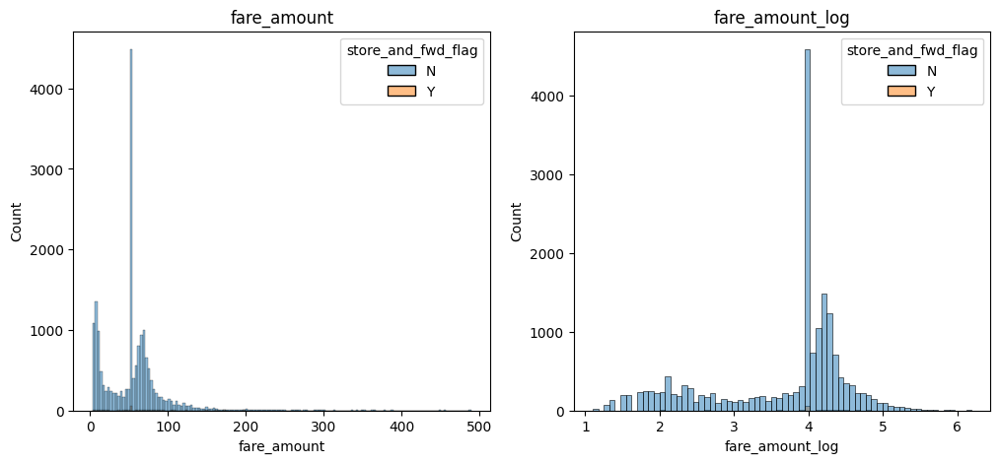

In [257]:
fig, axs = plt.subplots(1,2,figsize=(12,5))

sns.histplot(data=df_clean,x='fare_amount',hue='store_and_fwd_flag',palette="tab10",ax=axs[0])
axs[0].set_title(f"fare_amount")

sns.histplot(data=df_clean,x='fare_amount_log',hue='store_and_fwd_flag',palette="tab10",ax=axs[1])
axs[1].set_title(f"fare_amount_log")
plt.show()

U Test:
* $H_0$: mean fare_amount of store_and_fwd_flag N = mean fare_amount of store_and_fwd_flag Y
* $H_A$: mean fare_amount of store_and_fwd_flag N $\neq$ mean fare_amount of store_and_fwd_flag Y

T Test:
* $H_0$: mean log fare_amount of store_and_fwd_flag N = mean log fare_amount of store_and_fwd_flag Y
* $H_A$: mean log fare_amount of store_and_fwd_flag N $\neq$ mean log fare_amount of store_and_fwd_flag Y

In [258]:
from scipy.stats import mannwhitneyu

# Sample data
mask1 = df_clean['store_and_fwd_flag']=='N'
mask2 = df_clean['store_and_fwd_flag']=='Y'
group1=df_clean[mask1]['fare_amount']
group2=df_clean[mask2]['fare_amount']

u_statistic, p_value = mannwhitneyu(group1, group2)
show_test_result(u_statistic, p_value,significance_level)


#don't meet assumption
from scipy.stats import ttest_ind
group1=df_clean[mask1]['fare_amount_log']
group2=df_clean[mask2]['fare_amount_log']
t_statistic, p_value = ttest_ind(group1, group2,equal_var=False)
show_test_result(t_statistic, p_value,significance_level)

#=> no statistical difference amoung store_and_fwd_flag 
#The TLC rule doesn't mention any fare rate difference amoung store_and_fwd_flag
#using this feature may be unfair to some groups

Fail to reject H0 at significance level 0.01 (Pvalue=0.649, Statistic=999474.5)
Reject H0 at significance level 0.01 (Pvalue=0.01, Statistic=-2.64)


In [259]:
#######################################################
#Confirm payment_type
#######################################################
df_clean.groupby(['payment_type'])[['fare_amount','fare_amount_log']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'fare_amount_log':['count','min','max','std','mean','median']
})

fare_amount                                           \
                   count  min    max        std       mean median   
payment_type                                                        
1                  13482  3.0  454.5  36.032028  54.875552   52.0   
2                   5266  3.0  489.5  33.614348  47.020028   52.0   

             fare_amount_log                                                    
                       count       min       max       std      mean    median  
payment_type                                                                    
1                      13482  1.098612  6.119198  0.890405  3.713266  3.951244  
2                       5266  1.098612  6.193384  0.952200  3.507133  3.951244

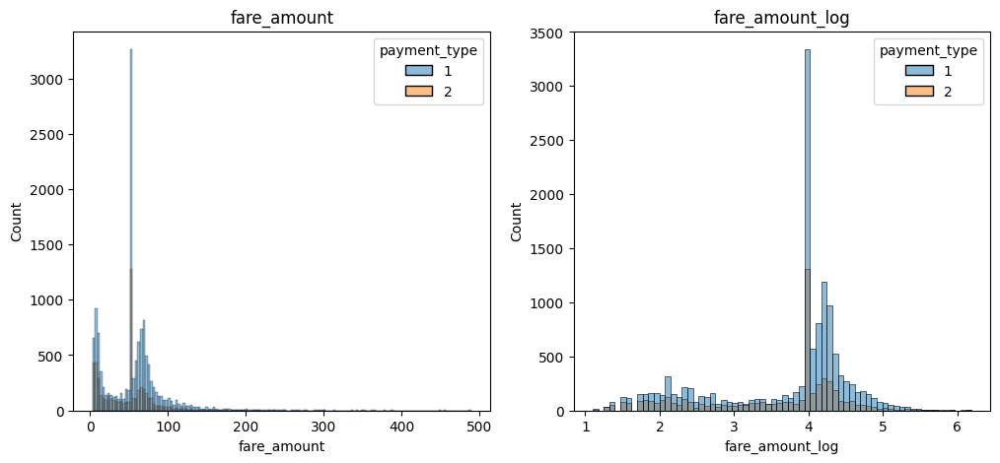

In [260]:
fig, axs = plt.subplots(1,2,figsize=(12,5))

sns.histplot(data=df_clean,x='fare_amount',hue='payment_type',palette="tab10",ax=axs[0])
axs[0].set_title(f"fare_amount")

sns.histplot(data=df_clean,x='fare_amount_log',hue='payment_type',palette="tab10",ax=axs[1])
axs[1].set_title(f"fare_amount_log")
plt.show()

In [261]:
from scipy.stats import mannwhitneyu

# Sample data
mask1 = df_clean['payment_type']==1
mask2 = df_clean['payment_type']==2
group1=df_clean[mask1]['fare_amount']
group2=df_clean[mask2]['fare_amount']

u_statistic, p_value = mannwhitneyu(group1, group2)
show_test_result(u_statistic, p_value,significance_level)

from scipy.stats import ttest_ind
group1=df_clean[mask1]['fare_amount_log']
group2=df_clean[mask2]['fare_amount_log']
t_statistic, p_value = ttest_ind(group1, group2,equal_var=False)
show_test_result(t_statistic, p_value,significance_level)

#The TLC rule write no extra fee for payment type
#using this feature would be unfair to some groups(one group will have to pay higher than another)

Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=40720655.0)
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=13.56)


In [262]:
#######################################################
#Confirm RatecodeID
#######################################################
df_clean.groupby(['RatecodeID'])[['fare_amount','fare_amount_log']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'fare_amount_log':['count','min','max','std','mean','median']
})

fare_amount                                            \
                 count   min    max        std       mean median   
RatecodeID                                                         
1                 4865   3.0   72.0   8.240214  11.853340    9.5   
2                 4293  52.0   52.0   0.000000  52.000000   52.0   
3                 4108  50.0  132.0   9.793985  69.726409   68.0   
4                 4345   3.0  489.5  41.209380  72.884718   64.5   
5                 1137  25.0  350.0  49.997193  90.955998   78.0   

           fare_amount_log                                                    
                     count       min       max       std      mean    median  
RatecodeID                                                                    
1                     4865  1.098612  4.276666  0.571243  2.294321  2.251292  
2                     4293  3.951244  3.951244  0.000000  3.951244  3.951244  
3                     4108  3.912023  4.882802  0.129881  4.235746  4.219508  
4                     4345  1.098612  6.193384  0.538054  4.148429  4.166665  
5                     1137  3.218876  5.857933  0.498499  4.380720  4.356709

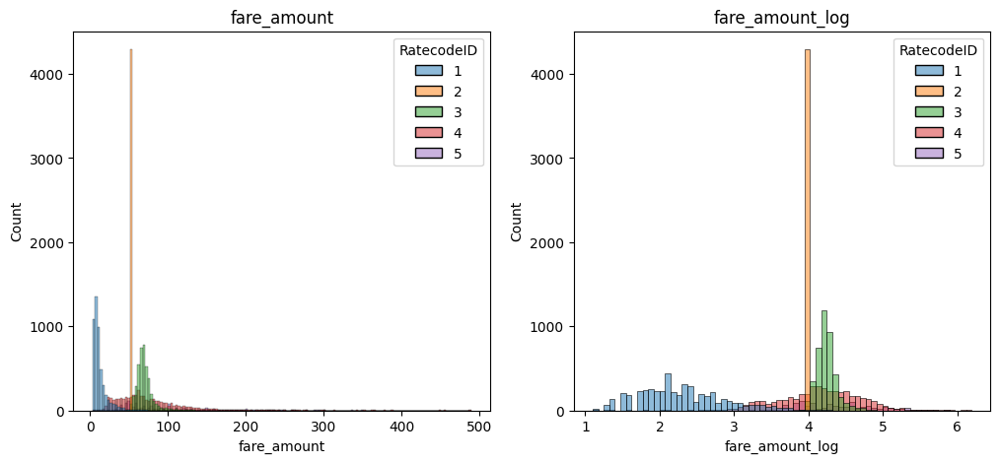

In [263]:
fig, axs = plt.subplots(1,2,figsize=(12,5))

sns.histplot(data=df_clean,x='fare_amount',hue='RatecodeID',palette="tab10",ax=axs[0])
axs[0].set_title(f"fare_amount")

sns.histplot(data=df_clean,x='fare_amount_log',hue='RatecodeID',palette="tab10",ax=axs[1])
axs[1].set_title(f"fare_amount_log")
plt.show()

$$
H_0: fare\_amount_{RatecodeID=1}=fare\_amount_{RatecodeID=2}=fare\_amount_{RatecodeID=3}=fare\_amount_{RatecodeID=4}=fare\_amount_{RatecodeID=5}
$$
$$H_A: \text{Not } fare\_amount_{RatecodeID=1}=fare\_amount_{RatecodeID=2}=fare\_amount_{RatecodeID=3}=fare\_amount_{RatecodeID=4}=fare\_amount_{RatecodeID=5}
$$

In [264]:
#########################################################
#check normal distribution by RatecodeID
#########################################################
#𝐻_0:Sample was drawn from a normal distribution
#𝐻_A:Sample was not drawn from a normal distribution.
significance_level=0.01
check_denpedent_list=[]
check_indenpedent_list=[]
statistic_list=[]
pvalue_list=[]
check_result_list=[]


#check fare_amount by RatecodeID
for item in df_clean['RatecodeID'].unique():
    statistic,pvalue = shapiro(df_clean[df_clean['RatecodeID'] == item]['fare_amount'])
    check_denpedent_list.append('fare_amount')
    check_indenpedent_list.append(item)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)
    
#check fare_amount_log by RatecodeID
for item in df_clean['RatecodeID'].unique():
    statistic,pvalue = shapiro(df_clean[df_clean['RatecodeID'] == item]['fare_amount_log'])
    check_denpedent_list.append('fare_amount_log')
    check_indenpedent_list.append(item)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)

normal_check_result=pd.DataFrame({
    "denpedent": check_denpedent_list,
    "indenpedent": check_indenpedent_list,
    "statistic": statistic_list,
    "pvalue":pvalue_list,
    "check_result":check_result_list
})
normal_check_result[normal_check_result['check_result']=='Fail to reject H0']

,denpedent,indenpedent,statistic,pvalue,check_result
1,fare_amount,2,1.0,1.0,Fail to reject H0
6,fare_amount_log,2,1.0,1.0,Fail to reject H0


In [265]:
#########################################################
#check equal variance by RatecodeID
#########################################################
#𝐻_0:Samples came from populations with equal variances
#𝐻_A:Samples didn't come from populations with equal variances
significance_level=0.01
check_denpedent_list=[]
check_indenpedent_list=[]
statistic_list=[]
pvalue_list=[]
check_result_list=[]


#check fare_amount by RatecodeID
for item in df_clean['RatecodeID'].unique():
    statistic,pvalue = levene(*[df_clean['fare_amount'][df_clean['RatecodeID'] == item]
                                    for item in df_clean['RatecodeID'].unique()])
    check_denpedent_list.append('fare_amount')
    check_indenpedent_list.append(item)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)
    
#check fare_amount_log by RatecodeID
for item in df_clean['RatecodeID'].unique():
    statistic,pvalue = levene(*[df_clean['fare_amount_log'][df_clean['RatecodeID'] == item]
                                    for item in df_clean['RatecodeID'].unique()])
    check_denpedent_list.append('fare_amount_log')
    check_indenpedent_list.append(item)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)

equal_variance_check_result=pd.DataFrame({
    "denpedent": check_denpedent_list,
    "indenpedent": check_indenpedent_list,
    "statistic": statistic_list,
    "pvalue":pvalue_list,
    "check_result":check_result_list
})
#equal_variance_check_result[equal_variance_check_result['check_result']=='Fail to reject H0']
equal_variance_check_result

,denpedent,indenpedent,statistic,pvalue,check_result
0,fare_amount,1,2296.87,0.0,Reject H0
1,fare_amount,2,2296.87,0.0,Reject H0
2,fare_amount,3,2296.87,0.0,Reject H0
3,fare_amount,4,2296.87,0.0,Reject H0
4,fare_amount,5,2296.87,0.0,Reject H0
5,fare_amount_log,1,2855.99,0.0,Reject H0
6,fare_amount_log,2,2855.99,0.0,Reject H0
7,fare_amount_log,3,2855.99,0.0,Reject H0
8,fare_amount_log,4,2855.99,0.0,Reject H0
9,fare_amount_log,5,2855.99,0.0,Reject H0


In [266]:
from scipy.stats import kruskal, friedmanchisquare

# Kruskal-Wallis test
#H0:The distributions of the fare_amount for all RatecodeIDs are identical.
#HA:At least one RatecodeID has a different distribution of fare_amount.
statistic, p_value = kruskal(*[df_clean['fare_amount'][df_clean['RatecodeID'] == pu_day]
                                    for pu_day in df_clean['RatecodeID'].unique()])
show_test_result(statistic, p_value,significance_level)


from scipy.stats import f_oneway


# Conduct the one-way ANOVA
statistic, p_value=f_oneway(*[df_clean['fare_amount_log'][df_clean['RatecodeID'] == pu_day]
                                    for pu_day in df_clean['RatecodeID'].unique()])
show_test_result(statistic, p_value,significance_level)

Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=12970.32)
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=18216.24)


In [267]:
#https://machinelearningmastery.com/leveraging-anova-and-kruskal-wallis-tests-to-analyze-the-impact-of-the-great-recession-on-housing-prices/
# Run KS Test from scipy.stats
#H0: all distributions are equal
#HA: Not all distributions are equal
significance_level=0.01
from scipy.stats import ks_2samp
results = {}
for i, item1 in enumerate(sorted(df_clean['RatecodeID'].unique())):
    for j, item2 in enumerate(sorted(df_clean['RatecodeID'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_clean[df_clean['RatecodeID'] == item1]['fare_amount'], 
                                     df_clean[df_clean['RatecodeID'] == item2]['fare_amount'])
            results[f"{item1} vs {item2}"] = (ks_stat, ks_p)

# Convert the results into a DataFrame for tabular representation
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS Statistic', 'P-value']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'RatecodeID Compared'}, inplace=True)

ks_df[ks_df['P-value']<=significance_level]

,RatecodeID Compared,KS Statistic,P-value
0,1 vs 2,0.996711,0.000000e+00
1,1 vs 3,0.996300,0.000000e+00
2,1 vs 4,0.881898,0.000000e+00
3,1 vs 5,0.961946,0.000000e+00
4,2 vs 3,0.997566,0.000000e+00
5,2 vs 4,0.670196,0.000000e+00
6,2 vs 5,0.737027,1.245045e-321
7,3 vs 4,0.341006,3.734082e-218
8,3 vs 5,0.392452,2.639794e-123
9,4 vs 5,0.171001,1.710827e-23


In [268]:
# Import Tukey's HSD function
from statsmodels.stats.multicomp import pairwise_tukeyhsd


# Run Tukey's HSD post hoc test for one-way ANOVA
tukey_oneway = pairwise_tukeyhsd(endog = df_clean["fare_amount_log"], groups = df_clean["RatecodeID"], alpha = 0.01)
# Get results (pairwise comparisons)
tukey_oneway.summary()

group1,group2,meandiff,p-adj,lower,upper,reject
1,2,1.6569,0.0,1.6288,1.6851,True
1,3,1.9414,0.0,1.9129,1.9699,True
1,4,1.8541,0.0,1.826,1.8822,True
1,5,2.0864,0.0,2.0421,2.1307,True
2,3,0.2845,0.0,0.2552,0.3138,True
2,4,0.1972,0.0,0.1683,0.2261,True
2,5,0.4295,0.0,0.3846,0.4743,True
3,4,-0.0873,0.0,-0.1166,-0.0581,True
3,5,0.145,0.0,0.0999,0.19,True
4,5,0.2323,0.0,0.1875,0.2771,True


In [269]:
#######################################################
#Confirm pickup month
#######################################################
df_clean.groupby(['PU_month'])[['fare_amount','fare_amount_log']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'fare_amount_log':['count','min','max','std','mean','median']
})

fare_amount                                          fare_amount_log  \
               count  min    max        std       mean median           count   
PU_month                                                                        
1               1604  3.0  337.0  32.373902  50.295324   52.0            1604   
2               1473  3.0  314.0  33.479445  50.897149   52.0            1473   
3               1710  3.0  389.0  34.054297  52.097778   52.0            1710   
4               1672  3.0  287.0  36.489508  53.555532   52.0            1672   
5               1683  3.0  489.5  37.093672  53.380190   52.0            1683   
6               1585  3.0  377.0  38.162985  53.942927   52.0            1585   
7               1415  3.5  350.0  34.799447  52.147830   52.0            1415   
8               1409  3.5  449.0  35.759843  52.300064   52.0            1409   
9               1487  3.5  363.5  37.663981  53.920303   52.0            1487   
10              1619  3.0  229.5  33.895819  52.868894   52.0            1619   
11              1533  3.5  454.5  36.124788  52.975212   52.0            1533   
12              1558  3.0  302.0  36.062384  53.503729   52.0            1558   

                                                            
               min       max       std      mean    median  
PU_month                                                    
1         1.098612  5.820083  0.919937  3.610968  3.951244  
2         1.098612  5.749393  0.889571  3.634575  3.951244  
3         1.098612  5.963579  0.900691  3.656402  3.951244  
4         1.098612  5.659482  0.915003  3.667473  3.951244  
5         1.098612  6.193384  0.935907  3.654785  3.951244  
6         1.098612  5.932245  0.915568  3.673865  3.951244  
7         1.252763  5.857933  0.924753  3.638292  3.951244  
8         1.252763  6.107023  0.909346  3.649701  3.951244  
9         1.252763  5.895779  0.930712  3.665254  3.951244  
10        1.098612  5.435903  0.887121  3.675691  3.951244  
11        1.252763  6.119198  0.903170  3.665780  3.951244  
12        1.098612  5.710427  0.922367  3.668240  3.951244

$$
H_0: fare\_amount_{pickup\_month=1}=fare\_amount_{pickup\_month=2}=fare\_amount_{pickup\_month=3}=fare\_amount_{pickup\_month=4}=fare\_amount_{pickup\_month=5}=fare\_amount_{pickup\_month=6}=fare\_amount_{pickup\_month=7}=fare\_amount_{pickup\_month=8}=fare\_amount_{pickup\_month=9}=fare\_amount_{pickup\_month=10}=fare\_amount_{pickup\_month=11}=fare\_amount_{pickup\_month=12}
$$
$$H_A: \text{Not } fare\_amount_{pickup\_month=1}=fare\_amount_{pickup\_month=2}=fare\_amount_{pickup\_month=3}=fare\_amount_{pickup\_month=4}=fare\_amount_{pickup\_month=5}=fare\_amount_{pickup\_month=6}=fare\_amount_{pickup\_month=7}=fare\_amount_{pickup\_month=8}=fare\_amount_{pickup\_month=9}=fare\_amount_{pickup\_month=10}=fare\_amount_{pickup\_month=11}=fare\_amount_{pickup\_month=12}
$$

In [270]:
#########################################################
#check normal distribution by PU_month
#########################################################
#𝐻_0:Sample was drawn from a normal distribution
#𝐻_A:Sample was not drawn from a normal distribution.
significance_level=0.01
check_denpedent_list=[]
check_indenpedent_list=[]
statistic_list=[]
pvalue_list=[]
check_result_list=[]


#check fare_amount by PU_month
for pu_day in df_clean['PU_month'].unique():
    statistic,pvalue = shapiro(df_clean[df_clean['PU_month'] == pu_day]['fare_amount'])
    check_denpedent_list.append('fare_amount')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)
    
#check fare_amount_log by PU_month
for pu_day in df_clean['PU_month'].unique():
    statistic,pvalue = shapiro(df_clean[df_clean['PU_month'] == pu_day]['fare_amount_log'])
    check_denpedent_list.append('fare_amount_log')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)

normal_check_result=pd.DataFrame({
    "denpedent": check_denpedent_list,
    "indenpedent": check_indenpedent_list,
    "statistic": statistic_list,
    "pvalue":pvalue_list,
    "check_result":check_result_list
})
normal_check_result[normal_check_result['check_result']=='Fail to reject H0']

,denpedent,indenpedent,statistic,pvalue,check_result


In [271]:
#########################################################
#check equal variance by PU_month
#########################################################
#𝐻_0:Samples came from populations with equal variances
#𝐻_A:Samples didn't come from populations with equal variances
significance_level=0.01
check_denpedent_list=[]
check_indenpedent_list=[]
statistic_list=[]
pvalue_list=[]
check_result_list=[]


#check fare_amount by PU_month
for pu_day in df_clean['PU_month'].unique():
    statistic,pvalue = levene(*[df_clean['fare_amount'][df_clean['PU_month'] == pu_day]
                                    for pu_day in df_clean['PU_month'].unique()])
    check_denpedent_list.append('fare_amount')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)
    
#check fare_amount_log by PU_month
for pu_day in df_clean['PU_month'].unique():
    statistic,pvalue = levene(*[df_clean['fare_amount_log'][df_clean['PU_month'] == pu_day]
                                    for pu_day in df_clean['PU_month'].unique()])
    check_denpedent_list.append('fare_amount_log')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)

equal_variance_check_result=pd.DataFrame({
    "denpedent": check_denpedent_list,
    "indenpedent": check_indenpedent_list,
    "statistic": statistic_list,
    "pvalue":pvalue_list,
    "check_result":check_result_list
})
#equal_variance_check_result[equal_variance_check_result['check_result']=='Fail to reject H0']
equal_variance_check_result

,denpedent,indenpedent,statistic,pvalue,check_result
0,fare_amount,1,1.92,0.032,Fail to reject H0
1,fare_amount,2,1.92,0.032,Fail to reject H0
2,fare_amount,3,1.92,0.032,Fail to reject H0
3,fare_amount,4,1.92,0.032,Fail to reject H0
4,fare_amount,5,1.92,0.032,Fail to reject H0
5,fare_amount,6,1.92,0.032,Fail to reject H0
6,fare_amount,7,1.92,0.032,Fail to reject H0
7,fare_amount,8,1.92,0.032,Fail to reject H0
8,fare_amount,9,1.92,0.032,Fail to reject H0
9,fare_amount,10,1.92,0.032,Fail to reject H0


In [272]:
from scipy.stats import kruskal, friedmanchisquare
significance_level=0.01

# Kruskal-Wallis test
#H0:The distributions of the fare_amount for all pickup months are identical.
#HA:At least one pickup month has a different distribution of fare_amount.
statistic, p_value = kruskal(*[df_clean['fare_amount'][df_clean['PU_month'] == pu_day]
                                    for pu_day in df_clean['PU_month'].unique()])
show_test_result(statistic, p_value,significance_level)


from scipy.stats import f_oneway

# didn't meet normal distribution assumption
# Conduct the one-way ANOVA
statistic, p_value=f_oneway(*[df_clean['fare_amount_log'][df_clean['PU_month'] == pu_day]
                                    for pu_day in df_clean['PU_month'].unique()])
show_test_result(statistic, p_value,significance_level)

Fail to reject H0 at significance level 0.01 (Pvalue=0.417, Statistic=11.32)
Fail to reject H0 at significance level 0.01 (Pvalue=0.754, Statistic=0.69)


In [273]:
#######################################################
#Confirm pickup day
#######################################################
df_clean.groupby(['PU_day'])[['fare_amount','fare_amount_log']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'fare_amount_log':['count','min','max','std','mean','median']
})

fare_amount                                           fare_amount_log  \
             count  min     max        std       mean median           count   
PU_day                                                                         
1              601  3.0  274.00  36.208500  53.056173   52.0             601   
2              607  3.5  222.00  33.420387  51.558155   52.0             607   
3              611  3.5  302.00  39.089667  54.848920   52.0             611   
4              559  3.5  226.00  34.387723  50.346601   52.0             559   
5              629  3.0  489.50  40.717849  53.818045   52.0             629   
6              616  3.0  212.50  34.886971  53.642354   52.0             616   
7              632  3.0  236.50  36.527820  53.429905   52.0             632   
8              655  3.0  337.00  36.107838  51.689618   52.0             655   
9              591  3.5  244.00  32.764755  52.799475   52.0             591   
10             668  3.0  350.00  35.603212  54.302994   52.0             668   
11             638  3.0  238.00  34.131296  51.509545   52.0             638   
12             632  3.5  290.00  35.685491  51.030854   52.0             632   
13             640  3.5  238.50  33.669051  52.554688   52.0             640   
14             591  3.0  235.00  34.840631  54.222420   52.0             591   
15             642  3.0  314.00  34.037015  52.181620   52.0             642   
16             651  3.5  299.50  37.104094  54.696713   52.0             651   
17             651  3.5  228.88  34.717605  55.622012   52.0             651   
18             659  3.5  351.00  36.399063  51.455387   52.0             659   
19             654  3.5  280.00  36.002931  53.943578   52.0             654   
20             596  3.5  200.00  33.090273  54.007869   52.0             596   
21             592  3.0  280.00  34.293583  51.796030   52.0             592   
22             656  3.0  449.00  37.742225  52.678796   52.0             656   
23             565  3.5  377.00  39.162972  54.282106   52.0             565   
24             615  3.5  363.50  35.765681  53.374878   52.0             615   
25             581  3.5  297.50  34.268599  50.881601   52.0             581   
26             614  3.5  226.00  30.567326  51.278306   52.0             614   
27             627  3.5  454.50  39.957946  54.238038   52.0             627   
28             566  4.0  260.50  35.626750  50.641961   52.0             566   
29             516  3.0  260.50  33.975545  50.049147   52.0             516   
30             545  3.0  364.50  33.715416  50.056881   52.0             545   
31             348  3.0  173.50  33.236575  50.495920   52.0             348   

                                                          
             min       max       std      mean    median  
PU_day                                                    
1       1.098612  5.613128  0.901975  3.667080  3.951244  
2       1.252763  5.402677  0.920982  3.633744  3.951244  
3       1.252763  5.710427  0.921485  3.687097  3.951244  
4       1.252763  5.420535  0.931079  3.596245  3.951244  
5       1.098612  6.193384  0.925930  3.662344  3.951244  
6       1.098612  5.358942  0.907660  3.678710  3.951244  
7       1.098612  5.465948  0.948100  3.646904  3.951244  
8       1.098612  5.820083  0.904360  3.637645  3.951244  
9       1.252763  5.497168  0.875333  3.687077  3.951244  
10      1.098612  5.857933  0.897304  3.703332  3.951244  
11      1.098612  5.472271  0.928656  3.623102  3.951244  
12      1.252763  5.669881  0.907369  3.621323  3.951244  
13      1.252763  5.474369  0.908677  3.658933  3.951244  
14      1.098612  5.459586  0.894691  3.699879  3.951244  
15      1.098612  5.749393  0.942862  3.635644  3.951244  
16      1.252763  5.702114  0.880968  3.709415  3.951244  
17      1.252763  5.433198  0.869981  3.741189  3.951244  
18      1.252763  5.860786  0.942844  3.608508  3.951244  
19      1.252763  5.634790  0.905068  3.684479 

$$
H_0: fare\_amount_{pickup\_day=1}=fare\_amount_{pickup\_day=2}=fare\_amount_{pickup\_day=3}=fare\_amount_{pickup\_day=4}=fare\_amount_{pickup\_day=5}=fare\_amount_{pickup\_day=6}=fare\_amount_{pickup\_day=7}=fare\_amount_{pickup\_day=8}=fare\_amount_{pickup\_day=9}=fare\_amount_{pickup\_day=10}=fare\_amount_{pickup\_day=11}=fare\_amount_{pickup\_day=12}=fare\_amount_{pickup\_day=13}=fare\_amount_{pickup\_day=14}=fare\_amount_{pickup\_day=15}=fare\_amount_{pickup\_day=16}=fare\_amount_{pickup\_day=17}=fare\_amount_{pickup\_day=18}=fare\_amount_{pickup\_day=19}=fare\_amount_{pickup\_day=20}=fare\_amount_{pickup\_day=21}=fare\_amount_{pickup\_day=22}=fare\_amount_{pickup\_day=23}=fare\_amount_{pickup\_day=24}=fare\_amount_{pickup\_day=25}=fare\_amount_{pickup\_day=26}=fare\_amount_{pickup\_day=27}=fare\_amount_{pickup\_day=28}=fare\_amount_{pickup\_day=29}=fare\_amount_{pickup\_day=30}=fare\_amount_{pickup\_day=31}
$$
$$H_A: \text{Not } fare\_amount_{pickup\_day=1}=fare\_amount_{pickup\_day=2}=fare\_amount_{pickup\_day=3}=fare\_amount_{pickup\_day=4}=fare\_amount_{pickup\_day=5}=fare\_amount_{pickup\_day=6}=fare\_amount_{pickup\_day=7}=fare\_amount_{pickup\_day=8}=fare\_amount_{pickup\_day=9}=fare\_amount_{pickup\_day=10}=fare\_amount_{pickup\_day=11}=fare\_amount_{pickup\_day=12}=fare\_amount_{pickup\_day=13}=fare\_amount_{pickup\_day=14}=fare\_amount_{pickup\_day=15}=fare\_amount_{pickup\_day=16}=fare\_amount_{pickup\_day=17}=fare\_amount_{pickup\_day=18}=fare\_amount_{pickup\_day=19}=fare\_amount_{pickup\_day=20}=fare\_amount_{pickup\_day=21}=fare\_amount_{pickup\_day=22}=fare\_amount_{pickup\_day=23}=fare\_amount_{pickup\_day=24}=fare\_amount_{pickup\_day=25}=fare\_amount_{pickup\_day=26}=fare\_amount_{pickup\_day=27}=fare\_amount_{pickup\_day=28}=fare\_amount_{pickup\_day=29}=fare\_amount_{pickup\_day=30}=fare\_amount_{pickup\_day=31}
$$

In [274]:
#########################################################
#check normal distribution by PU_day
#########################################################
#𝐻_0:Sample was drawn from a normal distribution
#𝐻_A:Sample was not drawn from a normal distribution.
significance_level=0.01
check_denpedent_list=[]
check_indenpedent_list=[]
statistic_list=[]
pvalue_list=[]
check_result_list=[]


#check fare_amount by PU_day
for pu_day in df_clean['PU_day'].unique():
    statistic,pvalue = shapiro(df_clean[df_clean['PU_day'] == pu_day]['fare_amount'])
    check_denpedent_list.append('fare_amount')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)
    
#check fare_amount_log by PU_day
for pu_day in df_clean['PU_day'].unique():
    statistic,pvalue = shapiro(df_clean[df_clean['PU_day'] == pu_day]['fare_amount_log'])
    check_denpedent_list.append('fare_amount_log')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)

normal_check_result=pd.DataFrame({
    "denpedent": check_denpedent_list,
    "indenpedent": check_indenpedent_list,
    "statistic": statistic_list,
    "pvalue":pvalue_list,
    "check_result":check_result_list
})
normal_check_result[normal_check_result['check_result']=='Fail to reject H0']

,denpedent,indenpedent,statistic,pvalue,check_result


In [275]:
#########################################################
#check equal variance by PU_day
#########################################################
#𝐻_0:Samples came from populations with equal variances
#𝐻_A:Samples didn't come from populations with equal variances
significance_level=0.01
check_denpedent_list=[]
check_indenpedent_list=[]
statistic_list=[]
pvalue_list=[]
check_result_list=[]


#check fare_amount by PU_day
for pu_day in df_clean['PU_day'].unique():
    statistic,pvalue = levene(*[df_clean['fare_amount'][df_clean['PU_day'] == pu_day]
                                    for pu_day in df_clean['PU_day'].unique()])
    check_denpedent_list.append('fare_amount')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)
    
#check fare_amount_log by PU_day
for pu_day in df_clean['PU_day'].unique():
    statistic,pvalue = levene(*[df_clean['fare_amount_log'][df_clean['PU_day'] == pu_day]
                                    for pu_day in df_clean['PU_day'].unique()])
    check_denpedent_list.append('fare_amount_log')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)

equal_variance_check_result=pd.DataFrame({
    "denpedent": check_denpedent_list,
    "indenpedent": check_indenpedent_list,
    "statistic": statistic_list,
    "pvalue":pvalue_list,
    "check_result":check_result_list
})
#equal_variance_check_result[equal_variance_check_result['check_result']=='Fail to reject H0']
equal_variance_check_result

,denpedent,indenpedent,statistic,pvalue,check_result
0,fare_amount,3,0.71,0.880,Fail to reject H0
1,fare_amount,19,0.71,0.880,Fail to reject H0
2,fare_amount,11,0.71,0.880,Fail to reject H0
3,fare_amount,8,0.71,0.880,Fail to reject H0
4,fare_amount,31,0.71,0.880,Fail to reject H0
...,...,...,...,...,...
57,fare_amount_log,30,0.80,0.776,Fail to reject H0
58,fare_amount_log,2,0.80,0.776,Fail to reject H0
59,fare_amount_log,4,0.80,0.776,Fail to reject H0
60,fare_amount_log,5,0.80,0.776,Fail to reject H0


In [276]:
#https://machinelearningmastery.com/leveraging-anova-and-kruskal-wallis-tests-to-analyze-the-impact-of-the-great-recession-on-housing-prices/
from scipy.stats import kruskal, friedmanchisquare
# Kruskal-Wallis test
#H0:The distributions of the fare_amount for all pickup days are identical.
#HA:At least one pickup days has a different distribution of fare_amount.
print('Kruskal-Wallis test')
statistic, p_value = kruskal(*[df_clean['fare_amount'][df_clean['PU_day'] == pu_day]
                                    for pu_day in df_clean['PU_day'].unique()])
show_test_result(statistic, p_value,significance_level)


#since the dataset don't meet the assumption of ANOVA, the result of ANOVA might be invalid
from scipy.stats import f_oneway
# Conduct the one-way ANOVA
print('one-way ANOVA')
statistic, p_value = f_oneway(*[df_clean['fare_amount_log'][df_clean['PU_day'] == pu_day]
                                    for pu_day in df_clean['PU_day'].unique()])
show_test_result(statistic, p_value,significance_level)


#=>It seems like there is no significant difference amoung pickup day

Kruskal-Wallis test
Fail to reject H0 at significance level 0.01 (Pvalue=0.134, Statistic=38.66)
one-way ANOVA
Fail to reject H0 at significance level 0.01 (Pvalue=0.246, Statistic=1.16)


**Test : group1 vs. group2**<BR>
$H_0: fare\_amount_{pickup\_day=group1}=fare\_amount_{pickup\_day=group2}$

$H_A: fare\_amount_{pickup\_day=group1} \neq fare\_amount_{pickup\_day=group2}$

In [277]:
# Import Tukey's HSD function
from statsmodels.stats.multicomp import pairwise_tukeyhsd


# Run Tukey's HSD post hoc test for one-way ANOVA
tukey_oneway = pairwise_tukeyhsd(endog = df_clean["fare_amount_log"], groups = df_clean["PU_day"], alpha = 0.01)
# Get results (pairwise comparisons)
tukey_oneway.summary()

#=>all of them fail to reject

group1,group2,meandiff,p-adj,lower,upper,reject
1,2,-0.0333,1.0,-0.2537,0.187,False
1,3,0.02,1.0,-0.2,0.24,False
1,4,-0.0708,1.0,-0.2958,0.1542,False
1,5,-0.0047,1.0,-0.2232,0.2137,False
1,6,0.0116,1.0,-0.2079,0.2312,False
1,7,-0.0202,1.0,-0.2383,0.198,False
1,8,-0.0294,1.0,-0.2457,0.1869,False
1,9,0.02,1.0,-0.2018,0.2418,False
1,10,0.0363,1.0,-0.179,0.2515,False
1,11,-0.044,1.0,-0.2616,0.1737,False


In [278]:
#######################################################
#Confirm pickup Weekday
#######################################################
df_clean.groupby(['PU_weekday'])[['fare_amount','fare_amount_log']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'fare_amount_log':['count','min','max','std','mean','median']
})

fare_amount                                           \
                 count  min    max        std       mean median   
PU_weekday                                                        
Sunday            2835  3.0  363.5  36.356357  54.816063   52.0   
Monday            2661  3.0  454.5  36.473909  54.082259   52.0   
Tuesday           2493  3.0  449.0  35.762431  52.174412   52.0   
Wednesday         2681  3.0  314.0  34.850189  52.035498   52.0   
Thursday          2741  3.0  300.0  34.956408  52.528606   52.0   
Friday            2961  3.0  489.5  35.386189  53.331793   52.0   
Saturday          2376  3.0  299.5  34.653589  49.094655   52.0   

           fare_amount_log                                                    
                     count       min       max       std      mean    median  
PU_weekday                                                                    
Sunday                2835  1.098612  5.895779  0.883413  3.717957  3.951244  
Monday                2661  1.098612  6.119198  0.889564  3.698243  3.951244  
Tuesday               2493  1.098612  6.107023  0.911468  3.643182  3.951244  
Wednesday             2681  1.098612  5.749393  0.906509  3.645078  3.951244  
Thursday              2741  1.098612  5.703782  0.922434  3.646814  3.951244  
Friday                2961  1.098612  6.193384  0.913226  3.670608  3.951244  
Saturday              2376  1.098612  5.702114  0.959917  3.547930  3.951244

$$
H_0: fare\_amount_{pickup\_weekday=Monday}=fare\_amount_{pickup\_weekday=Tuesday}=fare\_amount_{pickup\_weekday=Wednesday}=fare\_amount_{pickup\_weekday=Thursday}=fare\_amount_{pickup\_weekdayh=Friday}=fare\_amount_{pickup\_weekday=Saturday}=fare\_amount_{pickup\_weekday=Sunday}
$$
$$H_A: \text{Not } fare\_amount_{pickup\_weekday=Monday}=fare\_amount_{pickup\_weekday=Tuesday}=fare\_amount_{pickup\_weekday=Wednesday}=fare\_amount_{pickup\_weekday=Thursday}=fare\_amount_{pickup\_weekdayh=Friday}=fare\_amount_{pickup\_weekday=Saturday}=fare\_amount_{pickup\_weekday=Sunday}
$$

In [279]:
#########################################################
#check normal distribution by PU_weekday
#########################################################
#𝐻_0:Sample was drawn from a normal distribution
#𝐻_A:Sample was not drawn from a normal distribution.
significance_level=0.01
check_denpedent_list=[]
check_indenpedent_list=[]
statistic_list=[]
pvalue_list=[]
check_result_list=[]


#check fare_amount by PU_day
for pu_day in df_clean['PU_weekday'].unique():
    statistic,pvalue = shapiro(df_clean[df_clean['PU_weekday'] == pu_day]['fare_amount'])
    check_denpedent_list.append('fare_amount')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)
    
#check fare_amount_log by PU_day
for pu_day in df_clean['PU_weekday'].unique():
    statistic,pvalue = shapiro(df_clean[df_clean['PU_weekday'] == pu_day]['fare_amount_log'])
    check_denpedent_list.append('fare_amount_log')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)

normal_check_result=pd.DataFrame({
    "denpedent": check_denpedent_list,
    "indenpedent": check_indenpedent_list,
    "statistic": statistic_list,
    "pvalue":pvalue_list,
    "check_result":check_result_list
})
#normal_check_result[normal_check_result['check_result']=='Fail to reject H0']
normal_check_result

,denpedent,indenpedent,statistic,pvalue,check_result
0,fare_amount,Tuesday,0.87,0.0,Reject H0
1,fare_amount,Thursday,0.90,0.0,Reject H0
2,fare_amount,Wednesday,0.88,0.0,Reject H0
3,fare_amount,Sunday,0.84,0.0,Reject H0
4,fare_amount,Saturday,0.87,0.0,Reject H0
5,fare_amount,Friday,0.87,0.0,Reject H0
6,fare_amount,Monday,0.84,0.0,Reject H0
7,fare_amount_log,Tuesday,0.88,0.0,Reject H0
8,fare_amount_log,Thursday,0.87,0.0,Reject H0
9,fare_amount_log,Wednesday,0.87,0.0,Reject H0


In [280]:
#########################################################
#check equal variance by PU_day
#########################################################
#𝐻_0:Samples came from populations with equal variances
#𝐻_A:Samples didn't come from populations with equal variances
significance_level=0.01
check_denpedent_list=[]
check_indenpedent_list=[]
statistic_list=[]
pvalue_list=[]
check_result_list=[]


#check fare_amount by PU_day
for pu_day in df_clean['PU_weekday'].unique():
    statistic,pvalue = levene(*[df_clean['fare_amount'][df_clean['PU_weekday'] == pu_day]
                                    for pu_day in df_clean['PU_weekday'].unique()])
    check_denpedent_list.append('fare_amount')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)
    
#check fare_amount_log by PU_day
for pu_day in df_clean['PU_weekday'].unique():
    statistic,pvalue = levene(*[df_clean['fare_amount_log'][df_clean['PU_weekday'] == pu_day]
                                    for pu_day in df_clean['PU_weekday'].unique()])
    check_denpedent_list.append('fare_amount_log')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)

equal_variance_check_result=pd.DataFrame({
    "denpedent": check_denpedent_list,
    "indenpedent": check_indenpedent_list,
    "statistic": statistic_list,
    "pvalue":pvalue_list,
    "check_result":check_result_list
})
#equal_variance_check_result[equal_variance_check_result['check_result']=='Fail to reject H0']
equal_variance_check_result

,denpedent,indenpedent,statistic,pvalue,check_result
0,fare_amount,Tuesday,0.95,0.458,Fail to reject H0
1,fare_amount,Thursday,0.95,0.458,Fail to reject H0
2,fare_amount,Wednesday,0.95,0.458,Fail to reject H0
3,fare_amount,Sunday,0.95,0.458,Fail to reject H0
4,fare_amount,Saturday,0.95,0.458,Fail to reject H0
5,fare_amount,Friday,0.95,0.458,Fail to reject H0
6,fare_amount,Monday,0.95,0.458,Fail to reject H0
7,fare_amount_log,Tuesday,6.68,0.000,Reject H0
8,fare_amount_log,Thursday,6.68,0.000,Reject H0
9,fare_amount_log,Wednesday,6.68,0.000,Reject H0


In [281]:
# Kruskal-Wallis test
#H0:The distributions of the fare_amount for all pickup weekdays are identical.
#HA:At least one pickup weekday has a different distribution of fare_amount.
from scipy.stats import kruskal, friedmanchisquare
print('Kruskal-Wallis testresult of fare_amount')
statistic, p_value = kruskal(*[df_clean['fare_amount'][df_clean['PU_weekday'] == pu_day]
                                    for pu_day in df_clean['PU_weekday'].unique()])
show_test_result(statistic, p_value,significance_level)


# since the dataset don't meet the assumption of ANOVA, the result of ANOVA might be invalid
# Conduct the one-way ANOVA
from scipy.stats import f_oneway
print('one-way ANOVA result of fare_amount_log')
statistic, p_value = f_oneway(*[df_clean['fare_amount_log'][df_clean['PU_weekday'] == pu_day]
                                    for pu_day in df_clean['PU_weekday'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of fare_amount
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=48.02)
one-way ANOVA result of fare_amount_log
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=9.02)


In [282]:
#https://machinelearningmastery.com/leveraging-anova-and-kruskal-wallis-tests-to-analyze-the-impact-of-the-great-recession-on-housing-prices/
# Run KS Test from scipy.stats
#H0: all distributions are equal
#HA: Not all distributions are equal
significance_level=0.01
from scipy.stats import ks_2samp
results = {}
for i, pu_day1 in enumerate(sorted(df_clean['PU_weekday'].unique())):
    for j, pu_day2 in enumerate(sorted(df_clean['PU_weekday'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_clean[df_clean['PU_weekday'] == pu_day1]['fare_amount'], 
                                     df_clean[df_clean['PU_weekday'] == pu_day2]['fare_amount'])
            results[f"{pu_day1} vs {pu_day2}"] = (ks_stat, ks_p)

# Convert the results into a DataFrame for tabular representation
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS Statistic', 'P-value']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'Weekday Compared'}, inplace=True)

ks_df[ks_df['P-value']<=significance_level]

,Weekday Compared,KS Statistic,P-value
1,Friday vs Saturday,0.076492,3.693579e-07
6,Monday vs Saturday,0.073418,2.465124e-06
9,Monday vs Tuesday,0.047776,5.367621e-03
11,Saturday vs Sunday,0.081934,5.316095e-08
12,Saturday vs Thursday,0.074862,1.180627e-06
13,Saturday vs Tuesday,0.058649,4.381706e-04
14,Saturday vs Wednesday,0.050076,3.447355e-03
15,Sunday vs Thursday,0.048571,2.661480e-03
16,Sunday vs Tuesday,0.058340,2.267496e-04
17,Sunday vs Wednesday,0.054117,5.932741e-04


In [283]:
# Import Tukey's HSD function
from statsmodels.stats.multicomp import pairwise_tukeyhsd


# Run Tukey's HSD post hoc test for one-way ANOVA
tukey_oneway = pairwise_tukeyhsd(endog = df_clean["fare_amount_log"], groups = df_clean["PU_weekday"], alpha = 0.01)
# Get results (pairwise comparisons)
tukey_oneway.summary()

group1,group2,meandiff,p-adj,lower,upper,reject
Friday,Monday,0.0276,0.9175,-0.0565,0.1117,False
Friday,Saturday,-0.1227,0.0,-0.2094,-0.036,True
Friday,Sunday,0.0473,0.4297,-0.0354,0.1301,False
Friday,Thursday,-0.0238,0.9574,-0.1072,0.0596,False
Friday,Tuesday,-0.0274,0.9263,-0.113,0.0581,False
Friday,Wednesday,-0.0255,0.9421,-0.1095,0.0584,False
Monday,Saturday,-0.1503,0.0,-0.2392,-0.0615,True
Monday,Sunday,0.0197,0.9849,-0.0653,0.1047,False
Monday,Thursday,-0.0514,0.369,-0.1371,0.0342,False
Monday,Tuesday,-0.0551,0.3138,-0.1428,0.0327,False


In [284]:
#######################################################
#Confirm pickup hour
#######################################################
df_clean.groupby(['PU_hour'])[['fare_amount','fare_amount_log']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'fare_amount_log':['count','min','max','std','mean','median']
})

fare_amount                                          fare_amount_log  \
              count  min    max        std       mean median           count   
PU_hour                                                                        
0               504  3.0  297.5  43.788448  52.577956   52.0             504   
1               353  3.5  489.5  47.932970  51.013201   50.0             353   
2               251  4.0  343.5  43.043886  48.407171   45.0             251   
3               228  3.5  337.0  42.411032  57.078246   57.0             228   
4               316  4.0  187.5  28.186390  56.162975   59.0             316   
5               520  3.5  454.5  28.361421  57.896231   57.5             520   
6               710  3.0  232.0  25.573572  52.785577   52.0             710   
7               723  3.5  209.9  29.824558  50.902835   52.0             723   
8               713  3.5  377.0  40.482498  52.616410   52.0             713   
9               689  3.0  280.0  35.623037  50.300595   52.0             689   
10              753  3.0  300.0  34.978095  50.451780   52.0             753   
11              811  3.5  258.0  34.733126  52.125721   52.0             811   
12              911  3.0  350.0  33.281228  52.937870   52.0             911   
13             1150  3.5  260.5  32.975934  54.237609   52.0            1150   
14             1363  3.0  235.0  30.317863  56.479384   52.0            1363   
15             1245  3.0  363.5  31.359757  55.260554   52.0            1245   
16             1122  3.0  314.0  34.476220  56.382977   52.0            1122   
17             1065  3.0  389.0  37.561012  54.821408   52.0            1065   
18             1039  3.0  449.0  36.919740  50.337834   52.0            1039   
19              942  3.0  294.0  38.054187  47.340902   52.0             942   
20              883  3.0  260.0  36.706663  50.584179   52.0             883   
21              933  3.5  364.5  37.491449  48.145284   52.0             933   
22              798  3.5  280.0  38.757954  50.633145   52.0             798   
23              726  3.5  351.0  39.689899  52.732989   52.0             726   

                                                           
              min       max       std      mean    median  
PU_hour                                                    
0        1.098612  5.695414  0.962042  3.583997  3.951244  
1        1.252763  6.193384  0.997145  3.511298  3.912023  
2        1.386294  5.839187  1.012253  3.449848  3.806662  
3        1.252763  5.820083  0.935738  3.713676  4.043051  
4        1.386294  5.233779  0.716169  3.845746  4.077537  
5        1.252763  6.119198  0.616446  3.926407  4.051785  
6        1.098612  5.446737  0.771223  3.764498  3.951244  
7        1.252763  5.346631  0.870832  3.660246  3.951244  
8        1.252763  5.932245  0.979536  3.595745  3.951244  
9        1.098612  5.634790  0.980009  3.557916  3.951244  
10       1.098612  5.703782  0.961854  3.576394  3.951244  
11       1.252763  5.552960  0.940725  3.628895  3.951244  
12       1.098612  5.857933  0.923807  3.664656  3.951244  
13       1.252763  5.562603  0.874026  3.719377  3.951244  
14       1.098612  5.459586  0.830520  3.798002  3.951244  
15       1.098612  5.895779  0.846146  3.762047  3.951244  
16       1.098612  5.749393  0.869814  3.763476  3.951244  
17       1.098612  5.963579  0.927807  3.688267  3.951244  
18       1.098612  6.107023  0.951783  3.576614  3.951244  
19       1.098612  5.683580  1.007416  3.454469  3.951244  
20       1.098612  5.560682  0.960078  3.574208  3.951244  
21       1.252763  5.898527  0.937288  3.523745  3.951244  
22       1.252763  5.634790  0.916301  3.588003  3.951244  
23       1.252763  5.860786  0.908161  3.637796  3.951244

$$
H_0: fare\_amount_{pickup\_hour=1}=fare\_amount_{pickup\_hour=2}=fare\_amount_{pickup\_hour=3}=fare\_amount_{pickup\_hour=4}=fare\_amount_{pickup\_hour=5}=fare\_amount_{pickup\_hour=6}=fare\_amount_{pickup\_hour=7}=fare\_amount_{pickup\_hour=8}=fare\_amount_{pickup\_hour=9}=fare\_amount_{pickup\_hour=10}=fare\_amount_{pickup\_hour=11}=fare\_amount_{pickup\_hour=12}=fare\_amount_{pickup\_hour=13}=fare\_amount_{pickup\_hour=14}=fare\_amount_{pickup\_hour=15}=fare\_amount_{pickup\_hour=16}=fare\_amount_{pickup\_hour=17}=fare\_amount_{pickup\_hour=18}=fare\_amount_{pickup\_hour=19}=fare\_amount_{pickup\_hour=20}=fare\_amount_{pickup\_hour=21}=fare\_amount_{pickup\_hour=22}=fare\_amount_{pickup\_hour=23}=fare\_amount_{pickup\_hour=24}
$$
$$H_A: \text{Not } fare\_amount_{pickup\_hour=1}=fare\_amount_{pickup\_hour=2}=fare\_amount_{pickup\_hour=3}=fare\_amount_{pickup\_hour=4}=fare\_amount_{pickup\_hour=5}=fare\_amount_{pickup\_hour=6}=fare\_amount_{pickup\_hour=7}=fare\_amount_{pickup\_hour=8}=fare\_amount_{pickup\_hour=9}=fare\_amount_{pickup\_hour=10}=fare\_amount_{pickup\_hour=11}=fare\_amount_{pickup\_hour=12}=fare\_amount_{pickup\_hour=13}=fare\_amount_{pickup\_hour=14}=fare\_amount_{pickup\_hour=15}=fare\_amount_{pickup\_hour=16}=fare\_amount_{pickup\_hour=17}=fare\_amount_{pickup\_hour=18}=fare\_amount_{pickup\_hour=19}=fare\_amount_{pickup\_hour=20}=fare\_amount_{pickup\_hour=21}=fare\_amount_{pickup\_hour=22}=fare\_amount_{pickup\_hour=23}=fare\_amount_{pickup\_hour=24}
$$

In [285]:
#########################################################
#check normal distribution by PU_hour
#########################################################
#𝐻_0:Sample was drawn from a normal distribution
#𝐻_A:Sample was not drawn from a normal distribution.
significance_level=0.01
check_denpedent_list=[]
check_indenpedent_list=[]
statistic_list=[]
pvalue_list=[]
check_result_list=[]


#check fare_amount by PU_hour
for pu_day in df_clean['PU_hour'].unique():
    statistic,pvalue = shapiro(df_clean[df_clean['PU_hour'] == pu_day]['fare_amount'])
    check_denpedent_list.append('fare_amount')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)
    
#check fare_amount_log by PU_hour
for pu_day in df_clean['PU_hour'].unique():
    statistic,pvalue = shapiro(df_clean[df_clean['PU_hour'] == pu_day]['fare_amount_log'])
    check_denpedent_list.append('fare_amount_log')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)

normal_check_result=pd.DataFrame({
    "denpedent": check_denpedent_list,
    "indenpedent": check_indenpedent_list,
    "statistic": statistic_list,
    "pvalue":pvalue_list,
    "check_result":check_result_list
})
#normal_check_result[normal_check_result['check_result']=='Fail to reject H0']
normal_check_result

,denpedent,indenpedent,statistic,pvalue,check_result
0,fare_amount,1,0.76,0.0,Reject H0
1,fare_amount,10,0.89,0.0,Reject H0
2,fare_amount,16,0.88,0.0,Reject H0
3,fare_amount,15,0.89,0.0,Reject H0
4,fare_amount,17,0.86,0.0,Reject H0
5,fare_amount,14,0.90,0.0,Reject H0
6,fare_amount,22,0.85,0.0,Reject H0
7,fare_amount,23,0.86,0.0,Reject H0
8,fare_amount,8,0.84,0.0,Reject H0
9,fare_amount,7,0.90,0.0,Reject H0


In [286]:
#########################################################
#check equal variance by PU_hour
#########################################################
#𝐻_0:Samples came from populations with equal variances
#𝐻_A:Samples didn't come from populations with equal variances
significance_level=0.01
check_denpedent_list=[]
check_indenpedent_list=[]
statistic_list=[]
pvalue_list=[]
check_result_list=[]


#check fare_amount by PU_hour
for pu_day in df_clean['PU_hour'].unique():
    statistic,pvalue = levene(*[df_clean['fare_amount'][df_clean['PU_hour'] == pu_day]
                                    for pu_day in df_clean['PU_hour'].unique()])
    check_denpedent_list.append('fare_amount')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)
    
#check fare_amount_log by PU_hour
for pu_day in df_clean['PU_hour'].unique():
    statistic,pvalue = levene(*[df_clean['fare_amount_log'][df_clean['PU_hour'] == pu_day]
                                    for pu_day in df_clean['PU_hour'].unique()])
    check_denpedent_list.append('fare_amount_log')
    check_indenpedent_list.append(pu_day)
    statistic_list.append(round(statistic,2))
    pvalue_list.append(round(pvalue,3))
    if pvalue<=significance_level:
        result='Reject H0'
    else:
        result='Fail to reject H0'
    check_result_list.append(result)

equal_variance_check_result=pd.DataFrame({
    "denpedent": check_denpedent_list,
    "indenpedent": check_indenpedent_list,
    "statistic": statistic_list,
    "pvalue":pvalue_list,
    "check_result":check_result_list
})
#equal_variance_check_result[equal_variance_check_result['check_result']=='Fail to reject H0']
equal_variance_check_result

,denpedent,indenpedent,statistic,pvalue,check_result
0,fare_amount,1,12.62,0.0,Reject H0
1,fare_amount,10,12.62,0.0,Reject H0
2,fare_amount,16,12.62,0.0,Reject H0
3,fare_amount,15,12.62,0.0,Reject H0
4,fare_amount,17,12.62,0.0,Reject H0
5,fare_amount,14,12.62,0.0,Reject H0
6,fare_amount,22,12.62,0.0,Reject H0
7,fare_amount,23,12.62,0.0,Reject H0
8,fare_amount,8,12.62,0.0,Reject H0
9,fare_amount,7,12.62,0.0,Reject H0


In [287]:
# Kruskal-Wallis test
#H0:The distributions of the fare_amount for all pickup hours are identical.
#HA:At least one pickup hour has a different distribution of fare_amount.
from scipy.stats import kruskal, friedmanchisquare
print('Kruskal-Wallis testresult of fare_amount')
statistic, p_value = kruskal(*[df_clean['fare_amount'][df_clean['PU_hour'] == pu_day]
                                    for pu_day in df_clean['PU_hour'].unique()])
show_test_result(statistic, p_value,significance_level)


# since the dataset don't meet the assumption of ANOVA, the result of ANOVA might be invalid
# Conduct the one-way ANOVA
from scipy.stats import f_oneway
print('one-way ANOVA result of fare_amount_log')
statistic, p_value = f_oneway(*[df_clean['fare_amount_log'][df_clean['PU_hour'] == pu_day]
                                    for pu_day in df_clean['PU_hour'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of fare_amount
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=333.53)
one-way ANOVA result of fare_amount_log
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=11.9)


In [288]:
#https://machinelearningmastery.com/leveraging-anova-and-kruskal-wallis-tests-to-analyze-the-impact-of-the-great-recession-on-housing-prices/
# Run KS Test from scipy.stats
#H0: all distributions are equal
#HA: Not all distributions are equal
significance_level=0.01
from scipy.stats import ks_2samp
results = {}
for i, pu_day1 in enumerate(sorted(df_clean['PU_hour'].unique())):
    for j, pu_day2 in enumerate(sorted(df_clean['PU_hour'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_clean[df_clean['PU_hour'] == pu_day1]['fare_amount'], 
                                     df_clean[df_clean['PU_hour'] == pu_day2]['fare_amount'])
            results[f"{pu_day1} vs {pu_day2}"] = (ks_stat, ks_p)

# Convert the results into a DataFrame for tabular representation
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS Statistic', 'P-value']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'Hour Compared'}, inplace=True)

ks_df[ks_df['P-value']<=significance_level]

,Hour Compared,KS Statistic,P-value
2,0 vs 3,0.220447,3.548523e-07
3,0 vs 4,0.262030,3.141119e-12
4,0 vs 5,0.314774,6.166048e-23
5,0 vs 6,0.220171,5.182755e-13
6,0 vs 7,0.171541,4.113295e-08
...,...,...,...
261,18 vs 19,0.080846,2.904378e-03
263,18 vs 21,0.083177,2.053794e-03
266,19 vs 20,0.083182,3.364088e-03
268,19 vs 22,0.087081,2.632586e-03


In [289]:
#H_0: fare_amount_{holiday}=fare_amount_{Not-holiday}
#H_A: fare_amount_{holiday}!=fare_amount_{Not-holiday}
    
from scipy.stats import mannwhitneyu

# Sample data
mask1 = df_clean['holiday']==False
mask2 = df_clean['holiday']==True
group1=df_clean[mask1]['fare_amount']
group2=df_clean[mask2]['fare_amount']

u_statistic, p_value = mannwhitneyu(group1, group2)
show_test_result(u_statistic, p_value,significance_level)


#don't meet assumption
from scipy.stats import ttest_ind
group1=df_clean[mask1]['fare_amount_log']
group2=df_clean[mask2]['fare_amount_log']
t_statistic, p_value = ttest_ind(group1, group2,equal_var=False)
show_test_result(t_statistic, p_value,significance_level)

Fail to reject H0 at significance level 0.01 (Pvalue=0.038, Statistic=38334513.5)
Fail to reject H0 at significance level 0.01 (Pvalue=0.26, Statistic=1.13)


In [290]:
#H_0: fare_amount_{nighttime}=fare_amount_{Not-nighttime}
#H_A: fare_amount_{nighttime}!=fare_amount_{Not-nighttime}
    
from scipy.stats import mannwhitneyu

# Sample data
mask1 = df_clean['nighttime']==False
mask2 = df_clean['nighttime']==True
group1=df_clean[mask1]['fare_amount']
group2=df_clean[mask2]['fare_amount']

u_statistic, p_value = mannwhitneyu(group1, group2)
show_test_result(u_statistic, p_value,significance_level)


#don't meet assumption
from scipy.stats import ttest_ind
group1=df_clean[mask1]['fare_amount_log']
group2=df_clean[mask2]['fare_amount_log']
t_statistic, p_value = ttest_ind(group1, group2,equal_var=False)
show_test_result(t_statistic, p_value,significance_level)

Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=39011455.0)
Reject H0 at significance level 0.01 (Pvalue=0.001, Statistic=3.24)


In [291]:
#######################################################
#Confirm distance pickup month
#######################################################
df_clean.groupby(['PU_month'])[['trip_distance','duration','avg_speed']].agg({
    'trip_distance':['count','min','max','std','mean','median'],
    'duration':['count','min','max','std','mean','median'],
    'avg_speed':['count','min','max','std','mean','median']
})

trip_distance                                             duration  \
                 count   min     max        std       mean  median    count   
PU_month                                                                      
1                 1604  0.10   69.60   8.924478  13.929744  16.575     1604   
2                 1473  0.19   63.11   8.939790  14.132492  16.800     1473   
3                 1710  0.10   80.91   9.265026  14.341942  16.900     1710   
4                 1672  0.20   72.64   9.544296  14.567781  16.800     1672   
5                 1683  0.10   98.24   9.507238  14.312840  16.790     1683   
6                 1585  0.19   81.50   9.745729  14.529249  16.700     1585   
7                 1415  0.05   72.91   9.191812  14.280332  16.860     1415   
8                 1409  0.27  149.29  10.073950  14.413797  16.770     1409   
9                 1487  0.12   83.68   9.626704  14.662085  16.910     1487   
10                1619  0.10   54.78   8.924896  14.365003  16.860     1619   
11                1533  0.28  108.32   9.543364  14.548421  16.980     1533   
12                1558  0.10   77.58   9.440381  14.595475  16.900     1558   

                                                        avg_speed            \
            min      max        std       mean   median     count       min   
PU_month                                                                      
1         0.683  665.133  23.696811  31.637408  30.7085      1604  0.921502   
2         1.467  430.767  20.682459  32.530614  31.4170      1473  1.274336   
3         1.017  548.117  23.903442  35.032564  32.0415      1710  1.263158   
4         0.583  556.533  27.374146  36.174247  33.0915      1672  1.665996   
5         0.717  641.550  28.982664  37.985267  34.1670      1683  0.884521   
6         0.717  144.600  23.005506  38.562005  36.6000      1585  2.154745   
7         1.150  403.183  21.619602  34.396731  33.2330      1415  1.951220   
8         1.233  562.833  30.074125  35.939048  33.8830      1409  1.029184   
9         1.500  137.917  21.628593  35.895050  33.3330      1487  1.721035   
10        0.800  148.817  20.423468  35.626296  33.8000      1619  2.059794   
11        1.383  645.867  26.684522  36.632082  33.7330      1533  1.864078   
12        1.150  292.500  23.255024  36.148395  32.8415      1558  2.038423   

                                                      
                max        std       mean     median  
PU_month                                              
1         57.854444  11.353657  25.012553  25.510171  
2         53.395133  11.496148  24.808351  25.286236  
3         57.810219  11.553730  23.902272  23.640659  
4         53.565217  11.573816  23.803541  23.456930  
5         62.798834  11.480637  22.587328  21.302865  
6         58.479031  10.970306  22.109613  20.615136  
7         55.143901  11.266298  23.752315  23.527559  
8         59.382857  11.019347  23.450720  23.144424  
9         54.990950  11.508071  23.702879  23.502591  
10        57.265692  11.381238  23.438093  22.918605  
11        56.622517  11.597510  23.308115  22.704811  
12        57.394541  11.691615  23.773180  23.785890

### Feature engineering

In [292]:
df_clean[['tpep_pickup_datetime','PU_weekday','PU_month','PU_day','PU_hour']]

,tpep_pickup_datetime,PU_weekday,PU_month,PU_day,PU_hour
0,2017-01-03 01:06:55,Tuesday,1,3,1
1,2017-01-19 10:36:58,Thursday,1,19,10
2,2017-01-11 16:34:00,Wednesday,1,11,16
3,2017-01-08 15:43:37,Sunday,1,8,15
4,2017-01-31 10:19:57,Tuesday,1,31,10
...,...,...,...,...,...
24713,2017-12-27 13:23:03,Wednesday,12,27,13
24724,2017-12-05 22:24:03,Tuesday,12,5,22
24729,2017-12-04 21:42:08,Monday,12,4,21
24733,2017-12-09 23:16:57,Saturday,12,9,23


In [293]:
def am_rush(pickup_hour):
    """
       if the hour is between [06:00–10:00), it returns 1, otherwise, it returns 0. 
    """
    if (pickup_hour>=6) & (pickup_hour<10):
        return 1
    else:
        return 0

def daytime(pickup_hour):
    """
       if the hour is between [10:00–16:00), it returns 1, otherwise, it returns 0. 
    """
    if (pickup_hour>=10) & (pickup_hour<16):
        return 1
    else:
        return 0

def pm_rush(pickup_hour):
    """
       if the hour is between [16:00–20:00), it returns 1, otherwise, it returns 0. 
    """
    if (pickup_hour>=16) & (pickup_hour<20):
        return 1
    else:
        return 0

def nighttime(pickup_hour):
    """
       if the hour is between [20:00–06:00), it returns 1, otherwise, it returns 0. 
    """
    if (pickup_hour>=6) & (pickup_hour<20):
        return 0
    else:
        return 1

def compute_hour_class(pickup_hour):
    if (pickup_hour>=6) & (pickup_hour<10):
        result='am_rush'
    elif (pickup_hour>=10) & (pickup_hour<16):
        result='daytime'
    elif (pickup_hour>=16) & (pickup_hour<20):
        result='pm_rush'
    else:
        result='nighttime'
    return result

NYC_HOLIDAY_LIST=df_nyc_holiday['Date'].to_list()
def rush_hourizer(PU_datetime,holiday_list):
    '''
        Check if the time is rush hour or not
        Return:
            1: Rush hour
            0: Not rush hour
    '''
    PU_weekday_number = PU_datetime.weekday() 
    #Get the Hour
    PU_hour=PU_datetime.hour
    
    #if weekends
    #if PU_weekday_number >=5:
    if check_holidays(PU_datetime,holiday_list)==True:
        check_result=0
    else:
        if ((6<=PU_hour) & (PU_hour<10)) | ((16<=PU_hour) & (PU_hour<20)):
            check_result=1
        else:
            check_result=0
    return check_result

def compute_season(month):
    """
    spring (March-May), summer (June-August), autumn (September-November) and winter (December-February
    Input:
        month(int)
    Output:
        season(string)
    """
    if month in [3,4,5]:
        season="spring"
    elif month in [6,7,8]:
        season="summer"
    elif month in [9,10,11]:
        season="autumn"
    elif month in [12,1,2]:
        season="winter"
    else:
        raise Exception("month should be 1-12")
    return season

In [294]:
# Create 'am_rush' col
df_clean['am_rush']=df_clean['PU_hour'].apply(am_rush)

# Create 'daytime' col
df_clean['daytime']=df_clean['PU_hour'].apply(daytime)

# Create 'pm_rush' col
df_clean['pm_rush']=df_clean['PU_hour'].apply(pm_rush)

# Create 'nighttime' col
df_clean['nighttime']=df_clean['PU_hour'].apply(nighttime)

# Create 'PU_hour_class' col
df_clean['PU_hour_class']=df_clean['PU_hour'].apply(compute_hour_class)

# Create 'rush_hour' col
NYC_HOLIDAY_LIST=df_nyc_holiday['Date'].to_list()
df_clean['rush_hour']=df_clean[['tpep_pickup_datetime']].apply(lambda x: rush_hourizer(x["tpep_pickup_datetime"],NYC_HOLIDAY_LIST), axis=1)

# Create 'PU_season' col
df_clean['PU_season']=df_clean['PU_month'].apply(compute_season)

df_clean[['tpep_pickup_datetime','PU_season','PU_weekday','PU_month','PU_day','PU_hour_class','PU_hour','rush_hour','am_rush','daytime','pm_rush','nighttime']].head()

,tpep_pickup_datetime,PU_season,PU_weekday,PU_month,PU_day,PU_hour_class,PU_hour,rush_hour,am_rush,daytime,pm_rush,nighttime
0,2017-01-03 01:06:55,winter,Tuesday,1,3,nighttime,1,0,0,0,0,1
1,2017-01-19 10:36:58,winter,Thursday,1,19,daytime,10,0,0,1,0,0
2,2017-01-11 16:34:00,winter,Wednesday,1,11,pm_rush,16,1,0,0,1,0
3,2017-01-08 15:43:37,winter,Sunday,1,8,daytime,15,0,0,1,0,0
4,2017-01-31 10:19:57,winter,Tuesday,1,31,daytime,10,0,0,1,0,0


In [295]:
# Create 'rush_hour' 
# If day is Saturday or Sunday, impute 0 in `rush_hour` column
NYC_HOLIDAY_LIST=df_nyc_holiday['Date'].to_list()
def rush_hourizer(PU_datetime,holiday_list):
    '''
        Check if the time is rush hour or not
        Return:
            1: Rush hour
            0: Not rush hour
    '''
    PU_weekday_number = PU_datetime.weekday() 
    #Get the Hour
    PU_hour=PU_datetime.hour
    
    #if weekends
    #if PU_weekday_number >=5:
    if check_holidays(PU_datetime,holiday_list)==True:
        check_result=0
    else:
        if ((6<=PU_hour) & (PU_hour<10)) | ((16<=PU_hour) & (PU_hour<20)):
            check_result=1
        else:
            check_result=0
    return check_result
        

In [296]:
#######################################################
# Apply the `rush_hourizer()` function to the new column
#######################################################
df_clean['rush_hour']=df_clean[['tpep_pickup_datetime']].apply(lambda x: rush_hourizer(x["tpep_pickup_datetime"],NYC_HOLIDAY_LIST), axis=1)
#confirm it worked
df_clean[['tpep_pickup_datetime','PU_weekday','PU_month','PU_day','PU_hour','rush_hour']].head()

,tpep_pickup_datetime,PU_weekday,PU_month,PU_day,PU_hour,rush_hour
0,2017-01-03 01:06:55,Tuesday,1,3,1,0
1,2017-01-19 10:36:58,Thursday,1,19,10,0
2,2017-01-11 16:34:00,Wednesday,1,11,16,1
3,2017-01-08 15:43:37,Sunday,1,8,15,0
4,2017-01-31 10:19:57,Tuesday,1,31,10,0


In [297]:
#######################################################
#Confirm distance pickup PU_hour_class
#######################################################
df_clean.groupby(['PU_hour_class'])[['fare_amount','trip_distance','duration','avg_speed']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'trip_distance':['count','min','max','std','mean','median'],
    'duration':['count','min','max','std','mean','median'],
    'avg_speed':['count','min','max','std','mean','median']
})

fare_amount                                           \
                    count  min    max        std       mean median   
PU_hour_class                                                        
am_rush              2835  3.0  377.0  33.334315  51.658949   52.0   
daytime              6233  3.0  363.5  32.675163  54.010042   52.0   
nighttime            5512  3.0  489.5  38.575500  51.850383   52.0   
pm_rush              4168  3.0  449.0  36.866943  52.433455   52.0   

              trip_distance                                             \
                      count   min     max        std       mean median   
PU_hour_class                                                            
am_rush                2835  0.10   81.50   8.825708  14.297792  16.77   
daytime                6233  0.20  149.29   8.871403  14.709094  17.00   
nighttime              5512  0.05  108.32  10.185535  14.151433  16.30   
pm_rush                4168  0.10   95.83   9.432527  14.289544  16.84   

              duration                                                \
                 count    min      max        std       mean  median   
PU_hour_class                                                          
am_rush           2835  0.683  187.217  19.455168  32.552343  30.483   
daytime           6233  0.583  665.133  28.170399  39.431663  38.033   
nighttime         5512  0.800  126.183  15.288019  27.800666  27.250   
pm_rush           4168  0.683  478.283  28.469290  42.140804  41.525   

              avg_speed                                                        
                  count       min        max        std       mean     median  
PU_hour_class                                                                  
am_rush            2835  0.921502  62.798834  11.508920  25.424442  26.387435  
daytime            6233  1.192543  59.382857  10.365341  21.897389  21.848622  
nighttime          5512  1.263158  61.095526  12.349337  27.716635  29.429684  
pm_rush            4168  0.884521  53.516779   9.538294  19.594203  18.916524

In [298]:
#######################################################
#Hypothesis test of PU_hour_class
#######################################################
# Kruskal-Wallis test
#H0:The distributions of the fare_amount for all PU_hour_class are identical.
#HA:At least one PU_hour_class has a different distribution of fare_amount.
from scipy.stats import kruskal, friedmanchisquare
print('Kruskal-Wallis testresult of fare_amount')
statistic, p_value = kruskal(*[df_clean['fare_amount'][df_clean['PU_hour_class'] == pu_item]
                                    for pu_item in df_clean['PU_hour_class'].unique()])
show_test_result(statistic, p_value,significance_level)


# since the dataset don't meet the assumption of ANOVA, the result of ANOVA might be invalid
# Conduct the one-way ANOVA
from scipy.stats import f_oneway
print('one-way ANOVA result of fare_amount_log')
statistic, p_value = f_oneway(*[df_clean['fare_amount_log'][df_clean['PU_hour_class'] == pu_item]
                                    for pu_item in df_clean['PU_hour_class'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of fare_amount
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=101.76)
one-way ANOVA result of fare_amount_log
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=10.8)


In [299]:
#https://machinelearningmastery.com/leveraging-anova-and-kruskal-wallis-tests-to-analyze-the-impact-of-the-great-recession-on-housing-prices/
# Run KS Test from scipy.stats
#H0: all distributions are equal
#HA: Not all distributions are equal
significance_level=0.01
from scipy.stats import ks_2samp
results = {}
for i, pu_day1 in enumerate(sorted(df_clean['PU_hour_class'].unique())):
    for j, pu_day2 in enumerate(sorted(df_clean['PU_hour_class'].unique())):
        if i < j:
            ks_stat, ks_p = ks_2samp(df_clean[df_clean['PU_hour_class'] == pu_day1]['fare_amount'], 
                                     df_clean[df_clean['PU_hour_class'] == pu_day2]['fare_amount'])
            results[f"{pu_day1} vs {pu_day2}"] = (ks_stat, ks_p)

# Convert the results into a DataFrame for tabular representation
ks_df = pd.DataFrame(results).transpose()
ks_df.columns = ['KS Statistic', 'P-value']
ks_df.reset_index(inplace=True)
ks_df.rename(columns={'index': 'Hour Compared'}, inplace=True)

ks_df[ks_df['P-value']<=significance_level]

,Hour Compared,KS Statistic,P-value
0,am_rush vs daytime,0.069839,1.032855e-08
1,am_rush vs nighttime,0.085641,2.133428e-12
2,am_rush vs pm_rush,0.073212,2.583525e-08
3,daytime vs nighttime,0.118832,1.971693e-36
4,daytime vs pm_rush,0.099396,6.252131e-22
5,nighttime vs pm_rush,0.057849,2.385126e-07


In [300]:
#######################################################
#Confirm distance pickup PU_season
#######################################################
df_clean.groupby(['PU_season'])[['fare_amount','trip_distance','duration','avg_speed']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'trip_distance':['count','min','max','std','mean','median'],
    'duration':['count','min','max','std','mean','median'],
    'avg_speed':['count','min','max','std','mean','median']
})

fare_amount                                          trip_distance  \
                count  min    max        std       mean median         count   
PU_season                                                                      
autumn           4639  3.0  454.5  35.869191  53.241050   52.0          4639   
spring           5065  3.0  489.5  35.891138  53.005115   52.0          5065   
summer           4409  3.0  449.0  36.345148  52.841803   52.0          4409   
winter           4635  3.0  337.0  34.022357  51.565051   52.0          4635   

                                                    duration                  \
            min     max       std       mean median    count    min      max   
PU_season                                                                      
autumn     0.10  108.32  9.358358  14.520843  16.90     4639  0.800  645.867   
spring     0.10   98.24  9.437334  14.406823  16.80     5065  0.583  641.550   
summer     0.05  149.29  9.677790  14.412468  16.80     4409  0.717  562.833   
winter     0.10   77.58  9.108303  14.217955  16.75     4635  0.683  665.133   

                                       avg_speed                       \
                 std       mean median     count       min        max   
PU_season                                                               
autumn     23.038717  36.044814  33.65      4639  1.721035  57.265692   
spring     26.843616  36.390569  33.00      5065  0.884521  62.798834   
summer     25.140741  36.386997  34.40      4409  1.029184  59.382857   
winter     22.708744  33.437583  31.60      4635  0.921502  57.854444   

                                            
                 std       mean     median  
PU_season                                   
autumn     11.492377  23.480016  23.024030  
spring     11.549346  23.432750  22.719203  
summer     11.102982  23.065395  22.470277  
winter     11.523835  24.531057  24.849334

In [301]:
#######################################################
#Hypothesis test of PU_season
#######################################################
# Kruskal-Wallis test
#H0:The distributions of the fare_amount for all PU_hour_class are identical.
#HA:At least one PU_hour_class has a different distribution of fare_amount.
from scipy.stats import kruskal, friedmanchisquare
print('Kruskal-Wallis testresult of fare_amount')
statistic, p_value = kruskal(*[df_clean['fare_amount'][df_clean['PU_season'] == pu_item]
                                    for pu_item in df_clean['PU_season'].unique()])
show_test_result(statistic, p_value,significance_level)


# since the dataset don't meet the assumption of ANOVA, the result of ANOVA might be invalid
# Conduct the one-way ANOVA
from scipy.stats import f_oneway
print('one-way ANOVA result of fare_amount_log')
statistic, p_value = f_oneway(*[df_clean['fare_amount_log'][df_clean['PU_season'] == pu_item]
                                    for pu_item in df_clean['PU_season'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of fare_amount
Fail to reject H0 at significance level 0.01 (Pvalue=0.295, Statistic=3.71)
one-way ANOVA result of fare_amount_log
Fail to reject H0 at significance level 0.01 (Pvalue=0.41, Statistic=0.96)


In [302]:
#######################################################
#Confirm distance pickup daytime
#######################################################
df_clean.groupby(['daytime'])[['fare_amount','trip_distance','duration','avg_speed']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'trip_distance':['count','min','max','std','mean','median'],
    'duration':['count','min','max','std','mean','median'],
    'avg_speed':['count','min','max','std','mean','median']
})

fare_amount                                          trip_distance  \
              count  min    max        std       mean median         count   
daytime                                                                      
0             12515  3.0  489.5  36.873505  52.001204   52.0         12515   
1              6233  3.0  363.5  32.675163  54.010042   52.0          6233   

                                                  duration                  \
          min     max       std       mean median    count    min      max   
daytime                                                                      
0        0.05  108.32  9.641567  14.230584   16.7    12515  0.683  478.283   
1        0.20  149.29  8.871403  14.709094   17.0     6233  0.583  665.133   

                                      avg_speed                       \
               std       mean  median     count       min        max   
daytime                                                                
0        22.313419  33.652899  30.700     12515  0.884521  62.798834   
1        28.170399  39.431663  38.033      6233  1.192543  59.382857   

                                          
               std       mean     median  
daytime                                   
0        11.841452  24.492291  24.218928  
1        10.365341  21.897389  21.848622

In [303]:
#######################################################
#Hypothesis test of daytime
#######################################################
# Kruskal-Wallis test
#H0:The distributions of the fare_amount for all PU_hour_class are identical.
#HA:At least one PU_hour_class has a different distribution of fare_amount.
from scipy.stats import kruskal, friedmanchisquare
print('Kruskal-Wallis testresult of fare_amount')
statistic, p_value = kruskal(*[df_clean['fare_amount'][df_clean['daytime'] == pu_item]
                                    for pu_item in df_clean['daytime'].unique()])
show_test_result(statistic, p_value,significance_level)


# since the dataset don't meet the assumption of ANOVA, the result of ANOVA might be invalid
# Conduct the one-way ANOVA
from scipy.stats import f_oneway
print('one-way ANOVA result of fare_amount_log')
statistic, p_value = f_oneway(*[df_clean['fare_amount_log'][df_clean['daytime'] == pu_item]
                                    for pu_item in df_clean['daytime'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of fare_amount
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=86.1)
one-way ANOVA result of fare_amount_log
Reject H0 at significance level 0.01 (Pvalue=0.0, Statistic=31.15)


In [304]:
#######################################################
#Confirm distance pickup am_rush
#######################################################
df_clean.groupby(['am_rush'])[['fare_amount','trip_distance','duration','avg_speed']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'trip_distance':['count','min','max','std','mean','median'],
    'duration':['count','min','max','std','mean','median'],
    'avg_speed':['count','min','max','std','mean','median']
})

fare_amount                                          trip_distance  \
              count  min    max        std       mean median         count   
am_rush                                                                      
0             15913  3.0  489.5  35.922039  52.849025   52.0         15913   
1              2835  3.0  377.0  33.334315  51.658949   52.0          2835   

                                                  duration                  \
          min     max       std       mean median    count    min      max   
am_rush                                                                      
0        0.05  149.29  9.493005  14.406039  16.82    15913  0.583  665.133   
1        0.10   81.50  8.825708  14.297792  16.77     2835  0.683  187.217   

                                      avg_speed                       \
               std       mean  median     count       min        max   
am_rush                                                                
0        25.333228  36.112468  33.667     15913  0.884521  61.095526   
1        19.455168  32.552343  30.483      2835  0.921502  62.798834   

                                          
               std       mean     median  
am_rush                                   
0        11.395136  23.309819  22.745902  
1        11.508920  25.424442  26.387435

In [305]:
# Kruskal-Wallis test
#H0:The distributions of the fare_amount for am_rush are identical.
#HA:The distributions of the fare_amount for am_rush are not identical.
from scipy.stats import kruskal, friedmanchisquare
print('Kruskal-Wallis testresult of fare_amount')
statistic, p_value = kruskal(*[df_clean['fare_amount'][df_clean['am_rush'] == pu_day]
                                    for pu_day in df_clean['am_rush'].unique()])
show_test_result(statistic, p_value,significance_level)


# since the dataset don't meet the assumption of ANOVA, the result of ANOVA might be invalid
# Conduct the one-way ANOVA
from scipy.stats import f_oneway
print('one-way ANOVA result of fare_amount_log')
statistic, p_value = f_oneway(*[df_clean['fare_amount_log'][df_clean['am_rush'] == pu_item]
                                    for pu_item in df_clean['am_rush'].unique()])
show_test_result(statistic, p_value,significance_level)


Kruskal-Wallis testresult of fare_amount
Fail to reject H0 at significance level 0.01 (Pvalue=0.962, Statistic=0.0)
one-way ANOVA result of fare_amount_log
Fail to reject H0 at significance level 0.01 (Pvalue=0.522, Statistic=0.41)


In [306]:
#######################################################
#Confirm distance pickup pm_rush
#######################################################
df_clean.groupby(['pm_rush'])[['fare_amount','trip_distance','duration','avg_speed']].agg({
    'fare_amount':['count','min','max','std','mean','median'],
    'trip_distance':['count','min','max','std','mean','median'],
    'duration':['count','min','max','std','mean','median'],
    'avg_speed':['count','min','max','std','mean','median']
})

fare_amount                                          trip_distance  \
              count  min    max        std       mean median         count   
pm_rush                                                                      
0             14580  3.0  489.5  35.158357  52.736421   52.0         14580   
1              4168  3.0  449.0  36.866943  52.433455   52.0          4168   

                                                  duration                  \
          min     max       std       mean median    count    min      max   
pm_rush                                                                      
0        0.05  149.29  9.384365  14.418294  16.80    14580  0.583  665.133   
1        0.10   95.83  9.432527  14.289544  16.84     4168  0.683  478.283   

                                      avg_speed                       \
               std       mean  median     count       min        max   
pm_rush                                                                
0        22.991506  33.696894  31.617     14580  0.921502  62.798834   
1        28.469290  42.140804  41.525      4168  0.884521  53.516779   

                                          
               std       mean     median  
pm_rush                                   
0        11.671216  24.783183  24.880177  
1         9.538294  19.594203  18.916524

In [307]:
# Kruskal-Wallis test
#H0:The distributions of the fare_amount for pm_rush are identical.
#HA:The distributions of the fare_amount for pm_rush are not identical.
from scipy.stats import kruskal, friedmanchisquare
print('Kruskal-Wallis testresult of fare_amount')
statistic, p_value = kruskal(*[df_clean['fare_amount'][df_clean['pm_rush'] == pu_day]
                                    for pu_day in df_clean['pm_rush'].unique()])
show_test_result(statistic, p_value,significance_level)


# since the dataset don't meet the assumption of ANOVA, the result of ANOVA might be invalid
# Conduct the one-way ANOVA
from scipy.stats import f_oneway
print('one-way ANOVA result of fare_amount_log')
statistic, p_value = f_oneway(*[df_clean['fare_amount_log'][df_clean['pm_rush'] == pu_item]
                                    for pu_item in df_clean['pm_rush'].unique()])
show_test_result(statistic, p_value,significance_level)

Kruskal-Wallis testresult of fare_amount
Fail to reject H0 at significance level 0.01 (Pvalue=0.023, Statistic=5.21)
one-way ANOVA result of fare_amount_log
Fail to reject H0 at significance level 0.01 (Pvalue=0.027, Statistic=4.87)


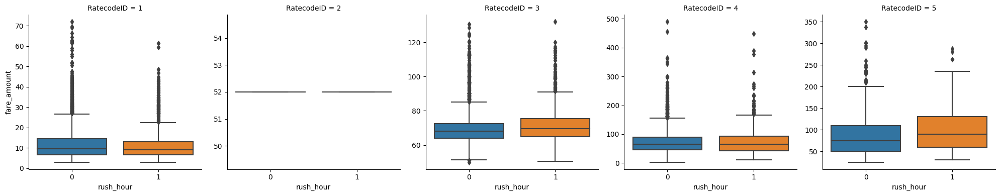

In [308]:
#######################################################
# fare_amount by rush_hour
#######################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="rush_hour", y="fare_amount", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=True,sharey=False
)
plt.show()

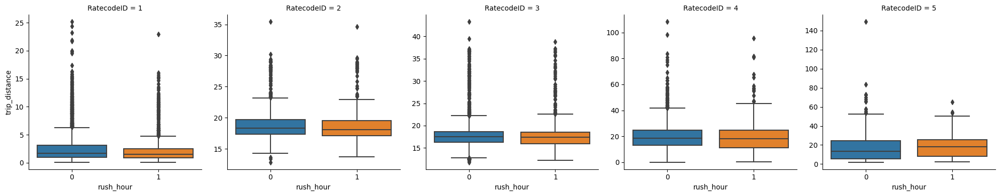

In [309]:
#######################################################
# trip_distance by rush_hour
#######################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="rush_hour", y="trip_distance", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=True,sharey=False
)
plt.show()

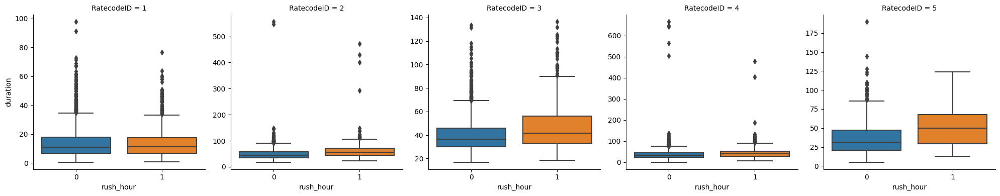

In [310]:
#######################################################
# duration by rush_hour
#######################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="rush_hour", y="duration", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=True,sharey=False
)
plt.show()

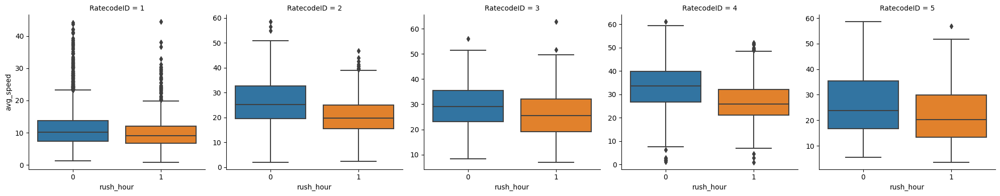

In [311]:
#######################################################
# avg_speed by rush_hour
#######################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="rush_hour", y="avg_speed", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=True,sharey=False
)
plt.show()

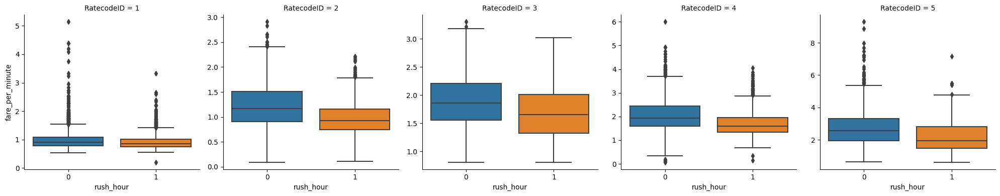

In [312]:
#######################################################
# fare_per_minute by rush_hour
#######################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="rush_hour", y="fare_per_minute", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=True,sharey=False
)
plt.show()

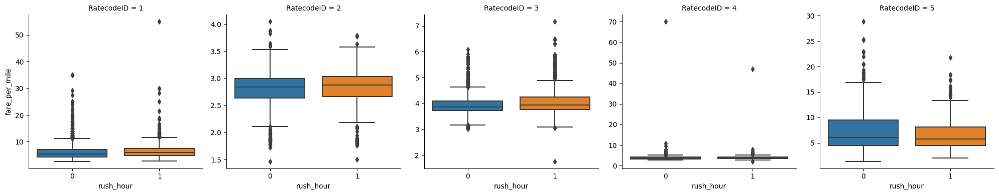

In [313]:
#######################################################
# fare_per_mile by rush_hour
#######################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="rush_hour", y="fare_per_mile", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=True,sharey=False
)
plt.show()

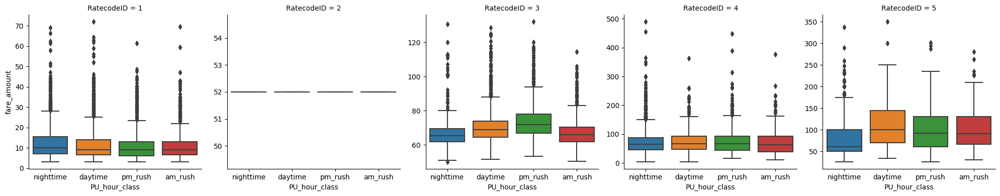

In [314]:
#######################################################
# fare_amount by rush_hour
#######################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="PU_hour_class", y="fare_amount", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=True,sharey=False
)
plt.show()

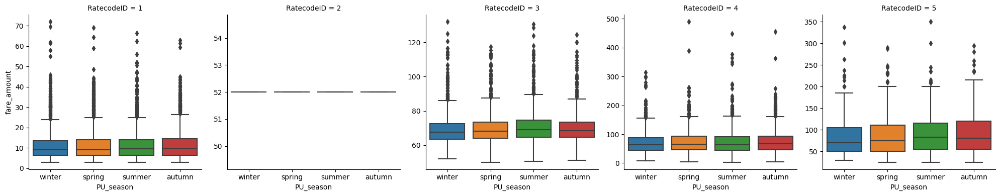

In [315]:
#######################################################
# fare_amount by PU_season
#######################################################
target_data=df_clean
sns.catplot(
    data=target_data, x="PU_season", y="fare_amount", col="RatecodeID",
    kind="box", height=4, aspect=1,showfliers=True,sharey=False
)
plt.show()

In [316]:
#save cleaned data
display(df_clean.info())
df_clean.to_csv('taxi_trip_clean_equal_ratecodeid.csv', index=False)

<class 'pandas.core.frame.DataFrame'>
Index: 18748 entries, 0 to 24746
Data columns (total 80 columns):
 #   Column                                                  Non-Null Count  Dtype         
---  ------                                                  --------------  -----         
 0   ID                                                      18748 non-null  int64         
 1   VendorID                                                18748 non-null  int64         
 2   tpep_pickup_datetime                                    18748 non-null  datetime64[ns]
 3   tpep_dropoff_datetime                                   18748 non-null  datetime64[ns]
 4   passenger_count                                         18748 non-null  int64         
 5   trip_distance                                           18748 non-null  float64       
 6   RatecodeID                                              18748 non-null  int64         
 7   store_and_fwd_flag                                      18748 n

None

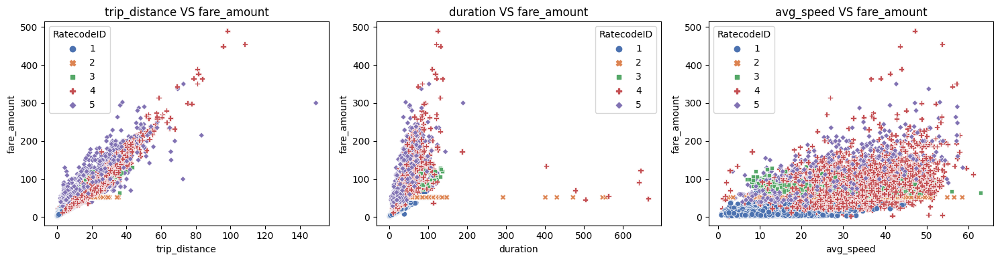

In [317]:
####################################################
#visualize cleaned data
####################################################
fig,axs=plt.subplots(1,3,figsize=(15,4))


independent_var_list=['trip_distance','duration','avg_speed']

for var,ax in zip(independent_var_list,axs.ravel()):
    sns.scatterplot(data=df_clean, x=var, y="fare_amount",
                    hue='RatecodeID', style="RatecodeID",palette="deep",ax=ax)
    ax.set_title(f"{var} VS fare_amount")
plt.tight_layout()
plt.show()

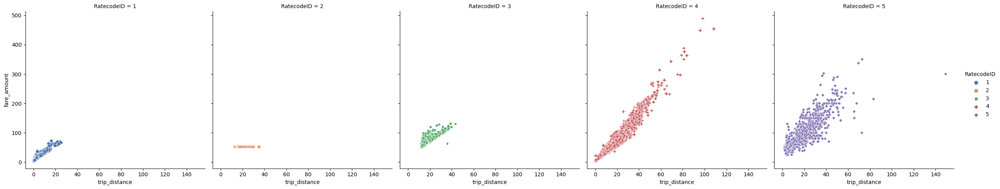

In [318]:
sns.relplot(
    data=df_clean, x="trip_distance", y="fare_amount",
    col="RatecodeID", hue="RatecodeID", style="RatecodeID",
    kind="scatter",palette="deep"
)
plt.show()

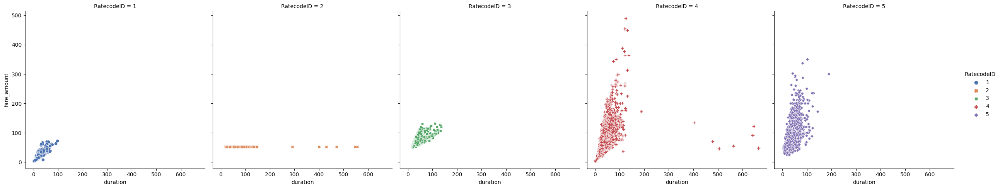

In [319]:
sns.relplot(
    data=df_clean, x="duration", y="fare_amount",
    col="RatecodeID", hue="RatecodeID", style="RatecodeID",
    kind="scatter",palette="deep"
)
plt.show()

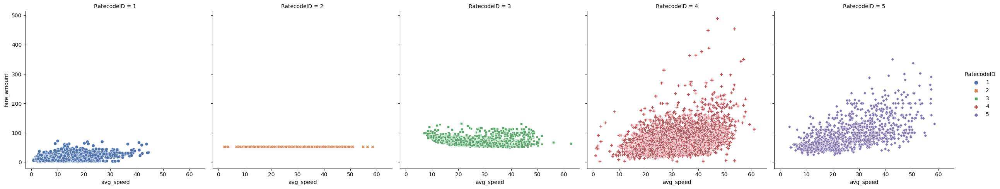

In [320]:
sns.relplot(
    data=df_clean, x="avg_speed", y="fare_amount",
    col="RatecodeID", hue="RatecodeID", style="RatecodeID",
    kind="scatter",palette="deep"
)
plt.show()


### Pair plot

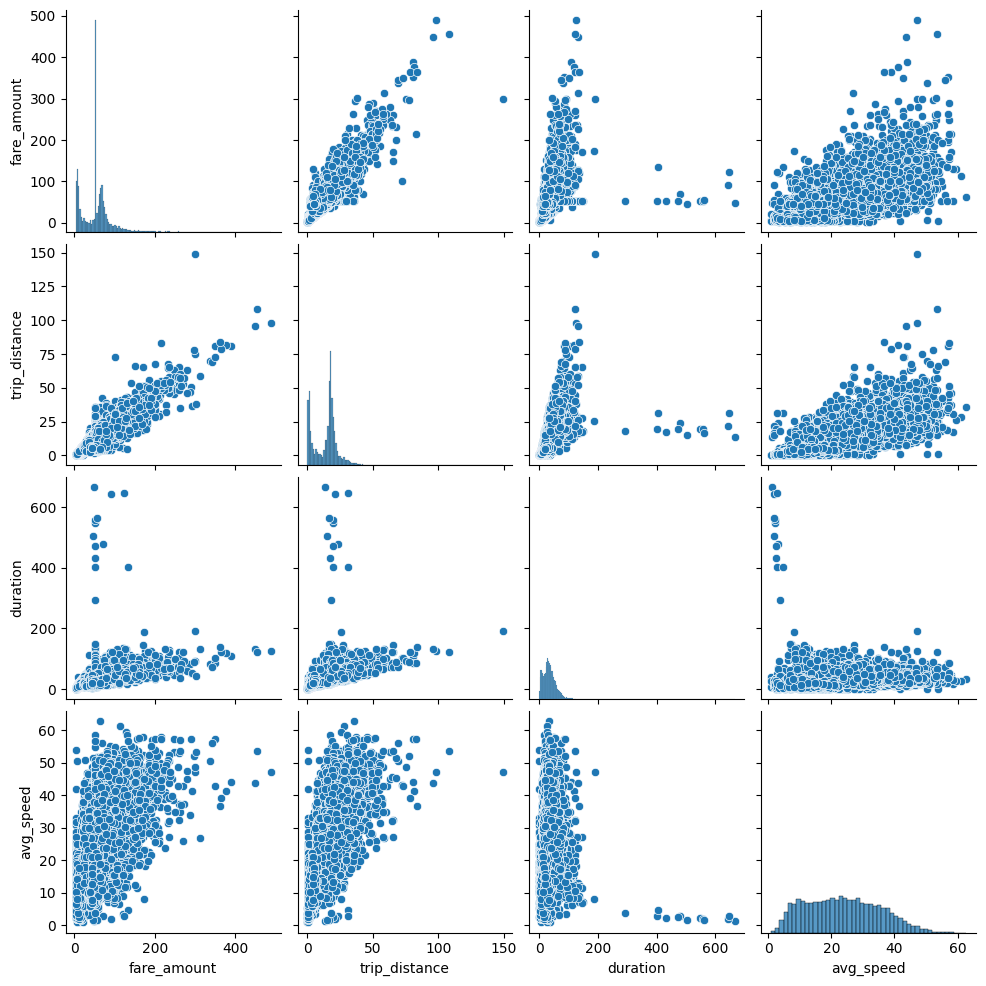

In [321]:
# Create a pairplot to visualize pairwise relationships between variables in the data
#sns.pairplot(df_clean[['fare_amount','mean_duration','mean_distance','mean_avg_speed','trip_distance','duration','avg_speed']])
sns.pairplot(df_clean[['fare_amount','trip_distance','duration','avg_speed']])
plt.show()

### Identify correlations

Next, code a correlation matrix to help determine most correlated variables.

In [322]:
def gasoline_cal(date):
    month=date.month
    year=date.year
    if month<=6:
        cal_month=str(year)+'June'
    else:
        cal_month=str(year)+'Dec'
    return cal_month

df_gasoline['cal_month']=df_gasoline['Date'].apply(gasoline_cal)
df_gasoline.head(10)

,Date,NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices,Year,Gdate,cal_month
dateindex,,,,,
2000-06-05,2000-06-05,1.654,2000,2000-06-05,2000June
2000-06-12,2000-06-12,1.693,2000,2000-06-12,2000June
2000-06-19,2000-06-19,1.731,2000,2000-06-19,2000June
2000-06-26,2000-06-26,1.748,2000,2000-06-26,2000June
2000-07-03,2000-07-03,1.755,2000,2000-07-03,2000Dec
2000-07-10,2000-07-10,1.752,2000,2000-07-10,2000Dec
2000-07-17,2000-07-17,1.748,2000,2000-07-17,2000Dec
2000-07-24,2000-07-24,1.736,2000,2000-07-24,2000Dec
2000-07-31,2000-07-31,1.715,2000,2000-07-31,2000Dec


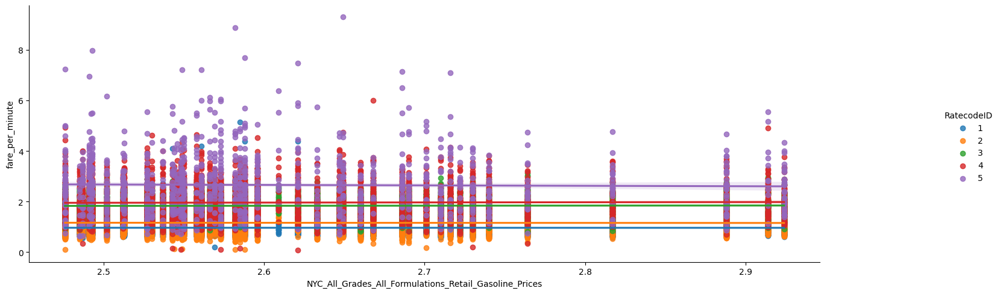

In [323]:
g=sns.lmplot(data=df_clean, y="fare_per_minute", x="NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices", hue="RatecodeID")
g.fig.set_size_inches((18, 5))
#plt.title("trip_distance VS fare_amount by RatecodeID")
plt.show()

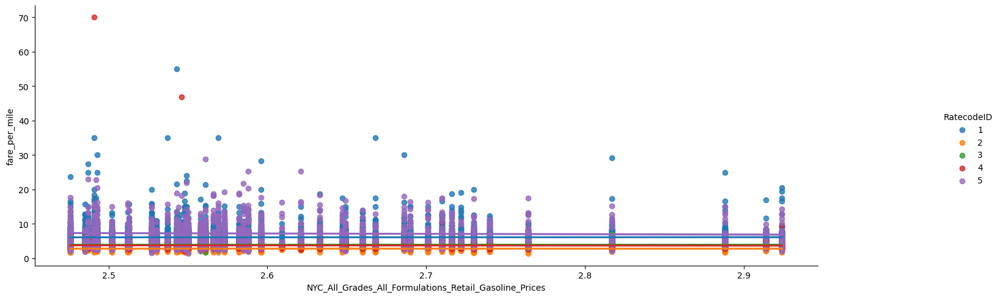

In [324]:
g=sns.lmplot(data=df_clean, y="fare_per_mile", x="NYC_All_Grades_All_Formulations_Retail_Gasoline_Prices", hue="RatecodeID")
g.fig.set_size_inches((18, 5))
#plt.title("trip_distance VS fare_amount by RatecodeID")
plt.show()

In [325]:
# Correlation matrix to help determine most correlated variables
##############################################
#ALL
##############################################
#target_col=['fare_amount','mean_duration','mean_distance','mean_avg_speed','trip_distance','duration','avg_speed']
target_col=['fare_amount','trip_distance','duration','avg_speed']
df_corr_all=df_clean[target_col].corr(method='spearman')
df_corr_all

,fare_amount,trip_distance,duration,avg_speed
fare_amount,1.000000,0.823513,0.697042,0.636446
trip_distance,0.823513,1.000000,0.772404,0.664287
duration,0.697042,0.772404,1.000000,0.211829
avg_speed,0.636446,0.664287,0.211829,1.000000


In [326]:
##############################################
#RatecodeID=1
##############################################
mask=df_clean['RatecodeID']==1
#target_col=['fare_amount','mean_duration','mean_distance','mean_avg_speed','trip_distance','duration','avg_speed']
target_col=['fare_amount','trip_distance','duration','avg_speed']
df_corr_ratecode1=df_clean[mask][target_col].corr(method='spearman')
df_corr_ratecode1

,fare_amount,trip_distance,duration,avg_speed
fare_amount,1.000000,0.928873,0.967405,0.201457
trip_distance,0.928873,1.000000,0.830679,0.490835
duration,0.967405,0.830679,1.000000,-0.009633
avg_speed,0.201457,0.490835,-0.009633,1.000000


In [327]:
##############################################
#RatecodeID=2
##############################################
mask=df_clean['RatecodeID']==2
#target_col=['fare_amount','mean_duration','mean_distance','mean_avg_speed','trip_distance','duration','avg_speed']
target_col=['fare_amount','trip_distance','duration','avg_speed']
df_corr_ratecode2=df_clean[mask][target_col].corr(method='spearman')
df_corr_ratecode2

,fare_amount,trip_distance,duration,avg_speed
fare_amount,NaN,NaN,NaN,NaN
trip_distance,NaN,1.000000,0.106649,0.161780
duration,NaN,0.106649,1.000000,-0.953201
avg_speed,NaN,0.161780,-0.953201,1.000000


In [328]:
##############################################
#RatecodeID=3
##############################################
mask=df_clean['RatecodeID']==3
#target_col=['fare_amount','mean_duration','mean_distance','mean_avg_speed','trip_distance','duration','avg_speed']
target_col=['fare_amount','trip_distance','duration','avg_speed']
df_corr_ratecode3=df_clean[mask][target_col].corr(method='spearman')
df_corr_ratecode3

,fare_amount,trip_distance,duration,avg_speed
fare_amount,1.000000,0.777132,0.750439,-0.362571
trip_distance,0.777132,1.000000,0.280278,0.163975
duration,0.750439,0.280278,1.000000,-0.858312
avg_speed,-0.362571,0.163975,-0.858312,1.000000


In [329]:
##############################################
#RatecodeID=4
##############################################
mask=df_clean['RatecodeID']==4
#target_col=['fare_amount','mean_duration','mean_distance','mean_avg_speed','trip_distance','duration','avg_speed']
target_col=['fare_amount','trip_distance','duration','avg_speed']
df_corr_ratecode4=df_clean[mask][target_col].corr(method='spearman')
df_corr_ratecode4

,fare_amount,trip_distance,duration,avg_speed
fare_amount,1.000000,0.957816,0.786194,0.400389
trip_distance,0.957816,1.000000,0.785770,0.453923
duration,0.786194,0.785770,1.000000,-0.141793
avg_speed,0.400389,0.453923,-0.141793,1.000000


In [330]:
##############################################
#RatecodeID=5
##############################################
mask=df_clean['RatecodeID']==5
#target_col=['fare_amount','mean_duration','mean_distance','mean_avg_speed','trip_distance','duration','avg_speed']
target_col=['fare_amount','trip_distance','duration','avg_speed']
df_corr_ratecode5=df_clean[mask][target_col].corr(method='spearman')
df_corr_ratecode5

,fare_amount,trip_distance,duration,avg_speed
fare_amount,1.000000,0.856271,0.714282,0.633842
trip_distance,0.856271,1.000000,0.811589,0.726865
duration,0.714282,0.811589,1.000000,0.230997
avg_speed,0.633842,0.726865,0.230997,1.000000


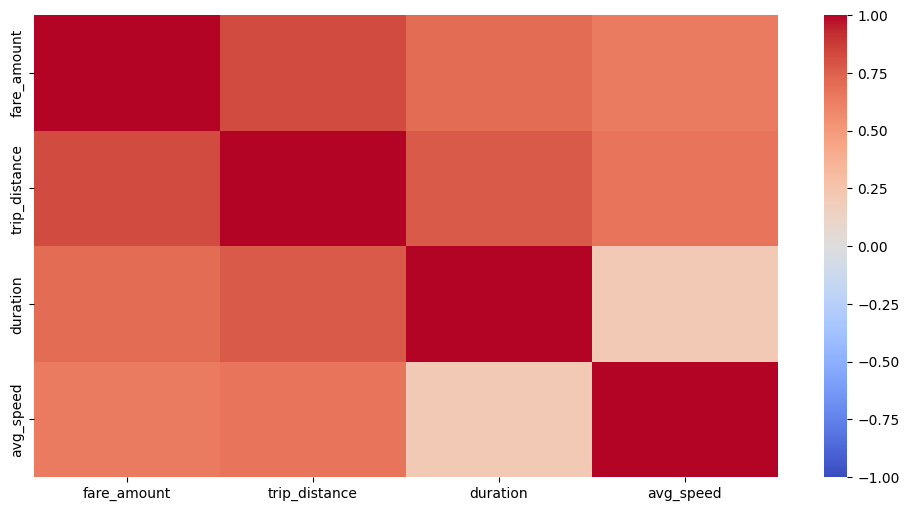

In [331]:
# Create correlation heatmap
plt.figure(figsize=(12,6))
sns.heatmap(df_corr_all, cmap='coolwarm', vmin=-1, vmax=1)
plt.show()

### Conclusion

Please refer `taxi-fareamount-prediction-eda.ipynb`
